GINN for three variables: $x,y,z$.

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import tensorflow as tf
#tf.config.run_functions_eagerly(True)
import pandas
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import LinearRegression
from numpy.polynomial import Polynomial as Polyn
import math
from keras.models import Sequential
from keras.layers import Dense
import pylab as pl
from sklearn.preprocessing import MinMaxScaler
from tensorflow.python.ops import math_ops
import keras.backend as K
import keras
import random
from keras.constraints import NonNeg
import matplotlib as mpl

**Data**

SIR model (synthetic)

In [ ]:
beta = 0.2
gamma = 0.1

T = []
S = []
I = []
R = []
s0 = 0.99
i0 = 0.006
r0 = 0.004
h = 0.1

for t in range(1100):
  t = t*h
  s1 = s0 - h*beta*i0*s0
  i1 = i0 + h*(beta*i0*s0 - gamma*i0)
  r1 = r0 + h*gamma*i0
  s0 = s1*1
  i0 = i1*1
  r0 = r1*1

  T.append(t)
  S.append(s1)
  I.append(i1)
  R.append(r1)

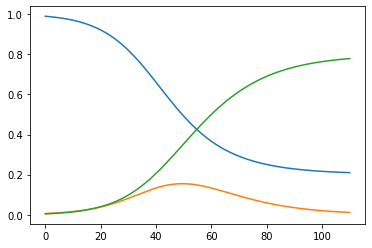

In [ ]:
plt.plot(T,S)
plt.plot(T,I)
plt.plot(T,R)
plt.show()

In [ ]:
ll = len(T)
initiall = int(.8*ll) #10

Td = T[initiall:ll]
Xd = S[initiall:ll]
Yd = I[initiall:ll]
Zd = R[initiall:ll]

T0 = T[0:initiall]
X0 = S[0:initiall]
Y0 = I[0:initiall]
Z0 = R[0:initiall]

SISD model

In [ ]:
beta = 0.165
gamma = 0.1
delta = 0.005

T = []
S = []
I = []
D = []
s0 = 0.99
i0 = 0.006
d0 = 0.004
h = 0.1

for t in range(1100):
  t = t*h
  s1 = s0 + h*(-beta*i0*s0 + gamma*i0) + random.gauss(0,0.0007)
  d1 = d0 + h*delta*i0 + 0.00005*random.random()
  i1 = 1-s1-d1 #i0 + h*(beta*i0*s0 - gamma*i0 - delta*i0) + random.gauss(0,0.0007)
  s0 = s1*1
  i0 = i1*1
  d0 = d1*1
  #print(s1+i1+d1)

  T.append(t)
  S.append(s1)
  I.append(i1)
  D.append(d1)

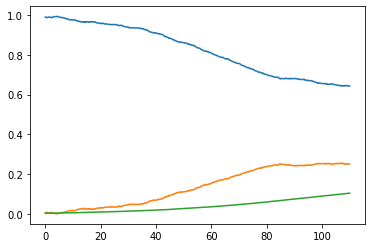

In [ ]:
plt.plot(T,S)
plt.plot(T,I)
plt.plot(T,D)
plt.show()

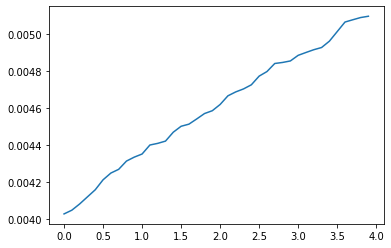

In [ ]:
plt.plot(T[0:40],D[0:40])
plt.show()

In [ ]:
ll = len(T)
initiall = int(.8*ll) #10

Td = T[initiall:ll]
Xd = S[initiall:ll]
Yd = I[initiall:ll]
Zd = D[initiall:ll]

T0 = T[0:initiall]
X0 = S[0:initiall]
Y0 = I[0:initiall]
Z0 = D[0:initiall]

Preprocessing

In [ ]:
def lineal(T,X):
  T = np.array(T)
  X = np.array(X)
 
  T = T.reshape(-1,1)
  X = X.reshape(-1,1)
 
  poly = PolynomialFeatures(degree=10)
  X_poly = poly.fit_transform(T)
  lin2 = LinearRegression()
 
 
  lin2.fit(X_poly,X)
 
  poly.fit(T,X)
 
  plt.scatter(T,X,color='red',label = 'Real')
  plt.plot(T,lin2.predict(poly.fit_transform(T)),label='Ajustada')
  plt.legend()
  plt.show()
 
  theta = lin2.coef_[0]
  #print(theta)
  theta[0] =  lin2.intercept_
  return theta

In [ ]:
def derPoly(theta,t): # Derivada polinomial
  m1 = len(theta)
  pun= np.array(range(m1))
  #theta = np.dot(pun,theta)
  sum = 0
  for i in range(m1):
    t = float(t)
    if theta[i]*i*t != 0:
      sum +=  theta[i]*i*t**(float(i-1))
    else:
      sum += 0
  return sum

def polinomio(theta,t):
  m1 = len(theta)
  sum = 0
  for i in range(m1):
    t = float(t)
    sum += theta[i]*t**(i)
  return sum

In [ ]:
def processInput(T0,X0,Y0,Z0):
  theta1 = lineal(T0,X0)
  theta2 = lineal(T0,Y0)
  theta3 = lineal(T0,Z0)
  tfinal = T0[-1]
  tinitial = T0[0]
  T = np.linspace(tinitial,tfinal,1000).reshape(-1, 1)

  dX = [] 
  dY = []
  dZ = []

  X = []
  Y = [] 
  Z = []

  for t in T:
    dx = derPoly(theta1,t)
    x  = polinomio(theta1,t)
    dy = derPoly(theta2,t)
    y  = polinomio(theta2,t)
    dz = derPoly(theta3,t)
    z = polinomio(theta3,t)
    dX.append(dx)
    dY.append(dy)
    dZ.append(dz)
    X.append(x)
    Y.append(y)
    Z.append(z)
  
  X = np.array(X) 
  Y = np.array(Y)
  Z = np.array(Z)
  dX = np.array(dX)
  dY = np.array(dY)
  dZ = np.array(dZ)
  return theta1,theta2,theta3,X,Y,Z,dX,dY,dZ

Loss

In [ ]:
import random

def binaryRarray(nl,p):
  Pr = []
  for i in range(nl):
    r = random.random()
    if r > p:
      Pr.append(0)
    else: 
      Pr.append(1)
  return Pr

i12,i13,i21,i23,i31,i32 = [1,1,1,1,1,1] #binaryRarray(6,1) [0, 0, 1, 0, 0, 1]

In [ ]:
def processOutput(y_pred):
  f12 = y_pred[:,0]
  f13 = y_pred[:,1]
  f21 = y_pred[:,2]
  #f22 = y_pred[:,4]
  f23 = y_pred[:,3]
  f31 = y_pred[:,4]
  f32 = y_pred[:,5]
  #f33 = y_pred[:,8]
  x = y_pred[:,6]
  y = y_pred[:,7]
  z = y_pred[:,8]

  a = i12*y*f12 + i13*z*f13 - i21*x*f21 - i31*x*f31
  b = i21*x*f21 + i23*z*f23 - i12*y*f12 - i32*y*f32
  c = i31*x*f31 + i32*y*f32 - i13*z*f13 - i23*z*f23
  #print(np.sum(a+b+c))
  y_pred2 = np.array([a,b,c]).T
  #y_pred2 = np.concatenate((a, b ,c ),axis=0)
  #y_pred2 = y_pred2.reshape(len(y_pred), 3).T
  return y_pred2

In [ ]:
def processOutput2(y_pred):
  f12 = y_pred[0]
  f13 = y_pred[1]
  f21 = y_pred[2]
  #f22 = y_pred[4]
  f23 = y_pred[3]
  f31 = y_pred[4]
  f32 = y_pred[5]
  #f33 = y_pred[8]
  x = y_pred[6]
  y = y_pred[7]
  z = y_pred[8]

  a = i12*y*f12 + i13*z*f13 - i21*x*f21 - i31*x*f31
  b = i21*x*f21 + i23*z*f23 - i12*y*f12 - i32*y*f32
  c = i31*x*f31 + i32*y*f32 - i13*z*f13 - i23*z*f23
  #print(a,b,c)
  #print(a+b+c)
  #print(b*f2 - x*f1 + x*f1 + y*f4 - b*f2 - b*f3 + b*f3 - y*f4)
  y_pred2 = np.array([a,b,c]).T
  #y_pred2 = np.concatenate((a, b ,c ),axis=0)
  #y_pred2 = y_pred2.reshape(len(y_pred), 3).T
  return y_pred2

In [ ]:
def custom_loss(y_true,y_pred):
  #y_pred = y_pred.numpy()
  #print(y_pred[:,0].numpy())
  #f11 = y_pred[:,0]
  f12 = y_pred[:,0]
  f13 = y_pred[:,1]
  f21 = y_pred[:,2]
  #f22 = y_pred[:,4]
  f23 = y_pred[:,3]
  f31 = y_pred[:,4]
  f32 = y_pred[:,5]
  #f33 = y_pred[:,8]
  x = y_pred[:,6]
  y = y_pred[:,7]
  z = y_pred[:,8]

  a = i12*y*f12 + i13*z*f13 - i21*x*f21 - i31*x*f31
  b = i21*x*f21 + i23*z*f23 - i12*y*f12 - i32*y*f32
  c = i31*x*f31 + i32*y*f32 - i13*z*f13 - i23*z*f23

  a = tf.reshape(a, [len(a), 1])
  b = tf.reshape(b, [len(b), 1])
  c = tf.reshape(c, [len(c), 1])

  y_pred2 = tf.concat((a, b ,c ),axis=1)

  diff = math_ops.squared_difference(y_pred2,y_true)
  loss = K.mean(diff, axis=-1)
  return loss

Train

In [ ]:
def train0(Td,Xd,Yd,Zd,T0,X0,Y0,Z0,mode=2,scat = False):
  theta1,theta2,theta3,X,Y,Z,dX,dY,dZ = processInput(T0,X0,Y0,Z0)
  X = X.reshape(-1,1)
  Y = Y.reshape(-1,1)
  Z = Z.reshape(-1,1)
  dX= dX.reshape(-1,1)
  dY= dY.reshape(-1,1)
  dZ= dZ.reshape(-1,1)

  Xa = np.concatenate((X,Y,Z),axis=1)
  dXa = np.concatenate((dX,dY,dZ),axis=1)

  inp = keras.layers.Input(shape=(3,))
  x1 = Dense(50,activation='relu')(inp) # 
  if mode == 1:
    x2 = Dense(50,activation='relu')(x1)
    x3 = Dense(3,activation='linear')(x2)
  else:
    x2 = Dense(50,activation='relu',kernel_constraint=NonNeg())(x1)
    x3 = Dense(3,activation='linear',kernel_constraint=NonNeg())(x2) # ,kernel_constraint=NonNeg()

  #conc = keras.layers.Concatenate()([x3,inp])

  model = keras.models.Model(inputs=inp,outputs=x3)

  model.compile(loss='mse', optimizer='adam')
 
  model.fit(Xa, dXa, epochs=500, batch_size=32, verbose=2)
  y_pred = model.predict(Xa)
  res = y_pred
  #y_pred = processOutput(res).T


  mpl.rcParams['figure.figsize'] = (8, 6)

  pl.subplot(411)
  pl.plot(y_pred[0], label='ann')
  pl.plot(dX, label='train')
  pl.xlabel('#')
  pl.ylabel('value [arb.]')
  pl.legend()
  pl.subplot(412)
  pl.plot(y_pred[1], label='ann')
  pl.plot(dY, label='train')
  pl.xlabel('#')
  pl.ylabel('value [arb.]')
  pl.legend()
  pl.subplot(413)
  pl.plot(y_pred[2], label='ann')
  pl.plot(dZ, label='train')
  pl.xlabel('#')
  pl.ylabel('value [arb.]')
  pl.legend()
  pl.subplot(414)
  pl.plot(np.abs(dZ - y_pred), label='diff')
  pl.legend()
  pl.show()

  x0 = X[0,0] #polinomio(theta1,T0[0])
  y0 = Y[0,0]#polinomio(theta2,T0[0])
  z0 = Z[0,0]#polinomio(theta3,T0[0])
  #y02= polinomio(theta2,1930)


  Xn = [x0]
  Yn = [y0]
  Zn = [z0]
  #Yn2= [y02]

  h = T0[-1]/len(y_pred)  #1/10.
  t = T0[0]
  Tn = [t]
  #D = []

  j = 0
  suma = 0
  suma2 = 0

  print(y_pred.shape)

  for i in range(1400):#range(int((2025-1930)*(1/h))):
    t += h
    p1 = [[x0,y0,z0]]
    
    #print(out)
    if i >= 1000:
      d = model.predict(p1)[0]
      print(d)
      #d = processOutput2(out).T #
    else:
      #print(y_pred[:,i])
      d = y_pred[i,:] 
    #print("__________________")
    ##print(out)  
    #print(x0,y0,z0)
    #print(d)
    #print(processOutput2(out).T)
    d1 = d[0]
    d2 = d[1]
    d3 = d[2]
    y1 = y0 + h*d2 #res_rscl2[i][0]
    z1 = z0 + h*d3 
    x1 = 1 - y1-z1 #x0 + h*d1 #*res_rscl[i][0]
    if y1 <0 or y1 > 1:
      if t < Td[int(len(Td)/2)]:
        suma += y1**2
      else:
        suma2+= y1**2
      #break
    if x1 < 0 or x1 > 1:
      if t < Td[int(len(Td)/2)]:
        suma += x1**2
      else:
        suma2+= x1**2
    
    if z1 < 0 or z1 > 1:
      if t < Td[int(len(Td)/2)]:
        suma += z1**2
      else:
        suma2+= z1**2

    #print(x1 + y1+ b1)


    if len(Td) > j:
      if abs(t-float(Td[j])) < 1.5*h:
        #print("AG")
        if t < Td[int(len(Td)/2)]:
          suma += (x1-Xd[j])**2 + (y1-Yd[j])**2 + (z1-Zd[j])**2
        else:
          suma2+= (x1-Xd[j])**2 + (y1-Yd[j])**2 + (z1-Zd[j])**2
        j += 1


    Xn.append(x1)
    Yn.append(y1)
    Zn.append(z1)
    #Yn2.append(y2)
    Tn.append(t)
    x0 = x1 + 0
    y0 = y1 + 0
    z0 = z1 + 0
    #y02 = y2 + 0
  print("Validation loss:", suma)
  print("Testing loss:", suma2)

  fig,ax = plt.subplots()

  if scat:
    ax.scatter(Td,Xd,color='blue',label='x')
    ax.scatter(T0,X0,color='blue',marker='+')
    ax.plot(Tn,Xn,color='blue')
    ax.scatter(Td,Yd,color='green',label='y')
    ax.scatter(T0,Y0,color='green',marker='+')
    ax.plot(Tn,Yn,color='green')
    ax.scatter(Td,Zd,color='red',label='z')
    ax.scatter(T0,Z0,color='red',marker='+')
    ax.plot(Tn,Zn,color='red')
  else:
    ax.plot(Td,Xd,color='blue',label='x',linestyle='dotted')
    ax.plot(T0,X0,color='blue',linestyle='dashed')
    ax.plot(Tn,Xn,color='blue')
    ax.plot(Td,Yd,color='green',label='y',linestyle='dotted')
    ax.plot(T0,Y0,color='green',linestyle='dashed')
    ax.plot(Tn,Yn,color='green')
    ax.plot(Td,Zd,color='red',label='z',linestyle='dotted')
    ax.plot(T0,Z0,color='red',linestyle='dashed')
    ax.plot(Tn,Zn,color='red')

  #ax.scatter(T0,Bilin, color = (0.4,0.7,0.3),label='Bilingual',marker='o',s=20)
  #ax.scatter(T0,Espa, color = (0,0,1),label='Spanish',marker='x',s=20)
  #ax.scatter(T0,Maya, color = (1,0,0),label='Maya',marker='+',s=20)
  if mode == 1:
    ax.set_title(u"Data-driven approach")
  else:
    ax.set_title(u"Data-driven approach with non-negative weights")#1920-2015")
  #ax.yaxis.title("t")
  ax.set_xlabel("t")
  #ax.set_ylabel("Casos registrados")
  ax.spines['left'].set_position(('outward',10))
  ax.spines['bottom'].set_position(('outward',10))
  ax.spines['right'].set_visible(False)
  ax.spines['top'].set_visible(False)
  #ax.set_yticks(range(10),minor=True)
  #ax.set_ylim([0,100])
  ax.legend(framealpha=1)
  #ax.legend(bbox_to_anchor=(1.1, 1.05))
  ax.legend()#(loc="upper left", bbox_to_anchor=(0.8,0.2))
  ax.yaxis.set_ticks_position('left')
  ax.xaxis.set_ticks_position('bottom')
  if mode == 1:
    plt.savefig('new1.eps')
  else:
    plt.savefig('evolved.eps')
  plt.show() 

  return suma 

In [ ]:
def train(Td,Xd,Yd,Zd,T0,X0,Y0,Z0,mode=2,scat = False):
  theta1,theta2,theta3,X,Y,Z,dX,dY,dZ = processInput(T0,X0,Y0,Z0)
  X = X.reshape(-1,1)
  Y = Y.reshape(-1,1)
  Z = Z.reshape(-1,1)
  dX= dX.reshape(-1,1)
  dY= dY.reshape(-1,1)
  dZ= dZ.reshape(-1,1)

  Xa = np.concatenate((X,Y,Z),axis=1)
  dXa = np.concatenate((dX,dY,dZ),axis=1)

  inp = keras.layers.Input(shape=(3,))
  x1 = Dense(50,activation='relu')(inp) # 
  if mode == 1:
    x2 = Dense(50,activation='relu')(x1)
    x3 = Dense(6,activation='linear')(x2)
  else:
    x2 = Dense(50,activation='relu',kernel_constraint=NonNeg())(x1)
    x3 = Dense(6,activation='linear',kernel_constraint=NonNeg())(x2) # ,kernel_constraint=NonNeg()

  conc = keras.layers.Concatenate()([x3,inp])

  model = keras.models.Model(inputs=inp,outputs=conc)

  model.compile(loss=custom_loss, optimizer='adam')
 
  model.fit(Xa, dXa, epochs=500, batch_size=32, verbose=2)
  res = model.predict(Xa)
  y_pred = processOutput(res).T


  mpl.rcParams['figure.figsize'] = (8, 6)

  pl.subplot(411)
  pl.plot(y_pred[0], label='ann')
  pl.plot(dX, label='train')
  pl.xlabel('#')
  pl.ylabel('value [arb.]')
  pl.legend()
  pl.subplot(412)
  pl.plot(y_pred[1], label='ann')
  pl.plot(dY, label='train')
  pl.xlabel('#')
  pl.ylabel('value [arb.]')
  pl.legend()
  pl.subplot(413)
  pl.plot(y_pred[2], label='ann')
  pl.plot(dZ, label='train')
  pl.xlabel('#')
  pl.ylabel('value [arb.]')
  pl.legend()
  pl.subplot(414)
  pl.plot(np.abs(dZ - res), label='diff')
  pl.legend()
  pl.show()

  x0 = X[0,0] #polinomio(theta1,T0[0])
  y0 = Y[0,0]#polinomio(theta2,T0[0])
  z0 = Z[0,0]#polinomio(theta3,T0[0])
  #y02= polinomio(theta2,1930)


  Xn = [x0]
  Yn = [y0]
  Zn = [z0]
  #Yn2= [y02]

  h = T0[-1]/len(res)  #1/10.
  t = T0[0]
  Tn = [t]
  #D = []

  j = 0
  suma = 0
  suma2 = 0

  for i in range(1400):#range(int((2025-1930)*(1/h))):
    t += h
    p1 = [[x0,y0,z0]]
    
    #print(out)
    if i >= 1000:
      out = model.predict(p1)[0]
      d = processOutput2(out).T #
    else:
      d = y_pred[:,i] 
    #print("__________________")
    ##print(out)  
    #print(x0,y0,z0)
    #print(d)
    #print(processOutput2(out).T)
    d1 = d[0]
    d2 = d[1]
    d3 = d[2]
    y1 = y0 + h*d2 #res_rscl2[i][0]
    z1 = z0 + h*d3 
    x1 = 1 - y1-z1 #x0 + h*d1 #*res_rscl[i][0]
    if y1 <0 or y1 > 1:
      if t < Td[int(len(Td)/2)]:
        suma += y1**2
      else:
        suma2+= y1**2
      #break
    if x1 < 0 or x1 > 1:
      if t < Td[int(len(Td)/2)]:
        suma += x1**2
      else:
        suma2+= x1**2
    
    if z1 < 0 or z1 > 1:
      if t < Td[int(len(Td)/2)]:
        suma += z1**2
      else:
        suma2+= z1**2

    #print(x1 + y1+ b1)


    if len(Td) > j:
      if abs(t-float(Td[j])) < 1.5*h:
        #print("AG")
        if t < Td[int(len(Td)/2)]:
          suma += (x1-Xd[j])**2 + (y1-Yd[j])**2 + (z1-Zd[j])**2
        else:
          suma2+= (x1-Xd[j])**2 + (y1-Yd[j])**2 + (z1-Zd[j])**2
        j += 1


    Xn.append(x1)
    Yn.append(y1)
    Zn.append(z1)
    #Yn2.append(y2)
    Tn.append(t)
    x0 = x1 + 0
    y0 = y1 + 0
    z0 = z1 + 0
    #y02 = y2 + 0
  print("Validation loss:", suma)
  print("Testing loss:", suma2)

  fig,ax = plt.subplots()

  if scat:
    ax.scatter(Td,Xd,color='blue',label='x')
    ax.scatter(T0,X0,color='blue',marker='+')
    ax.plot(Tn,Xn,color='blue')
    ax.scatter(Td,Yd,color='green',label='y')
    ax.scatter(T0,Y0,color='green',marker='+')
    ax.plot(Tn,Yn,color='green')
    ax.scatter(Td,Zd,color='red',label='z')
    ax.scatter(T0,Z0,color='red',marker='+')
    ax.plot(Tn,Zn,color='red')
  else:
    ax.plot(Td,Xd,color='blue',label='x',linestyle='dotted')
    ax.plot(T0,X0,color='blue',linestyle='dashed')
    ax.plot(Tn,Xn,color='blue')
    ax.plot(Td,Yd,color='green',label='y',linestyle='dotted')
    ax.plot(T0,Y0,color='green',linestyle='dashed')
    ax.plot(Tn,Yn,color='green')
    ax.plot(Td,Zd,color='red',label='z',linestyle='dotted')
    ax.plot(T0,Z0,color='red',linestyle='dashed')
    ax.plot(Tn,Zn,color='red')

  #ax.scatter(T0,Bilin, color = (0.4,0.7,0.3),label='Bilingual',marker='o',s=20)
  #ax.scatter(T0,Espa, color = (0,0,1),label='Spanish',marker='x',s=20)
  #ax.scatter(T0,Maya, color = (1,0,0),label='Maya',marker='+',s=20)
  if mode == 1:
    ax.set_title(u"GSNN approximation")
  else:
    ax.set_title(u"GSNN with non-negative weights")#1920-2015")
  #ax.yaxis.title("t")
  ax.set_xlabel("t")
  #ax.set_ylabel("Casos registrados")
  ax.spines['left'].set_position(('outward',10))
  ax.spines['bottom'].set_position(('outward',10))
  ax.spines['right'].set_visible(False)
  ax.spines['top'].set_visible(False)
  #ax.set_yticks(range(10),minor=True)
  #ax.set_ylim([0,100])
  ax.legend(framealpha=1)
  #ax.legend(bbox_to_anchor=(1.1, 1.05))
  ax.legend()#(loc="upper left", bbox_to_anchor=(0.8,0.2))
  ax.yaxis.set_ticks_position('left')
  ax.xaxis.set_ticks_position('bottom')
  if mode == '1':
    plt.savefig('new1.eps')
  else:
    plt.savefig('evolved.eps')
  plt.show() 

  return suma  

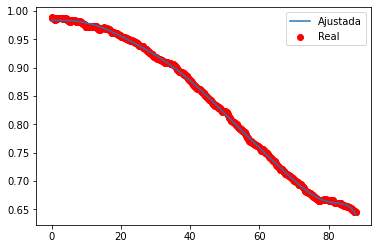

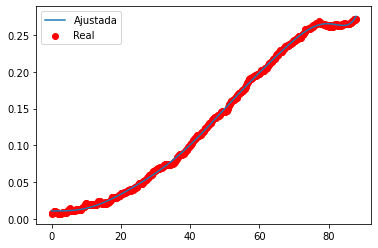

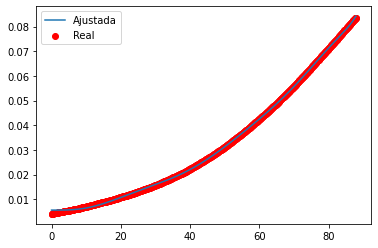

Epoch 1/500
32/32 - 2s - loss: 0.0031 - 2s/epoch - 49ms/step
Epoch 2/500
32/32 - 0s - loss: 3.0632e-04 - 58ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 7.5854e-05 - 62ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 3.6774e-05 - 66ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 2.4552e-05 - 64ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 1.8848e-05 - 63ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 1.5514e-05 - 63ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 1.3274e-05 - 63ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 1.1709e-05 - 73ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 1.0547e-05 - 67ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 9.6778e-06 - 63ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 9.0275e-06 - 77ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 8.5170e-06 - 60ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 8.1185e-06 - 65ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 7.8124e-06 - 61ms/epoch - 2ms/step
Epoch 16/

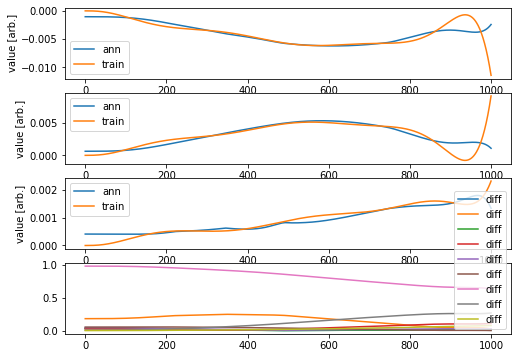

Validation loss: 0.04810382621559057
Testing loss: 0.1847545625560182


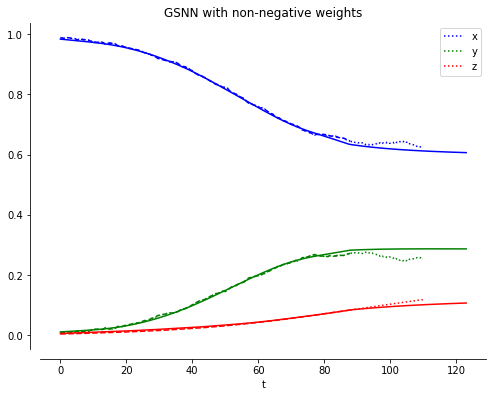

0.04810382621559057

In [ ]:
i12,i13,i21,i23,i31,i32 = [0, 1, 0, 0, 0, 1]
train(Td,Xd,Yd,Zd,T0,X0,Y0,Z0,mode=2)

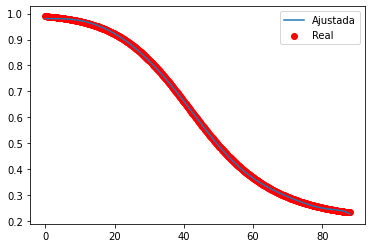

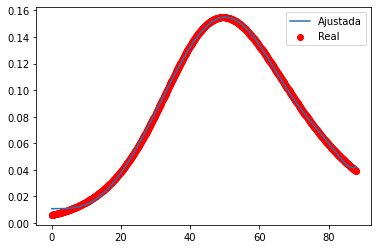

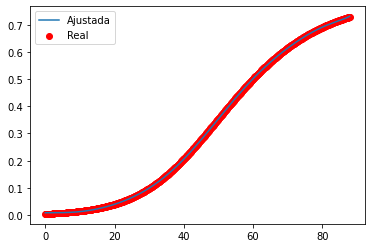

Epoch 1/500
32/32 - 2s - loss: 0.0336 - 2s/epoch - 61ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0048 - 70ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 8.9536e-04 - 61ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 2.2504e-04 - 60ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 9.0370e-05 - 64ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 5.6759e-05 - 76ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 4.5028e-05 - 63ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 3.8961e-05 - 62ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 3.5009e-05 - 64ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 3.1965e-05 - 65ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 2.9409e-05 - 67ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 2.7201e-05 - 73ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 2.5326e-05 - 65ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 2.3688e-05 - 74ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 2.2313e-05 - 72ms/epoch - 2ms/step
Epoch 16/500


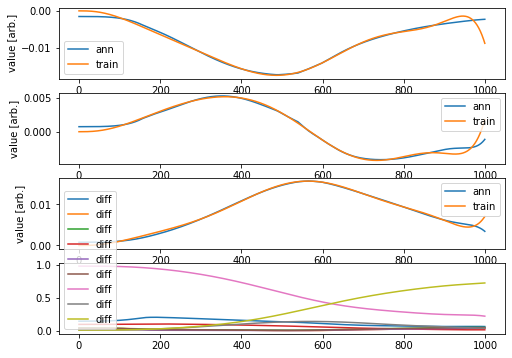

Validation loss: 0.06871922837493914
Testing loss: 0.6016837639268124


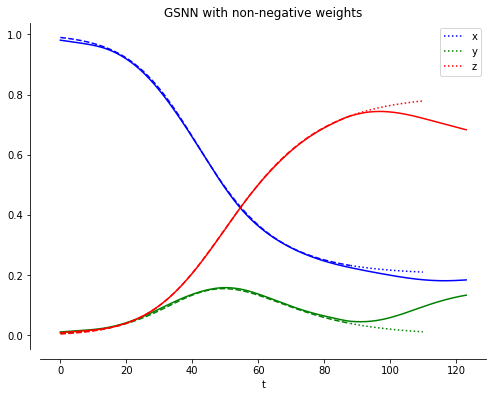

0.06871922837493914

In [ ]:
i12,i13,i21,i23,i31,i32 = [1, 0, 0, 1, 0, 0] #[1, 0, 0, 0, 0, 1]
train(Td,Xd,Yd,Zd,T0,X0,Y0,Z0,mode=2)

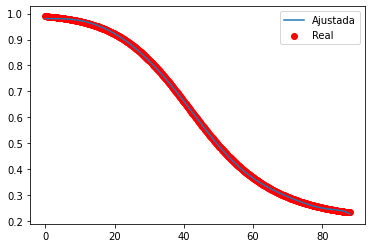

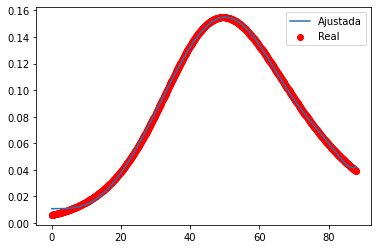

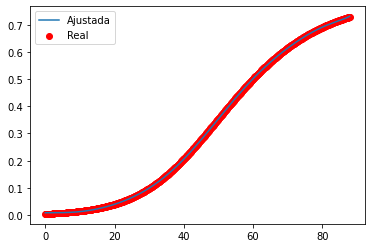

Epoch 1/500
32/32 - 2s - loss: 0.0051 - 2s/epoch - 53ms/step
Epoch 2/500
32/32 - 0s - loss: 5.8916e-04 - 44ms/epoch - 1ms/step
Epoch 3/500
32/32 - 0s - loss: 1.9298e-04 - 34ms/epoch - 1ms/step
Epoch 4/500
32/32 - 0s - loss: 1.2561e-04 - 39ms/epoch - 1ms/step
Epoch 5/500
32/32 - 0s - loss: 9.7307e-05 - 36ms/epoch - 1ms/step
Epoch 6/500
32/32 - 0s - loss: 7.7799e-05 - 38ms/epoch - 1ms/step
Epoch 7/500
32/32 - 0s - loss: 6.2548e-05 - 37ms/epoch - 1ms/step
Epoch 8/500
32/32 - 0s - loss: 5.0013e-05 - 42ms/epoch - 1ms/step
Epoch 9/500
32/32 - 0s - loss: 3.9608e-05 - 46ms/epoch - 1ms/step
Epoch 10/500
32/32 - 0s - loss: 3.1755e-05 - 38ms/epoch - 1ms/step
Epoch 11/500
32/32 - 0s - loss: 2.5969e-05 - 39ms/epoch - 1ms/step
Epoch 12/500
32/32 - 0s - loss: 2.1706e-05 - 40ms/epoch - 1ms/step
Epoch 13/500
32/32 - 0s - loss: 1.8571e-05 - 40ms/epoch - 1ms/step
Epoch 14/500
32/32 - 0s - loss: 1.6158e-05 - 41ms/epoch - 1ms/step
Epoch 15/500
32/32 - 0s - loss: 1.4329e-05 - 40ms/epoch - 1ms/step
Epoch 16/

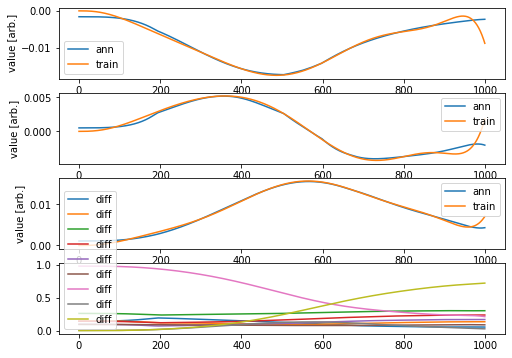

Validation loss: 0.005454627917842404
Testing loss: 0.013437591769111402


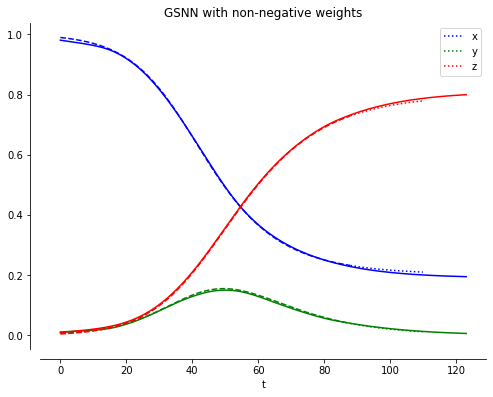

0.005454627917842404

In [ ]:
i12,i13,i21,i23,i31,i32 = [1, 0, 0, 0, 0, 1] #[1, 0, 0, 0, 0, 1]
train(Td,Xd,Yd,Zd,T0,X0,Y0,Z0,mode=2)

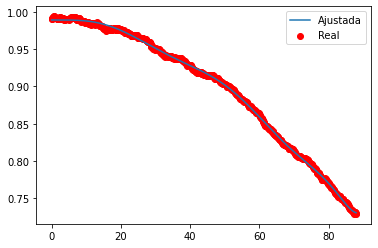

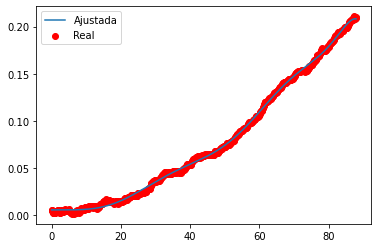

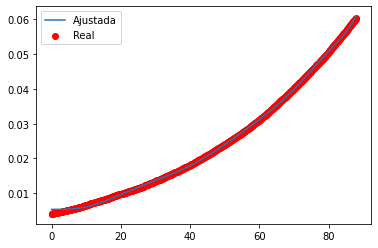

Epoch 1/500
32/32 - 1s - loss: 0.0017 - 718ms/epoch - 22ms/step
Epoch 2/500
32/32 - 0s - loss: 6.0348e-05 - 49ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 1.5913e-05 - 48ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 6.7944e-06 - 65ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 2.7120e-06 - 54ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 1.2684e-06 - 49ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 7.7215e-07 - 54ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 6.2165e-07 - 83ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 5.2506e-07 - 71ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 4.9918e-07 - 69ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 4.8272e-07 - 66ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 5.0082e-07 - 64ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 4.9851e-07 - 70ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 4.7155e-07 - 66ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 4.7110e-07 - 75ms/epoch - 2ms/step
Epoch 

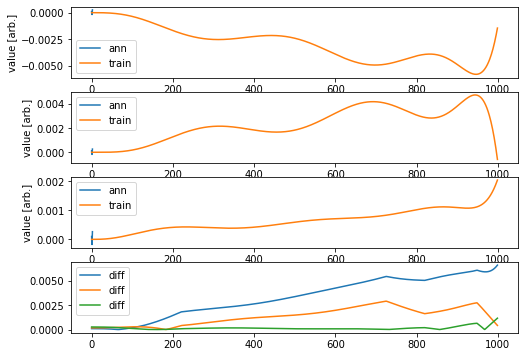

(1000, 3)
[-0.00670014  0.00401249  0.00260479]
[-0.00672241  0.00402704  0.00262033]
[-0.00674482  0.00404165  0.00263598]
[-0.00676738  0.00405632  0.00265171]
[-0.00679008  0.00407108  0.00266754]
[-0.00681293  0.00408592  0.00268345]
[-0.0068359   0.00410082  0.00269946]
[-0.00685904  0.00411578  0.00271556]
[-0.00688233  0.00413084  0.00273177]
[-0.00690575  0.00414597  0.00274806]
[-0.00692934  0.00416117  0.00276444]
[-0.00695306  0.00417644  0.00278092]
[-0.00697693  0.0041918   0.0027975 ]
[-0.00700095  0.00420723  0.00281419]
[-0.00702515  0.00422274  0.00283096]
[-0.00703357  0.00420829  0.00282643]
[-0.00702773  0.00416693  0.00280274]
[-0.00702197  0.00412596  0.00277928]
[-0.0070163   0.00408538  0.00275605]
[-0.00701069  0.00404517  0.00273306]
[-0.00700518  0.00400536  0.0027103 ]
[-0.00699975  0.00396592  0.00268775]
[-0.00699439  0.00392686  0.00266543]
[-0.00698911  0.00388814  0.00264334]
[-0.0069839   0.0038498   0.00262147]
[-0.00697878  0.00381183  0.00259981]
[-

[ 0.03951453 -0.00148264  0.00532036]
[ 0.03963293 -0.00148059  0.00530051]
[ 0.03975078 -0.00147849  0.00528071]
Validation loss: 0.23085280940491773
Testing loss: 0.6273808779141985


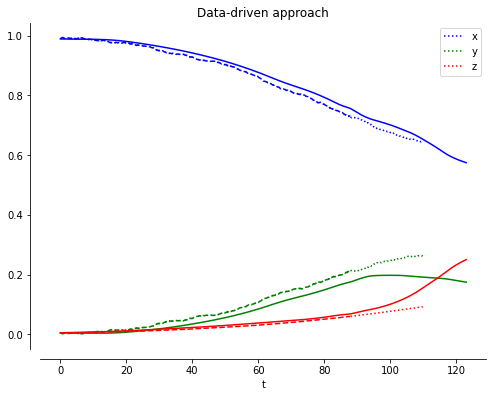

0.23085280940491773

In [ ]:
train0(Td,Xd,Yd,Zd,T0,X0,Y0,Z0,mode=1)

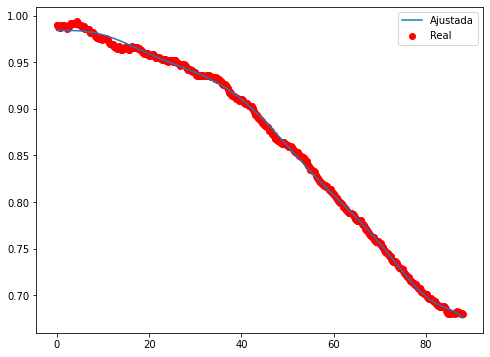

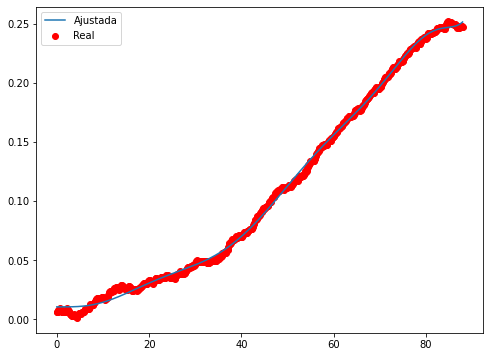

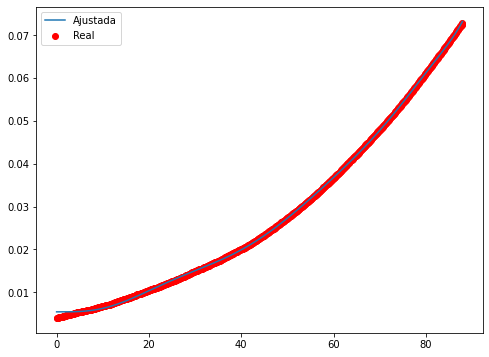

Epoch 1/500
32/32 - 1s - loss: 0.1432 - 760ms/epoch - 24ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0154 - 46ms/epoch - 1ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0044 - 34ms/epoch - 1ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0027 - 35ms/epoch - 1ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0018 - 36ms/epoch - 1ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0013 - 38ms/epoch - 1ms/step
Epoch 7/500
32/32 - 0s - loss: 8.9261e-04 - 39ms/epoch - 1ms/step
Epoch 8/500
32/32 - 0s - loss: 6.2847e-04 - 48ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 4.4060e-04 - 39ms/epoch - 1ms/step
Epoch 10/500
32/32 - 0s - loss: 3.0864e-04 - 37ms/epoch - 1ms/step
Epoch 11/500
32/32 - 0s - loss: 2.1399e-04 - 43ms/epoch - 1ms/step
Epoch 12/500
32/32 - 0s - loss: 1.4747e-04 - 37ms/epoch - 1ms/step
Epoch 13/500
32/32 - 0s - loss: 1.0207e-04 - 40ms/epoch - 1ms/step
Epoch 14/500
32/32 - 0s - loss: 7.1393e-05 - 35ms/epoch - 1ms/step
Epoch 15/500
32/32 - 0s - loss: 4.9418e-05 - 45ms/epoch - 1ms/step
Epoch 16/500
32/32 - 0s - 

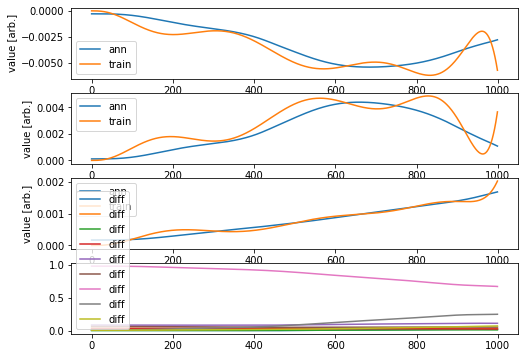

Validation loss: 0.24040129892344628
Testing loss: 0.7715671175366777


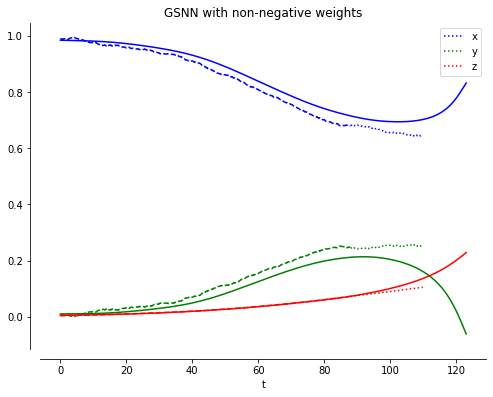

0.24040129892344628

In [ ]:
i12,i13,i21,i23,i31,i32 = [1,0,1,1,0,0] #[1,0,1,1,0,1]#[0, 1, 0, 0, 0, 1]
train(Td,Xd,Yd,Zd,T0,X0,Y0,Z0,mode=2)

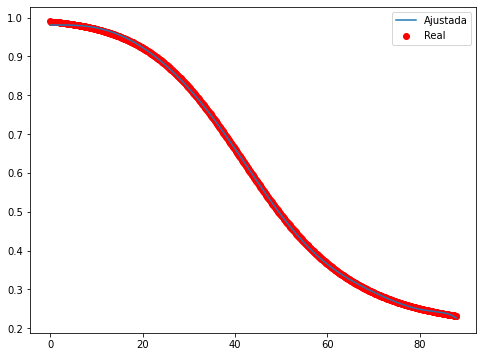

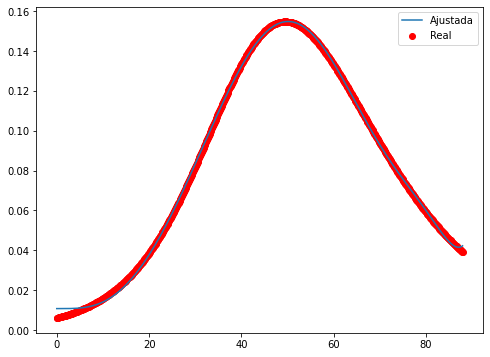

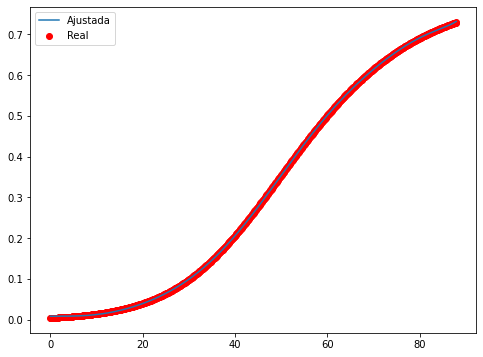

Epoch 1/500
32/32 - 1s - loss: 0.0345 - 1s/epoch - 36ms/step
Epoch 2/500
32/32 - 0s - loss: 6.9800e-04 - 59ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 8.9509e-05 - 62ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 3.2892e-05 - 65ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 1.8677e-05 - 64ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 1.2249e-05 - 68ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 8.7507e-06 - 73ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 6.4509e-06 - 71ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 4.8615e-06 - 64ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 3.8166e-06 - 63ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 3.0628e-06 - 68ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 2.5897e-06 - 64ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 2.2079e-06 - 67ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 1.9348e-06 - 64ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 1.7144e-06 - 66ms/epoch - 2ms/step
Epoch 16/

In [ ]:
mode = 2
theta1,theta2,theta3,X,Y,Z,dX,dY,dZ = processInput(T0,X0,Y0,Z0)
X = X.reshape(-1,1)
Y = Y.reshape(-1,1)
Z = Z.reshape(-1,1)
dX= dX.reshape(-1,1)
dY= dY.reshape(-1,1)
dZ= dZ.reshape(-1,1)

Xa = np.concatenate((X,Y,Z),axis=1)
dXa = np.concatenate((dX,dY,dZ),axis=1)

inp = keras.layers.Input(shape=(3,))
x1 = Dense(50,activation='relu')(inp) # 
if mode == '1':
  x2 = Dense(50,activation='relu')(x1)
  x3 = Dense(6,activation='linear')(x2)
else:
  x2 = Dense(50,activation='relu',kernel_constraint=NonNeg())(x1)
  x3 = Dense(6,activation='linear',kernel_constraint=NonNeg())(x2) # ,kernel_constraint=NonNeg()

conc = keras.layers.Concatenate()([x3,inp])

model = keras.models.Model(inputs=inp,outputs=conc)

model.compile(loss=custom_loss, optimizer='adam')

model.fit(Xa, dXa, epochs=500, batch_size=32, verbose=2)
res = model.predict(Xa)
y_pred = processOutput(res).T

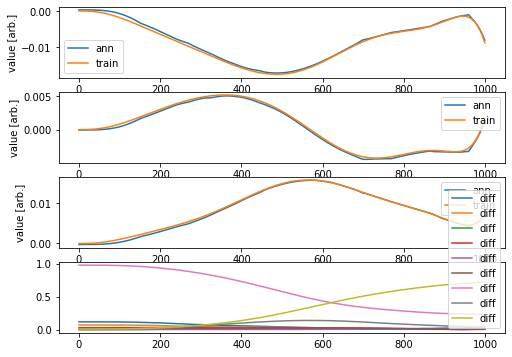

In [ ]:
mpl.rcParams['figure.figsize'] = (8, 6)

pl.subplot(411)
pl.plot(y_pred[0], label='ann')
pl.plot(dX, label='train')
pl.xlabel('#')
pl.ylabel('value [arb.]')
pl.legend()
pl.subplot(412)
pl.plot(y_pred[1], label='ann')
pl.plot(dY, label='train')
pl.xlabel('#')
pl.ylabel('value [arb.]')
pl.legend()
pl.subplot(413)
pl.plot(y_pred[2], label='ann')
pl.plot(dZ, label='train')
pl.xlabel('#')
pl.ylabel('value [arb.]')
pl.legend()
pl.subplot(414)
pl.plot(np.abs(dZ - res), label='diff')
pl.legend()
pl.show()

In [ ]:
def selectionP(pop,scores):
  selection_idx = 0 #random.randint(0,len(pop)-1)
  for ix in range(len(pop)):
    if scores[ix] < scores[selection_idx]:
      selection_idx = ix
  return pop[selection_idx]

def crossover(pa1,pa2):
  x11 = pa1[0:int(len(pa1)/2)]
  x12 = pa1[int(len(pa1)/2):len(pa1)]
  x21 = pa2[0:int(len(pa1)/2)]
  x22 = pa2[int(len(pa1)/2):len(pa1)]
  fl1 = x11 + x22
  fl2 = x12 + x21
  if random.random() < 0.5:
    return fl1
  else:
    return fl2

def mutation(fl,mr=0.2):
  fl2 = []
  for i in range(len(fl)):
    if random.random() < mr:
      outp = int(not int(fl[i]))
      fl2.append(outp)
    else:
      outp = int(fl[i])
      fl2.append(outp)
  return fl2   

def selection(pop,scores,n_pairs=1):
  Fl = []
  pop2 = 1*pop
  for _ in range(n_pairs):
    p1 = selectionP(pop2,scores)
    pop2.remove(p1)
    p2 = selectionP(pop2,scores)
    pop2.remove(p2)
    fl = crossover(p1,p2)
    fl = mutation(fl)
    Fl.append(fl)
  return Fl

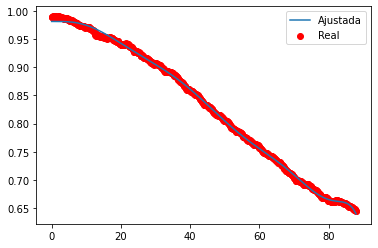

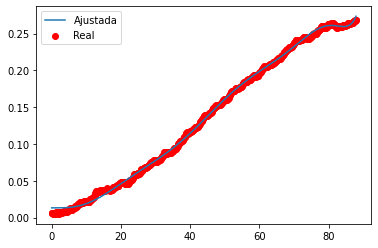

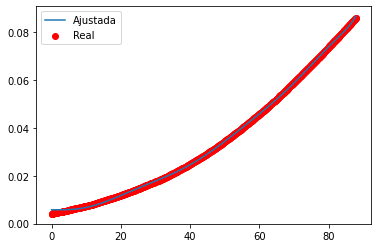

Epoch 1/500
32/32 - 2s - loss: 0.3054 - 2s/epoch - 55ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0308 - 57ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0051 - 56ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0019 - 65ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0013 - 58ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0010 - 64ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 9.2795e-04 - 57ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 8.3617e-04 - 72ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 7.5887e-04 - 69ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 6.9371e-04 - 63ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 6.3672e-04 - 63ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 5.8502e-04 - 58ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 5.3688e-04 - 58ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 4.9185e-04 - 60ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 4.4899e-04 - 59ms/epoch - 2ms/step
Epoch 16/500
32/32 - 0s - los

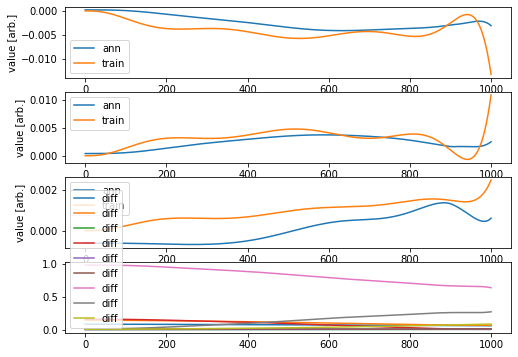

Validation loss: 1.4919847228208254
Testing loss: 0.37346808518348834


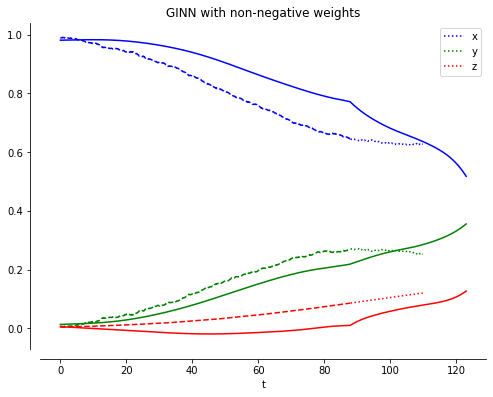

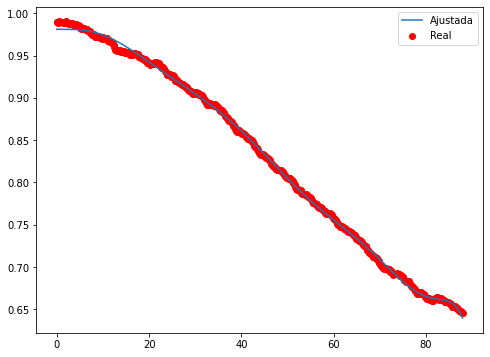

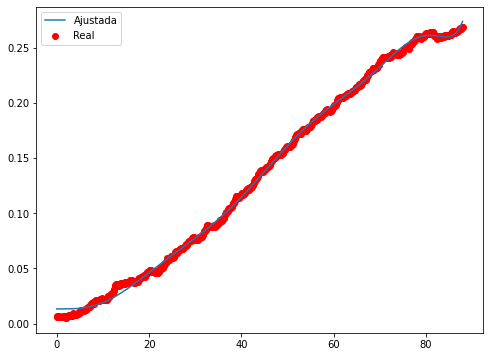

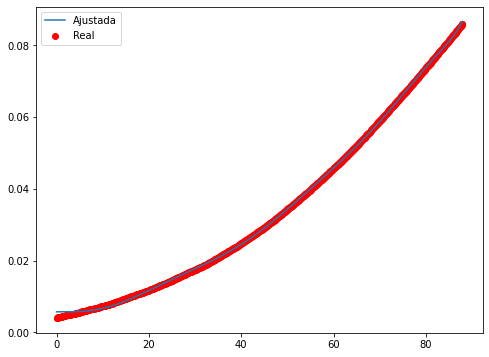

Epoch 1/500
32/32 - 2s - loss: 0.9149 - 2s/epoch - 68ms/step
Epoch 2/500
32/32 - 0s - loss: 0.1382 - 66ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0323 - 82ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0111 - 71ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0054 - 70ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0034 - 70ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 0.0026 - 75ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 0.0022 - 65ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 0.0020 - 71ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 0.0018 - 64ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 0.0017 - 74ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 0.0015 - 68ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 0.0014 - 66ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 0.0012 - 72ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 0.0011 - 69ms/epoch - 2ms/step
Epoch 16/500
32/32 - 0s - loss: 0.0010 - 67ms/epoch - 2ms/step
Ep

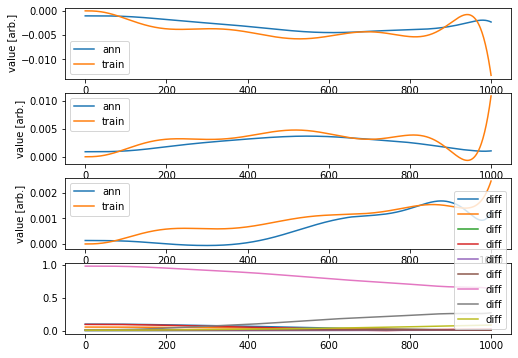

Validation loss: 0.6505192433420056
Testing loss: 0.33797655074398353


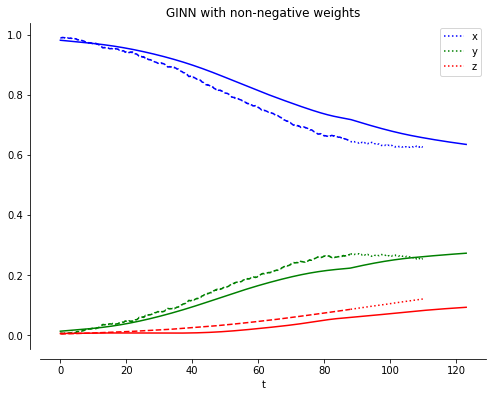

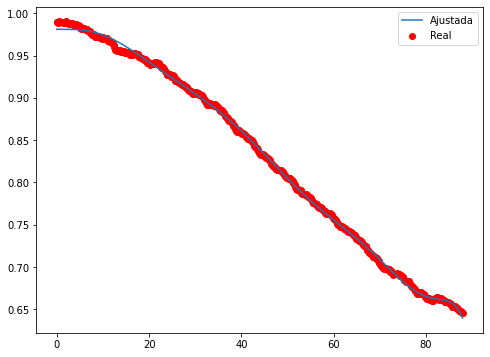

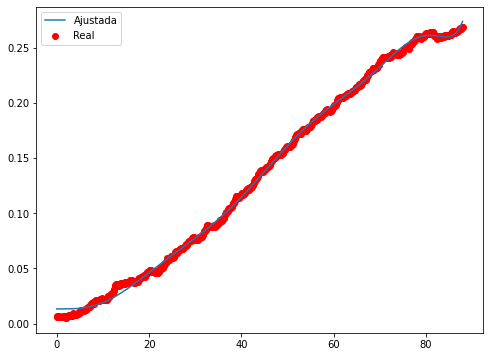

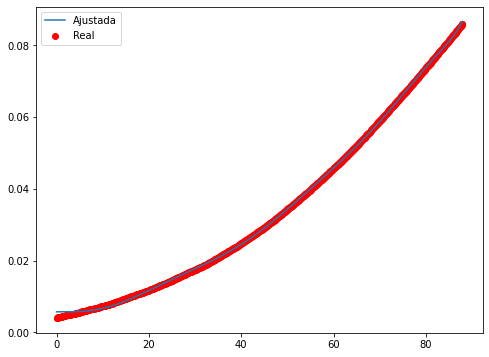

Epoch 1/500
32/32 - 1s - loss: 0.7060 - 1s/epoch - 37ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0883 - 73ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0158 - 69ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0051 - 71ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0026 - 66ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0019 - 68ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 0.0016 - 70ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 0.0014 - 78ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 0.0013 - 66ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 0.0012 - 63ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 0.0011 - 74ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 9.9010e-04 - 66ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 9.1898e-04 - 74ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 8.5673e-04 - 75ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 8.0112e-04 - 64ms/epoch - 2ms/step
Epoch 16/500
32/32 - 0s - loss: 7.5238e-04 - 64ms

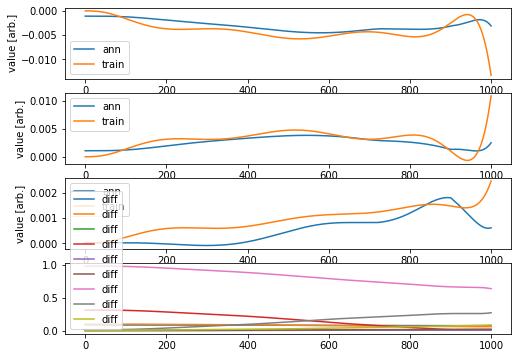

Validation loss: 0.46678561466619967
Testing loss: 0.19349575259242285


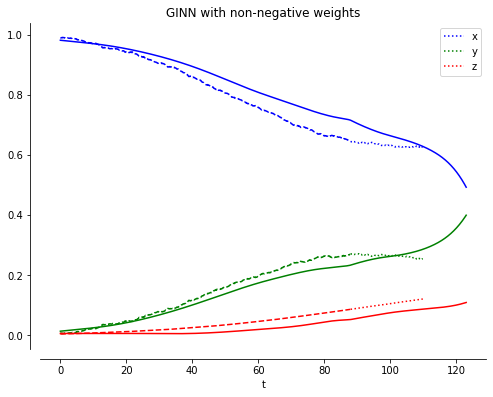

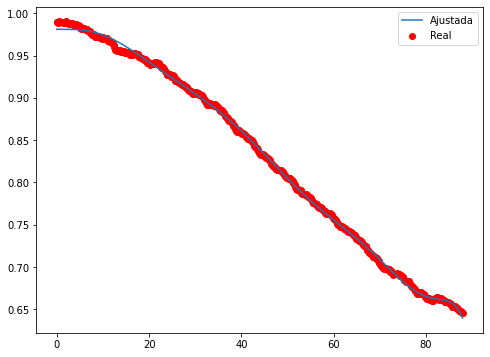

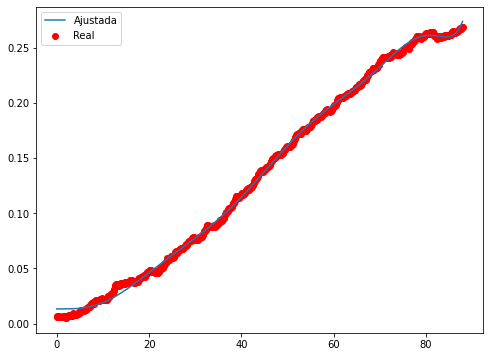

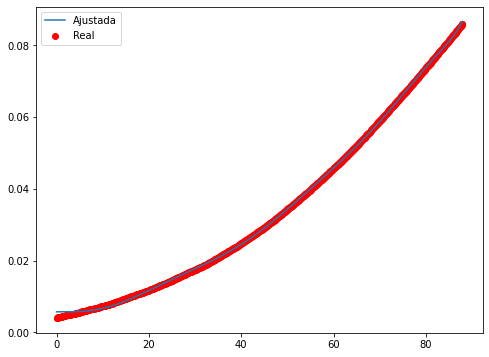

Epoch 1/500
32/32 - 1s - loss: 0.3516 - 1s/epoch - 37ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0333 - 66ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0047 - 68ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0014 - 79ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 8.3487e-04 - 69ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 6.7365e-04 - 77ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 5.8039e-04 - 79ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 5.0452e-04 - 72ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 4.3793e-04 - 80ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 3.7983e-04 - 82ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 3.2776e-04 - 68ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 2.8103e-04 - 67ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 2.3993e-04 - 71ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 2.0433e-04 - 69ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 1.7379e-04 - 78ms/epoch - 2ms/step
Epoch 16/500
32/32 - 

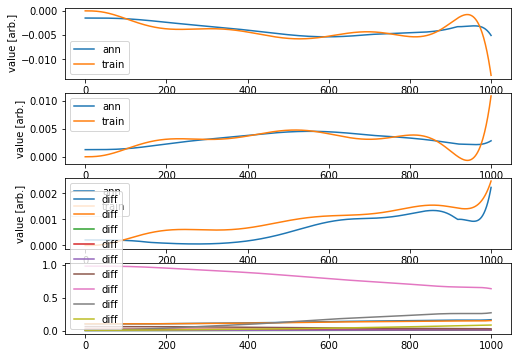

Validation loss: 0.45032091056790186
Testing loss: 6.181265667264388


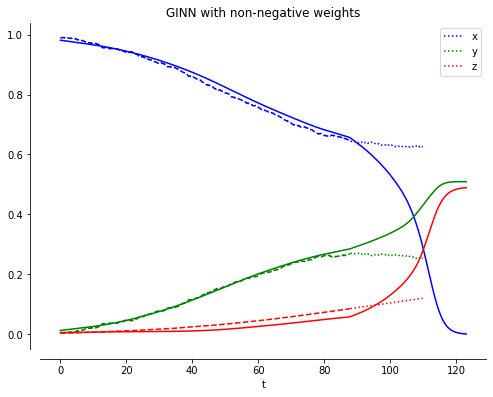

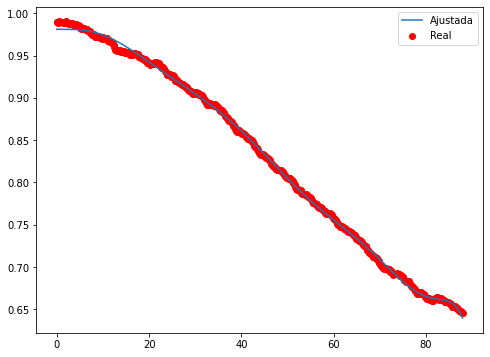

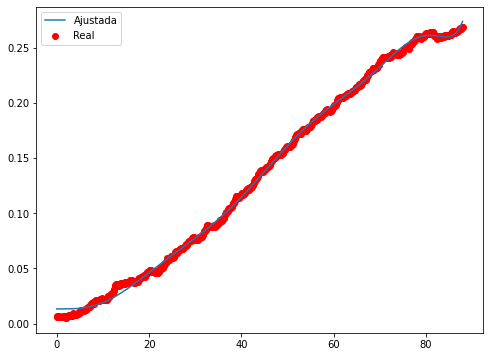

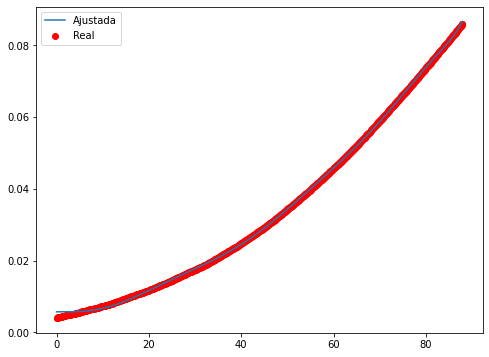

Epoch 1/500
32/32 - 1s - loss: 0.1768 - 1s/epoch - 38ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0135 - 71ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0016 - 69ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 5.8170e-04 - 74ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 4.3424e-04 - 77ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 3.8816e-04 - 79ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 3.5530e-04 - 80ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 3.2504e-04 - 72ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 2.9793e-04 - 71ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 2.7323e-04 - 66ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 2.5094e-04 - 76ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 2.2983e-04 - 67ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 2.0904e-04 - 72ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 1.8843e-04 - 75ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 1.6912e-04 - 71ms/epoch - 2ms/step
Epoch 16/500
32/3

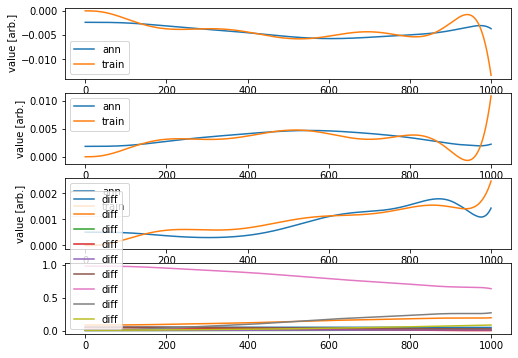

Validation loss: 1.3030059649135273
Testing loss: 12.685777131922936


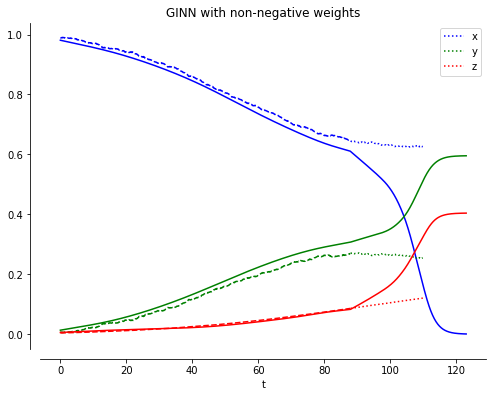

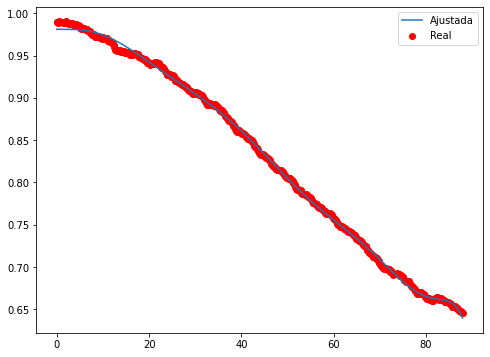

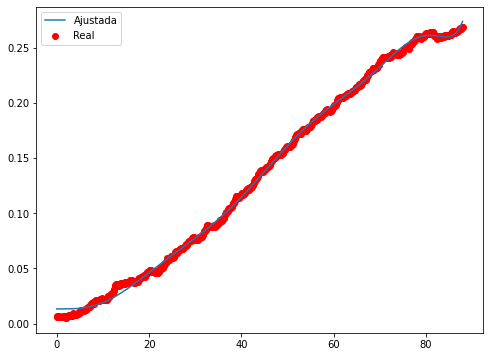

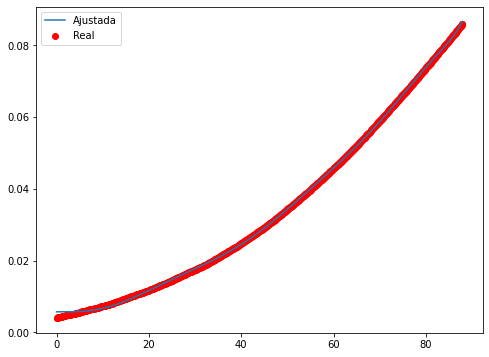

Epoch 1/500
32/32 - 1s - loss: 0.0033 - 1s/epoch - 36ms/step
Epoch 2/500
32/32 - 0s - loss: 3.9369e-04 - 83ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 1.0666e-04 - 73ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 4.8089e-05 - 77ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 2.8350e-05 - 73ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 1.9562e-05 - 82ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 1.5240e-05 - 75ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 1.2662e-05 - 79ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 1.0971e-05 - 79ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 9.7889e-06 - 75ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 8.9349e-06 - 73ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 8.3043e-06 - 80ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 7.8098e-06 - 72ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 7.4099e-06 - 88ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 7.0875e-06 - 75ms/epoch - 2ms/step
Epoch 16/

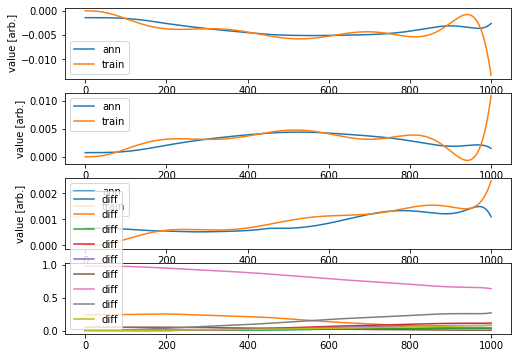

Validation loss: 0.017174328856202202
Testing loss: 0.11799162189782472


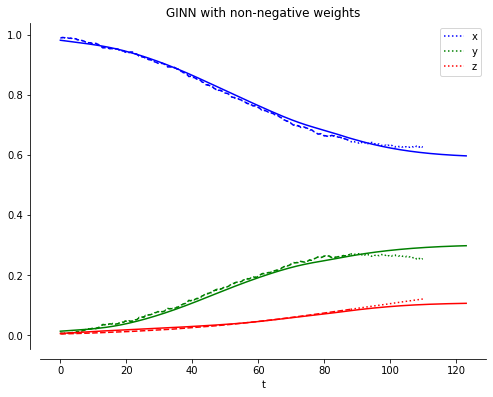

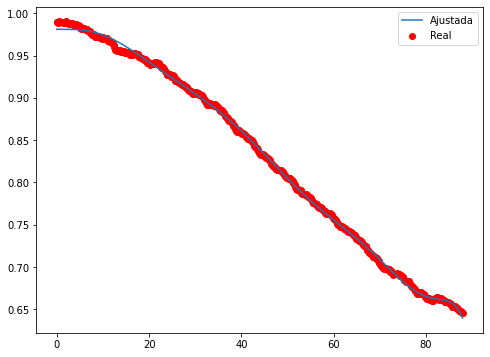

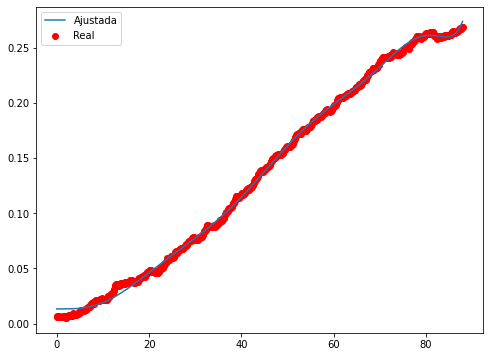

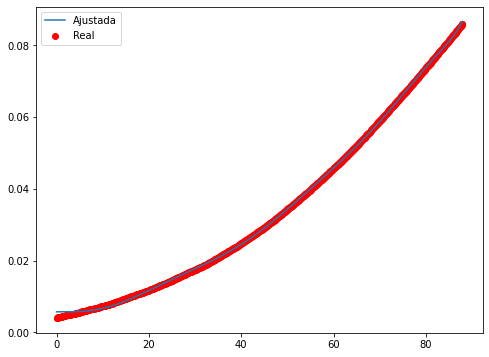

Epoch 1/500
32/32 - 1s - loss: 0.0023 - 1s/epoch - 37ms/step
Epoch 2/500
32/32 - 0s - loss: 2.0106e-04 - 77ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 6.3640e-05 - 79ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 3.4367e-05 - 86ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 2.3732e-05 - 83ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.8031e-05 - 81ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 1.4755e-05 - 83ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 1.2681e-05 - 74ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 1.1256e-05 - 84ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 1.0240e-05 - 75ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 9.4794e-06 - 73ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 8.9075e-06 - 81ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 8.4619e-06 - 77ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 8.0998e-06 - 78ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 7.7793e-06 - 78ms/epoch - 2ms/step
Epoch 16/

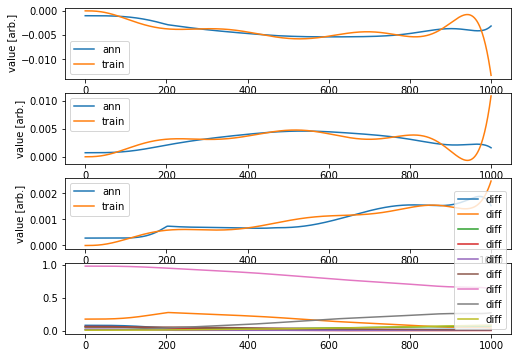

Validation loss: 0.06456911779942323
Testing loss: 0.20330346958317208


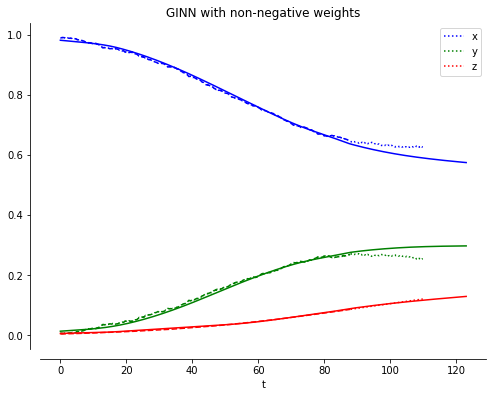

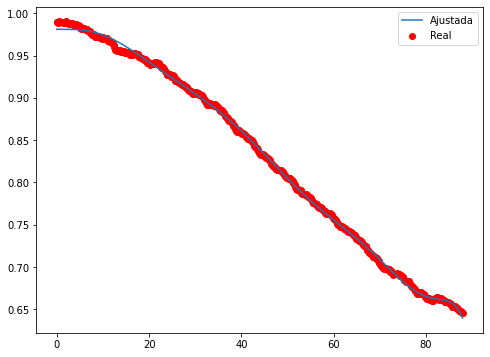

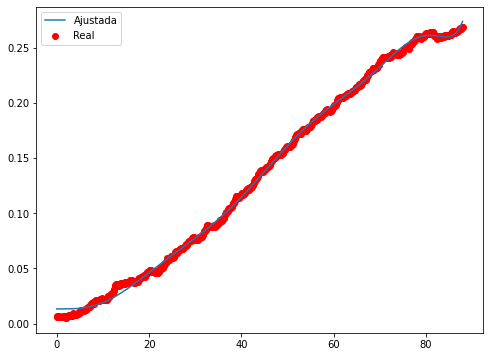

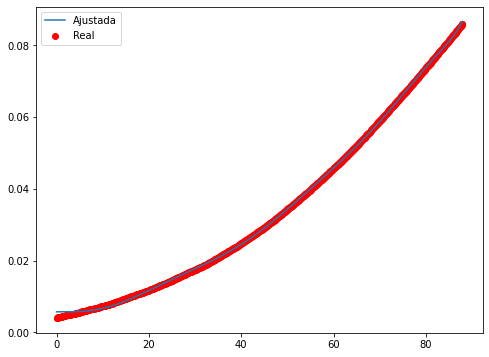

Epoch 1/500
32/32 - 1s - loss: 0.0018 - 1s/epoch - 37ms/step
Epoch 2/500
32/32 - 0s - loss: 1.6251e-04 - 78ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 3.2908e-05 - 78ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 1.6458e-05 - 81ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 1.1879e-05 - 79ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 9.9955e-06 - 82ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 9.0024e-06 - 80ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 8.4015e-06 - 83ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 7.9850e-06 - 86ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 7.6541e-06 - 115ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 7.3838e-06 - 81ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 7.1428e-06 - 73ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 6.9327e-06 - 85ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 6.7127e-06 - 78ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 6.4766e-06 - 76ms/epoch - 2ms/step
Epoch 16

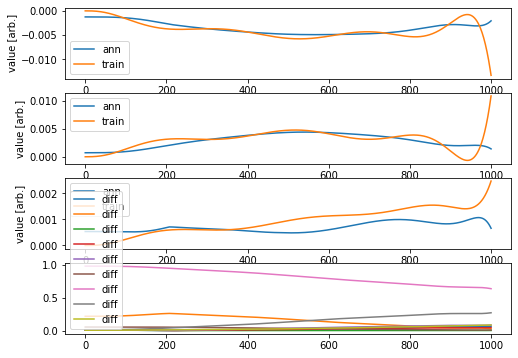

Validation loss: 0.12205517082541528
Testing loss: 0.24327118864392377


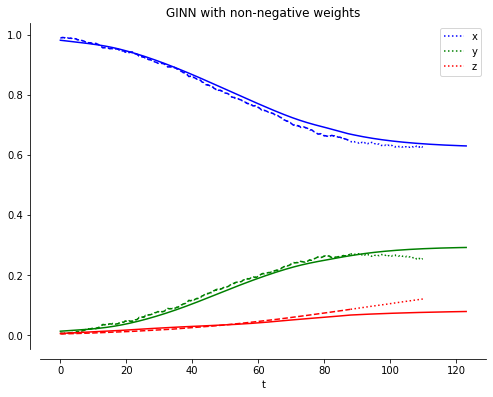

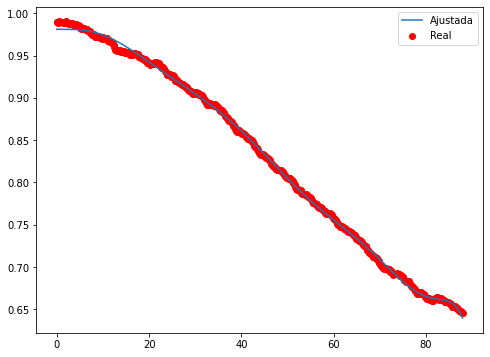

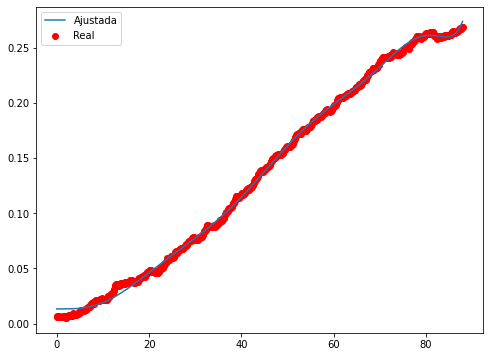

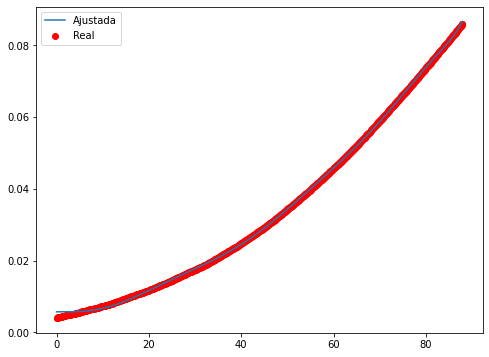

Epoch 1/500
32/32 - 1s - loss: 2.4557e-04 - 1s/epoch - 46ms/step
Epoch 2/500
32/32 - 0s - loss: 1.9644e-05 - 88ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 7.7507e-06 - 77ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 5.7893e-06 - 81ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 5.1236e-06 - 80ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 4.8017e-06 - 90ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 4.6166e-06 - 82ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 4.4851e-06 - 78ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 4.3870e-06 - 79ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 4.3058e-06 - 81ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 4.2424e-06 - 81ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 4.1873e-06 - 85ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 4.1355e-06 - 79ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 4.0911e-06 - 77ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 4.0508e-06 - 82ms/epoch - 3ms/step
Epoch

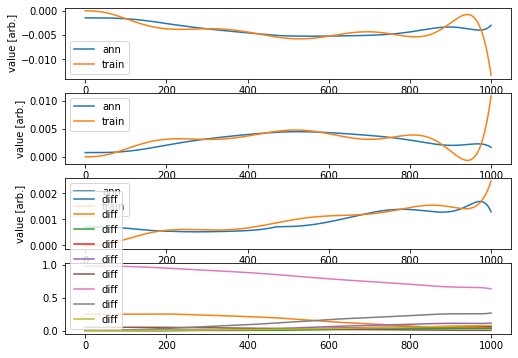

Validation loss: 0.034277585274738995
Testing loss: 0.16618926244570584


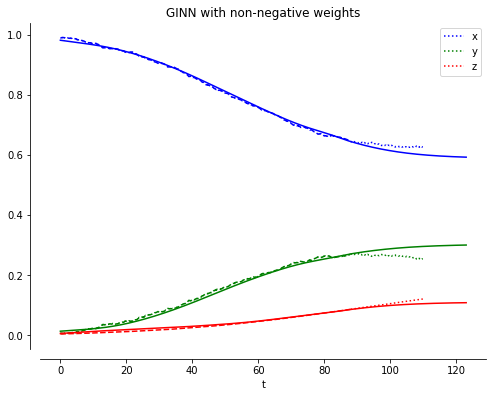

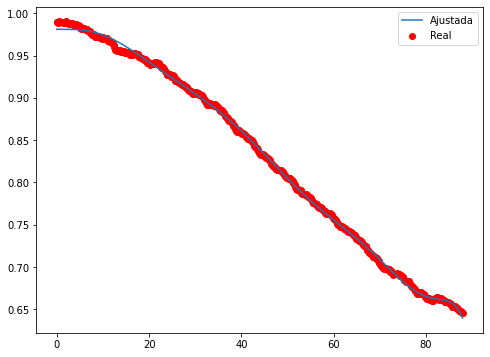

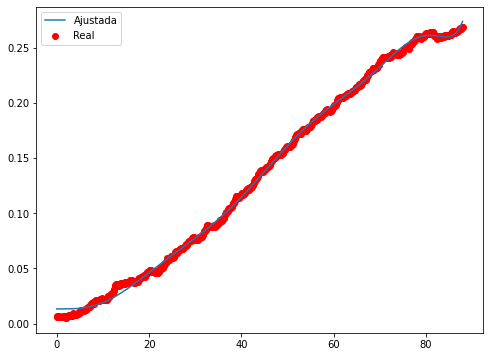

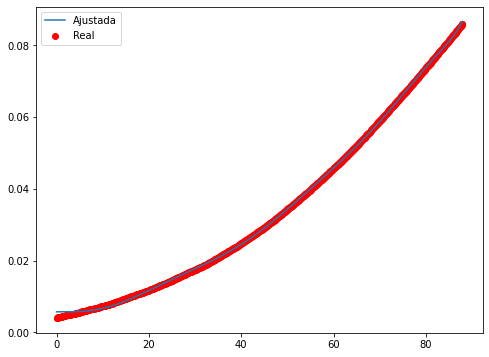

Epoch 1/500
32/32 - 1s - loss: 0.0031 - 1s/epoch - 36ms/step
Epoch 2/500
32/32 - 0s - loss: 4.4749e-04 - 93ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 1.0944e-04 - 83ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 4.2646e-05 - 84ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 2.2819e-05 - 77ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 1.5465e-05 - 77ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 1.1975e-05 - 79ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 1.0026e-05 - 77ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 8.7855e-06 - 81ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 8.0009e-06 - 83ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 7.4812e-06 - 83ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 7.1238e-06 - 99ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 6.8694e-06 - 77ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 6.6733e-06 - 87ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 6.5164e-06 - 84ms/epoch - 3ms/step
Epoch 16/

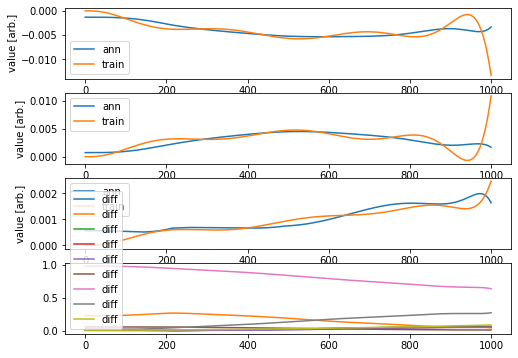

Validation loss: 0.11139970625601253
Testing loss: 0.31330106945728226


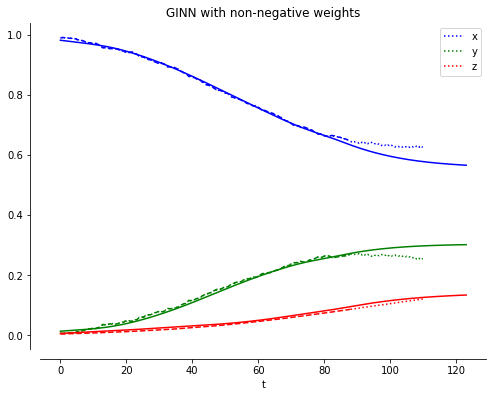

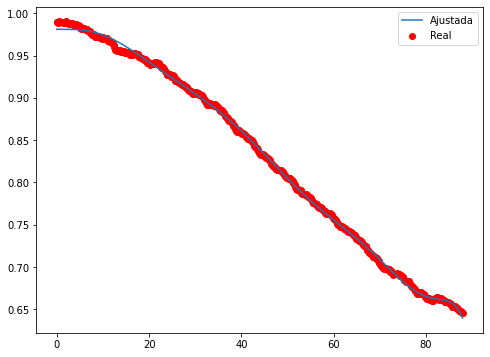

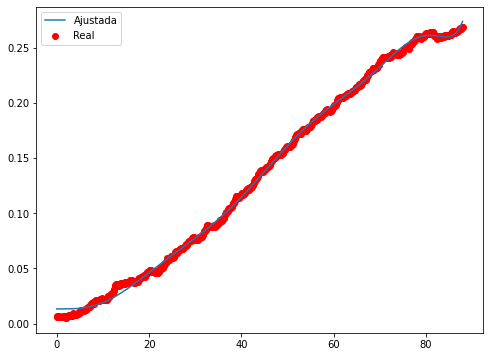

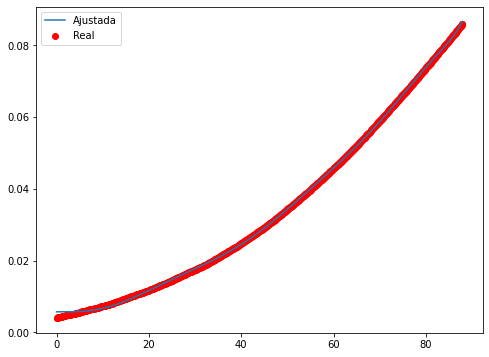

Epoch 1/500
32/32 - 1s - loss: 0.1000 - 1s/epoch - 37ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0094 - 104ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0021 - 81ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 9.3673e-04 - 80ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 5.9867e-04 - 82ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 4.4660e-04 - 86ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 3.6216e-04 - 81ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 3.0399e-04 - 85ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 2.5843e-04 - 86ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 2.2040e-04 - 98ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 1.8779e-04 - 81ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 1.5967e-04 - 88ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 1.3478e-04 - 82ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 1.1291e-04 - 78ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 9.3763e-05 - 82ms/epoch - 3ms/step
Epoch 16/500
32/

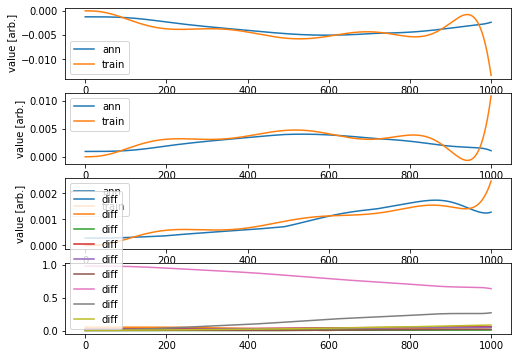

Validation loss: 0.07162904155559442
Testing loss: 0.04002378059786912


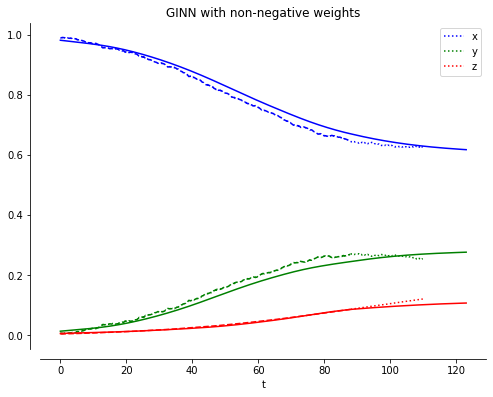

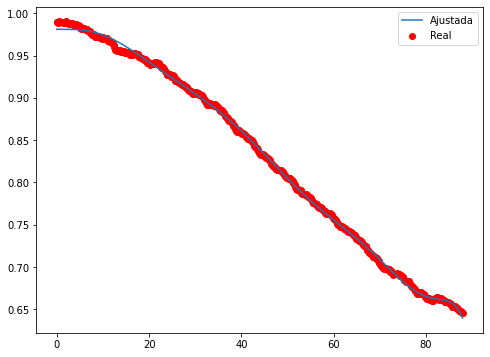

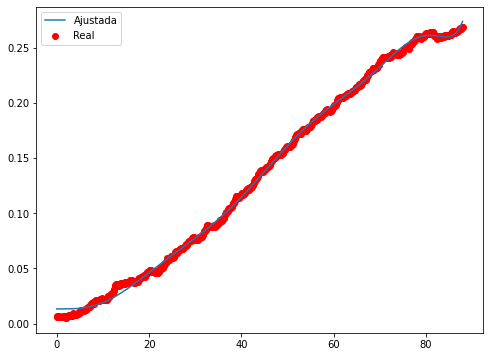

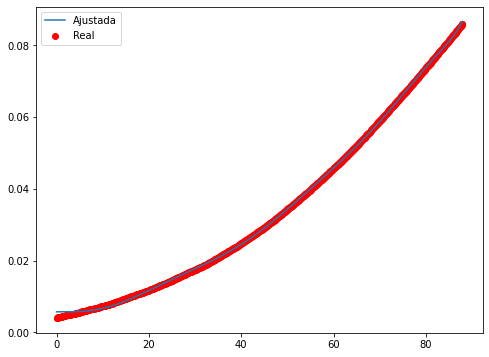

Epoch 1/500
32/32 - 1s - loss: 0.3220 - 1s/epoch - 37ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0492 - 91ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0133 - 81ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0059 - 85ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0033 - 98ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0022 - 87ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 0.0016 - 88ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 0.0013 - 85ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 0.0010 - 86ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 8.6480e-04 - 83ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 7.2854e-04 - 104ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 6.1767e-04 - 86ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 5.2787e-04 - 81ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 4.5182e-04 - 100ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 3.8746e-04 - 77ms/epoch - 2ms/step
Epoch 16/500
32/32 - 0s - loss: 3.3408e

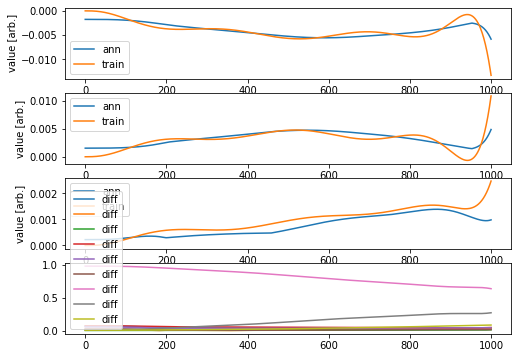

Validation loss: 2.1255898663090225
Testing loss: 21.33617324573429


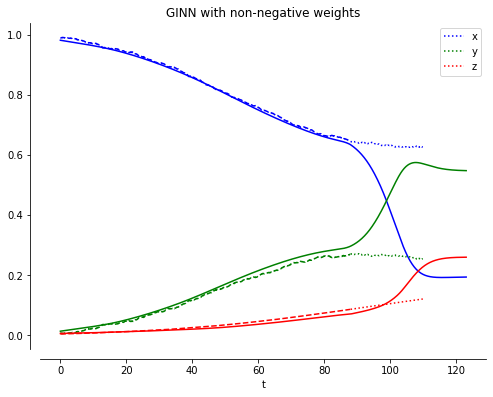

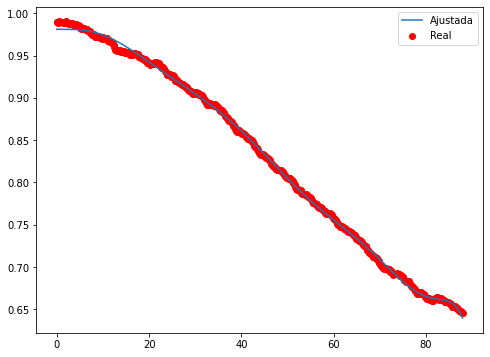

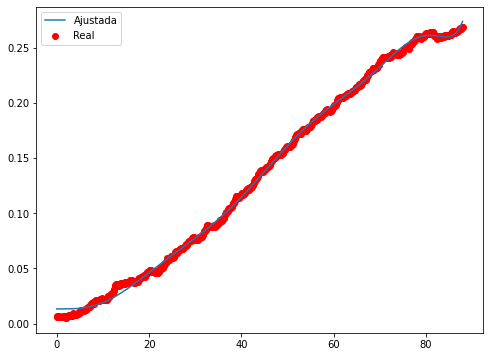

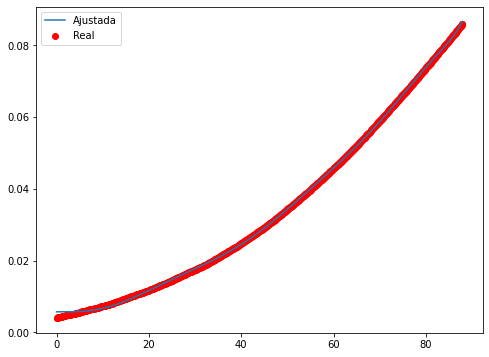

Epoch 1/500
32/32 - 1s - loss: 0.2805 - 1s/epoch - 38ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0367 - 101ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0084 - 96ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0036 - 101ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0020 - 96ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0014 - 105ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 0.0011 - 101ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 8.8371e-04 - 114ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 7.6199e-04 - 84ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 6.7229e-04 - 97ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 5.9797e-04 - 93ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 5.3480e-04 - 94ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 4.8028e-04 - 87ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 4.3242e-04 - 90ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 3.8982e-04 - 89ms/epoch - 3ms/step
Epoch 16/500
32/32 - 0s - lo

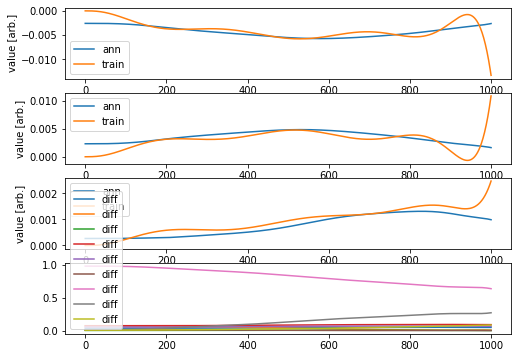

Validation loss: 0.9483182742110985
Testing loss: 1.8701249286392283


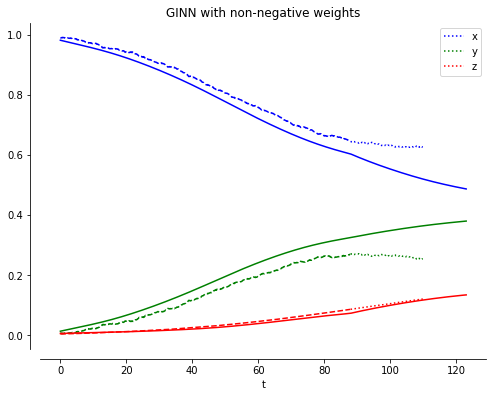

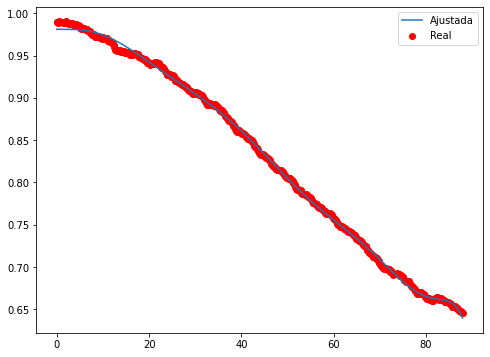

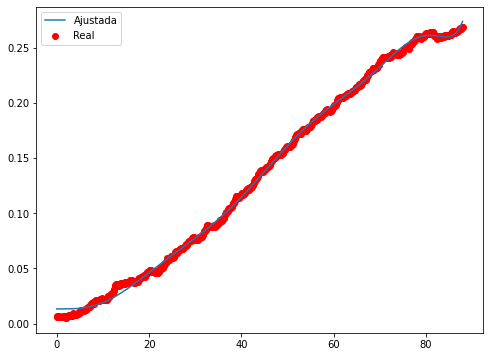

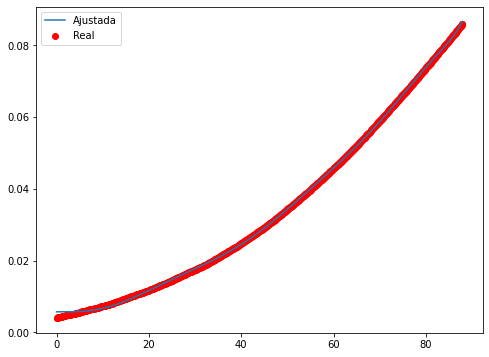

Epoch 1/500
32/32 - 1s - loss: 0.1686 - 1s/epoch - 37ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0166 - 106ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0038 - 98ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0018 - 103ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0011 - 93ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 7.9009e-04 - 92ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 6.2371e-04 - 92ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 5.1636e-04 - 88ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 4.3548e-04 - 85ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 3.6959e-04 - 92ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 3.1273e-04 - 91ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 2.6335e-04 - 95ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 2.2234e-04 - 83ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 1.8695e-04 - 89ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 1.5761e-04 - 77ms/epoch - 2ms/step
Epoch 16/500
32/32 - 0s

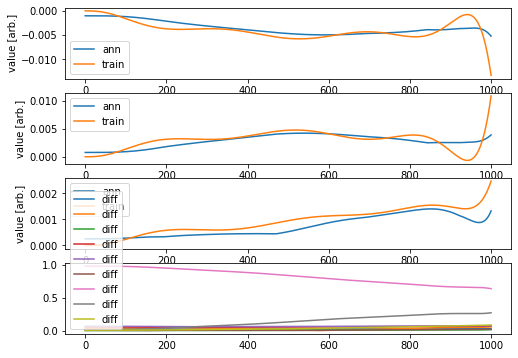

Validation loss: 0.08934719056014656
Testing loss: 1.5245723204353554


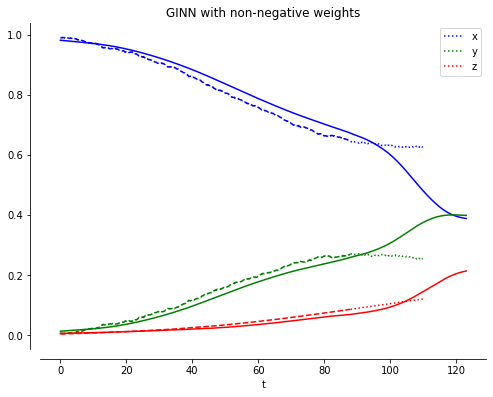

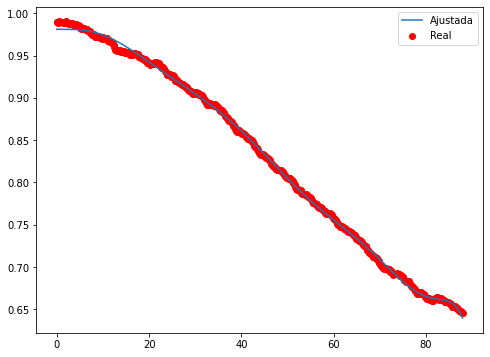

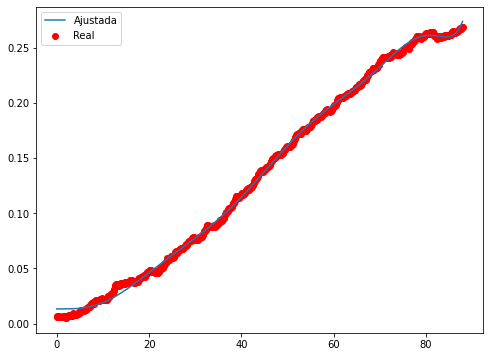

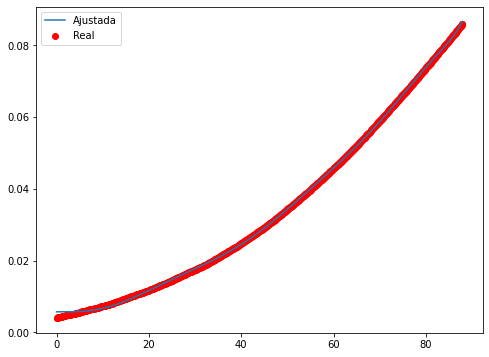

Epoch 1/500
32/32 - 1s - loss: 0.1161 - 1s/epoch - 37ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0106 - 103ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0026 - 106ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0013 - 107ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 8.9607e-04 - 105ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 6.6552e-04 - 96ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 5.1939e-04 - 85ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 4.1053e-04 - 87ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 3.2807e-04 - 100ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 2.6455e-04 - 86ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 2.1576e-04 - 91ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 1.7823e-04 - 92ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 1.5102e-04 - 89ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 1.2945e-04 - 90ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 1.1131e-04 - 90ms/epoch - 3ms/step
Epoch 16/500
32/

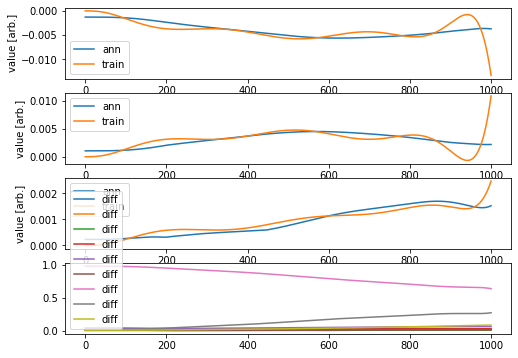

Validation loss: 0.15520578989992986
Testing loss: 0.7251842351817279


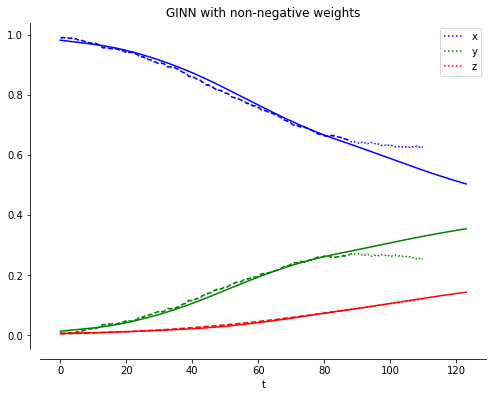

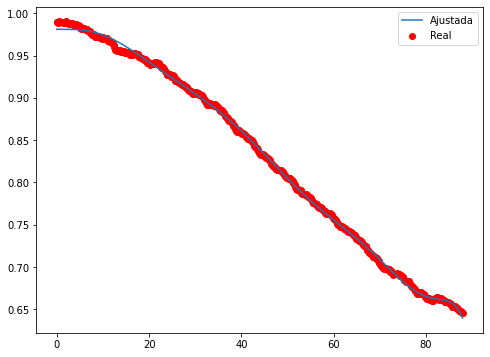

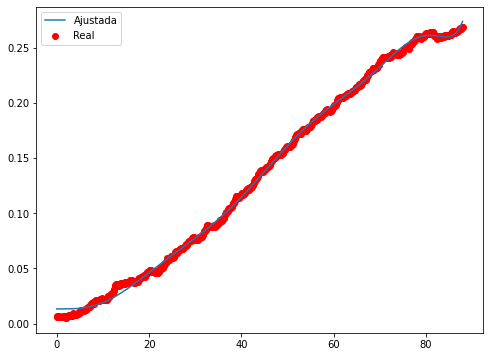

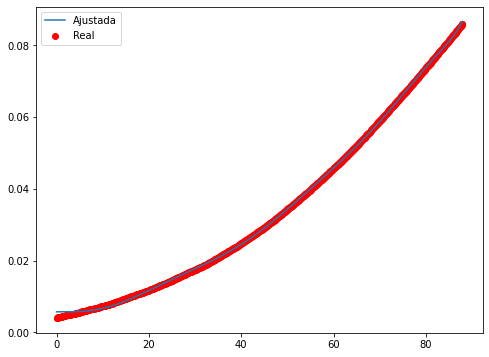

Epoch 1/500
32/32 - 1s - loss: 0.0999 - 1s/epoch - 37ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0143 - 91ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0034 - 94ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0014 - 92ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 8.0249e-04 - 83ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 5.6752e-04 - 89ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 4.4746e-04 - 91ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 3.7078e-04 - 90ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 3.1171e-04 - 89ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 2.6301e-04 - 91ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 2.2224e-04 - 94ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 1.8736e-04 - 90ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 1.5816e-04 - 84ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 1.3335e-04 - 91ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 1.1314e-04 - 91ms/epoch - 3ms/step
Epoch 16/500
32/32 - 

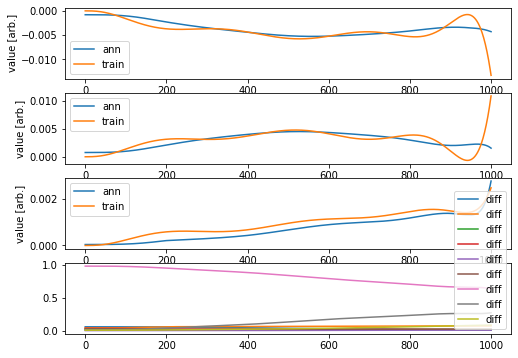

Validation loss: 0.04982433420896656
Testing loss: 0.4195979146259453


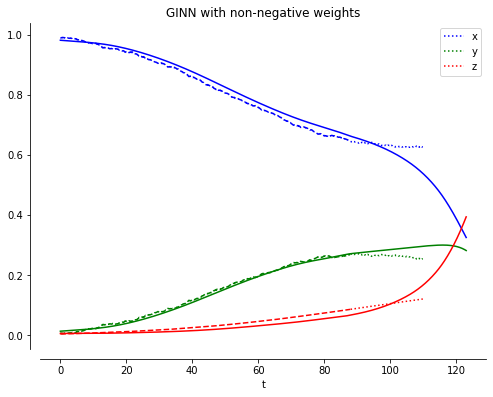

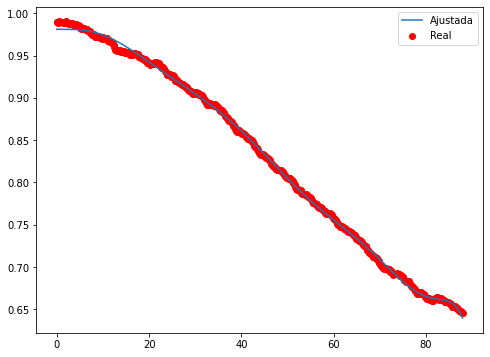

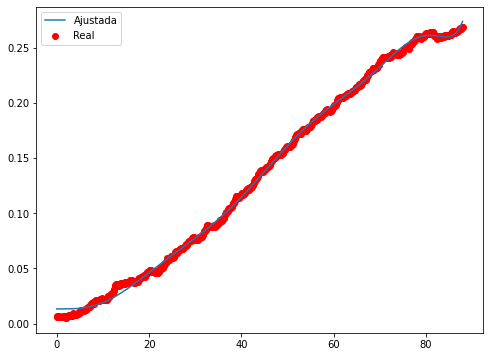

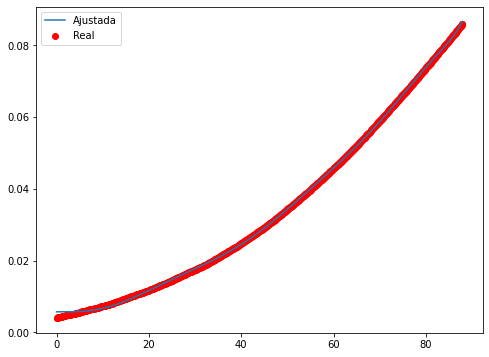

Epoch 1/500
32/32 - 1s - loss: 0.2758 - 1s/epoch - 37ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0435 - 97ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0113 - 87ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0047 - 94ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0025 - 81ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0016 - 102ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 0.0011 - 110ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 8.3929e-04 - 93ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 6.6638e-04 - 90ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 5.5717e-04 - 97ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 4.8045e-04 - 90ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 4.2112e-04 - 88ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 3.7063e-04 - 87ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 3.2730e-04 - 91ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 2.8954e-04 - 94ms/epoch - 3ms/step
Epoch 16/500
32/32 - 0s - loss:

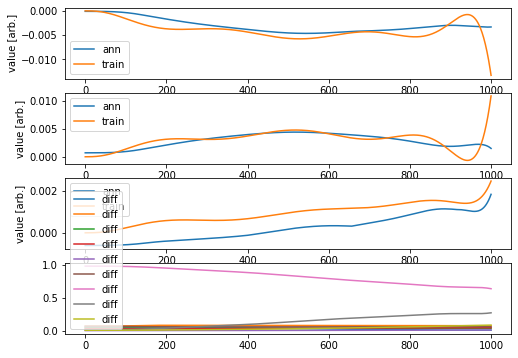

Validation loss: 0.7418133108521281
Testing loss: 0.4160226157778777


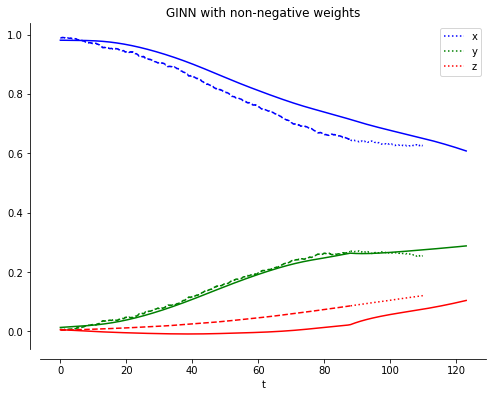

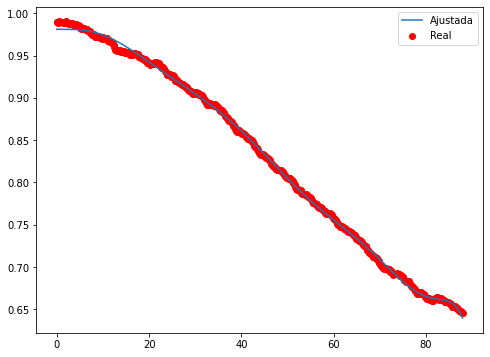

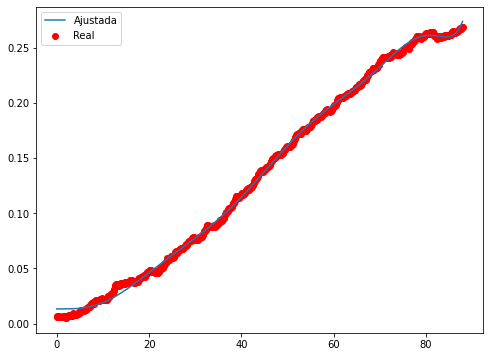

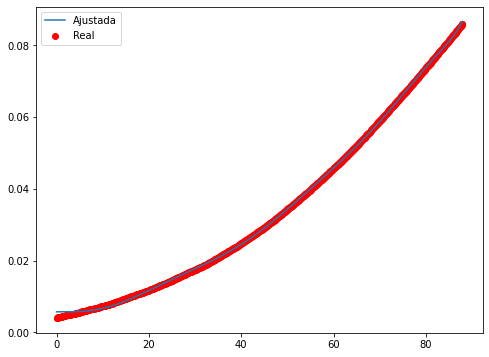

Epoch 1/500
32/32 - 1s - loss: 0.0737 - 1s/epoch - 37ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0075 - 100ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0016 - 83ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 7.1595e-04 - 95ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 4.6472e-04 - 89ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 3.4938e-04 - 89ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 2.7527e-04 - 94ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 2.2342e-04 - 91ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 1.8505e-04 - 104ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 1.5395e-04 - 116ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 1.2839e-04 - 96ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 1.0723e-04 - 102ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 9.0214e-05 - 95ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 7.6830e-05 - 103ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 6.6393e-05 - 91ms/epoch - 3ms/step
Epoch 16/500

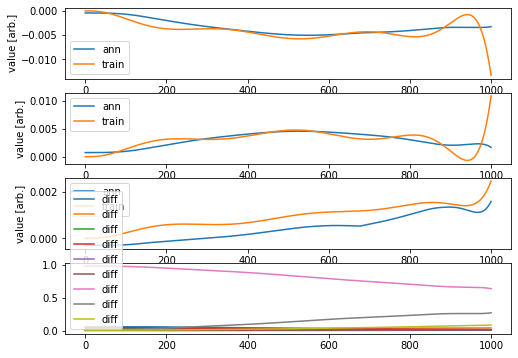

Validation loss: 0.2665601982393136
Testing loss: 0.17799614150857318


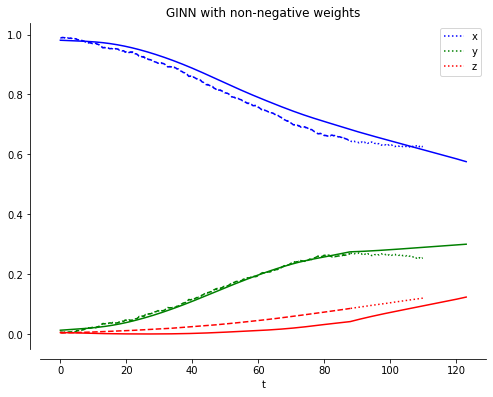

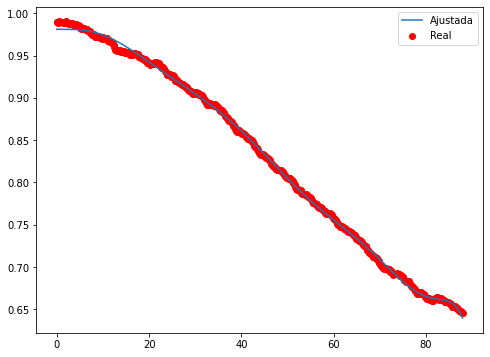

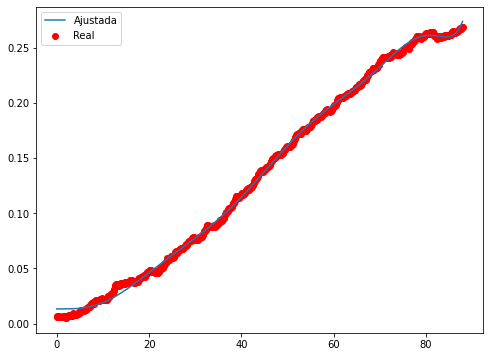

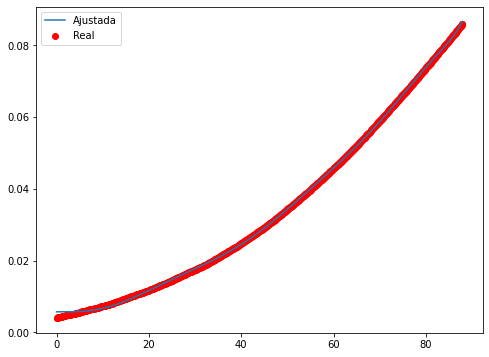

Epoch 1/500
32/32 - 1s - loss: 0.1993 - 1s/epoch - 37ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0241 - 87ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0058 - 92ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0024 - 91ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0013 - 107ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 7.9802e-04 - 90ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 5.5700e-04 - 95ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 4.2194e-04 - 95ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 3.4347e-04 - 92ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 2.9143e-04 - 85ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 2.5270e-04 - 88ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 2.2140e-04 - 88ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 1.9550e-04 - 101ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 1.7360e-04 - 89ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 1.5464e-04 - 99ms/epoch - 3ms/step
Epoch 16/500
32/32 - 0s

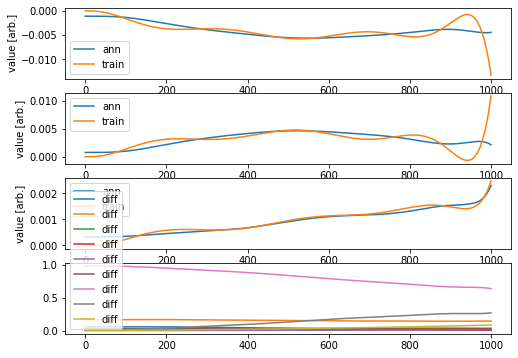

Validation loss: 0.24619209497220643
Testing loss: 2.0866583452518475


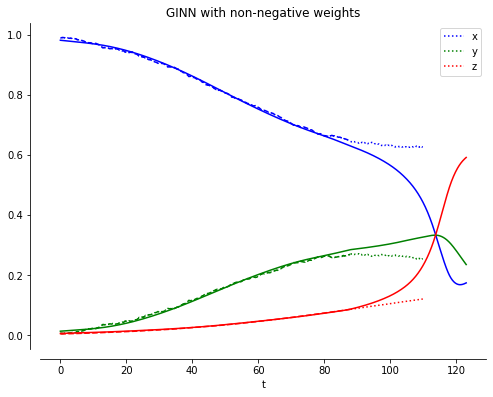

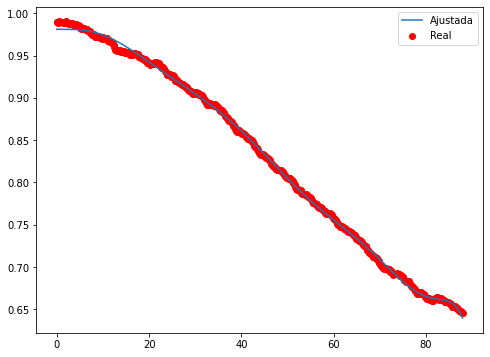

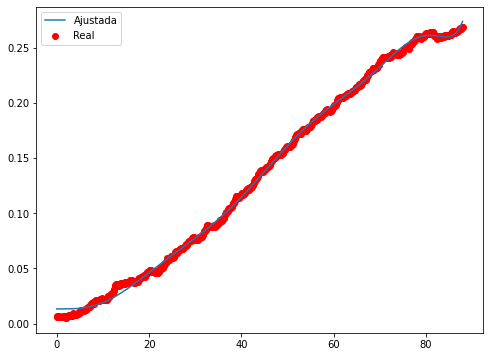

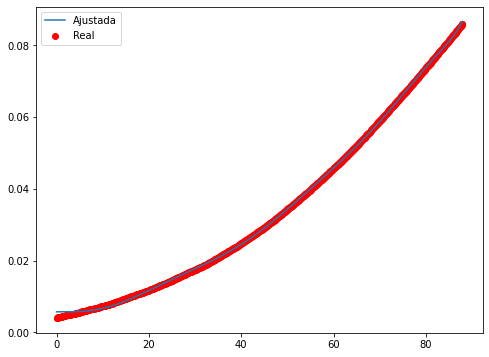

Epoch 1/500
32/32 - 1s - loss: 0.1352 - 1s/epoch - 38ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0147 - 94ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0033 - 93ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0014 - 103ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 7.8586e-04 - 87ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 5.3059e-04 - 97ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 3.9121e-04 - 87ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 3.0655e-04 - 85ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 2.5077e-04 - 88ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 2.1284e-04 - 87ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 1.8429e-04 - 90ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 1.6089e-04 - 87ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 1.4161e-04 - 98ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 1.2594e-04 - 88ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 1.1277e-04 - 109ms/epoch - 3ms/step
Epoch 16/500
32/32 

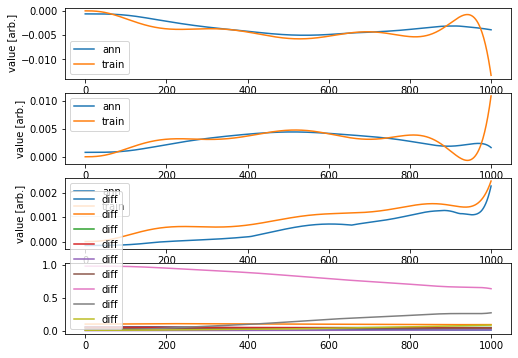

Validation loss: 0.20828300844914321
Testing loss: 0.12140611631989126


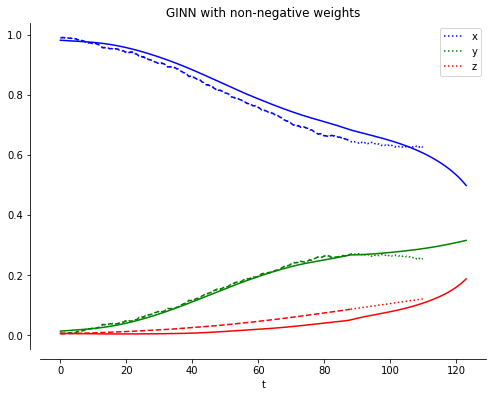

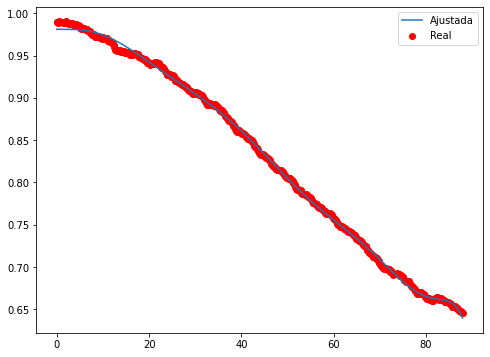

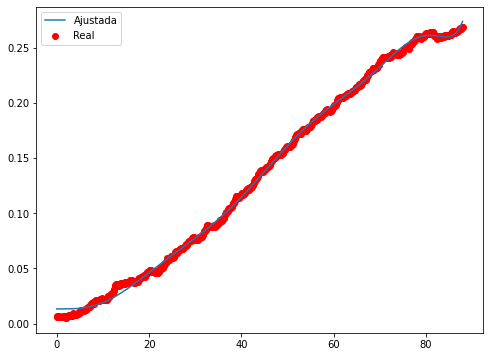

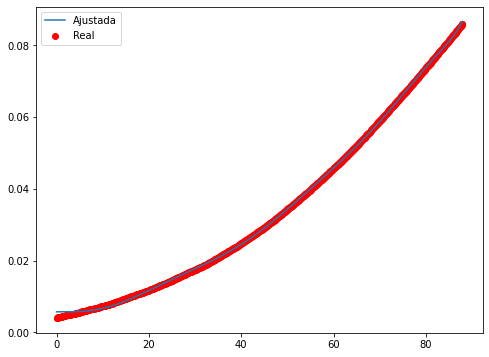

Epoch 1/500
32/32 - 1s - loss: 0.4594 - 1s/epoch - 37ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0609 - 99ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0159 - 87ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0088 - 108ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0062 - 83ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0048 - 87ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 0.0037 - 93ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 0.0029 - 101ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 0.0023 - 108ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 0.0018 - 98ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 0.0014 - 101ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 0.0011 - 98ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 9.1080e-04 - 94ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 7.3811e-04 - 109ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 6.0549e-04 - 111ms/epoch - 3ms/step
Epoch 16/500
32/32 - 0s - loss: 5.0549e-04 - 90

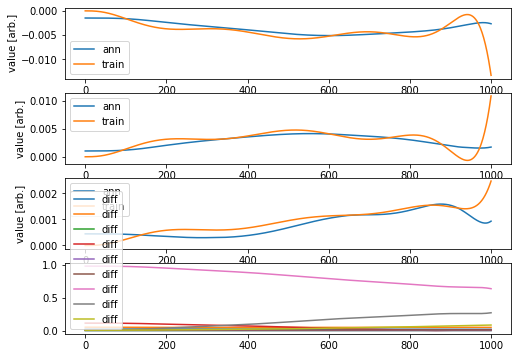

Validation loss: 0.053651551725344894
Testing loss: 0.128428202621763


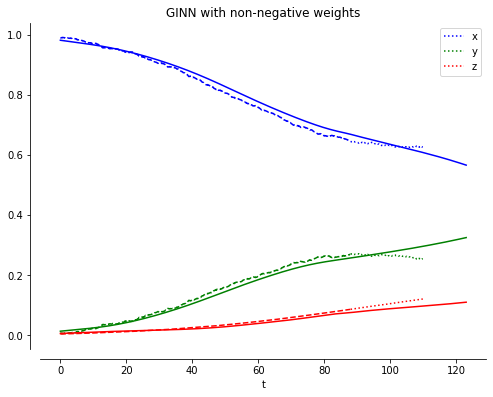

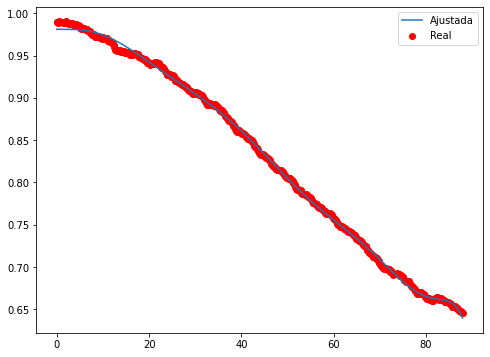

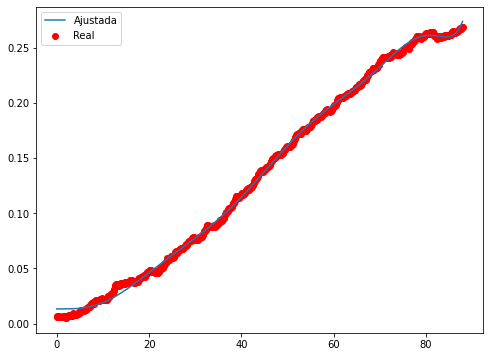

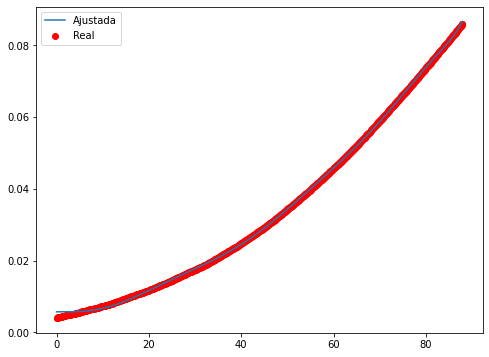

Epoch 1/500
32/32 - 2s - loss: 0.3163 - 2s/epoch - 63ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0254 - 107ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0053 - 107ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0032 - 119ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0023 - 100ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0017 - 103ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 0.0013 - 112ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 9.0869e-04 - 127ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 6.4346e-04 - 101ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 4.4600e-04 - 122ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 3.0029e-04 - 103ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 1.9499e-04 - 137ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 1.2447e-04 - 104ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 7.9148e-05 - 149ms/epoch - 5ms/step
Epoch 15/500
32/32 - 0s - loss: 5.0713e-05 - 167ms/epoch - 5ms/step
Epoch 16/500
32/32 

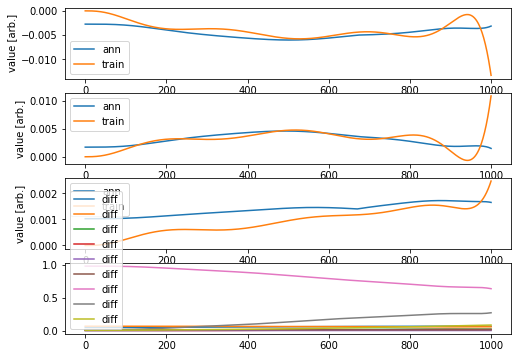

Validation loss: 1.1249166117668281
Testing loss: 2.9261536161252826


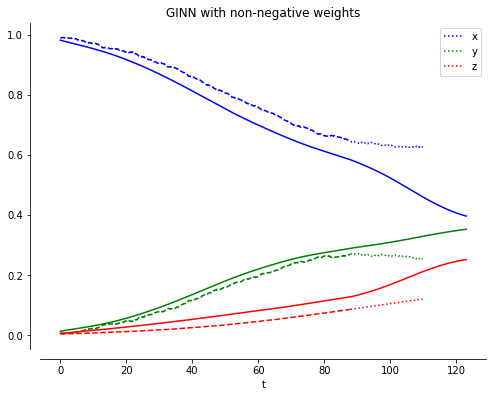

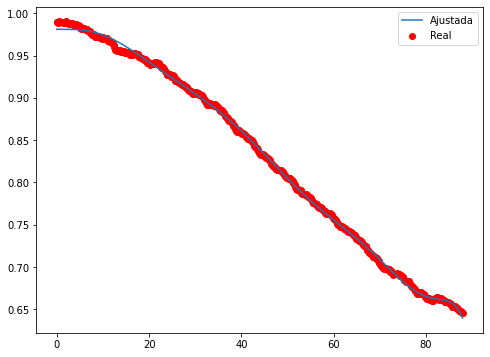

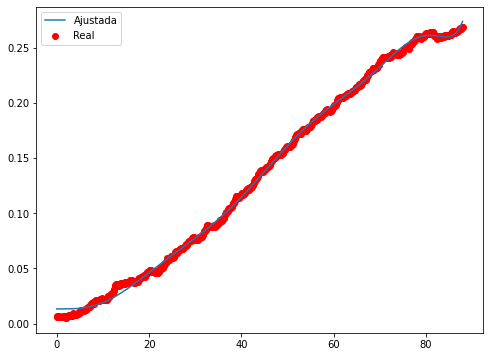

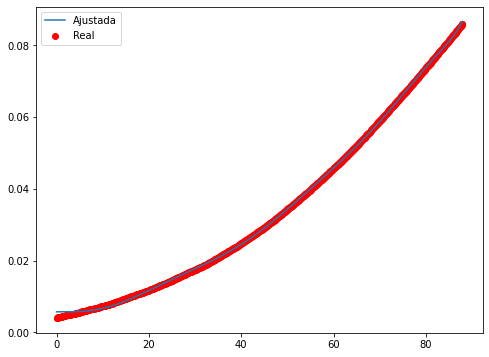

Epoch 1/500
32/32 - 1s - loss: 0.4355 - 1s/epoch - 37ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0461 - 138ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0134 - 105ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0068 - 108ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0043 - 89ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0029 - 97ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 0.0021 - 113ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 0.0015 - 101ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 0.0011 - 99ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 8.1792e-04 - 109ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 6.0314e-04 - 111ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 4.5267e-04 - 90ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 3.4443e-04 - 107ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 2.6589e-04 - 97ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 2.0650e-04 - 107ms/epoch - 3ms/step
Epoch 16/500
32/32 - 0s - loss: 

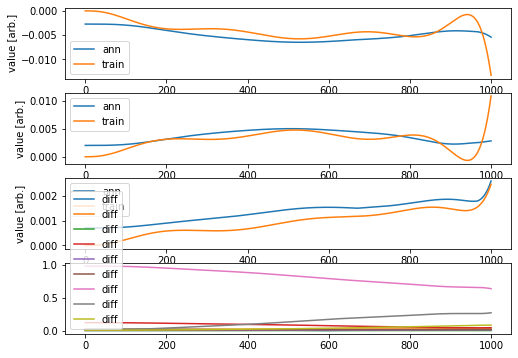

Validation loss: 3.5562875793937465
Testing loss: 7.321454350679854


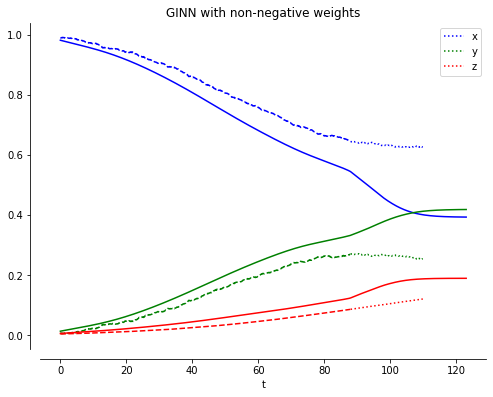

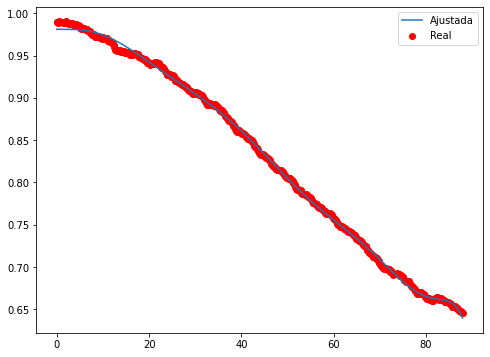

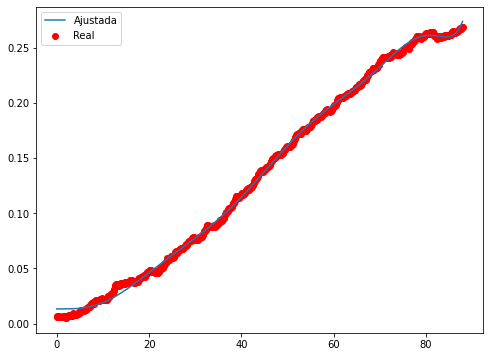

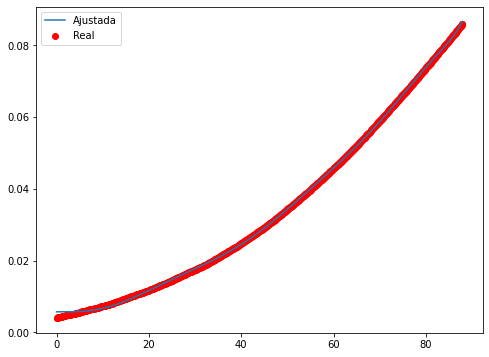

Epoch 1/500
32/32 - 1s - loss: 0.5535 - 1s/epoch - 38ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0680 - 104ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0156 - 109ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0077 - 106ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0054 - 103ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0042 - 103ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 0.0033 - 104ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 0.0027 - 99ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 0.0022 - 94ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 0.0018 - 97ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 0.0015 - 108ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 0.0012 - 109ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 0.0010 - 106ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 8.4244e-04 - 103ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 6.9868e-04 - 103ms/epoch - 3ms/step
Epoch 16/500
32/32 - 0s - loss: 5.7924e-04 - 1

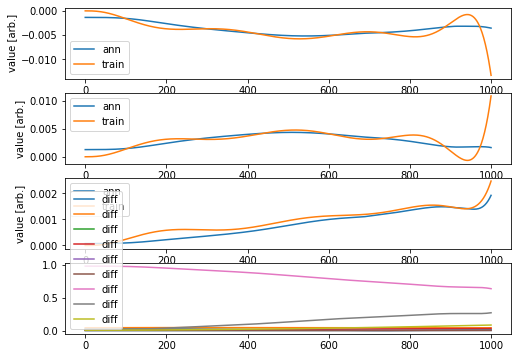

Validation loss: 0.038517020494583123
Testing loss: 0.3107809708438683


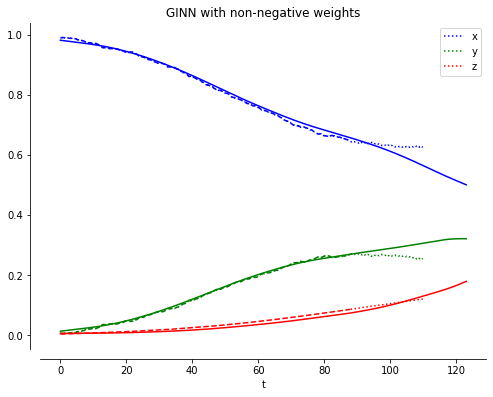

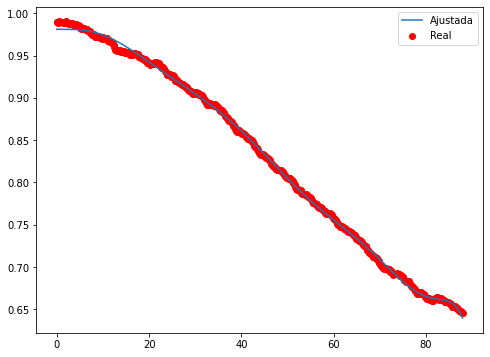

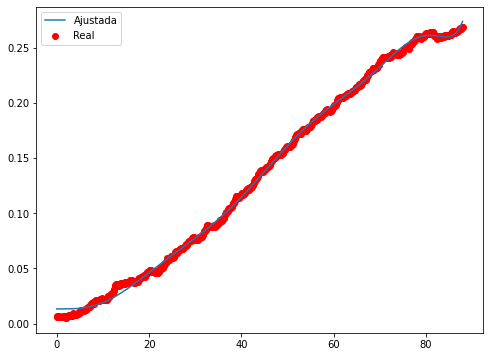

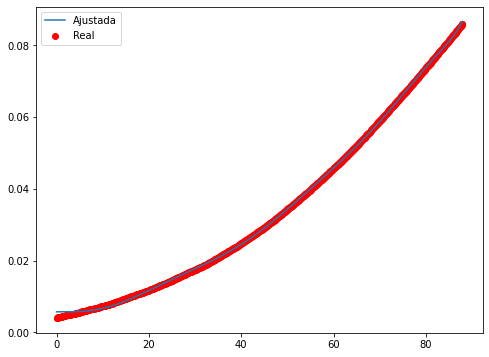

Epoch 1/500
32/32 - 1s - loss: 0.0989 - 1s/epoch - 39ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0053 - 108ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0020 - 99ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0013 - 111ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 8.7511e-04 - 101ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 5.8661e-04 - 111ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 3.9226e-04 - 98ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 2.6239e-04 - 120ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 1.7866e-04 - 100ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 1.2365e-04 - 102ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 8.8206e-05 - 137ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 6.5751e-05 - 116ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 5.0936e-05 - 101ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 4.0953e-05 - 110ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 3.4066e-05 - 131ms/epoch - 4ms/step
Epoch 16/

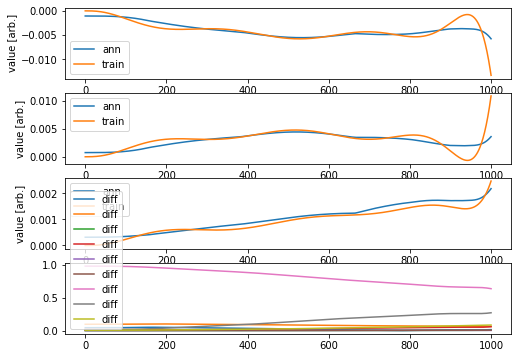

Validation loss: 0.4850165399208761
Testing loss: 3.80867729785404


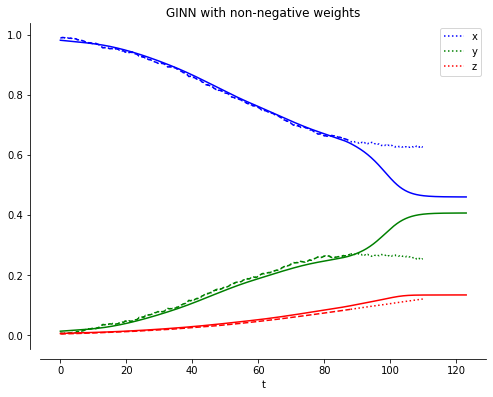

In [ ]:
iters = 5

# Initial population
Pob = [binaryRarray(6,0.5),binaryRarray(6,0.5),binaryRarray(6,0.5),binaryRarray(6,0.5),binaryRarray(6,0.5)]
totales = []
medias = []

for p in Pob:
  i12,i13,i21,i23,i31,i32 = p
  totali = []
  for _ in range(iters):
    total = train(Td,Xd,Yd,Zd,T0,X0,Y0,Z0,mode=2)
    while math.isnan(total):
      total = train(Td,Xd,Yd,Zd,T0,X0,Y0,Z0,mode=2)
    totali.append(total)
  totales.append(totali)
  medias.append(sum(totali)/len(totali))

In [ ]:
print(Pob)
print(medias)
print(totales)

[[0, 0, 1, 1, 1, 1], [0, 1, 0, 0, 0, 1], [0, 1, 1, 0, 0, 1], [1, 1, 0, 0, 1, 0], [1, 1, 1, 1, 1, 1]]
[0.8725232912620919, 0.06989518180235846, 0.6780180325071583, 0.30253458934435157, 1.0516778606602757]
[[1.4919847228208254, 0.6505192433420056, 0.46678561466619967, 0.45032091056790186, 1.3030059649135273], [0.017174328856202202, 0.06456911779942323, 0.12205517082541528, 0.034277585274738995, 0.11139970625601253], [0.07162904155559442, 2.1255898663090225, 0.9483182742110985, 0.08934719056014656, 0.15520578989992986], [0.04982433420896656, 0.7418133108521281, 0.2665601982393136, 0.24619209497220643, 0.20828300844914321], [0.053651551725344894, 1.1249166117668281, 3.5562875793937465, 0.038517020494583123, 0.4850165399208761]]


____________________________
Iteración =  0
Min =  0.06989518180235846
[[0, 0, 1, 1, 1, 1], [0, 1, 0, 0, 0, 1], [0, 1, 1, 0, 0, 1], [1, 1, 0, 0, 1, 0], [1, 1, 1, 1, 1, 1]]
[0.8725232912620919, 0.06989518180235846, 0.6780180325071583, 0.30253458934435157, 1.0516778606602757]


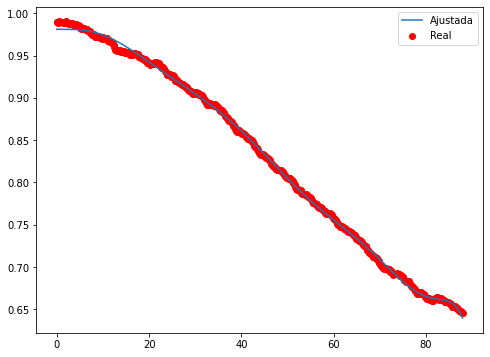

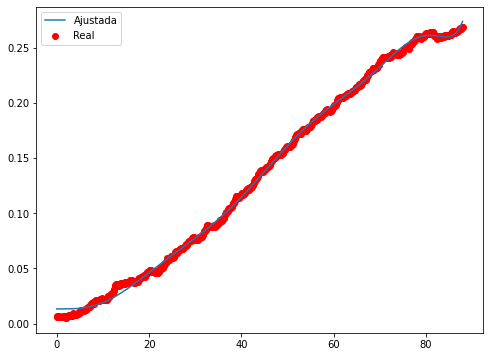

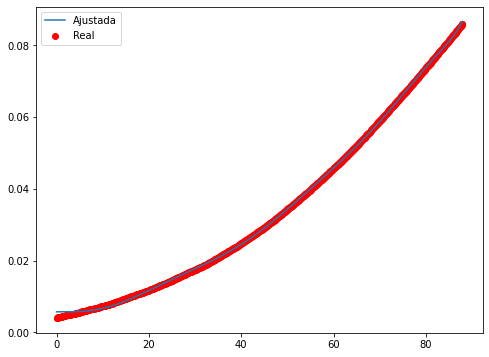

Epoch 1/500
32/32 - 1s - loss: 0.0038 - 1s/epoch - 38ms/step
Epoch 2/500
32/32 - 0s - loss: 2.8976e-04 - 71ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 3.6289e-05 - 72ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 1.3263e-05 - 63ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 9.4962e-06 - 66ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 8.5153e-06 - 64ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 8.0215e-06 - 70ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 7.6610e-06 - 66ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 7.3646e-06 - 75ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 7.0906e-06 - 71ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 6.8454e-06 - 68ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 6.6258e-06 - 85ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 6.4294e-06 - 70ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 6.2527e-06 - 63ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 6.0866e-06 - 80ms/epoch - 3ms/step
Epoch 16/

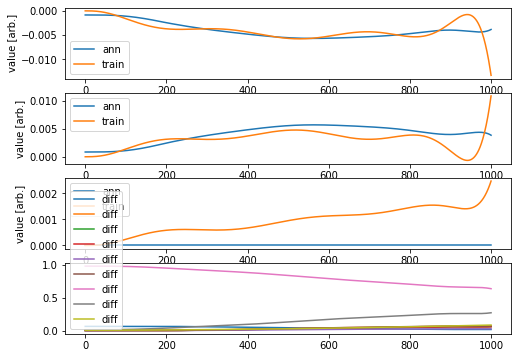

Validation loss: 1.4614219711089949
Testing loss: 1.949405945482434


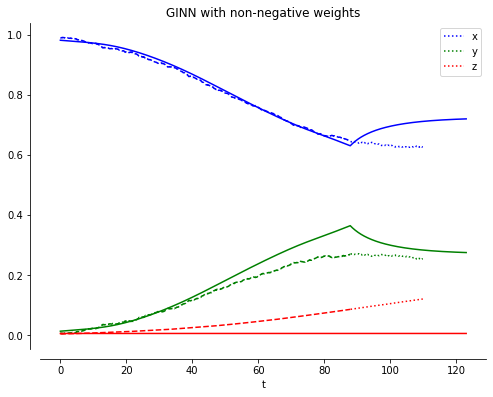

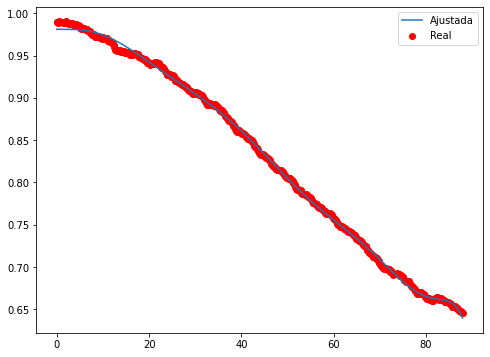

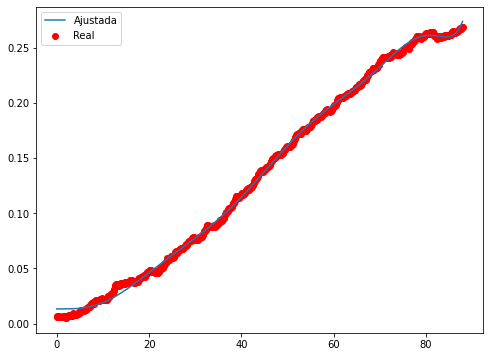

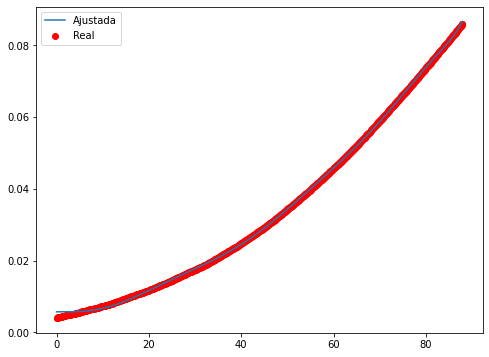

Epoch 1/500
32/32 - 1s - loss: 0.0093 - 1s/epoch - 39ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0012 - 77ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 2.1867e-04 - 72ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 5.8514e-05 - 78ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 2.3278e-05 - 87ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.3600e-05 - 79ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 1.0728e-05 - 71ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 9.8175e-06 - 66ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 9.4174e-06 - 78ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 9.1686e-06 - 70ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 8.9684e-06 - 67ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 8.7933e-06 - 77ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 8.6224e-06 - 80ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 8.4747e-06 - 76ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 8.3481e-06 - 68ms/epoch - 2ms/step
Epoch 16/500


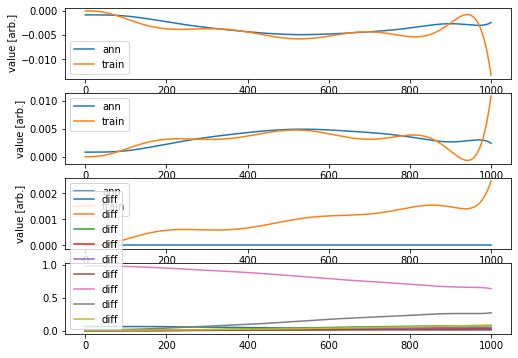

Validation loss: 1.4688243837334332
Testing loss: 2.2035210765600928


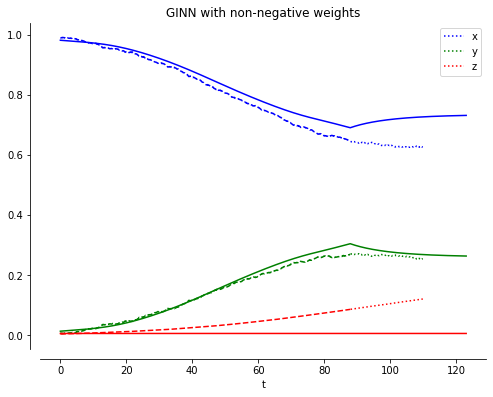

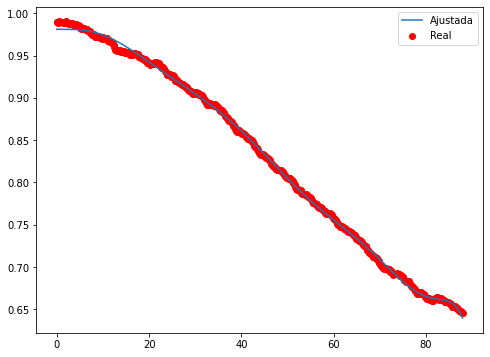

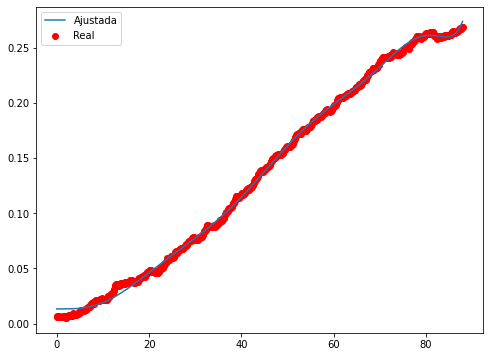

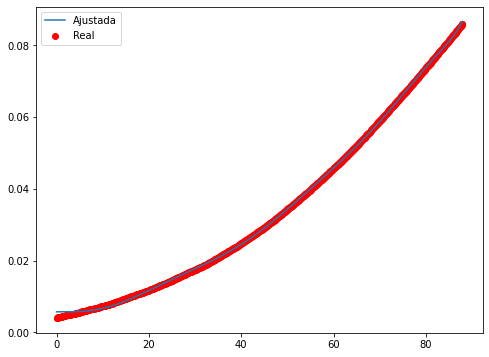

Epoch 1/500
32/32 - 1s - loss: 0.0076 - 1s/epoch - 38ms/step
Epoch 2/500
32/32 - 0s - loss: 9.2263e-04 - 70ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 1.7221e-04 - 76ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 5.7773e-05 - 71ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 2.8237e-05 - 73ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 1.9031e-05 - 76ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 1.5819e-05 - 68ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 1.4481e-05 - 79ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 1.3644e-05 - 68ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 1.3032e-05 - 74ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 1.2468e-05 - 66ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 1.1946e-05 - 74ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 1.1450e-05 - 79ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 1.0990e-05 - 69ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 1.0572e-05 - 82ms/epoch - 3ms/step
Epoch 16/

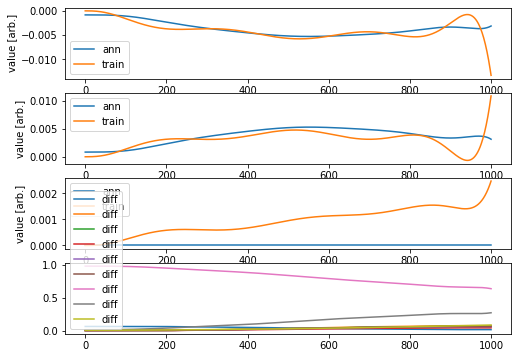

Validation loss: 1.373873105203582
Testing loss: 1.9948756926127555


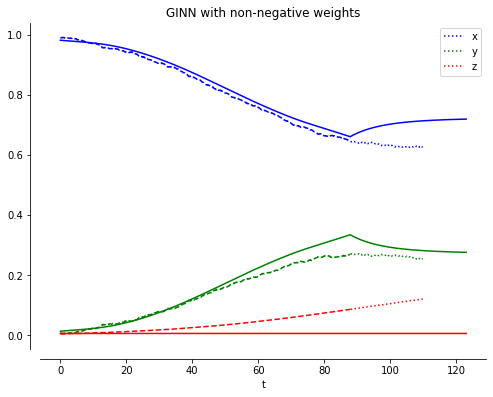

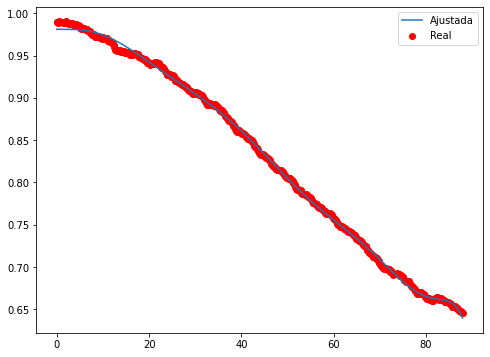

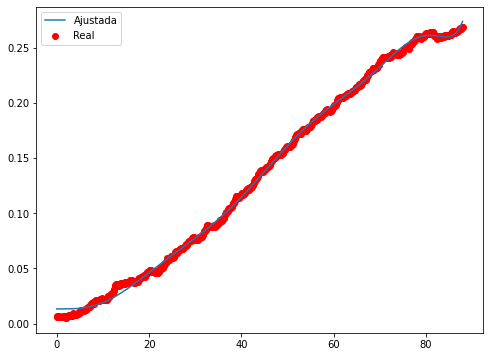

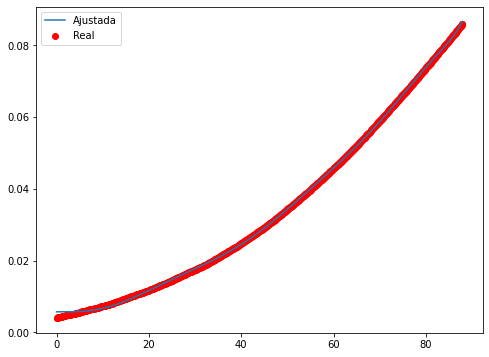

Epoch 1/500
32/32 - 2s - loss: 0.0092 - 2s/epoch - 50ms/step
Epoch 2/500
32/32 - 0s - loss: 9.9105e-04 - 69ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 1.7617e-04 - 77ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 6.2244e-05 - 80ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 3.8007e-05 - 74ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 2.9862e-05 - 75ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 2.5723e-05 - 76ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 2.3049e-05 - 77ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 2.0988e-05 - 78ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 1.9188e-05 - 77ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 1.7656e-05 - 89ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 1.6316e-05 - 95ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 1.5192e-05 - 74ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 1.4279e-05 - 85ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 1.3522e-05 - 82ms/epoch - 3ms/step
Epoch 16/

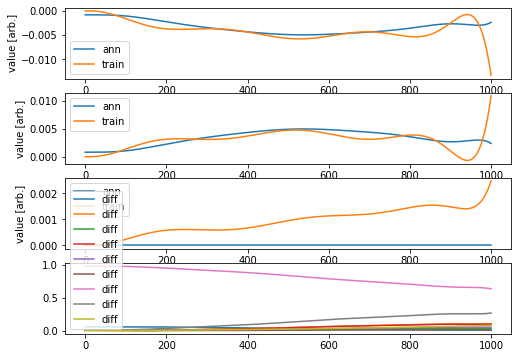

Validation loss: 1.4296056326254953
Testing loss: 2.113204340875341


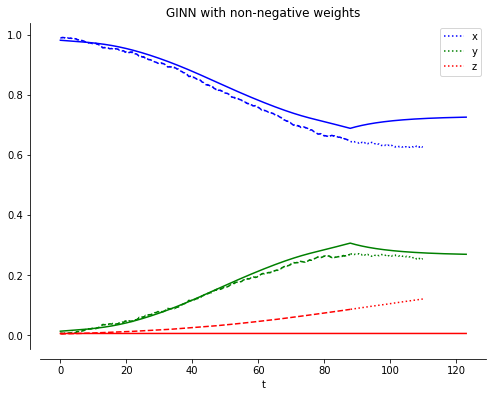

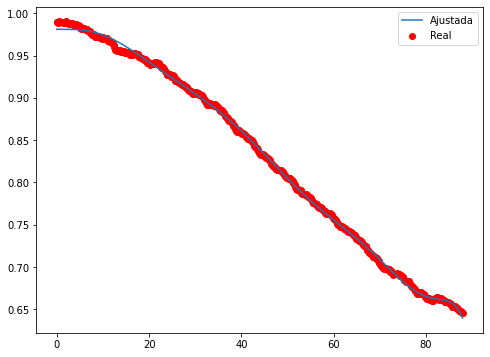

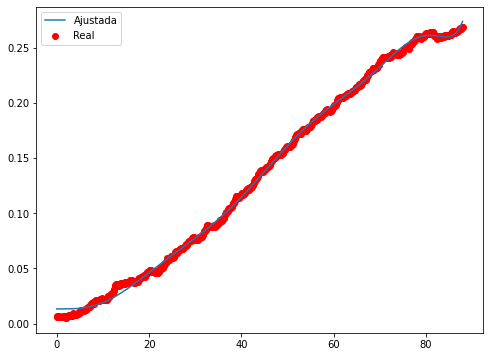

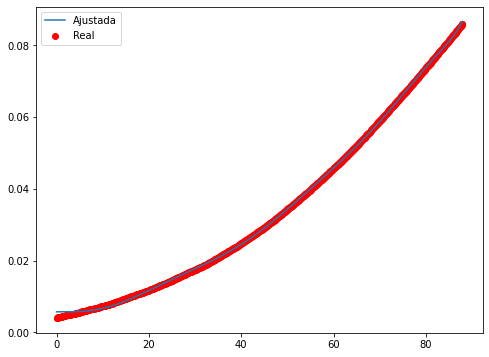

Epoch 1/500
32/32 - 1s - loss: 0.0044 - 1s/epoch - 37ms/step
Epoch 2/500
32/32 - 0s - loss: 4.6272e-04 - 75ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 9.0342e-05 - 82ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 4.6908e-05 - 67ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 3.6739e-05 - 87ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 3.1620e-05 - 85ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 2.7983e-05 - 73ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 2.4832e-05 - 84ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 2.2078e-05 - 78ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 1.9642e-05 - 77ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 1.7561e-05 - 78ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 1.5807e-05 - 66ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 1.4380e-05 - 85ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 1.3240e-05 - 80ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 1.2327e-05 - 72ms/epoch - 2ms/step
Epoch 16/

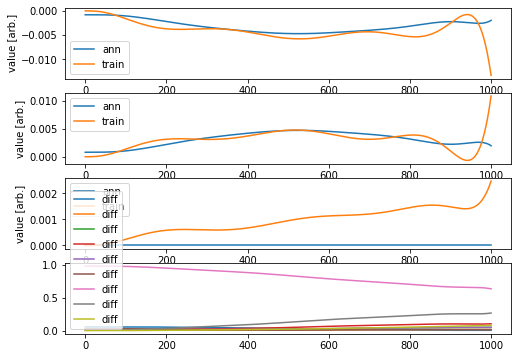

Validation loss: 1.6266859615065645
Testing loss: 2.3612594554239035


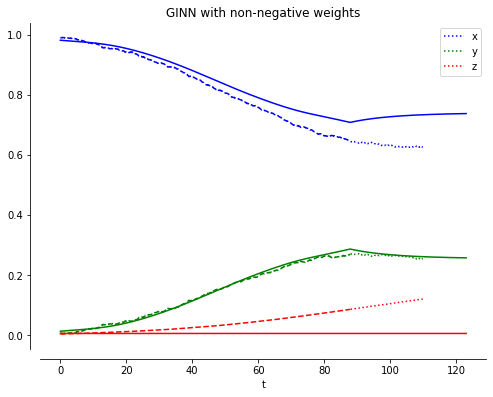

____________________________
Iteración =  1
Min =  0.06989518180235846
[[0, 0, 1, 1, 1, 1], [0, 1, 0, 0, 0, 1], [0, 1, 1, 0, 0, 1], [1, 1, 0, 0, 1, 0], [1, 1, 1, 1, 1, 1]]
[0.8725232912620919, 0.06989518180235846, 0.6780180325071583, 0.30253458934435157, 1.0516778606602757]


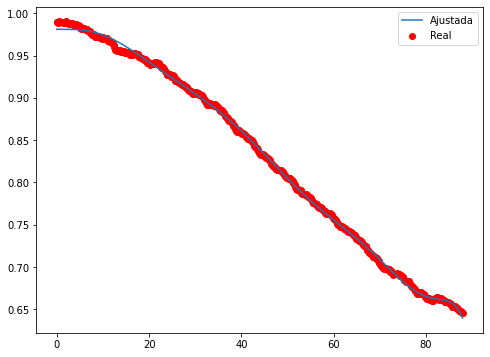

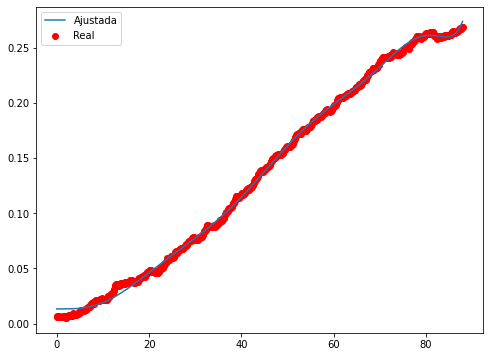

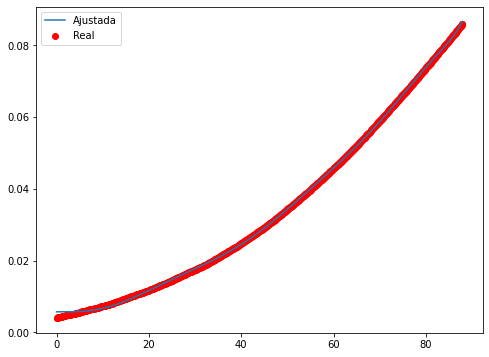

Epoch 1/500
32/32 - 1s - loss: 0.6719 - 1s/epoch - 38ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0787 - 88ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0137 - 82ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0043 - 87ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0023 - 94ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0017 - 82ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 0.0014 - 83ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 0.0012 - 87ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 0.0011 - 102ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 0.0010 - 78ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 9.0121e-04 - 79ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 8.0807e-04 - 91ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 7.2863e-04 - 84ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 6.6100e-04 - 77ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 6.0211e-04 - 81ms/epoch - 3ms/step
Epoch 16/500
32/32 - 0s - loss: 5.4889e-04 -

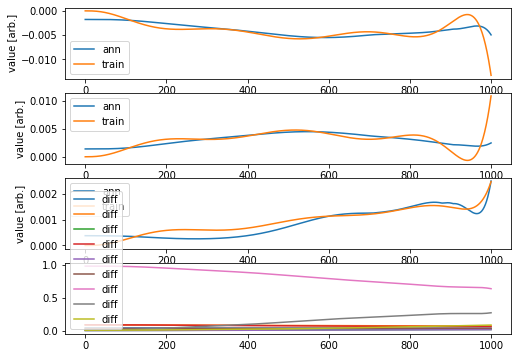

Validation loss: 0.3828622380484342
Testing loss: 3.3360450793426053


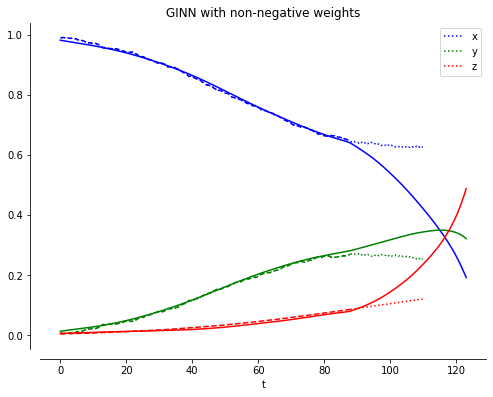

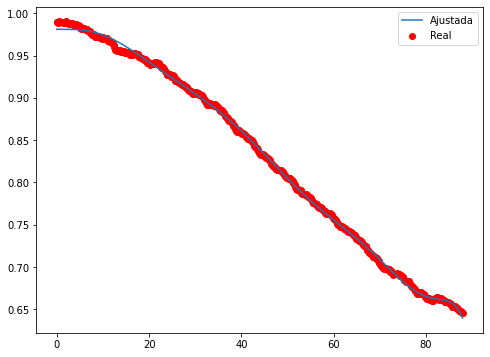

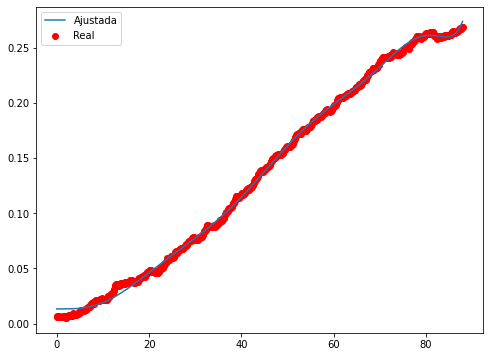

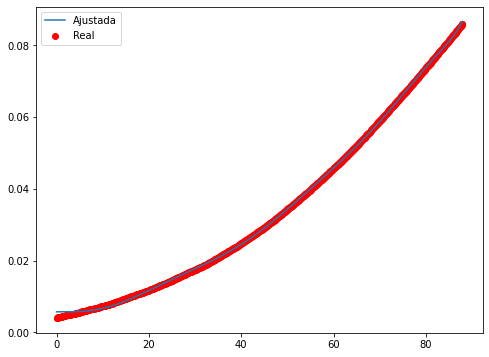

Epoch 1/500
32/32 - 1s - loss: 0.4371 - 1s/epoch - 37ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0462 - 91ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0076 - 84ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0025 - 91ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0015 - 81ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0012 - 79ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 0.0010 - 73ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 8.8496e-04 - 92ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 7.7931e-04 - 81ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 6.8243e-04 - 83ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 5.9305e-04 - 72ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 5.1164e-04 - 85ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 4.3733e-04 - 91ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 3.7144e-04 - 80ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 3.1498e-04 - 83ms/epoch - 3ms/step
Epoch 16/500
32/32 - 0s - loss: 2

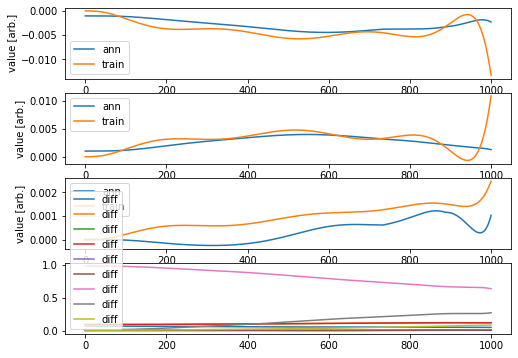

Validation loss: 0.4070108897218318
Testing loss: 0.1567695810381005


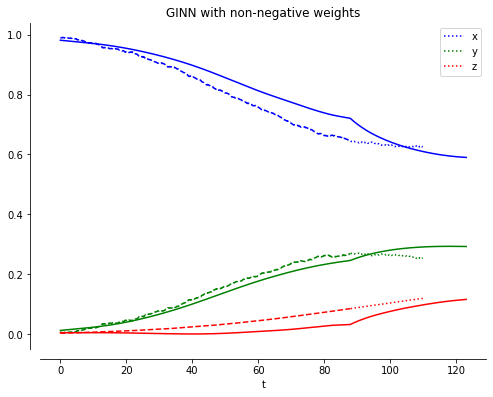

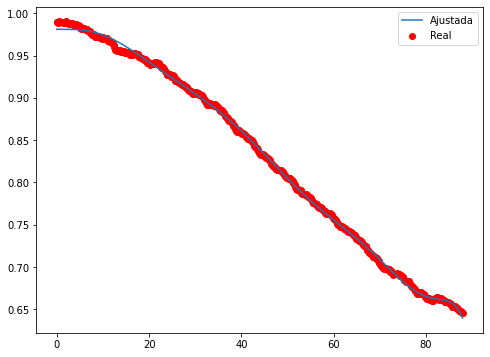

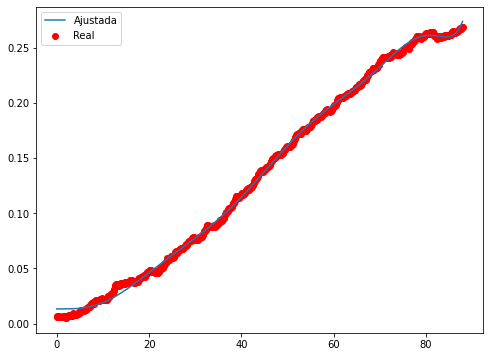

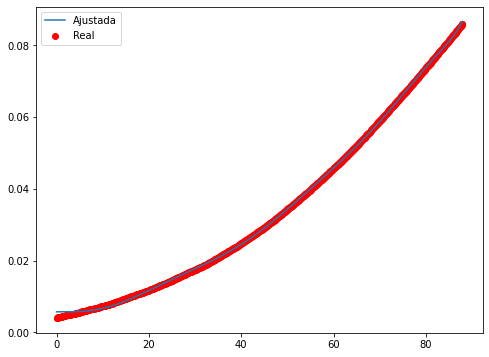

Epoch 1/500
32/32 - 1s - loss: 0.3298 - 1s/epoch - 37ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0262 - 78ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0035 - 81ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0012 - 87ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 6.5316e-04 - 72ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 4.9343e-04 - 82ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 4.2408e-04 - 77ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 3.7943e-04 - 90ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 3.4367e-04 - 85ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 3.1311e-04 - 91ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 2.8651e-04 - 89ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 2.6224e-04 - 86ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 2.4173e-04 - 85ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 2.2346e-04 - 85ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 2.0816e-04 - 82ms/epoch - 3ms/step
Epoch 16/500
32/32 - 

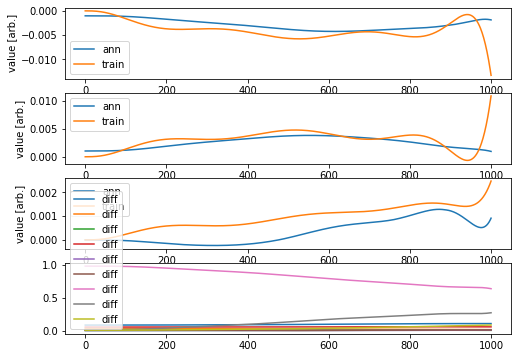

Validation loss: 0.6808389478316392
Testing loss: 0.23656665621630477


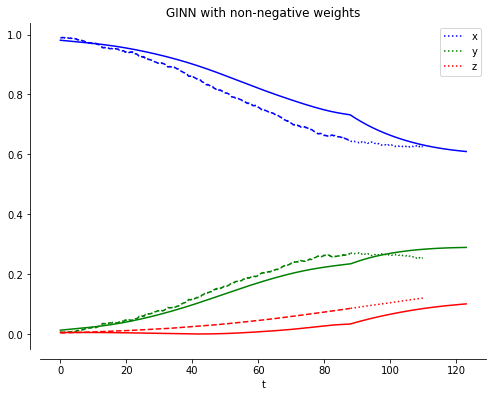

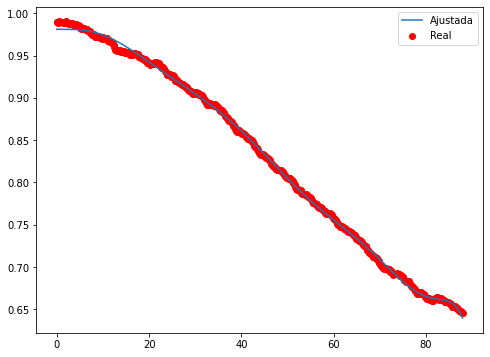

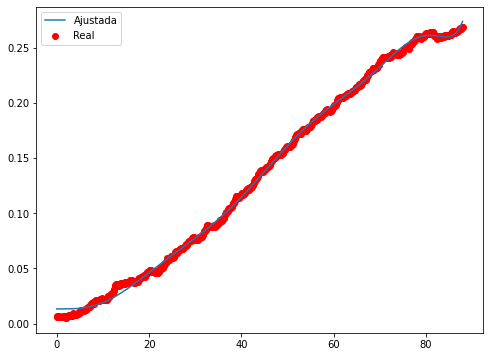

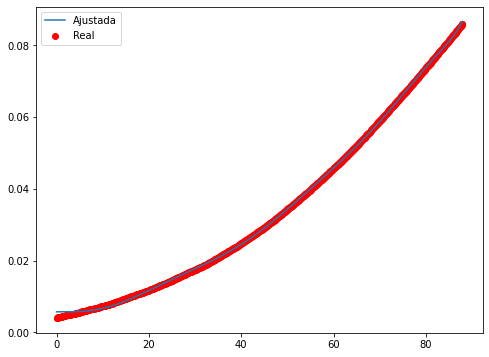

Epoch 1/500
32/32 - 1s - loss: 0.8795 - 1s/epoch - 38ms/step
Epoch 2/500
32/32 - 0s - loss: 0.1251 - 96ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0253 - 81ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0076 - 83ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0034 - 78ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0021 - 80ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 0.0016 - 82ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 0.0014 - 84ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 0.0013 - 79ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 0.0012 - 81ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 0.0011 - 90ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 9.6361e-04 - 78ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 8.7206e-04 - 94ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 7.8942e-04 - 92ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 7.1059e-04 - 86ms/epoch - 3ms/step
Epoch 16/500
32/32 - 0s - loss: 6.3644e-04 - 84ms

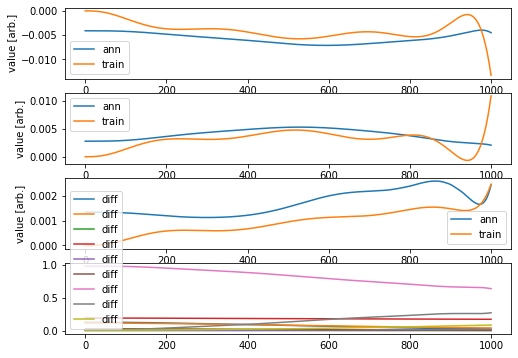

Validation loss: 8.830059883779848
Testing loss: 33.81850039586644


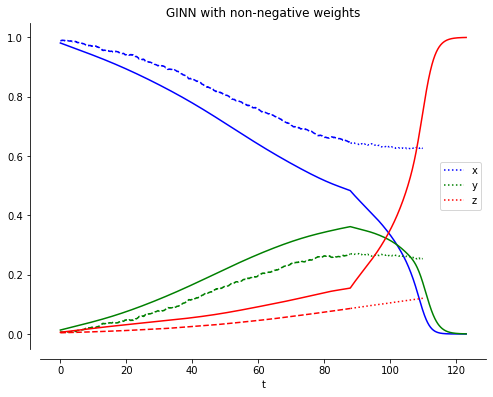

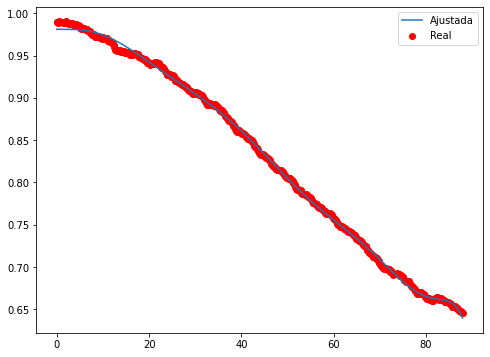

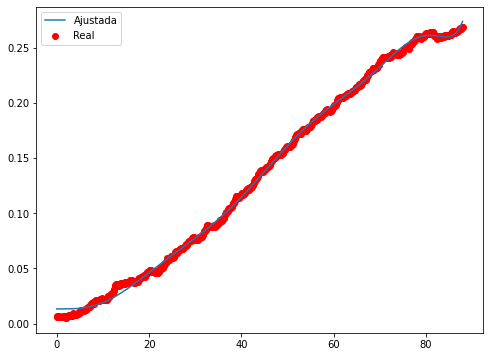

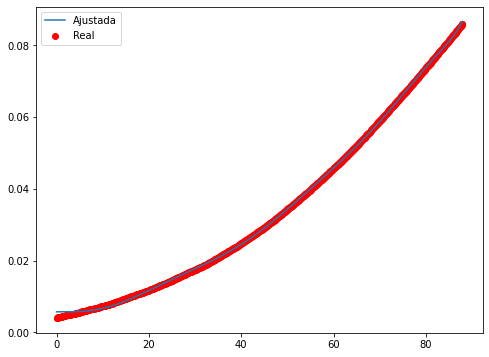

Epoch 1/500
32/32 - 1s - loss: 0.6817 - 1s/epoch - 41ms/step
Epoch 2/500
32/32 - 0s - loss: 0.1067 - 107ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0219 - 82ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0066 - 91ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0030 - 101ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0019 - 80ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 0.0016 - 90ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 0.0014 - 84ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 0.0013 - 90ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 0.0012 - 89ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 0.0011 - 103ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 0.0010 - 82ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 9.5086e-04 - 102ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 8.8184e-04 - 91ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 8.1766e-04 - 98ms/epoch - 3ms/step
Epoch 16/500
32/32 - 0s - loss: 7.5625e-04 - 92ms

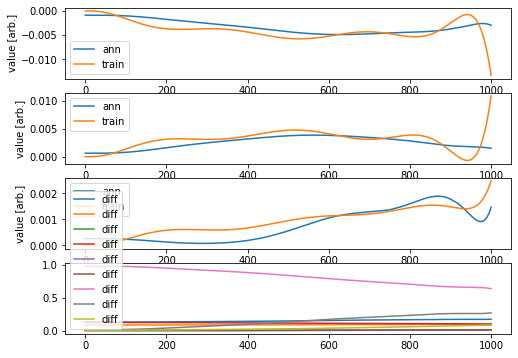

Validation loss: 0.3128464063534163
Testing loss: 0.1594266404041101


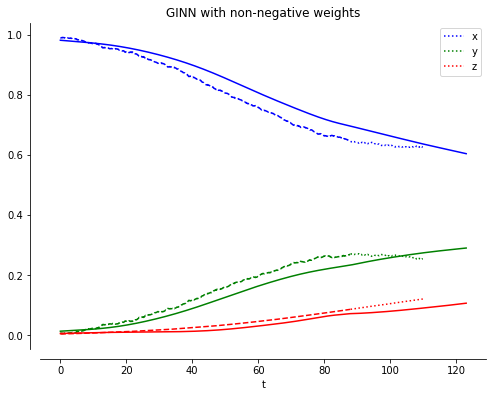

____________________________
Iteración =  2
Min =  0.06989518180235846
[[0, 0, 1, 1, 1, 1], [0, 1, 0, 0, 0, 1], [0, 1, 1, 0, 0, 1], [1, 1, 0, 0, 1, 0], [1, 1, 1, 1, 1, 1]]
[0.8725232912620919, 0.06989518180235846, 0.6780180325071583, 0.30253458934435157, 1.0516778606602757]


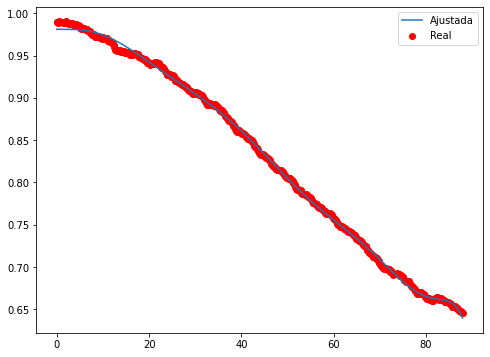

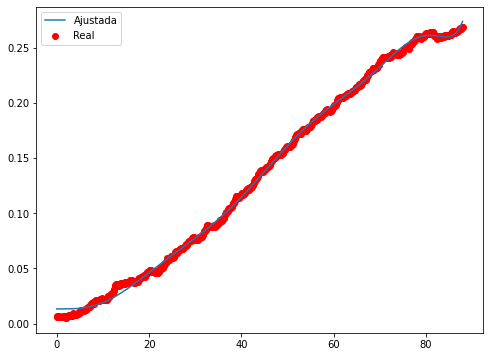

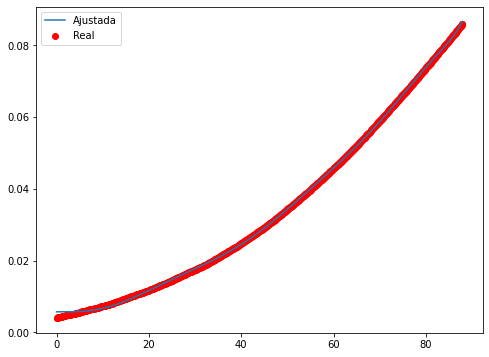

Epoch 1/500
32/32 - 1s - loss: 0.6121 - 1s/epoch - 37ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0710 - 85ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0144 - 86ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0068 - 87ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0046 - 102ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0035 - 82ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 0.0027 - 90ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 0.0022 - 84ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 0.0018 - 89ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 0.0015 - 77ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 0.0012 - 87ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 0.0011 - 83ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 9.0537e-04 - 90ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 7.7102e-04 - 91ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 6.5234e-04 - 91ms/epoch - 3ms/step
Epoch 16/500
32/32 - 0s - loss: 5.5462e-04 - 92ms/ep

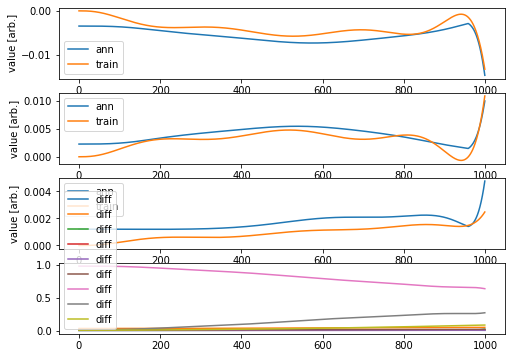

Validation loss: 46.480073640182766
Testing loss: 112.32459609516232


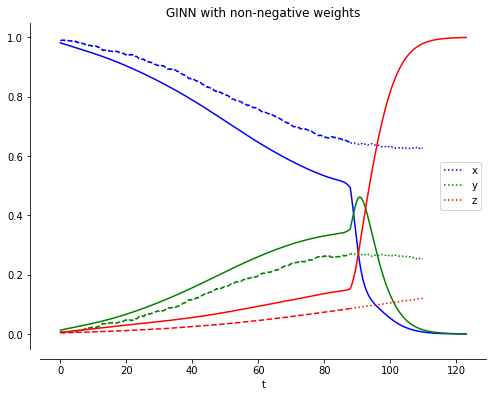

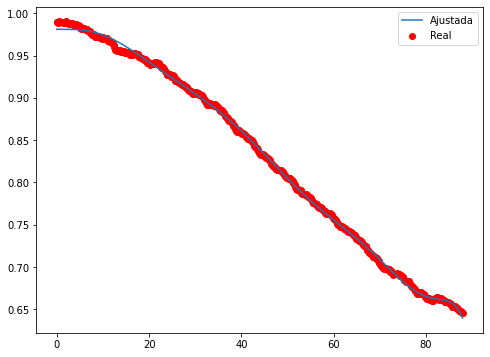

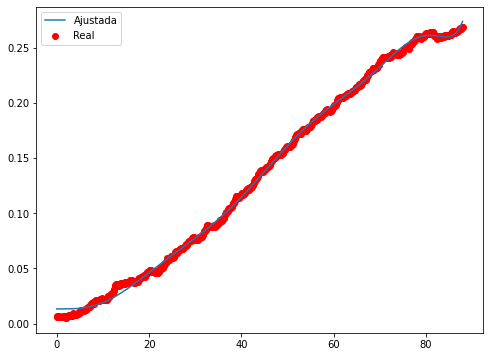

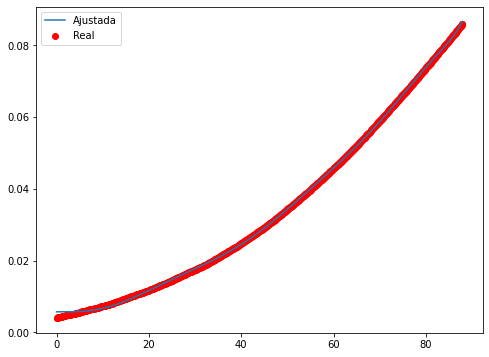

Epoch 1/500
32/32 - 1s - loss: 0.6309 - 1s/epoch - 37ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0816 - 95ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0211 - 90ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0096 - 99ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0058 - 92ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0040 - 94ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 0.0030 - 92ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 0.0024 - 97ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 0.0020 - 96ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 0.0017 - 87ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 0.0014 - 95ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 0.0012 - 89ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 0.0010 - 96ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 8.5404e-04 - 82ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 7.1206e-04 - 92ms/epoch - 3ms/step
Epoch 16/500
32/32 - 0s - loss: 5.9308e-04 - 88ms/epoch -

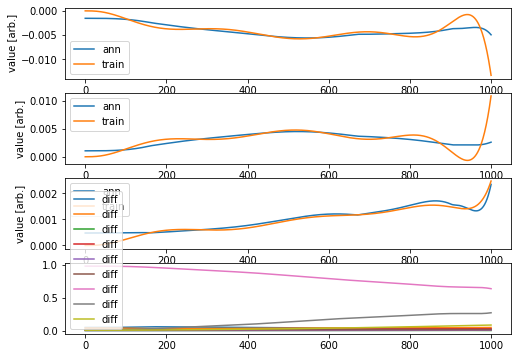

Validation loss: 0.41302257061617015
Testing loss: 3.424703505099917


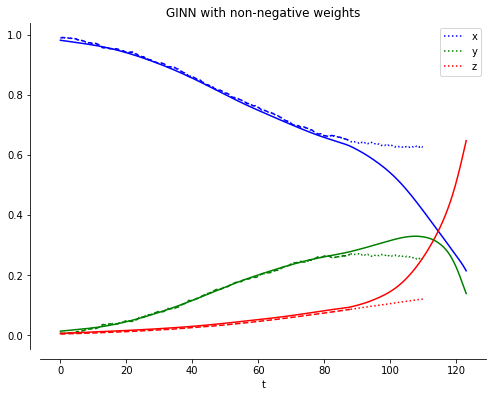

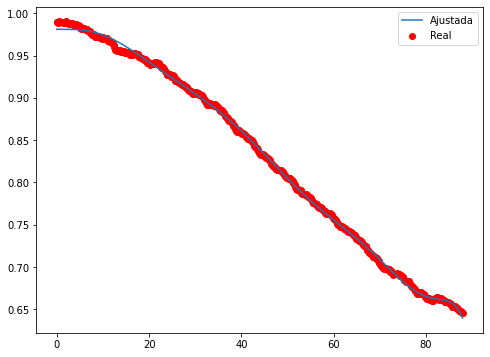

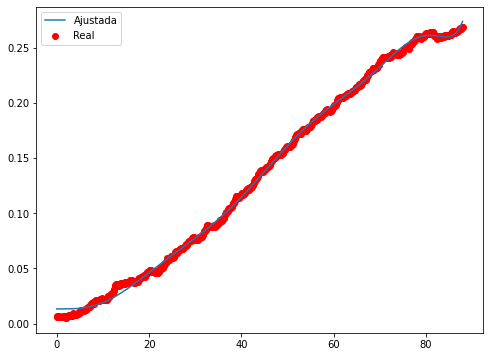

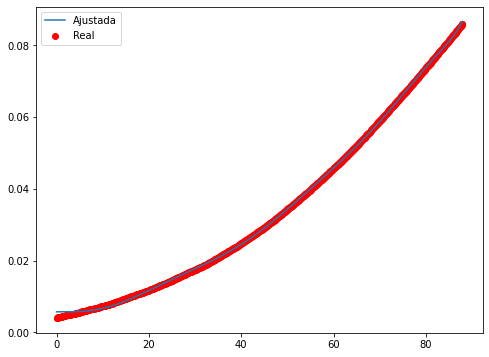

Epoch 1/500
32/32 - 1s - loss: 0.2832 - 1s/epoch - 37ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0250 - 99ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0050 - 96ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0025 - 99ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0018 - 88ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0014 - 113ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 0.0011 - 92ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 8.2839e-04 - 98ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 6.4125e-04 - 86ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 4.9783e-04 - 98ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 3.8913e-04 - 100ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 3.0395e-04 - 120ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 2.3621e-04 - 84ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 1.8226e-04 - 92ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 1.3990e-04 - 82ms/epoch - 3ms/step
Epoch 16/500
32/32 - 0s - loss

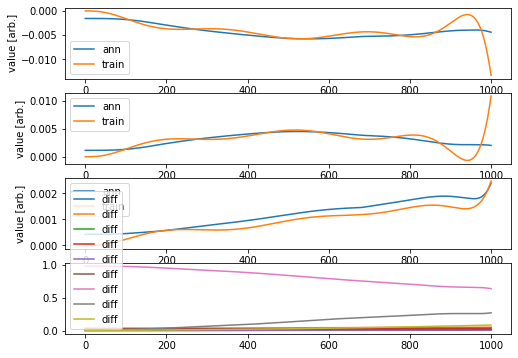

Validation loss: 0.6626425818979035
Testing loss: 3.7052286965751695


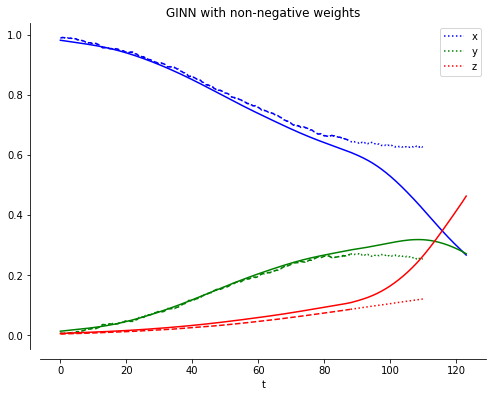

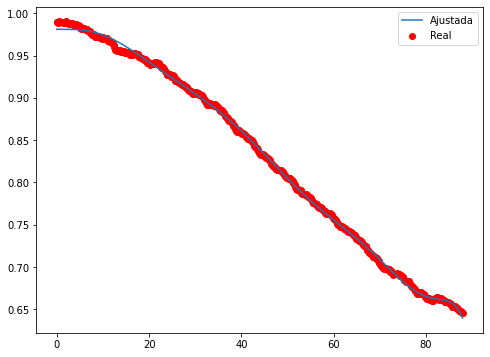

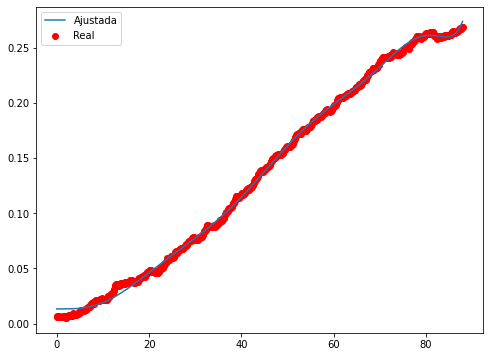

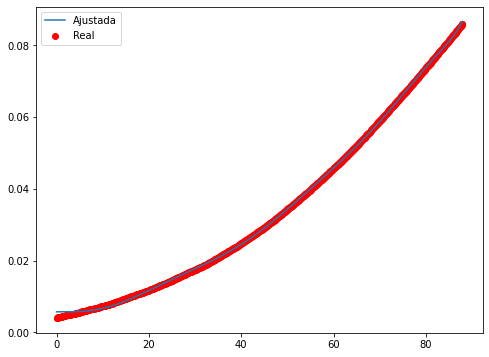

Epoch 1/500
32/32 - 1s - loss: 0.4192 - 1s/epoch - 38ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0430 - 92ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0096 - 100ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0049 - 92ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0032 - 90ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0024 - 97ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 0.0019 - 91ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 0.0015 - 100ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 0.0013 - 92ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 0.0011 - 100ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 9.3141e-04 - 84ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 8.0175e-04 - 94ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 6.8944e-04 - 102ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 5.9250e-04 - 91ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 5.1087e-04 - 95ms/epoch - 3ms/step
Epoch 16/500
32/32 - 0s - loss: 4.4182e-0

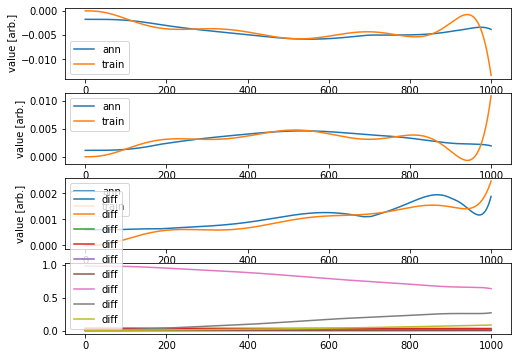

Validation loss: 0.3720684325716803
Testing loss: 0.7058068166549198


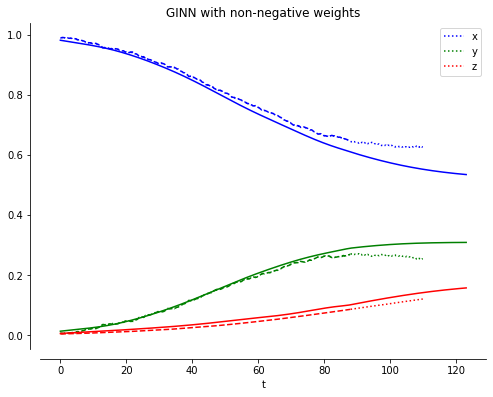

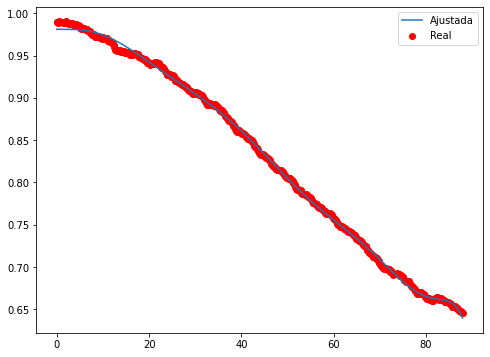

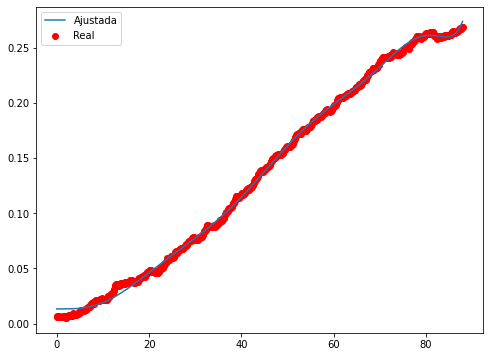

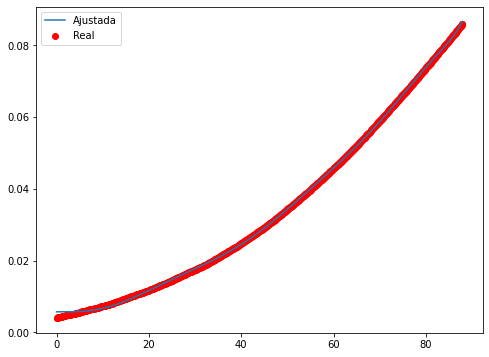

Epoch 1/500
32/32 - 1s - loss: 0.3913 - 1s/epoch - 39ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0445 - 97ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0097 - 90ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0043 - 106ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0028 - 100ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0021 - 97ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 0.0016 - 87ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 0.0013 - 96ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 0.0010 - 81ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 8.0523e-04 - 104ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 6.3957e-04 - 93ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 5.0606e-04 - 99ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 3.9956e-04 - 92ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 3.1820e-04 - 99ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 2.5713e-04 - 101ms/epoch - 3ms/step
Epoch 16/500
32/32 - 0s - loss: 2.085

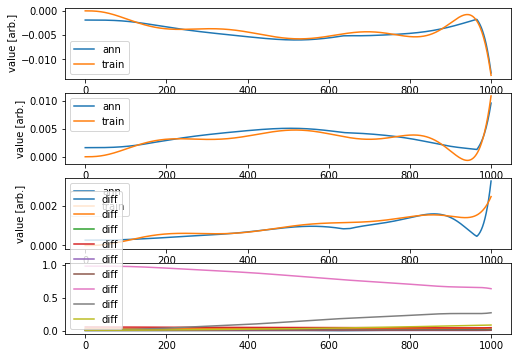

Validation loss: 20.559818067527786
Testing loss: 87.71251692992156


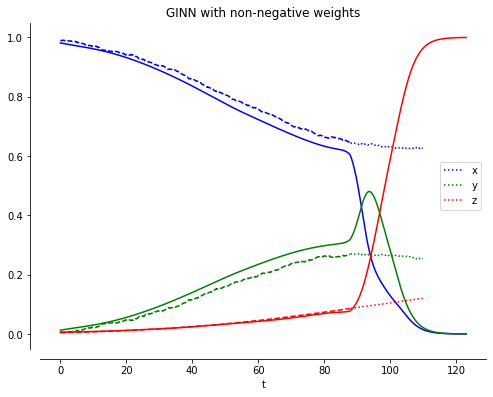

____________________________
Iteración =  3
Min =  0.06989518180235846
[[0, 0, 1, 1, 1, 1], [0, 1, 0, 0, 0, 1], [0, 1, 1, 0, 0, 1], [1, 1, 0, 0, 1, 0], [1, 1, 1, 1, 1, 1]]
[0.8725232912620919, 0.06989518180235846, 0.6780180325071583, 0.30253458934435157, 1.0516778606602757]


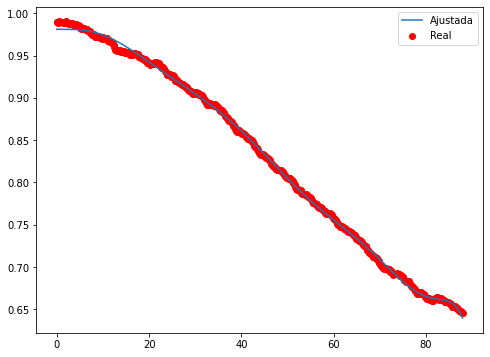

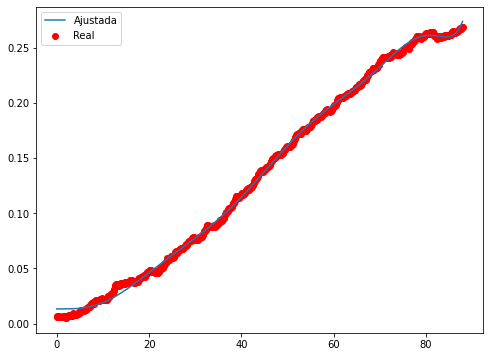

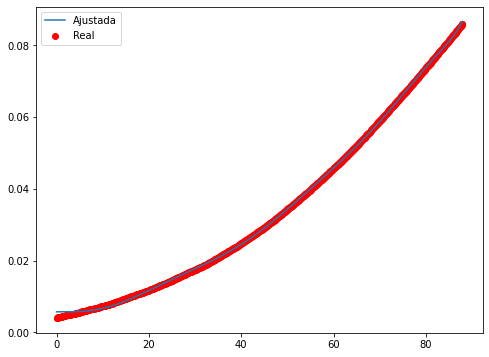

Epoch 1/500
32/32 - 1s - loss: 0.0019 - 1s/epoch - 38ms/step
Epoch 2/500
32/32 - 0s - loss: 2.2588e-04 - 103ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 4.9776e-05 - 87ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 2.0961e-05 - 98ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 1.3666e-05 - 99ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.0779e-05 - 97ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 9.1878e-06 - 90ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 8.1061e-06 - 87ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 7.3370e-06 - 90ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 6.8022e-06 - 98ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 6.4332e-06 - 96ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 6.1739e-06 - 91ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 5.9835e-06 - 89ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 5.8325e-06 - 103ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 5.7076e-06 - 97ms/epoch - 3ms/step
Epoch 1

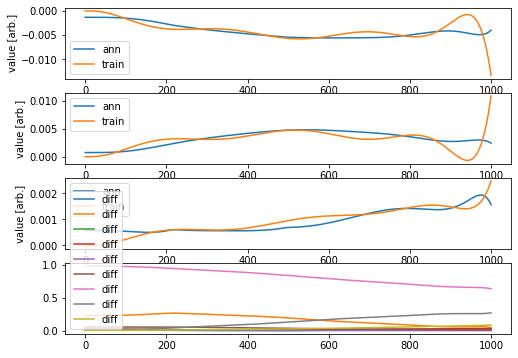

Validation loss: 0.2396167707820798
Testing loss: 0.35338152643189746


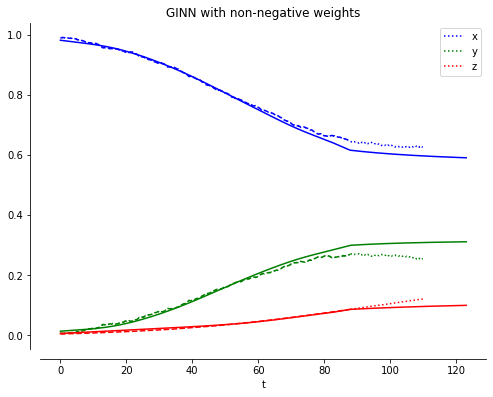

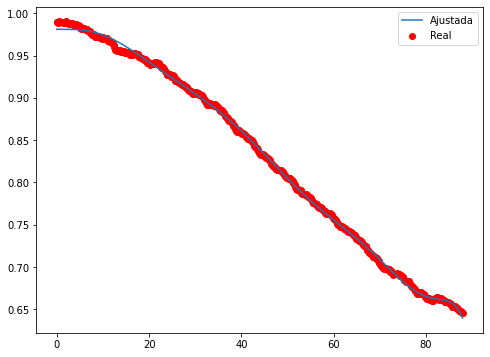

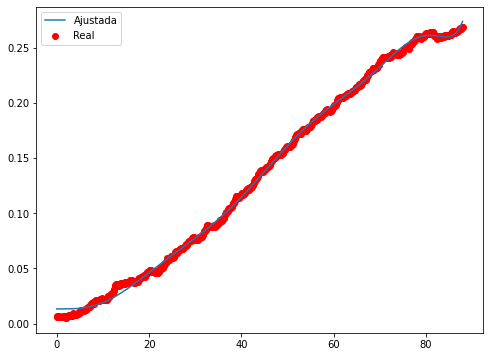

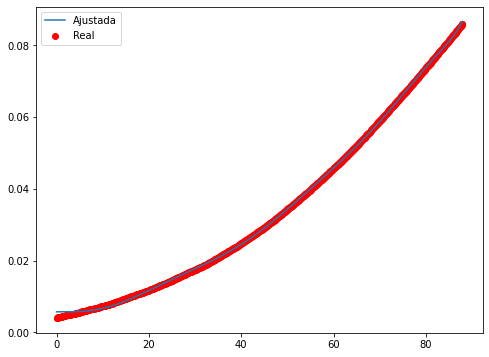

Epoch 1/500
32/32 - 2s - loss: 0.0046 - 2s/epoch - 49ms/step
Epoch 2/500
32/32 - 0s - loss: 4.5135e-04 - 107ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 1.2817e-04 - 98ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 6.2607e-05 - 90ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 3.8429e-05 - 87ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 2.6893e-05 - 106ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 2.0803e-05 - 89ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 1.6971e-05 - 87ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 1.4320e-05 - 96ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 1.2480e-05 - 91ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 1.1177e-05 - 92ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 1.0224e-05 - 95ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 9.5157e-06 - 88ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 8.9735e-06 - 98ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 8.5504e-06 - 109ms/epoch - 3ms/step
Epoch 

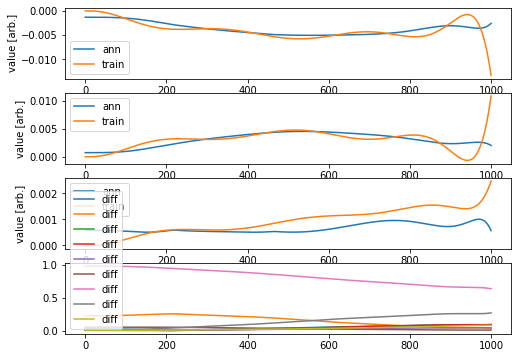

Validation loss: 0.1537412985823331
Testing loss: 0.339758902761556


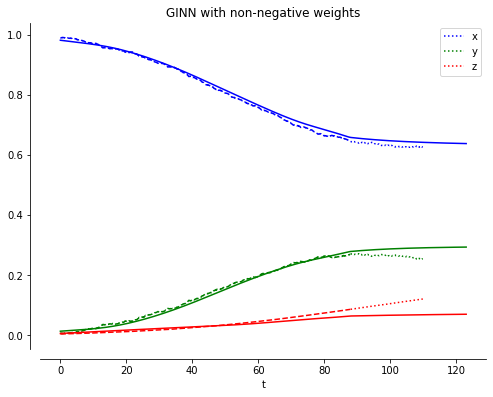

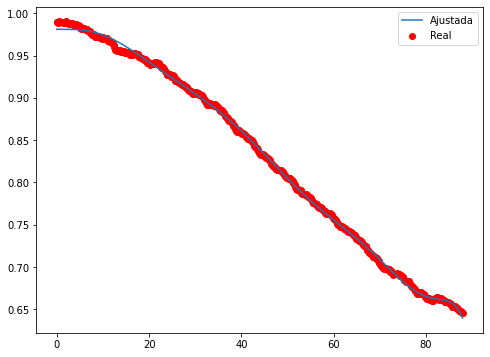

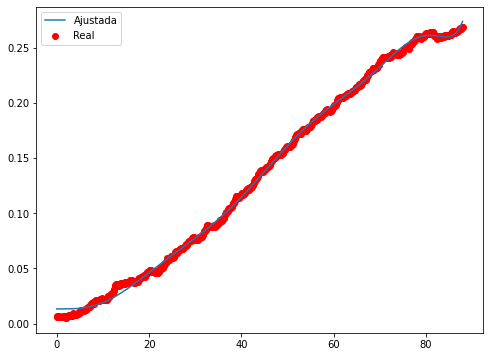

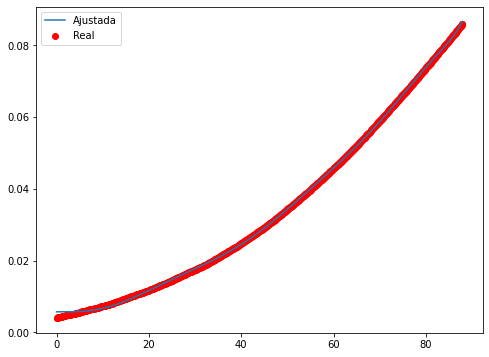

Epoch 1/500
32/32 - 1s - loss: 0.0059 - 1s/epoch - 37ms/step
Epoch 2/500
32/32 - 0s - loss: 7.7304e-04 - 105ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 2.2127e-04 - 113ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 1.0628e-04 - 103ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 6.8004e-05 - 97ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 5.0245e-05 - 114ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 3.9791e-05 - 113ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 3.2445e-05 - 100ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 2.7072e-05 - 105ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 2.3090e-05 - 115ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 2.0141e-05 - 108ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 1.7937e-05 - 109ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 1.6272e-05 - 115ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 1.4979e-05 - 104ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 1.3964e-05 - 106ms/epoch - 3ms/s

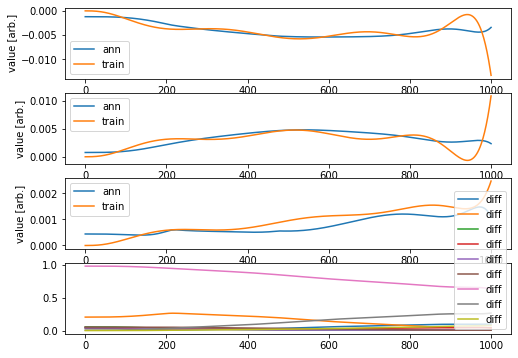

Validation loss: 0.16846498787684683
Testing loss: 0.29622871902154074


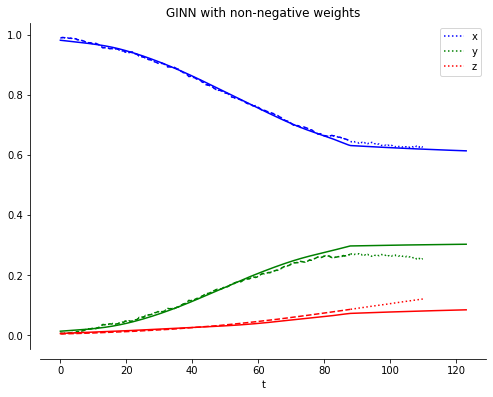

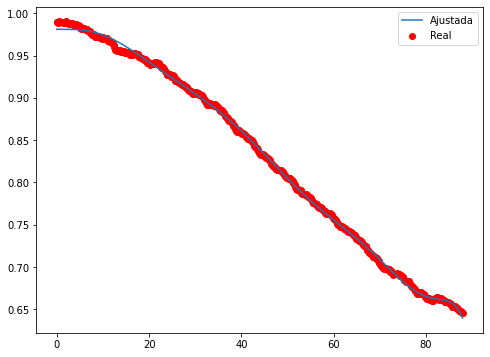

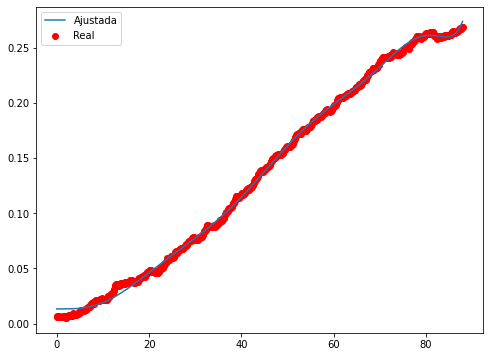

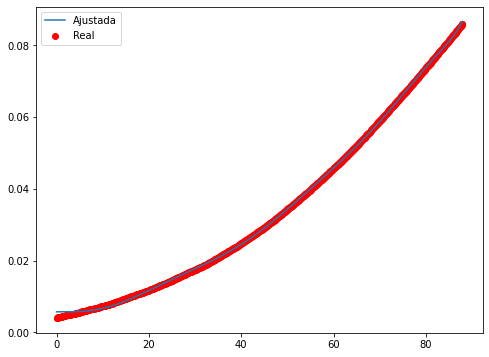

Epoch 1/500
32/32 - 1s - loss: 0.0047 - 1s/epoch - 38ms/step
Epoch 2/500
32/32 - 0s - loss: 6.0869e-04 - 103ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 1.4810e-04 - 102ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 6.5752e-05 - 89ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 3.9166e-05 - 86ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 2.7596e-05 - 105ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 2.1730e-05 - 96ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 1.8318e-05 - 88ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 1.6154e-05 - 101ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 1.4639e-05 - 100ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 1.3477e-05 - 92ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 1.2560e-05 - 90ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 1.1826e-05 - 97ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 1.1220e-05 - 113ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 1.0697e-05 - 93ms/epoch - 3ms/step
Epo

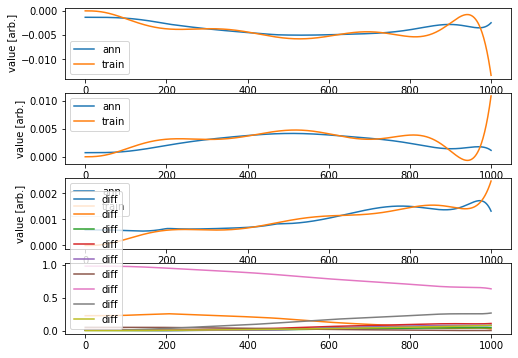

Validation loss: 0.08591606425799456
Testing loss: 0.5928168573747217


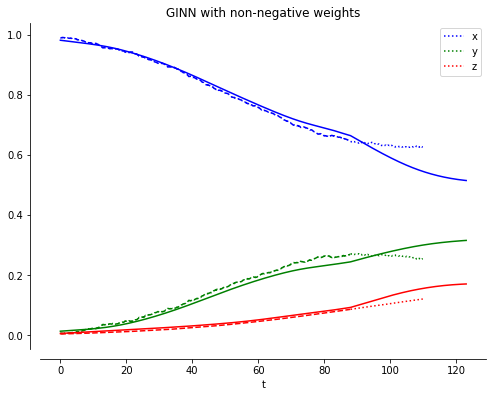

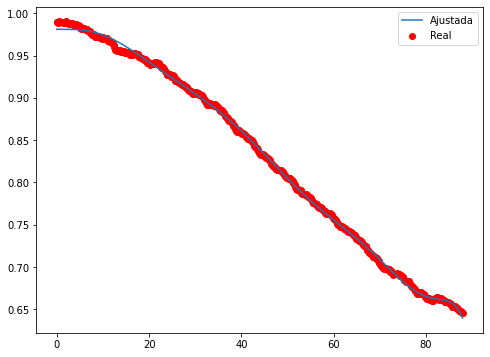

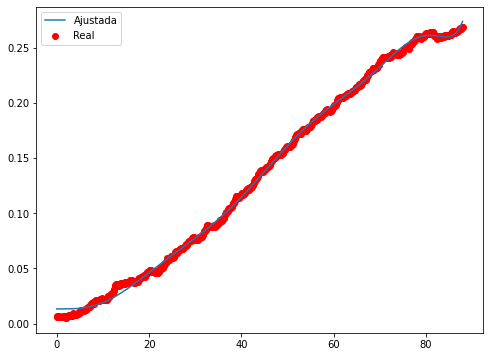

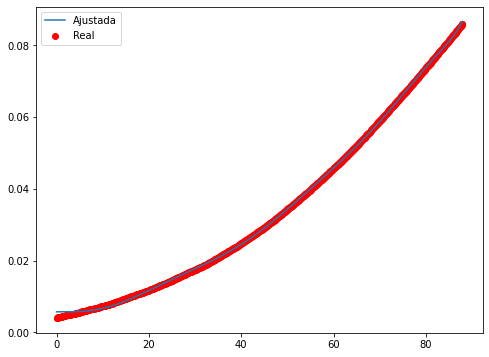

Epoch 1/500
32/32 - 1s - loss: 0.0023 - 1s/epoch - 39ms/step
Epoch 2/500
32/32 - 0s - loss: 2.2739e-04 - 98ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 5.3271e-05 - 95ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 2.5851e-05 - 118ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 1.7820e-05 - 109ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.4553e-05 - 101ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 1.2735e-05 - 103ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 1.1543e-05 - 117ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 1.0739e-05 - 98ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 1.0175e-05 - 131ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 9.7656e-06 - 95ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 9.4517e-06 - 100ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 9.1701e-06 - 87ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 8.9506e-06 - 109ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 8.7483e-06 - 94ms/epoch - 3ms/step
E

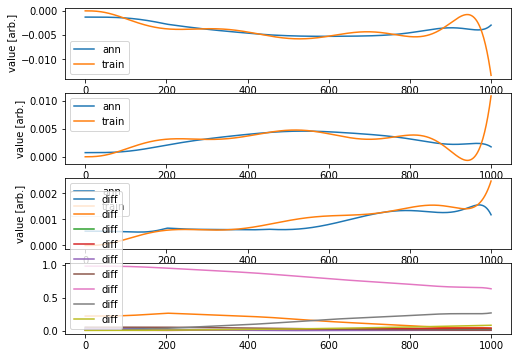

Validation loss: 0.055954959090379536
Testing loss: 0.1850947489805733


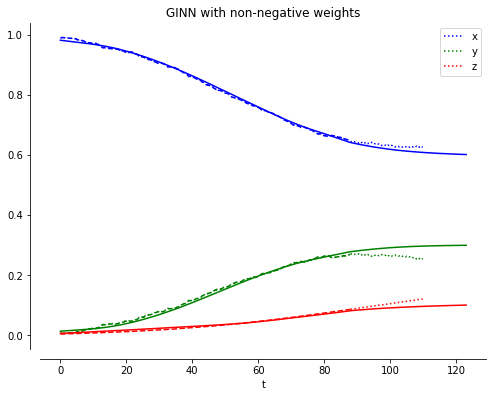

____________________________
Iteración =  4
Min =  0.06989518180235846
[[0, 0, 1, 1, 1, 1], [0, 1, 0, 0, 0, 1], [0, 1, 1, 0, 0, 1], [1, 1, 0, 0, 1, 0], [0, 1, 0, 0, 0, 1]]
[0.8725232912620919, 0.06989518180235846, 0.6780180325071583, 0.30253458934435157, 0.14073881611792677]


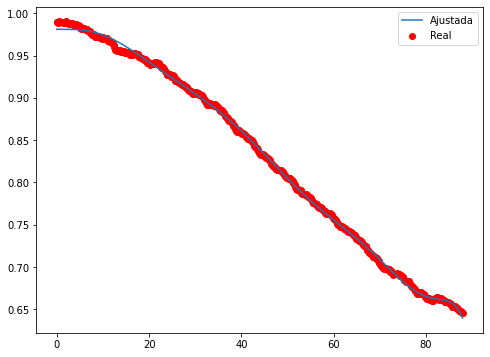

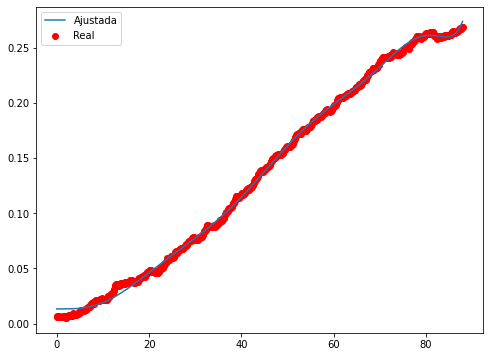

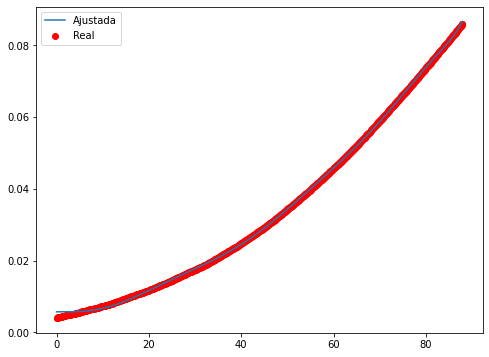

Epoch 1/500
32/32 - 1s - loss: 0.4054 - 1s/epoch - 39ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0565 - 102ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0111 - 105ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0034 - 104ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0016 - 106ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 9.9880e-04 - 104ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 7.7159e-04 - 122ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 6.6493e-04 - 116ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 6.0212e-04 - 105ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 5.5967e-04 - 94ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 5.2494e-04 - 100ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 4.9285e-04 - 97ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 4.6358e-04 - 99ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 4.3740e-04 - 110ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 4.1208e-04 - 102ms/epoch - 3ms/step
Epoch 16/500
3

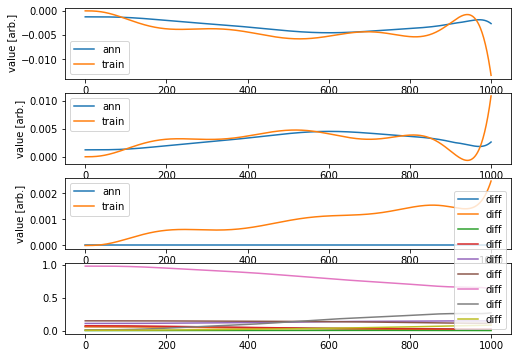

Validation loss: 11.651130368178272
Testing loss: 93.34170887779455


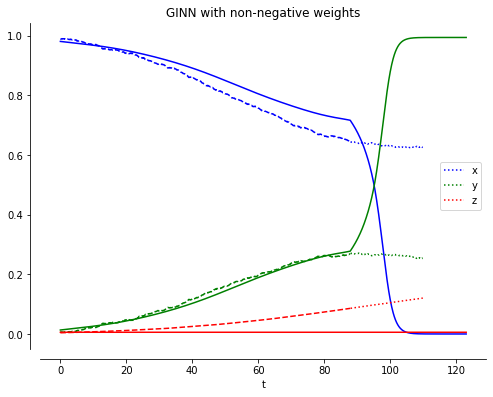

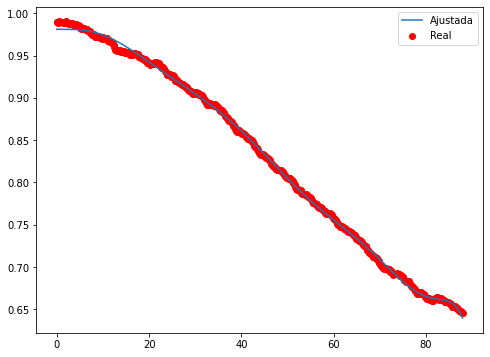

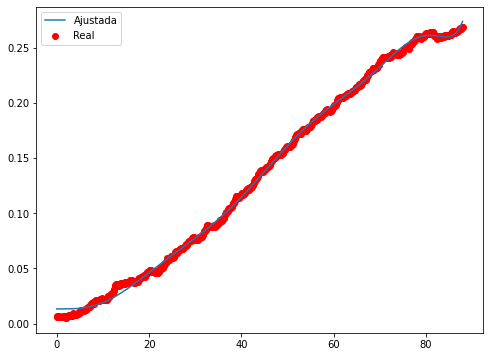

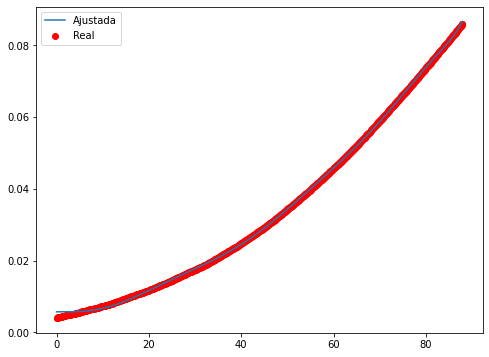

Epoch 1/500
32/32 - 1s - loss: 0.0943 - 1s/epoch - 39ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0115 - 114ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0021 - 93ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 7.5732e-04 - 101ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 4.8861e-04 - 109ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 4.0800e-04 - 100ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 3.6964e-04 - 106ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 3.4315e-04 - 125ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 3.1897e-04 - 95ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 2.9526e-04 - 96ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 2.7226e-04 - 99ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 2.5079e-04 - 106ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 2.3083e-04 - 113ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 2.1255e-04 - 101ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 1.9509e-04 - 105ms/epoch - 3ms/step
Epoch 1

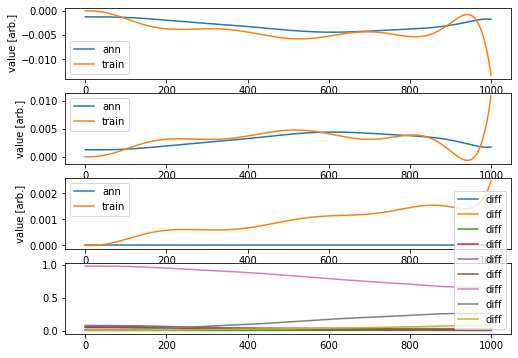

Validation loss: 2.4709803401364288
Testing loss: 24.612607143138366


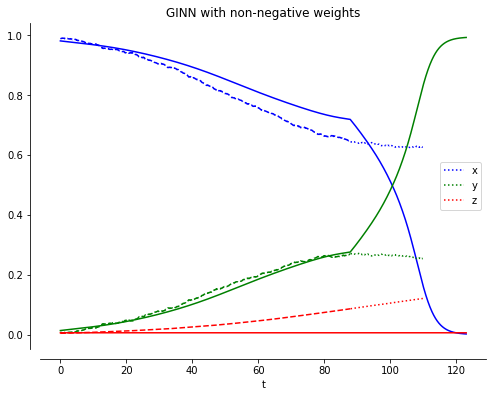

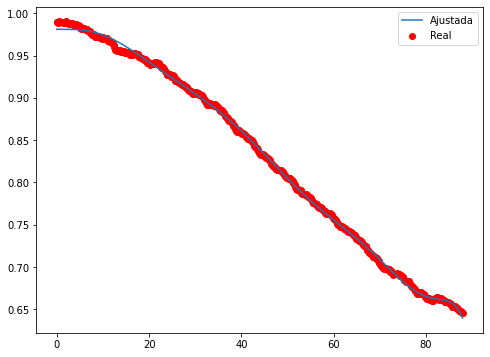

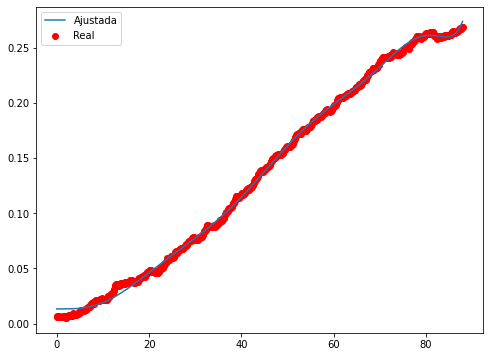

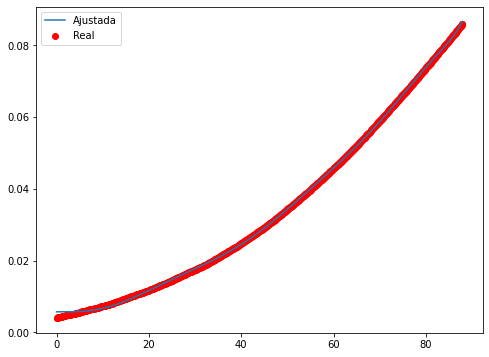

Epoch 1/500
32/32 - 1s - loss: 0.0855 - 1s/epoch - 38ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0050 - 112ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 4.4428e-04 - 110ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 1.8408e-04 - 111ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 1.5060e-04 - 103ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.3568e-04 - 108ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 1.2288e-04 - 97ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 1.1059e-04 - 105ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 9.9392e-05 - 104ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 9.0035e-05 - 108ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 8.2520e-05 - 102ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 7.5490e-05 - 100ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 6.8761e-05 - 93ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 6.2424e-05 - 108ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 5.6281e-05 - 105ms/epoch - 3ms/step
E

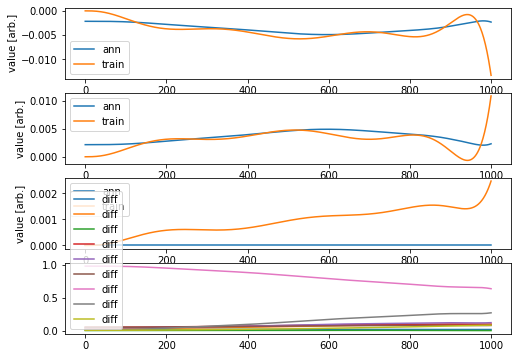

Validation loss: 12.317517968637155
Testing loss: 89.19856437680222


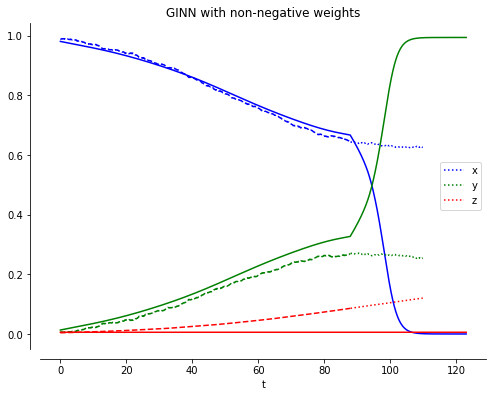

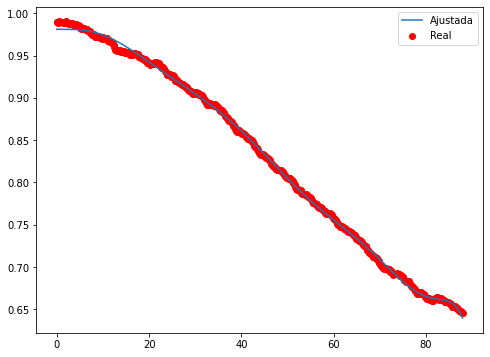

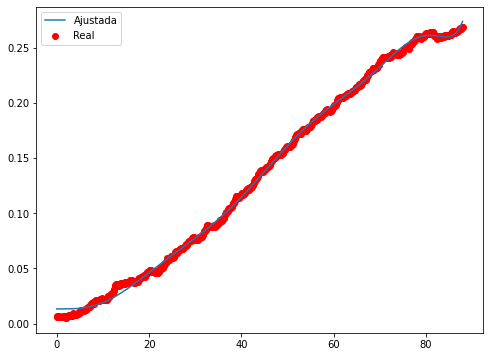

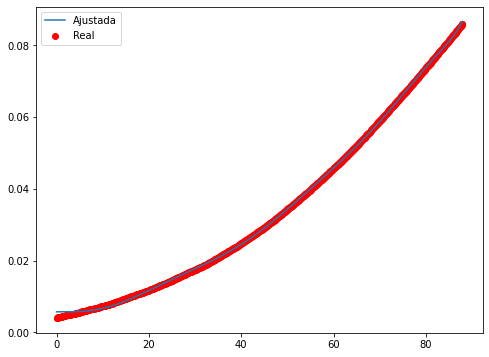

Epoch 1/500
32/32 - 1s - loss: 0.2796 - 1s/epoch - 39ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0370 - 109ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0070 - 108ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0023 - 98ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0012 - 102ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 8.4852e-04 - 84ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 7.1990e-04 - 90ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 6.5238e-04 - 102ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 6.0533e-04 - 93ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 5.6142e-04 - 103ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 5.1401e-04 - 94ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 4.6065e-04 - 108ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 4.0606e-04 - 103ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 3.5221e-04 - 103ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 3.0382e-04 - 103ms/epoch - 3ms/step
Epoch 16/500
32/

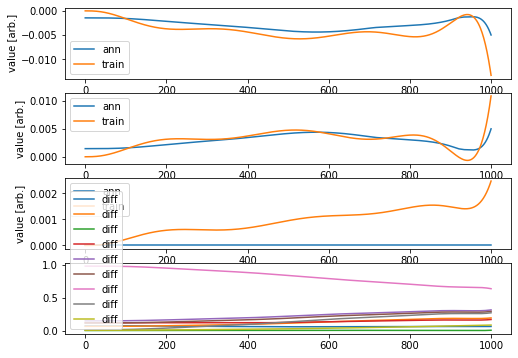

Validation loss: 11.928268922512743
Testing loss: 90.28090539156867


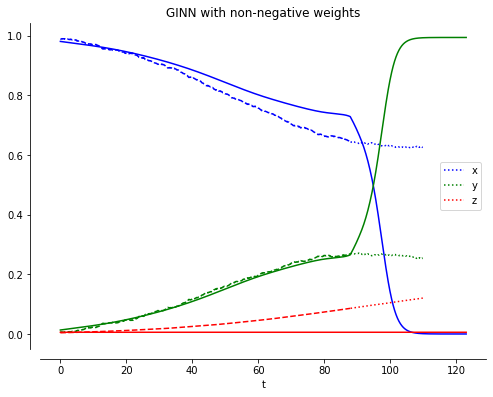

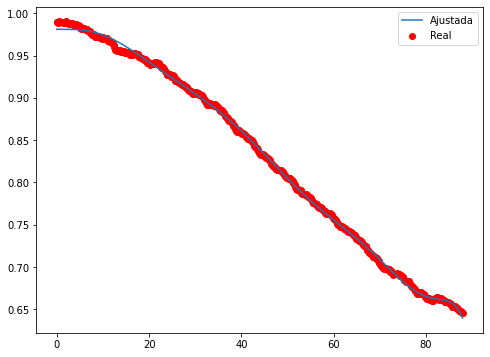

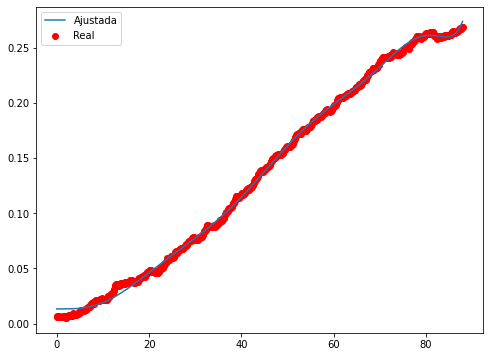

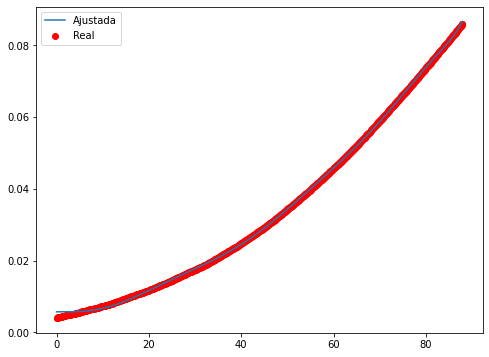

Epoch 1/500
32/32 - 1s - loss: 0.1961 - 1s/epoch - 38ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0232 - 111ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0043 - 101ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0014 - 112ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 7.6390e-04 - 105ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 5.7974e-04 - 106ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 4.9963e-04 - 117ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 4.4778e-04 - 98ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 4.0997e-04 - 94ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 3.8017e-04 - 106ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 3.5306e-04 - 101ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 3.2687e-04 - 105ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 3.0213e-04 - 95ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 2.7882e-04 - 95ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 2.5709e-04 - 93ms/epoch - 3ms/step
Epoch 16/500

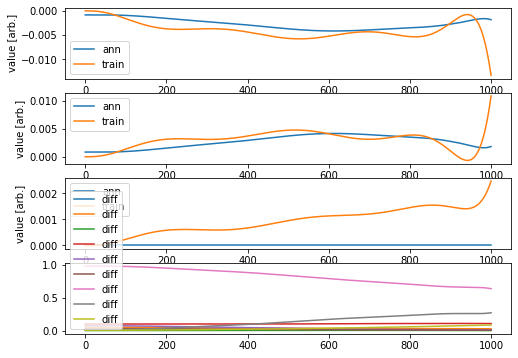

Validation loss: 2.00669906457091
Testing loss: 14.778651579036708


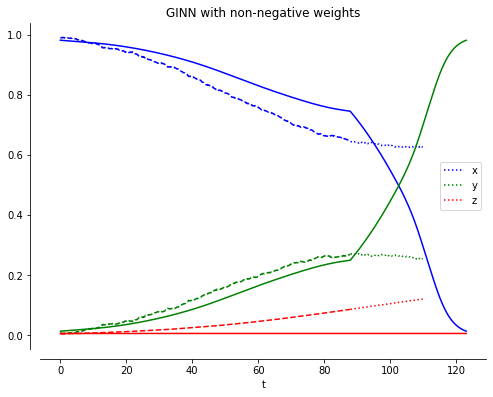

____________________________
Iteración =  5
Min =  0.06989518180235846
[[0, 0, 1, 1, 1, 1], [0, 1, 0, 0, 0, 1], [0, 1, 1, 0, 0, 1], [1, 1, 0, 0, 1, 0], [0, 1, 0, 0, 0, 1]]
[0.8725232912620919, 0.06989518180235846, 0.6780180325071583, 0.30253458934435157, 0.14073881611792677]


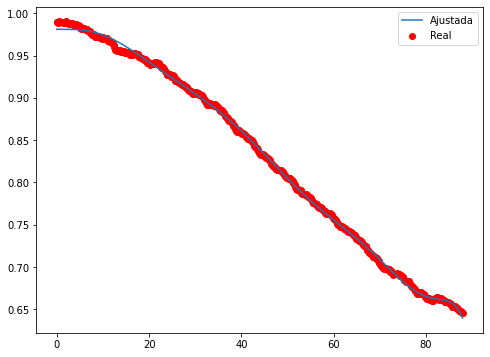

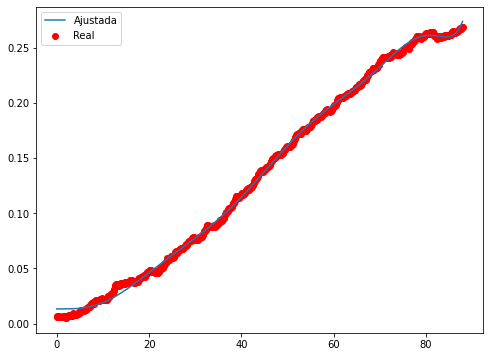

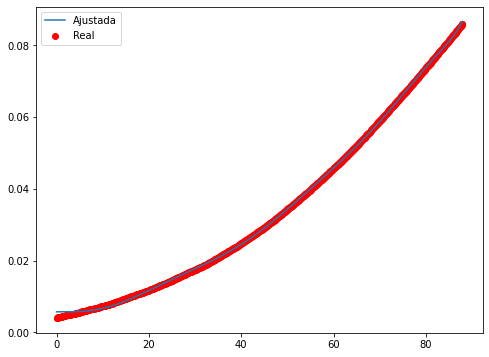

Epoch 1/500
32/32 - 2s - loss: 0.0086 - 2s/epoch - 64ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0011 - 171ms/epoch - 5ms/step
Epoch 3/500
32/32 - 0s - loss: 2.7335e-04 - 172ms/epoch - 5ms/step
Epoch 4/500
32/32 - 0s - loss: 1.1304e-04 - 154ms/epoch - 5ms/step
Epoch 5/500
32/32 - 0s - loss: 6.0600e-05 - 114ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 3.7189e-05 - 100ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 2.5437e-05 - 132ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 1.9168e-05 - 111ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 1.5433e-05 - 113ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 1.3214e-05 - 118ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 1.1763e-05 - 134ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 1.0741e-05 - 122ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 9.9733e-06 - 120ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 9.3630e-06 - 102ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 8.8679e-06 - 103ms/epoch - 3ms/step

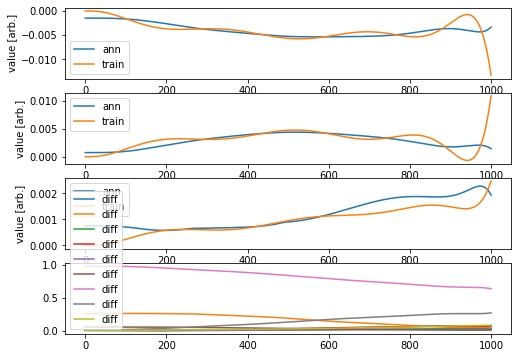

Validation loss: 0.35526920044829585
Testing loss: 1.1331671049601812


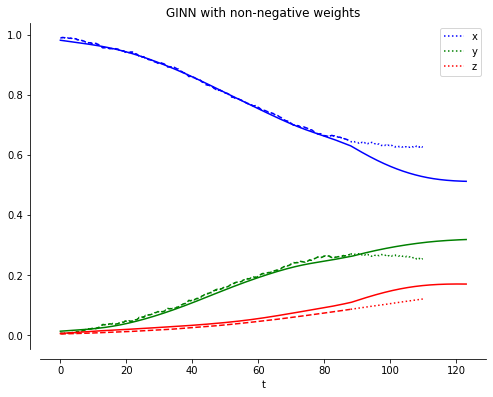

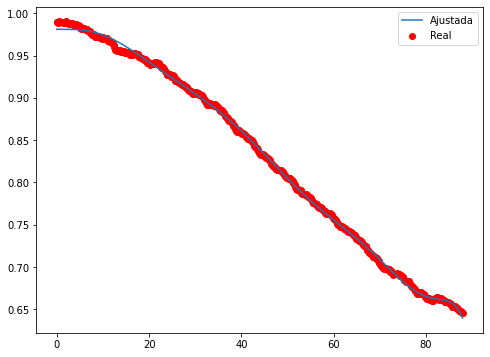

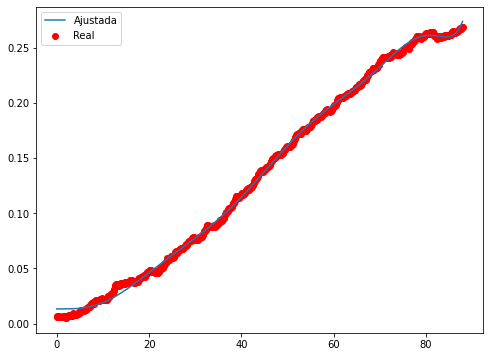

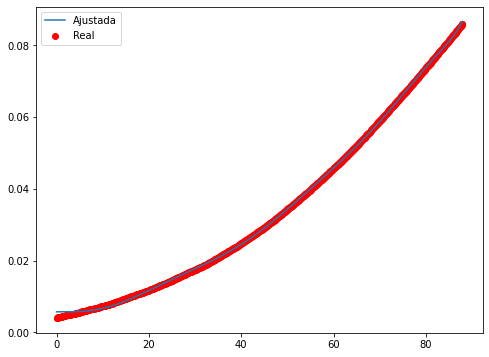

Epoch 1/500
32/32 - 1s - loss: 0.0027 - 1s/epoch - 38ms/step
Epoch 2/500
32/32 - 0s - loss: 2.1977e-04 - 96ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 6.9522e-05 - 100ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 3.5577e-05 - 111ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 2.2467e-05 - 110ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.6280e-05 - 114ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 1.2633e-05 - 124ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 1.0295e-05 - 129ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 8.8828e-06 - 99ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 7.9930e-06 - 114ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 7.3412e-06 - 107ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 6.8540e-06 - 99ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 6.4737e-06 - 114ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 6.1739e-06 - 108ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 5.9369e-06 - 88ms/epoch - 3ms/step

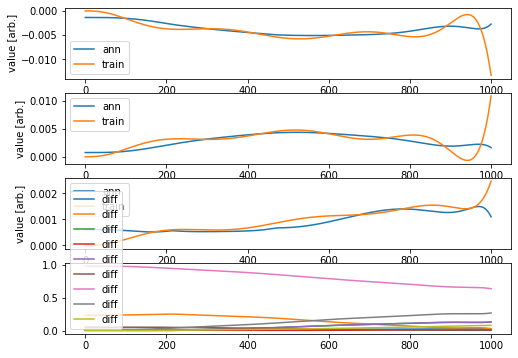

Validation loss: 0.017798643651559004
Testing loss: 0.13769342907930943


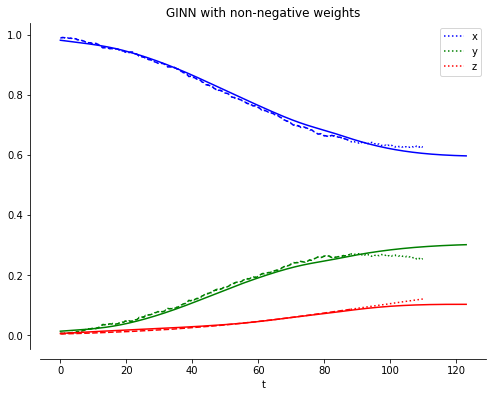

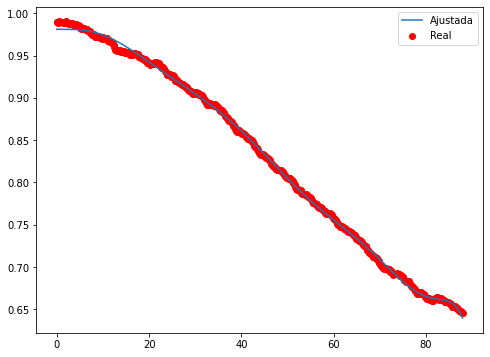

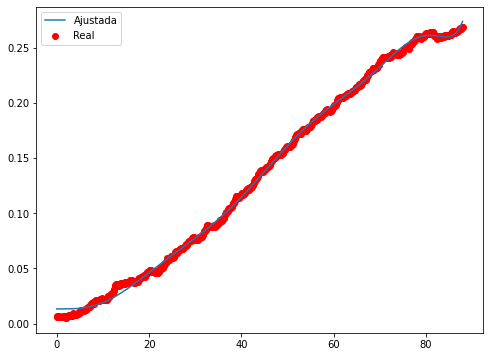

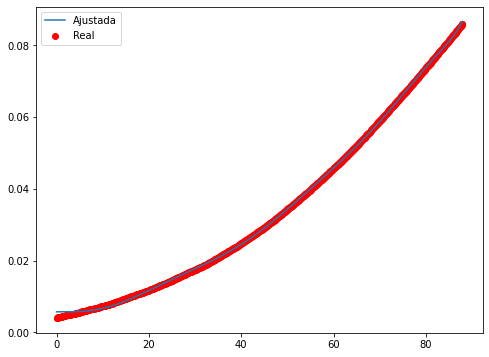

Epoch 1/500
32/32 - 1s - loss: 0.0043 - 1s/epoch - 41ms/step
Epoch 2/500
32/32 - 0s - loss: 5.8456e-04 - 111ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 1.6063e-04 - 114ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 6.8899e-05 - 105ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 3.9833e-05 - 101ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 2.6775e-05 - 105ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 1.9814e-05 - 110ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 1.6020e-05 - 119ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 1.3704e-05 - 117ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 1.2198e-05 - 118ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 1.1141e-05 - 114ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 1.0367e-05 - 103ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 9.7437e-06 - 105ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 9.2426e-06 - 109ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 8.8119e-06 - 104ms/epoch - 3ms/

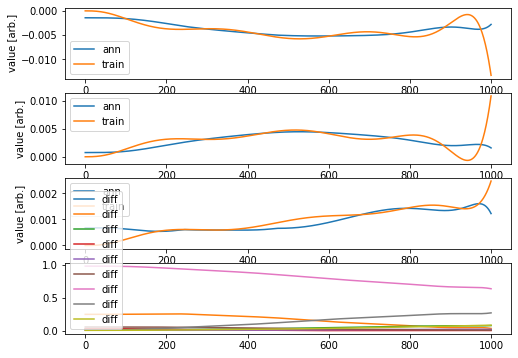

Validation loss: 0.0275442223828863
Testing loss: 0.15170678868743367


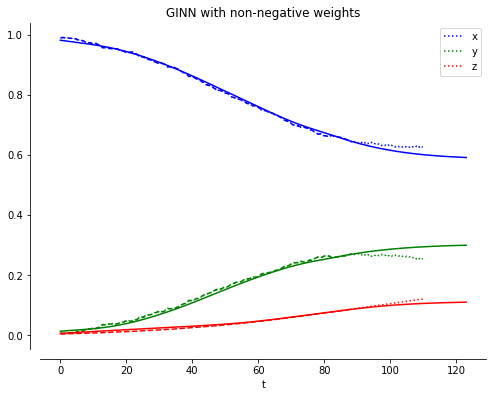

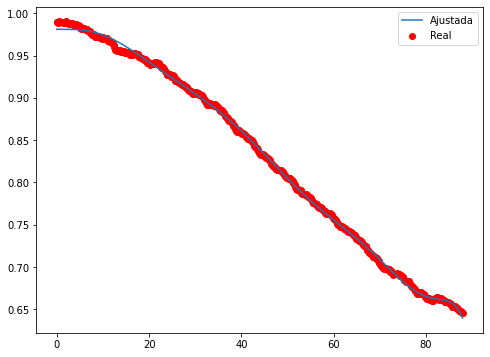

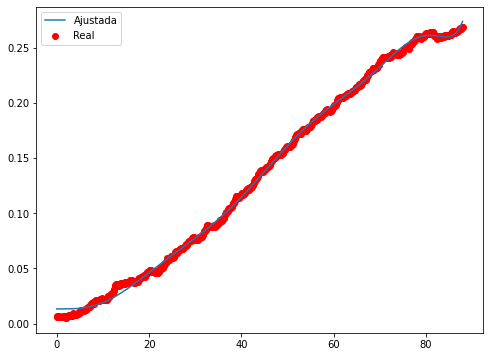

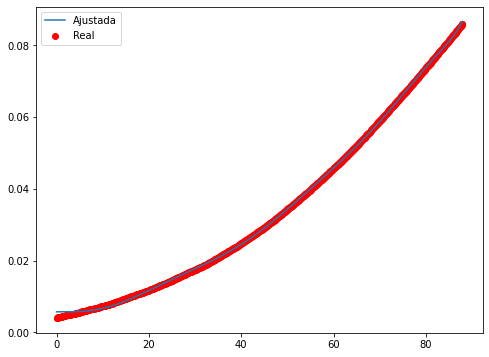

Epoch 1/500
32/32 - 1s - loss: 0.0018 - 1s/epoch - 38ms/step
Epoch 2/500
32/32 - 0s - loss: 2.1854e-04 - 121ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 3.7754e-05 - 109ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 1.6139e-05 - 96ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 1.1961e-05 - 102ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.0569e-05 - 117ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 9.7812e-06 - 121ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 9.2589e-06 - 114ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 8.8335e-06 - 100ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 8.4723e-06 - 104ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 8.1603e-06 - 107ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 7.8907e-06 - 105ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 7.6533e-06 - 102ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 7.4409e-06 - 99ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 7.2444e-06 - 100ms/epoch - 3ms/st

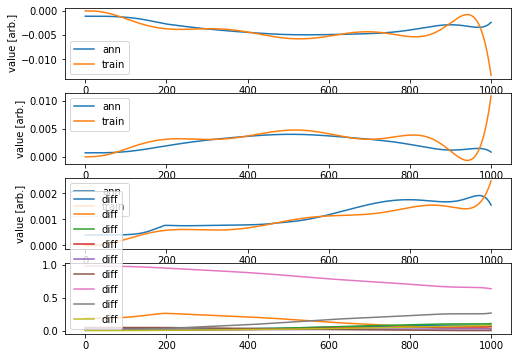

Validation loss: 0.2457600849115667
Testing loss: 0.9224233674303276


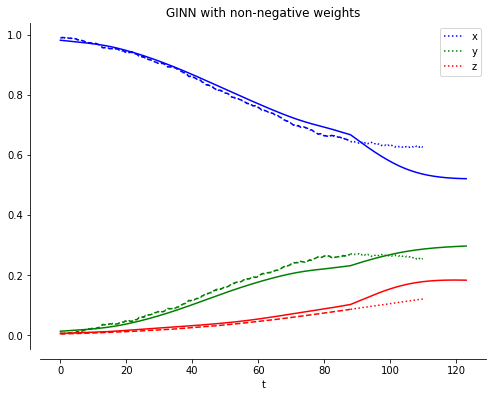

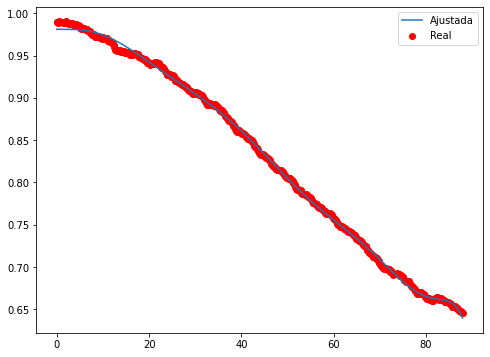

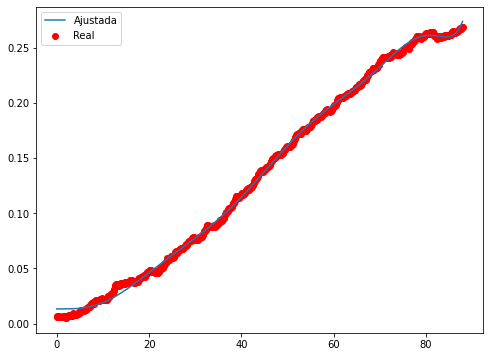

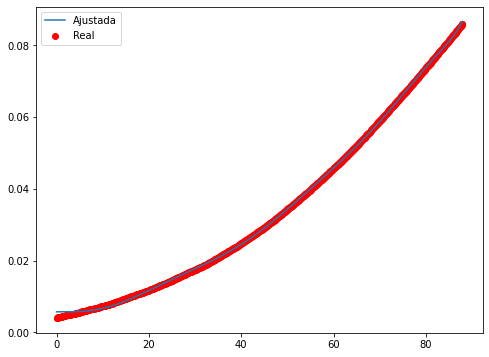

Epoch 1/500
32/32 - 2s - loss: 0.0014 - 2s/epoch - 49ms/step
Epoch 2/500
32/32 - 0s - loss: 1.5822e-04 - 118ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 3.3918e-05 - 101ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 1.5416e-05 - 112ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 1.0419e-05 - 101ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 8.5952e-06 - 111ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 7.7071e-06 - 104ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 7.1600e-06 - 113ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 6.7960e-06 - 119ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 6.5341e-06 - 106ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 6.3353e-06 - 106ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 6.1809e-06 - 107ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 6.0376e-06 - 116ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 5.9142e-06 - 105ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 5.8044e-06 - 117ms/epoch - 4ms/

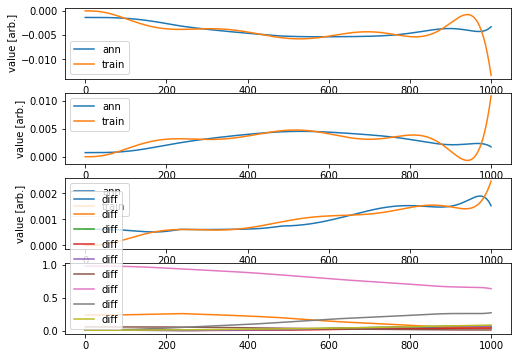

Validation loss: 0.0885332697448439
Testing loss: 0.2687407909477943


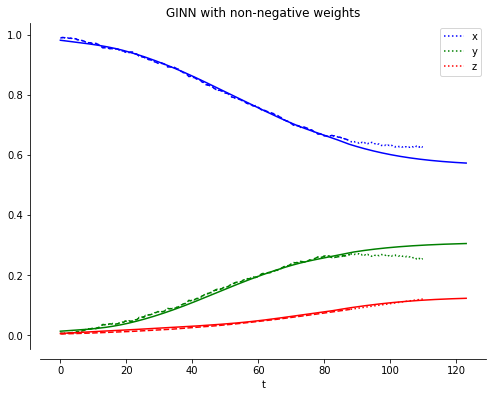

____________________________
Iteración =  6
Min =  0.06989518180235846
[[0, 1, 0, 0, 0, 1], [0, 1, 1, 0, 0, 1], [1, 1, 0, 0, 1, 0], [0, 1, 0, 0, 0, 1], [0, 1, 0, 0, 0, 1]]
[0.06989518180235846, 0.6780180325071583, 0.30253458934435157, 0.14073881611792677, 0.14698108422783035]


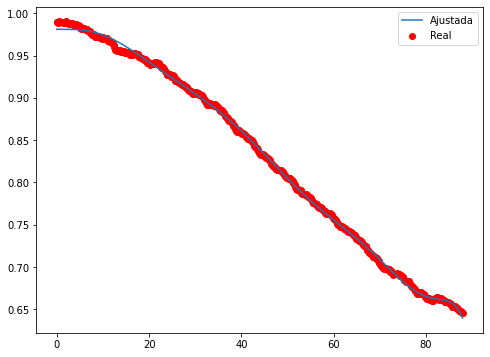

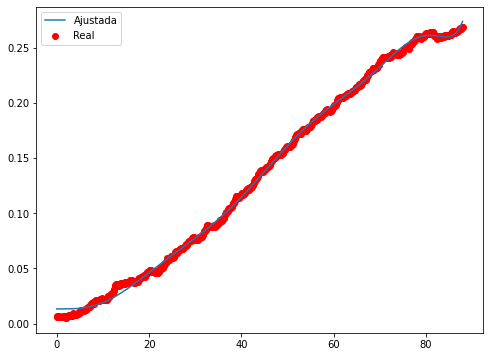

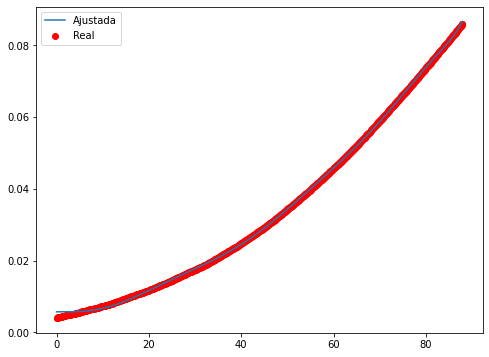

Epoch 1/500
32/32 - 1s - loss: 0.0506 - 1s/epoch - 38ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0031 - 92ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 7.8618e-04 - 92ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 4.7936e-04 - 90ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 3.5451e-04 - 102ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 2.6782e-04 - 104ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 1.9631e-04 - 102ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 1.3548e-04 - 98ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 8.5672e-05 - 111ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 4.9628e-05 - 89ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 2.6061e-05 - 96ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 1.3172e-05 - 87ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 7.3114e-06 - 98ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 4.7830e-06 - 97ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 3.5706e-06 - 90ms/epoch - 3ms/step
Epoch 16/

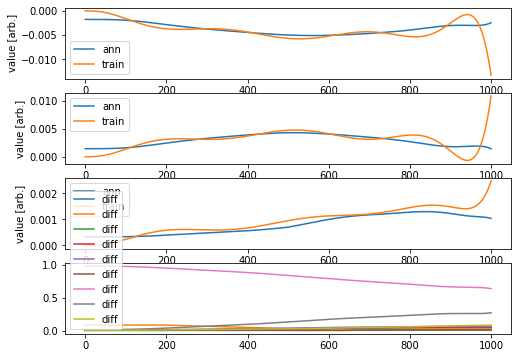

Validation loss: 0.037985382039682866
Testing loss: 0.15232765284132324


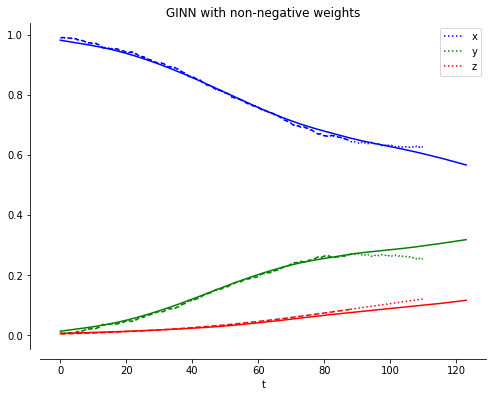

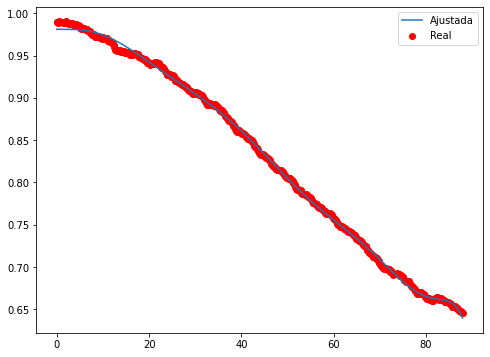

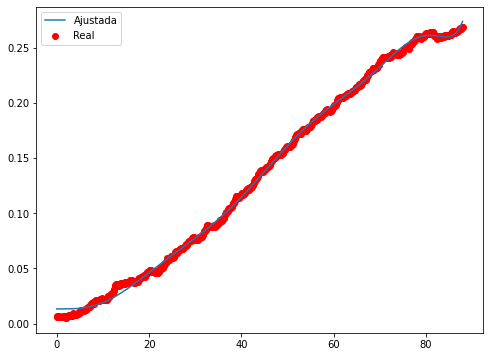

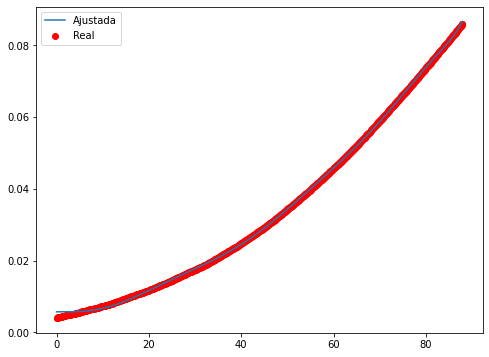

Epoch 1/500
32/32 - 1s - loss: 0.2696 - 1s/epoch - 39ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0288 - 95ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0062 - 112ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0025 - 92ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0015 - 96ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0011 - 93ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 8.4406e-04 - 99ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 7.0334e-04 - 90ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 5.9747e-04 - 112ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 5.1166e-04 - 102ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 4.4319e-04 - 105ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 3.8485e-04 - 88ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 3.3626e-04 - 99ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 2.9279e-04 - 96ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 2.5580e-04 - 112ms/epoch - 4ms/step
Epoch 16/500
32/32 - 0s 

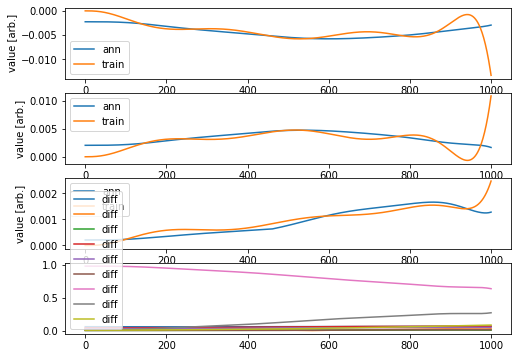

Validation loss: 0.5284639041045922
Testing loss: 0.7528384294248305


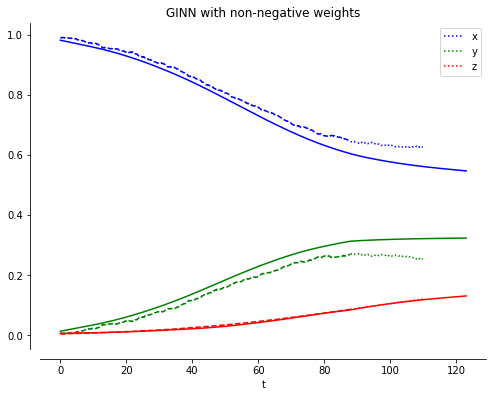

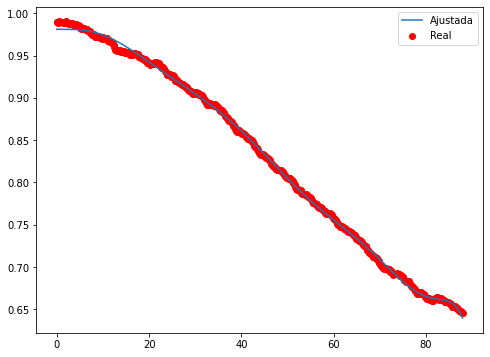

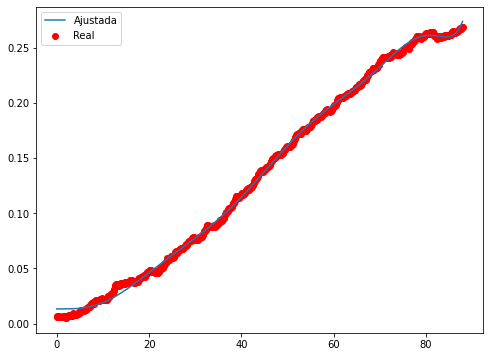

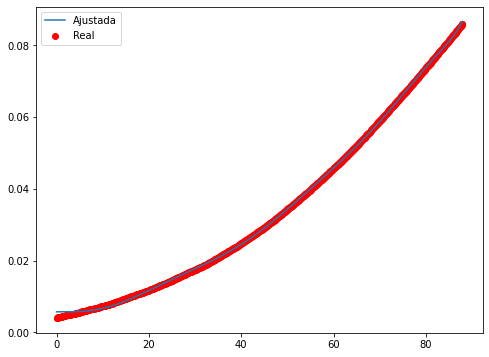

Epoch 1/500
32/32 - 1s - loss: 0.1093 - 1s/epoch - 39ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0132 - 119ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0029 - 93ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0012 - 99ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 7.7912e-04 - 131ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 5.7809e-04 - 110ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 4.4941e-04 - 108ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 3.5682e-04 - 119ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 2.9109e-04 - 100ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 2.3969e-04 - 137ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 2.0101e-04 - 116ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 1.7039e-04 - 104ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 1.4462e-04 - 105ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 1.2295e-04 - 106ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 1.0422e-04 - 91ms/epoch - 3ms/step
Epoch 16/5

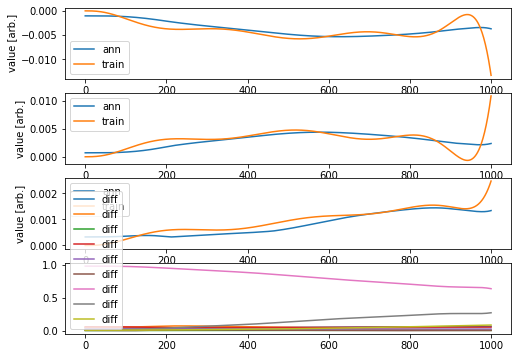

Validation loss: 0.07068555669439534
Testing loss: 4.207179336635143


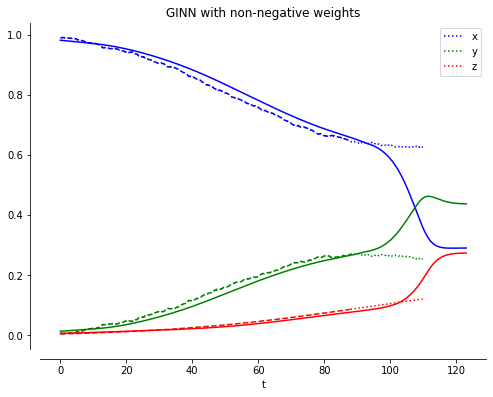

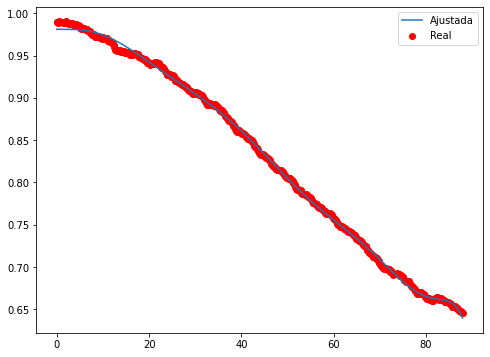

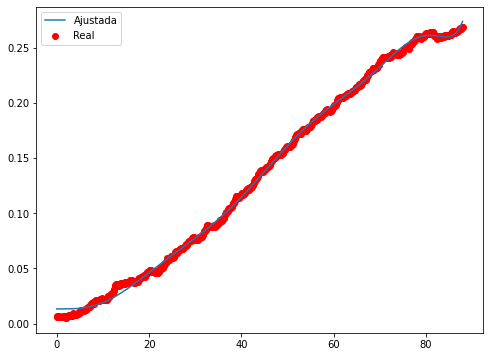

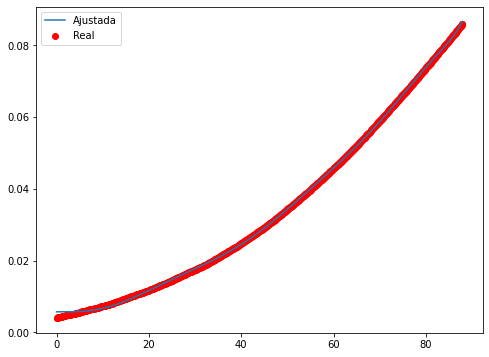

Epoch 1/500
32/32 - 1s - loss: 0.1495 - 1s/epoch - 38ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0199 - 102ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0047 - 129ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0020 - 108ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0012 - 104ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 8.8175e-04 - 104ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 6.9584e-04 - 96ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 5.6823e-04 - 107ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 4.7162e-04 - 99ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 3.9569e-04 - 106ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 3.3340e-04 - 110ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 2.8222e-04 - 123ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 2.4043e-04 - 114ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 2.0616e-04 - 108ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 1.7653e-04 - 101ms/epoch - 3ms/step
Epoch 16/500


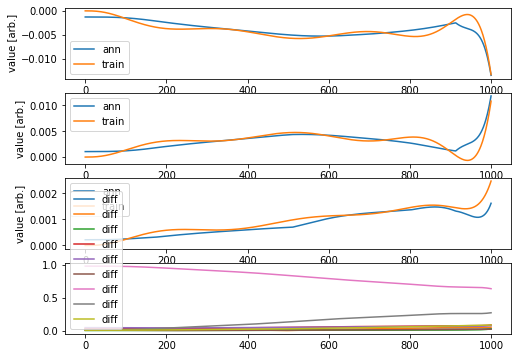

Validation loss: 11.383014094993518
Testing loss: 27.064866607296235


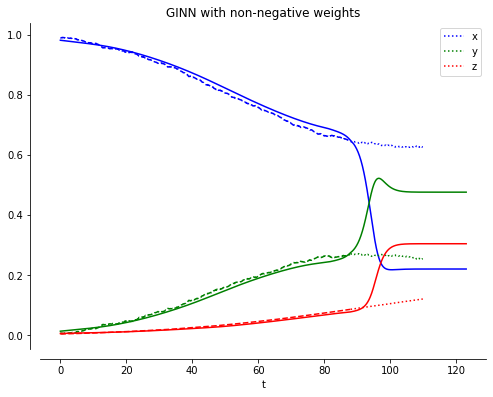

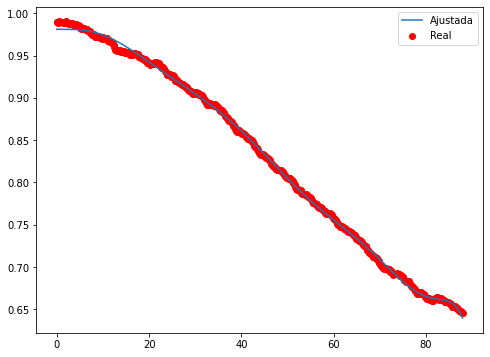

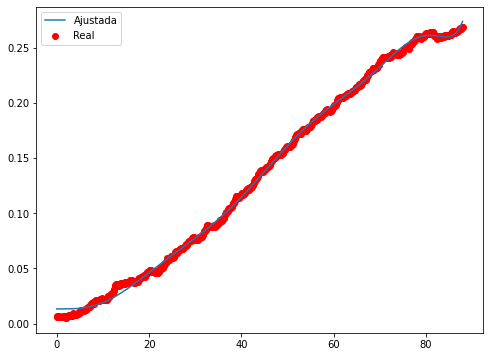

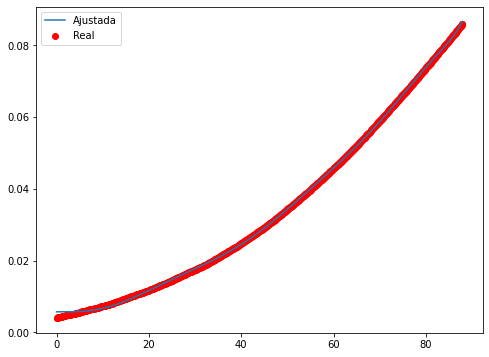

Epoch 1/500
32/32 - 2s - loss: 0.1883 - 2s/epoch - 57ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0226 - 104ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0051 - 106ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0022 - 97ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0013 - 103ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 9.8441e-04 - 92ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 7.9602e-04 - 126ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 6.6530e-04 - 84ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 5.6275e-04 - 90ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 4.7994e-04 - 94ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 4.1502e-04 - 86ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 3.5835e-04 - 115ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 3.1150e-04 - 94ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 2.7001e-04 - 98ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 2.3367e-04 - 93ms/epoch - 3ms/step
Epoch 16/500
32/32 -

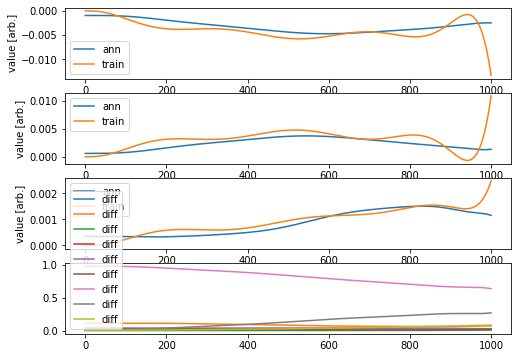

Validation loss: 0.7282986851544985
Testing loss: 2.886674225332922


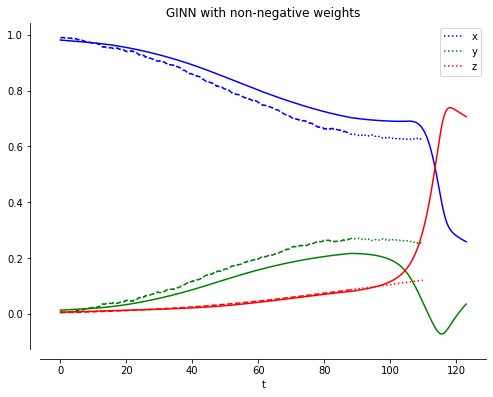

____________________________
Iteración =  7
Min =  0.06989518180235846
[[0, 1, 0, 0, 0, 1], [1, 1, 0, 0, 1, 0], [0, 1, 0, 0, 0, 1], [0, 1, 0, 0, 0, 1], [0, 1, 1, 0, 0, 1]]
[0.06989518180235846, 0.6780180325071583, 0.30253458934435157, 0.14073881611792677, 0.14698108422783035]


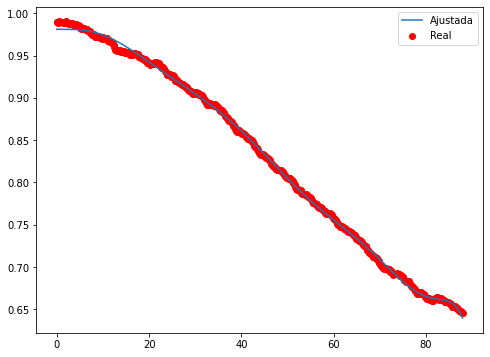

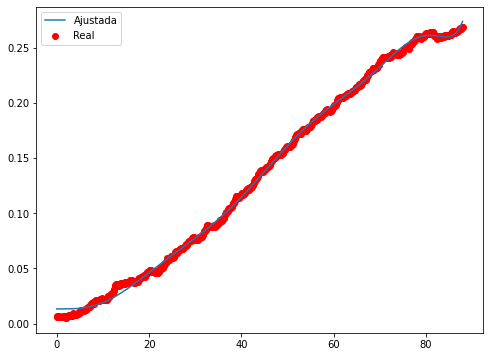

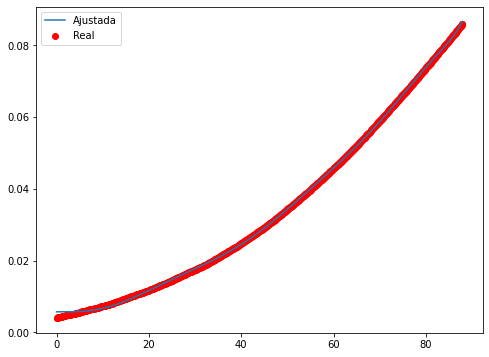

Epoch 1/500
32/32 - 2s - loss: 0.2566 - 2s/epoch - 58ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0211 - 98ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0030 - 110ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0014 - 100ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0011 - 100ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 9.0892e-04 - 116ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 7.7613e-04 - 108ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 6.6009e-04 - 97ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 5.5740e-04 - 105ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 4.7193e-04 - 104ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 4.0221e-04 - 103ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 3.4647e-04 - 104ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 3.0109e-04 - 111ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 2.6057e-04 - 106ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 2.2421e-04 - 117ms/epoch - 4ms/step
Epoch 16/500


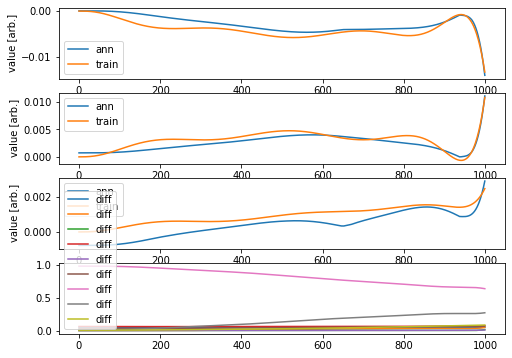

Validation loss: 0.5470191955857365
Testing loss: 49.256774132439766


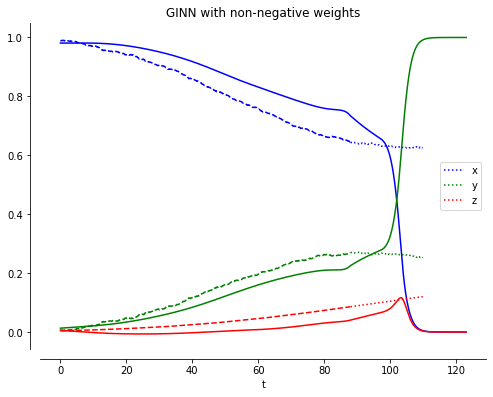

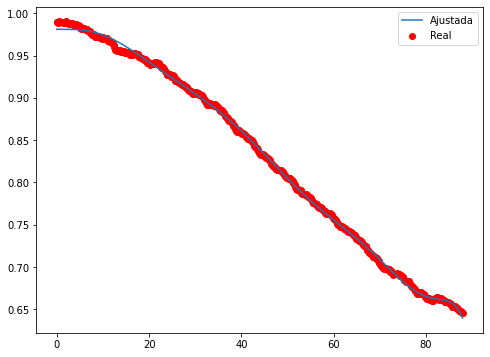

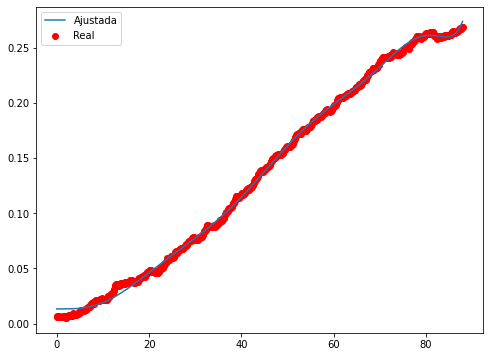

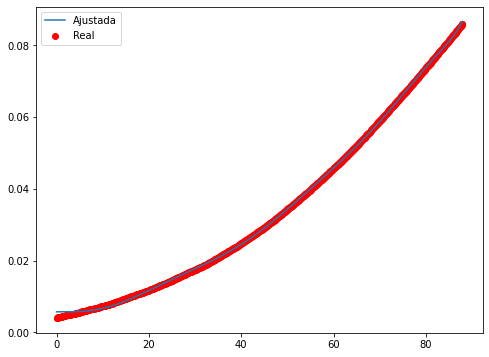

Epoch 1/500
32/32 - 1s - loss: 0.4115 - 1s/epoch - 39ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0448 - 116ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0071 - 124ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0025 - 121ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0016 - 108ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0013 - 126ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 0.0011 - 113ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 9.9607e-04 - 119ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 8.9925e-04 - 106ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 8.1255e-04 - 111ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 7.3352e-04 - 93ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 6.6184e-04 - 96ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 5.9863e-04 - 103ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 5.4107e-04 - 100ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 4.9272e-04 - 101ms/epoch - 3ms/step
Epoch 16/500
32/32 - 

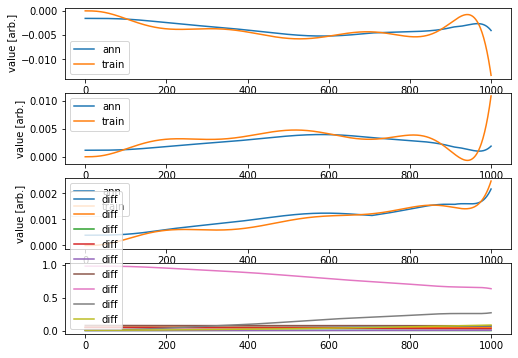

Validation loss: 0.4696411450481112
Testing loss: 3.179705535458286


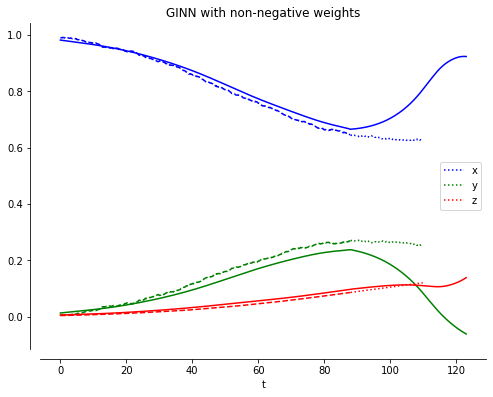

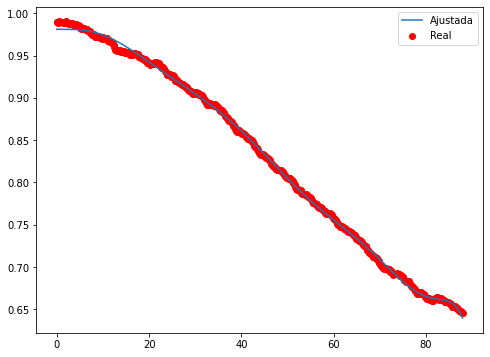

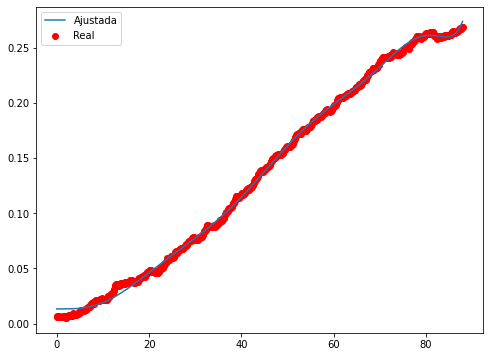

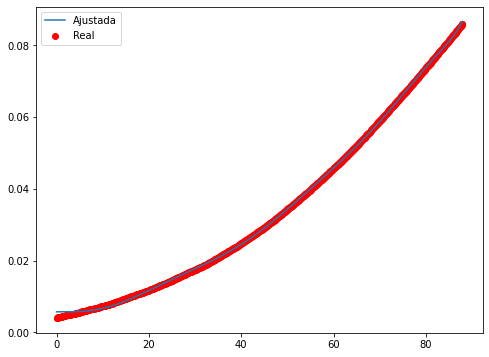

Epoch 1/500
32/32 - 1s - loss: 0.7774 - 1s/epoch - 38ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0943 - 106ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0173 - 90ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0057 - 91ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0029 - 115ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0020 - 95ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 0.0016 - 96ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 0.0014 - 96ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 0.0012 - 101ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 0.0010 - 107ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 9.1770e-04 - 113ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 8.1580e-04 - 96ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 7.2714e-04 - 98ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 6.5007e-04 - 99ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 5.7964e-04 - 121ms/epoch - 4ms/step
Epoch 16/500
32/32 - 0s - loss: 5.1286e

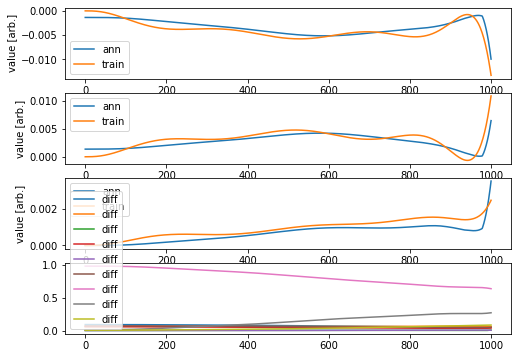

Validation loss: 0.19440965659109685
Testing loss: 31.597515119508017


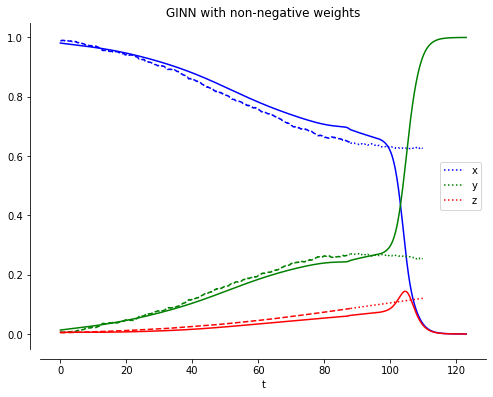

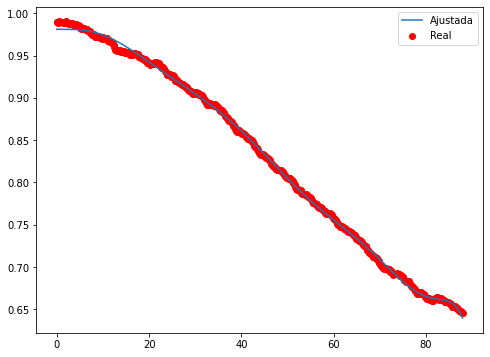

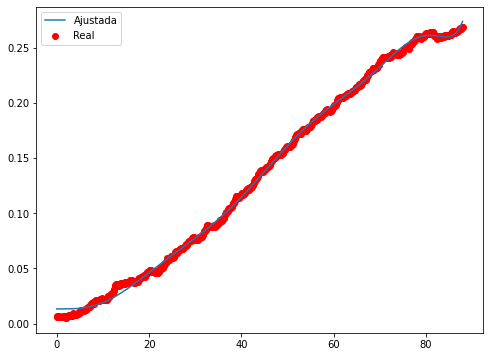

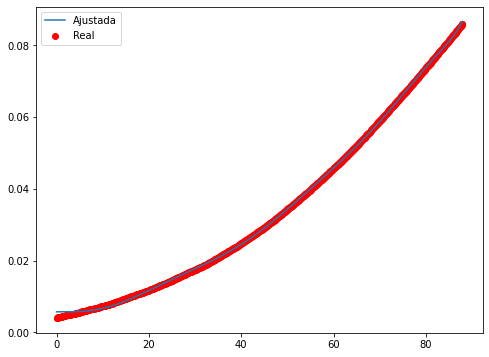

Epoch 1/500
32/32 - 1s - loss: 0.4171 - 1s/epoch - 38ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0447 - 114ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0079 - 97ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0035 - 94ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0024 - 93ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0020 - 92ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 0.0017 - 94ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 0.0015 - 106ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 0.0013 - 105ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 0.0012 - 99ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 0.0010 - 99ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 8.9643e-04 - 92ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 7.8119e-04 - 91ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 6.7857e-04 - 111ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 5.8935e-04 - 89ms/epoch - 3ms/step
Epoch 16/500
32/32 - 0s - loss: 5.1400e-04 - 

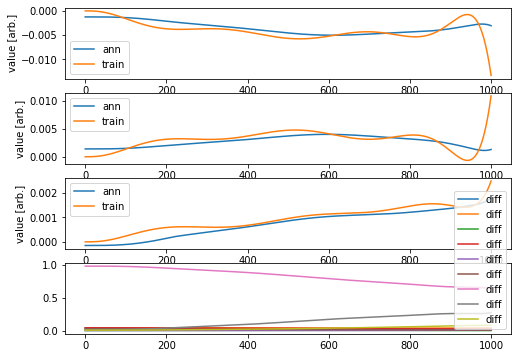

Validation loss: 0.09144272176901333
Testing loss: 0.057072559429470815


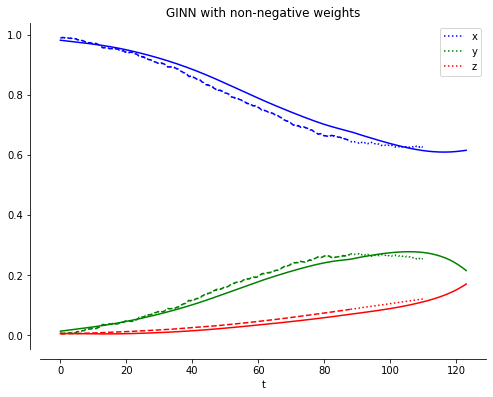

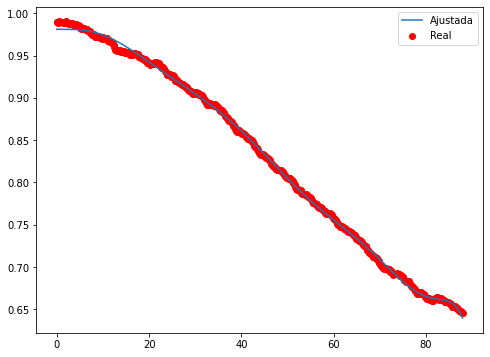

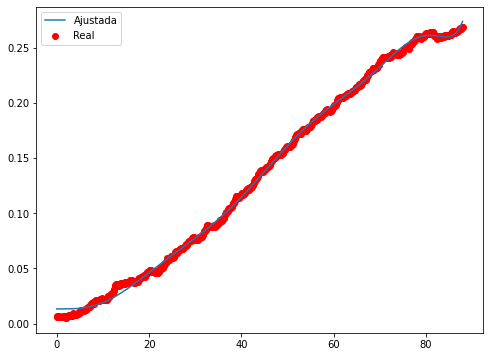

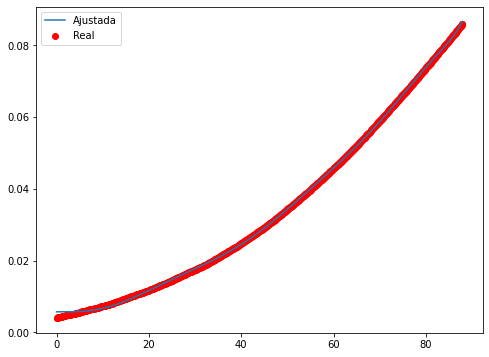

Epoch 1/500
32/32 - 2s - loss: 0.2563 - 2s/epoch - 54ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0173 - 93ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0025 - 108ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0012 - 88ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 8.7774e-04 - 89ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 7.4527e-04 - 93ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 6.4764e-04 - 83ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 5.6416e-04 - 97ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 4.9200e-04 - 82ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 4.2939e-04 - 84ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 3.7453e-04 - 83ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 3.2777e-04 - 90ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 2.8894e-04 - 94ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 2.5480e-04 - 95ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 2.2439e-04 - 97ms/epoch - 3ms/step
Epoch 16/500
32/32 -

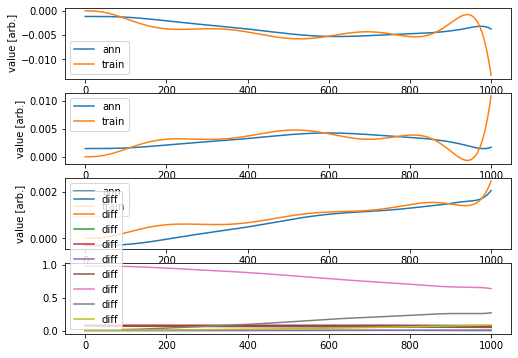

Validation loss: 0.17178859174720693
Testing loss: 1.7113480950569953


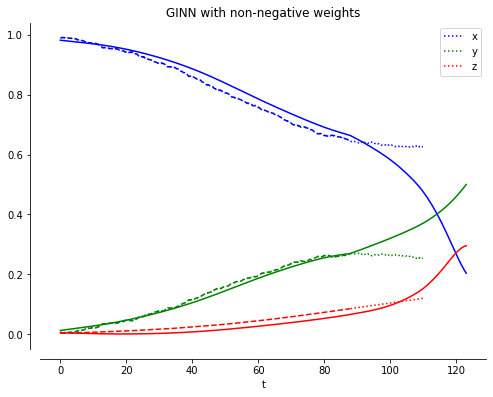

____________________________
Iteración =  8
Min =  0.06989518180235846
[[0, 1, 0, 0, 0, 1], [0, 1, 0, 0, 0, 1], [0, 1, 0, 0, 0, 1], [0, 1, 1, 0, 0, 1], [0, 1, 1, 0, 1, 0]]
[0.06989518180235846, 0.30253458934435157, 0.14073881611792677, 0.14698108422783035, 0.2948602621482329]


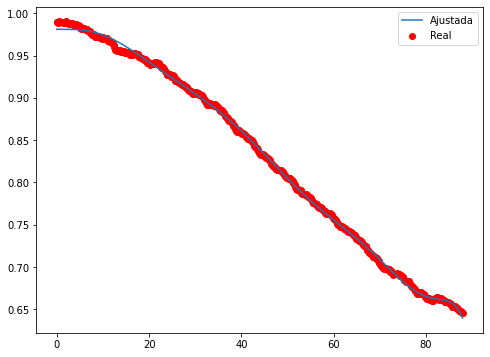

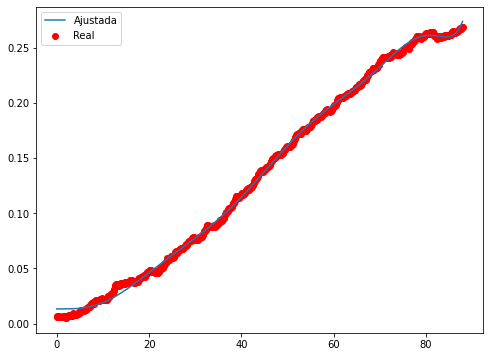

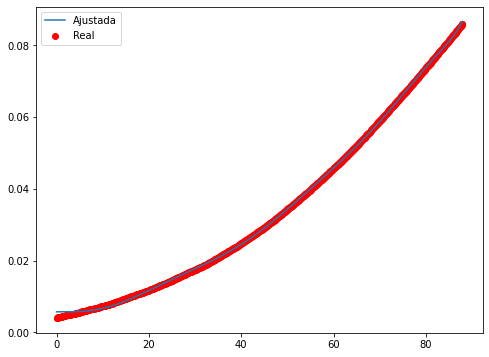

Epoch 1/500
32/32 - 2s - loss: 0.5717 - 2s/epoch - 56ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0811 - 98ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0203 - 95ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0080 - 103ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0042 - 91ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0026 - 90ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 0.0019 - 93ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 0.0015 - 98ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 0.0013 - 88ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 0.0011 - 87ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 8.8593e-04 - 93ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 7.4675e-04 - 81ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 6.2972e-04 - 107ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 5.3256e-04 - 84ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 4.4966e-04 - 84ms/epoch - 3ms/step
Epoch 16/500
32/32 - 0s - loss: 3.7931e-04 

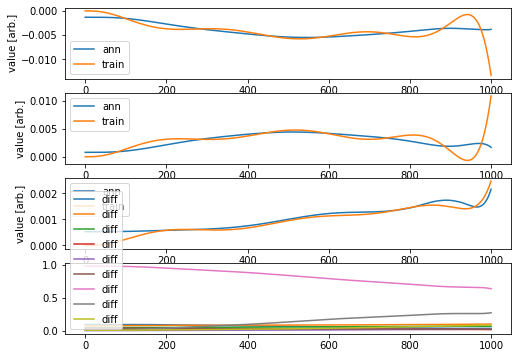

Validation loss: 0.14096479059418643
Testing loss: 1.2382607817474232


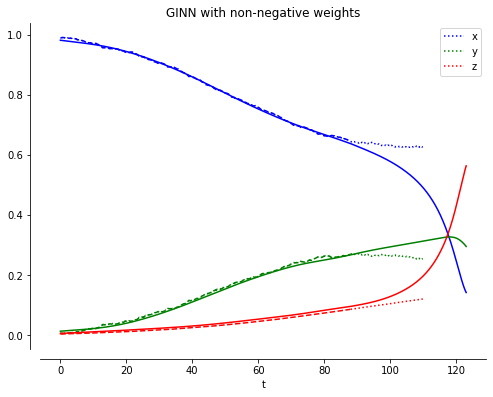

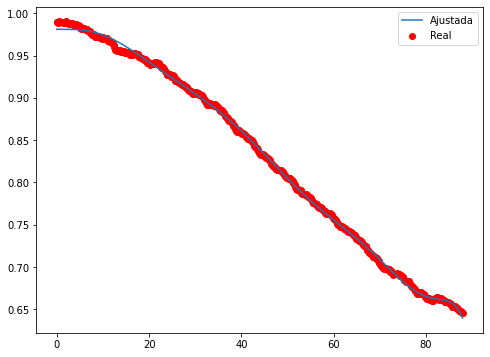

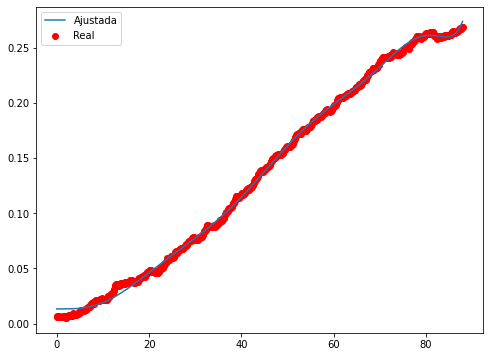

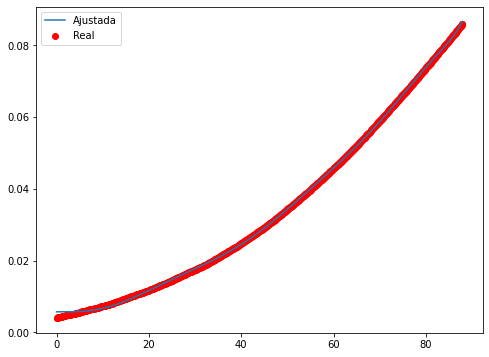

Epoch 1/500
32/32 - 2s - loss: 0.1000 - 2s/epoch - 58ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0098 - 93ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0019 - 99ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 8.2568e-04 - 98ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 5.6343e-04 - 119ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 4.3320e-04 - 93ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 3.3592e-04 - 96ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 2.6062e-04 - 94ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 2.0026e-04 - 84ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 1.5379e-04 - 90ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 1.1771e-04 - 96ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 9.0064e-05 - 96ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 6.9734e-05 - 91ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 5.5023e-05 - 96ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 4.4691e-05 - 104ms/epoch - 3ms/step
Epoch 16/500
32

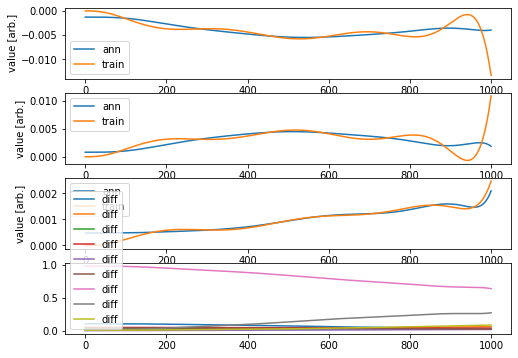

Validation loss: 0.13423426490624946
Testing loss: 0.913865745949859


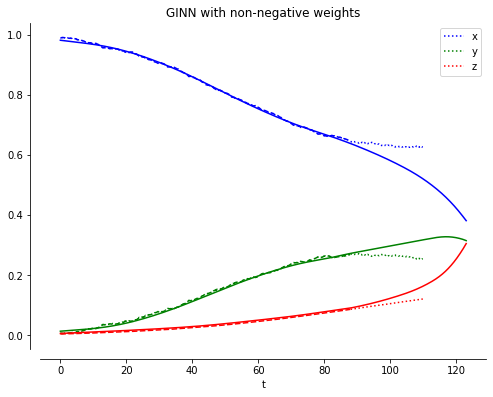

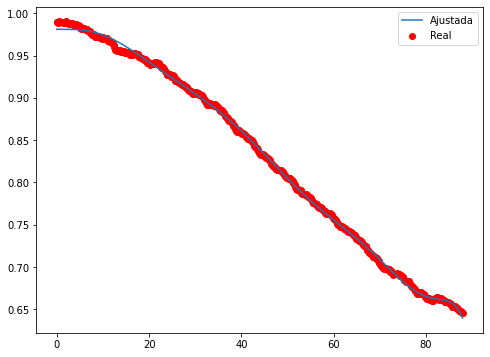

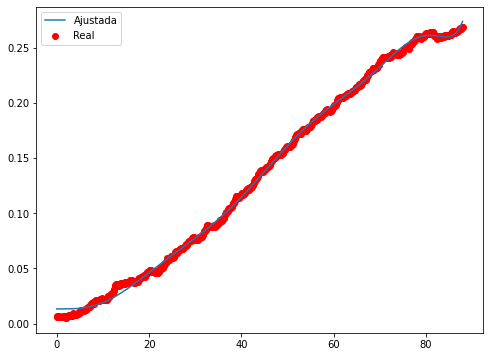

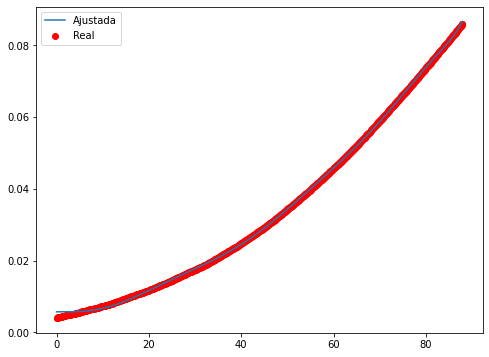

Epoch 1/500
32/32 - 2s - loss: 0.1089 - 2s/epoch - 65ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0101 - 92ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0016 - 90ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 6.5990e-04 - 96ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 4.4639e-04 - 101ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 3.5395e-04 - 92ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 2.8566e-04 - 98ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 2.2949e-04 - 88ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 1.8249e-04 - 101ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 1.4418e-04 - 85ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 1.1302e-04 - 87ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 8.8475e-05 - 104ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 6.8458e-05 - 101ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 5.3345e-05 - 93ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 4.1727e-05 - 115ms/epoch - 4ms/step
Epoch 16/500

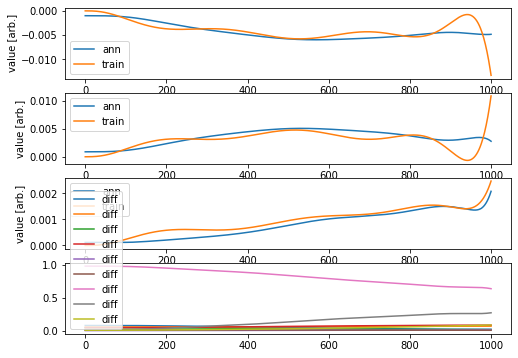

Validation loss: 0.6043143260910827
Testing loss: 4.011728233194637


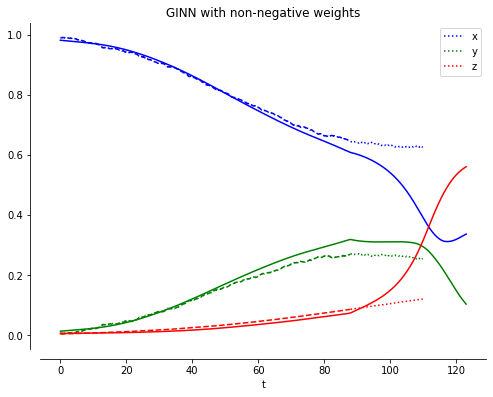

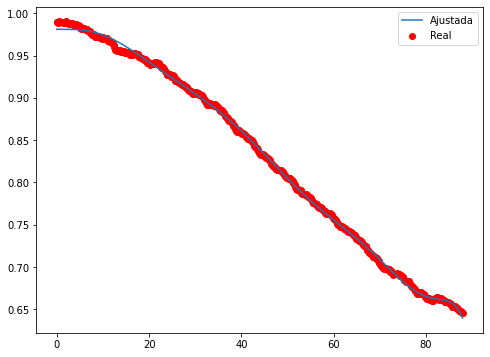

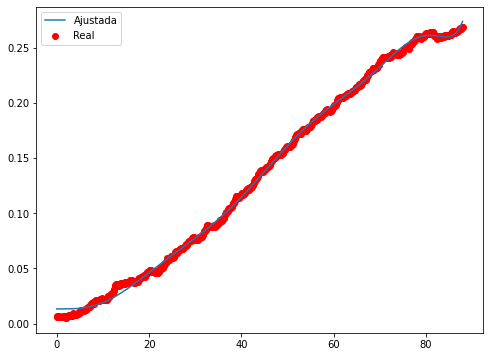

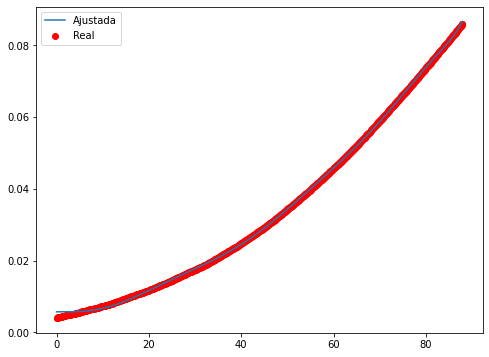

Epoch 1/500
32/32 - 1s - loss: 0.1311 - 1s/epoch - 38ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0129 - 108ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0028 - 79ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0013 - 97ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 8.6155e-04 - 111ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 6.2236e-04 - 93ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 4.6846e-04 - 95ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 3.5643e-04 - 99ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 2.7106e-04 - 95ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 2.0736e-04 - 99ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 1.6000e-04 - 94ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 1.2416e-04 - 104ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 9.7387e-05 - 97ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 7.7602e-05 - 96ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 6.2915e-05 - 98ms/epoch - 3ms/step
Epoch 16/500
32/32

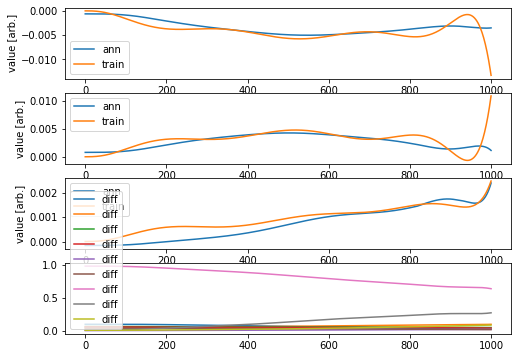

Validation loss: 0.13191618773663735
Testing loss: 0.07084375494327504


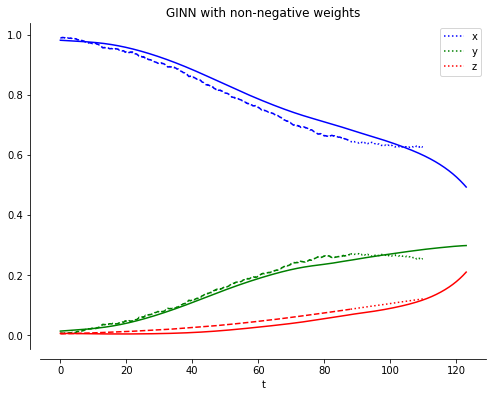

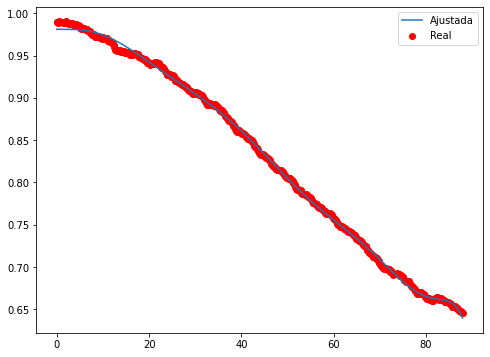

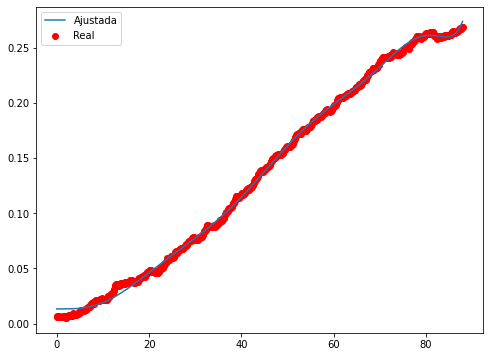

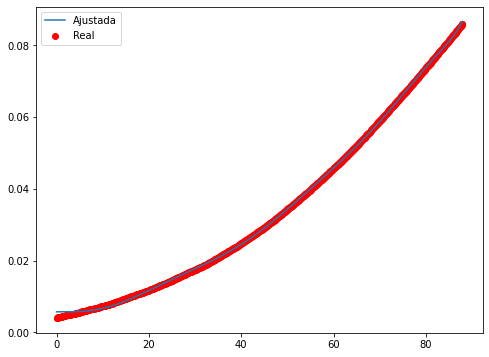

Epoch 1/500
32/32 - 1s - loss: 0.3401 - 1s/epoch - 36ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0578 - 86ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0145 - 87ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0057 - 92ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0031 - 94ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0021 - 90ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 0.0016 - 82ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 0.0013 - 85ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 0.0011 - 99ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 8.9473e-04 - 105ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 7.4245e-04 - 86ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 6.1559e-04 - 105ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 5.0907e-04 - 103ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 4.2006e-04 - 94ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 3.4569e-04 - 108ms/epoch - 3ms/step
Epoch 16/500
32/32 - 0s - loss: 2.819

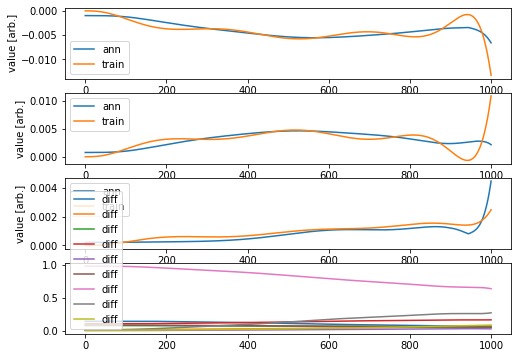

Validation loss: 1.0804610237886638
Testing loss: 30.24657104209438


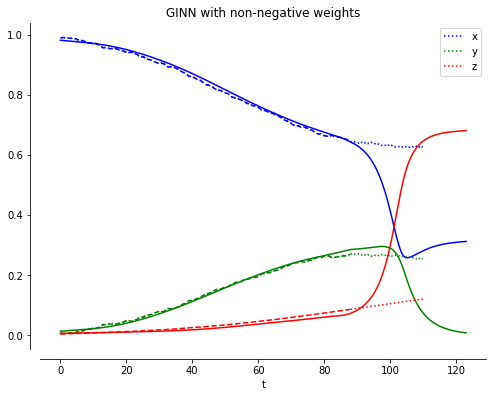

____________________________
Iteración =  9
Min =  0.06989518180235846
[[0, 1, 0, 0, 0, 1], [0, 1, 0, 0, 0, 1], [0, 1, 0, 0, 0, 1], [0, 1, 1, 0, 0, 1], [0, 1, 1, 0, 1, 0]]
[0.06989518180235846, 0.30253458934435157, 0.14073881611792677, 0.14698108422783035, 0.2948602621482329]


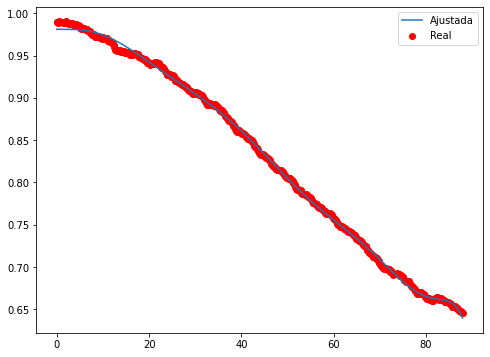

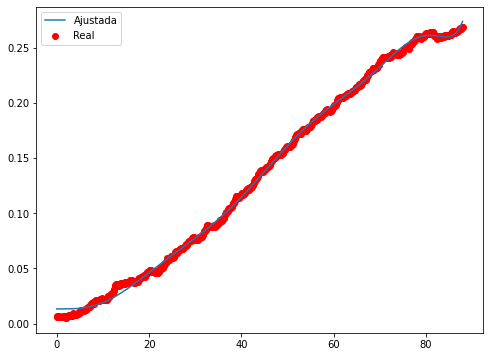

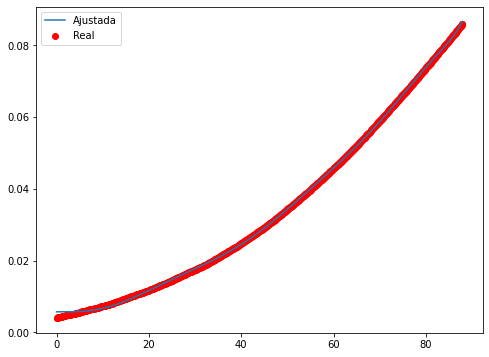

Epoch 1/500
32/32 - 1s - loss: 0.0913 - 1s/epoch - 37ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0058 - 85ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0014 - 91ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 7.1409e-04 - 93ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 4.6981e-04 - 79ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 3.4736e-04 - 100ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 2.7113e-04 - 100ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 2.1582e-04 - 89ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 1.7285e-04 - 95ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 1.3775e-04 - 89ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 1.1085e-04 - 86ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 8.9615e-05 - 90ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 7.1933e-05 - 91ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 5.7329e-05 - 91ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 4.5632e-05 - 91ms/epoch - 3ms/step
Epoch 16/500
32

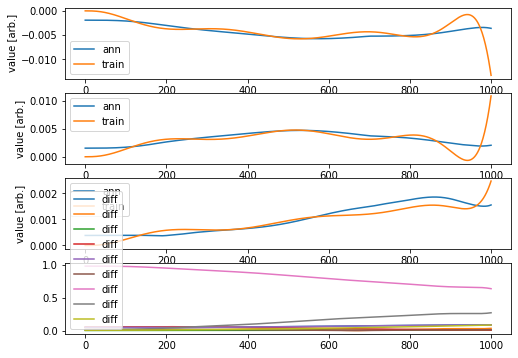

Validation loss: 1.0463549555240514
Testing loss: 5.037630097977295


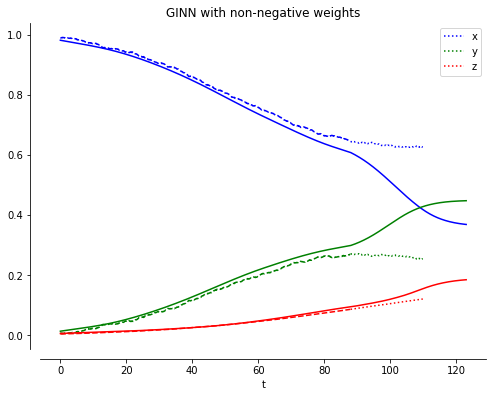

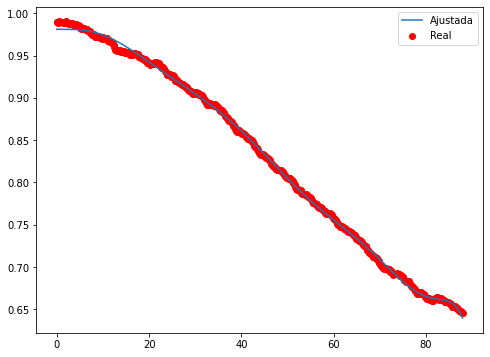

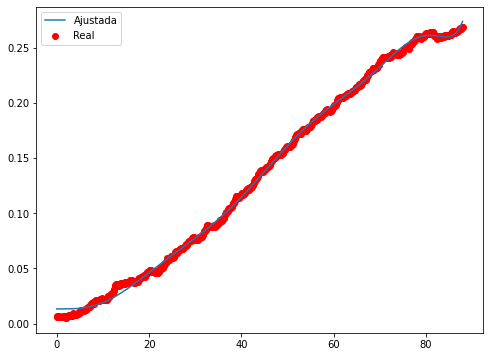

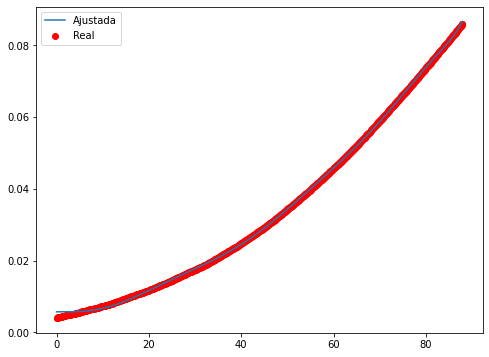

Epoch 1/500
32/32 - 1s - loss: 0.3021 - 1s/epoch - 38ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0510 - 104ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0149 - 98ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0061 - 97ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0032 - 91ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0021 - 95ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 0.0015 - 92ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 0.0013 - 104ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 0.0011 - 93ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 9.1476e-04 - 93ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 7.9535e-04 - 94ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 6.9268e-04 - 96ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 6.0661e-04 - 98ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 5.3142e-04 - 98ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 4.6566e-04 - 96ms/epoch - 3ms/step
Epoch 16/500
32/32 - 0s - loss: 4.0632e

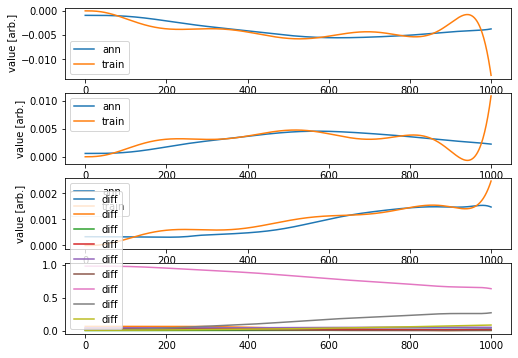

Validation loss: 0.10268174875410047
Testing loss: 0.47893238635113566


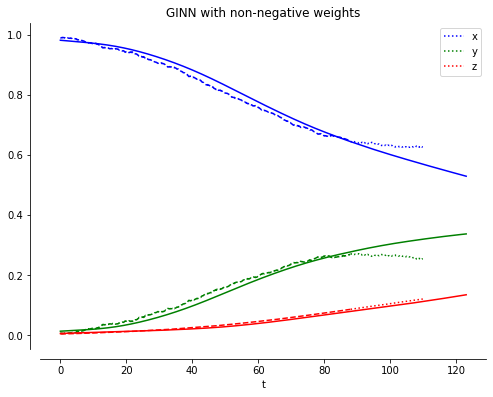

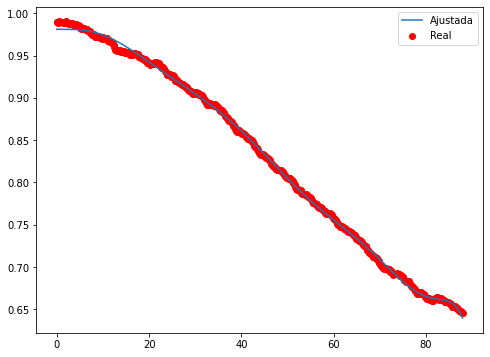

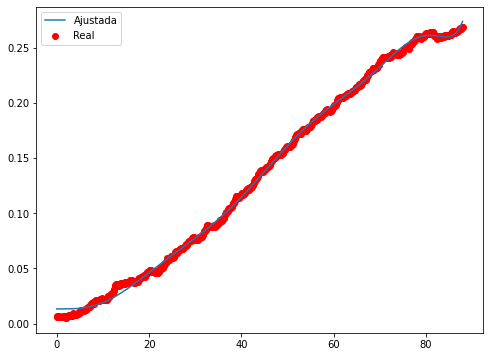

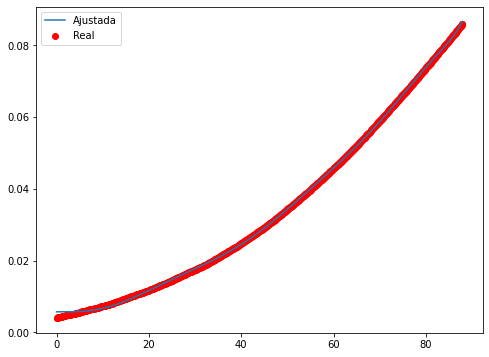

Epoch 1/500
32/32 - 1s - loss: 0.4330 - 1s/epoch - 37ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0625 - 101ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0146 - 85ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0056 - 89ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0030 - 90ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0019 - 93ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 0.0014 - 89ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 0.0011 - 96ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 9.2856e-04 - 90ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 8.0101e-04 - 91ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 7.0081e-04 - 97ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 6.1838e-04 - 99ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 5.4517e-04 - 84ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 4.7875e-04 - 104ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 4.1845e-04 - 97ms/epoch - 3ms/step
Epoch 16/500
32/32 - 0s - loss: 3.6

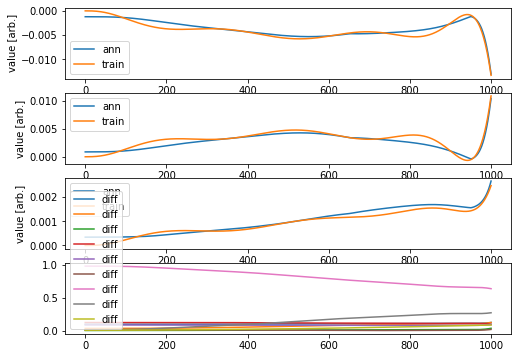

Validation loss: 0.6408075575813303
Testing loss: 19.906253499681988


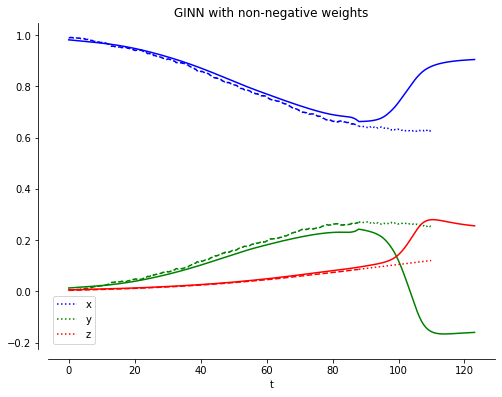

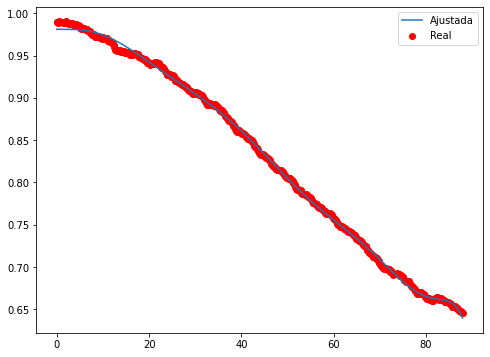

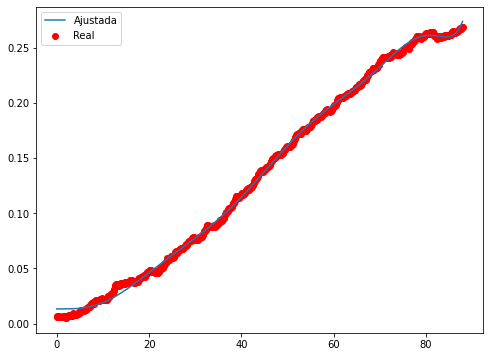

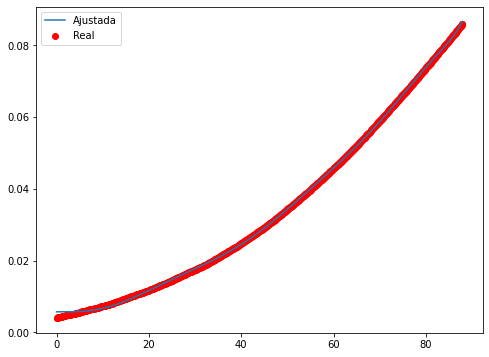

Epoch 1/500
32/32 - 1s - loss: 0.1541 - 1s/epoch - 46ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0149 - 89ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0035 - 99ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0016 - 101ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0011 - 93ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 8.1465e-04 - 107ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 6.6465e-04 - 122ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 5.5048e-04 - 122ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 4.5741e-04 - 115ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 3.7779e-04 - 105ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 3.1075e-04 - 109ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 2.5199e-04 - 99ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 2.0057e-04 - 102ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 1.5887e-04 - 92ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 1.2709e-04 - 81ms/epoch - 3ms/step
Epoch 16/500
32/3

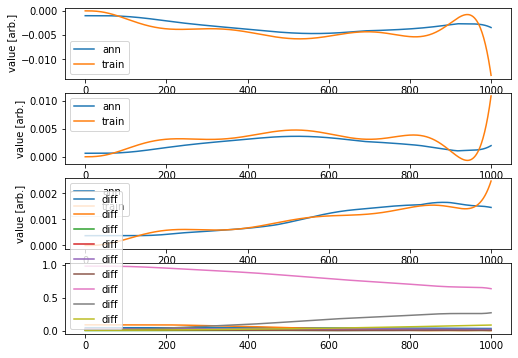

Validation loss: 1.101908029010638
Testing loss: 5.3786491287364


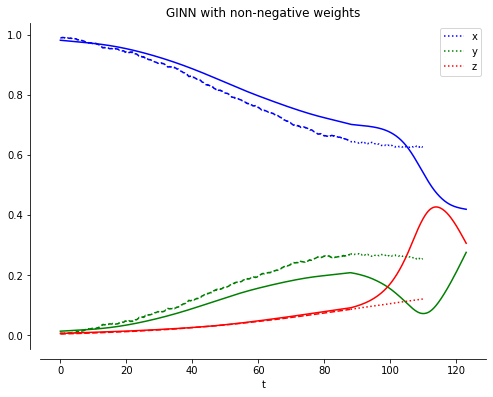

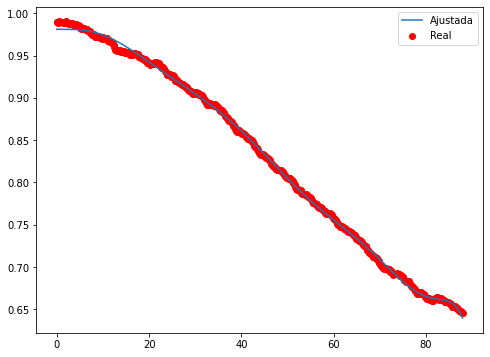

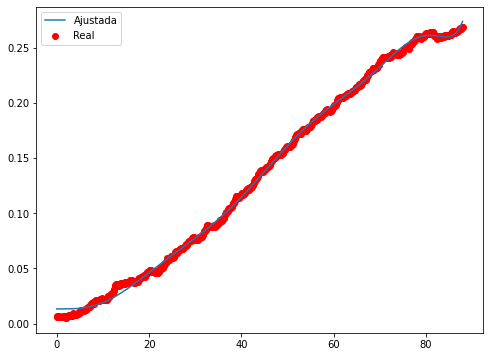

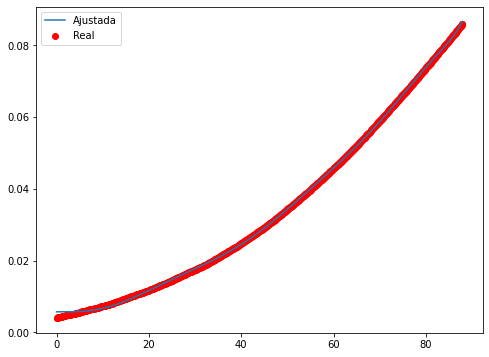

Epoch 1/500
32/32 - 2s - loss: 0.1407 - 2s/epoch - 58ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0112 - 87ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0026 - 103ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0014 - 92ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0010 - 86ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 7.7397e-04 - 87ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 6.0660e-04 - 93ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 4.8709e-04 - 99ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 3.9404e-04 - 100ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 3.2016e-04 - 96ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 2.6051e-04 - 88ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 2.1165e-04 - 89ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 1.7208e-04 - 86ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 1.4158e-04 - 104ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 1.1714e-04 - 81ms/epoch - 3ms/step
Epoch 16/500
32/32 - 0

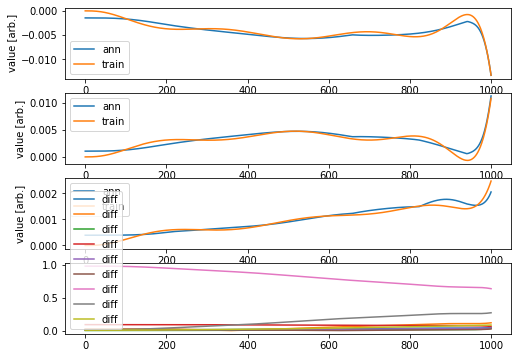

Validation loss: 18.56243301296804
Testing loss: 29.462794545523437


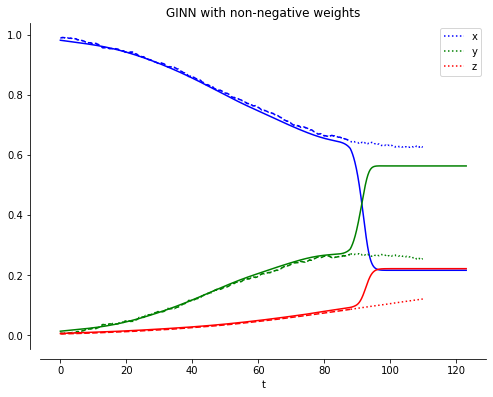

____________________________
Iteración =  10
Min =  0.06989518180235846
[[0, 1, 0, 0, 0, 1], [0, 1, 0, 0, 0, 1], [0, 1, 0, 0, 0, 1], [0, 1, 1, 0, 0, 1], [0, 1, 1, 0, 1, 0]]
[0.06989518180235846, 0.30253458934435157, 0.14073881611792677, 0.14698108422783035, 0.2948602621482329]


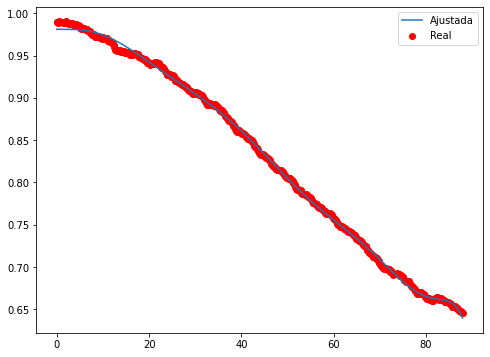

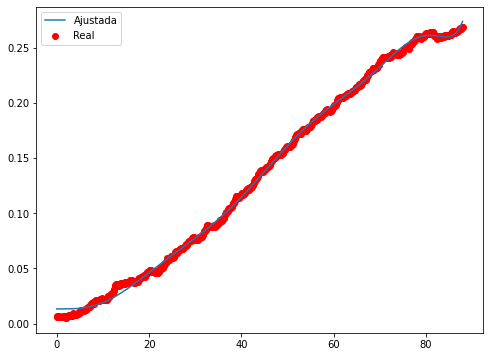

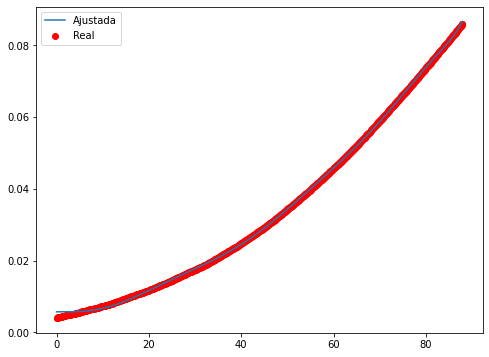

Epoch 1/500
32/32 - 2s - loss: 0.4034 - 2s/epoch - 50ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0640 - 94ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0172 - 92ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0075 - 96ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0041 - 89ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0028 - 87ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 0.0021 - 87ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 0.0017 - 96ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 0.0014 - 95ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 0.0011 - 93ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 9.2786e-04 - 92ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 7.8304e-04 - 93ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 6.6368e-04 - 103ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 5.6450e-04 - 101ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 4.7905e-04 - 100ms/epoch - 3ms/step
Epoch 16/500
32/32 - 0s - loss: 4.0558e-04

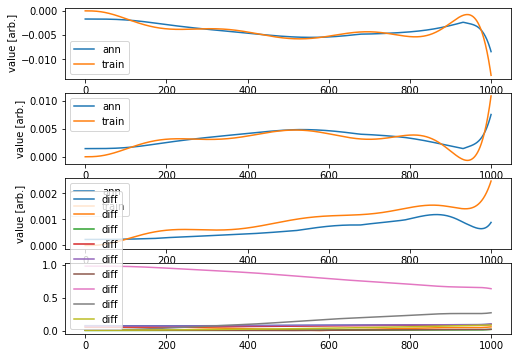

Validation loss: 5.6407751776921655
Testing loss: 19.673834118117725


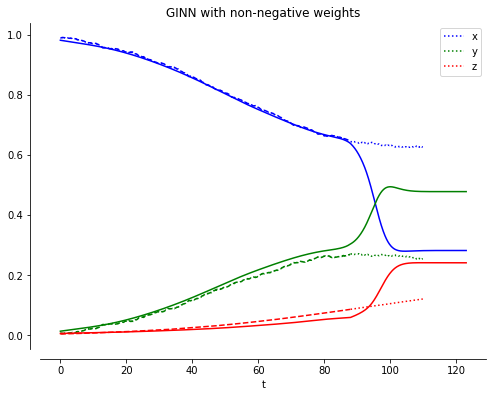

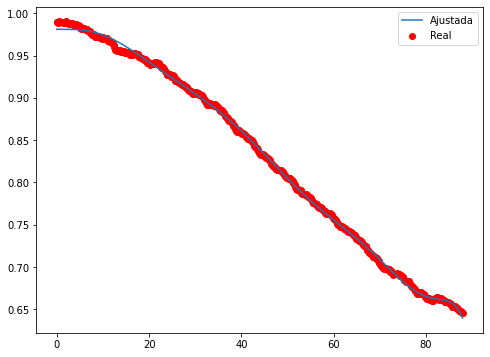

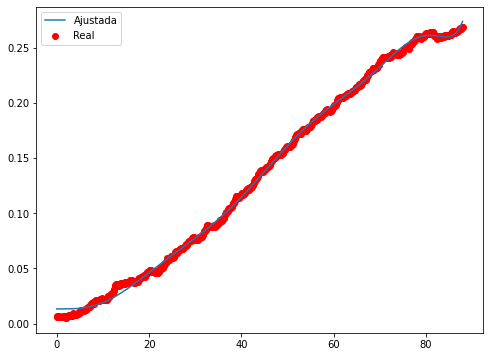

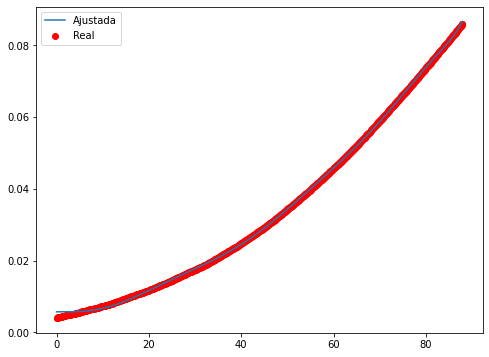

Epoch 1/500
32/32 - 2s - loss: 0.0325 - 2s/epoch - 53ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0025 - 92ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 7.9174e-04 - 96ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 5.1279e-04 - 91ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 3.8509e-04 - 101ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 2.9875e-04 - 104ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 2.3395e-04 - 100ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 1.8646e-04 - 128ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 1.5304e-04 - 96ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 1.2834e-04 - 97ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 1.1092e-04 - 93ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 9.7839e-05 - 95ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 8.6092e-05 - 106ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 7.6121e-05 - 92ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 6.7745e-05 - 98ms/epoch - 3ms/step
Epoch 16

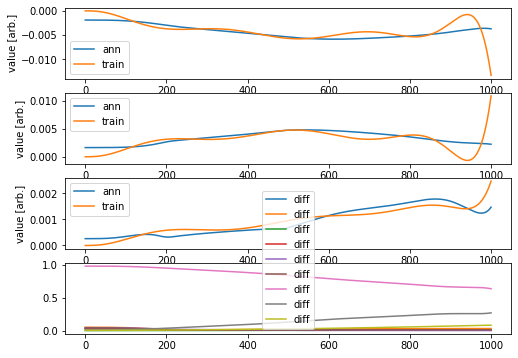

Validation loss: 0.6335769055642119
Testing loss: 1.1682783513416106


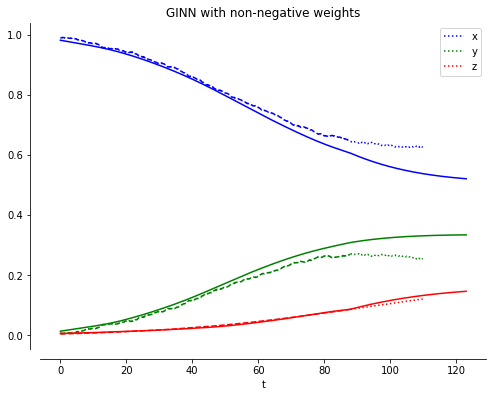

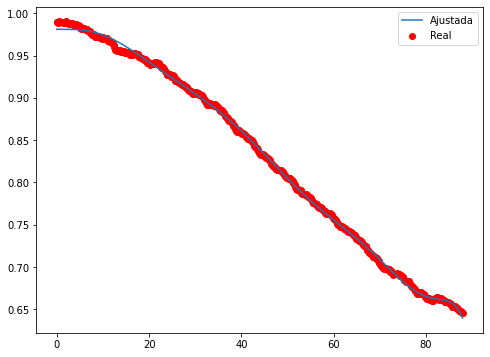

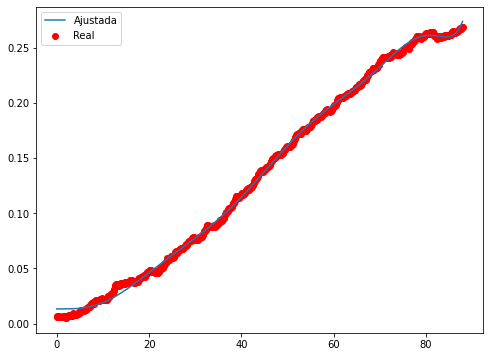

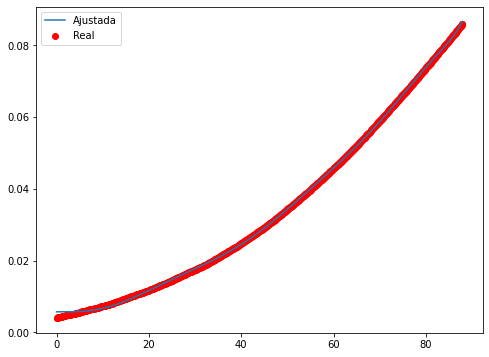

Epoch 1/500
32/32 - 2s - loss: 0.1197 - 2s/epoch - 54ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0121 - 89ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0028 - 88ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0013 - 96ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 8.2541e-04 - 108ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 6.2620e-04 - 104ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 5.0240e-04 - 96ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 4.1527e-04 - 88ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 3.4689e-04 - 91ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 2.9301e-04 - 90ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 2.5038e-04 - 84ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 2.1493e-04 - 94ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 1.8610e-04 - 91ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 1.6200e-04 - 87ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 1.4159e-04 - 90ms/epoch - 3ms/step
Epoch 16/500
32/32 

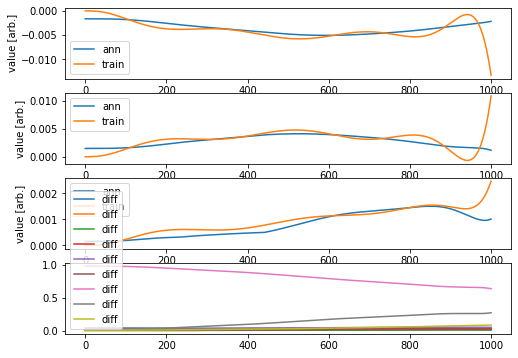

Validation loss: 0.04503361137243736
Testing loss: 0.08970220343569812


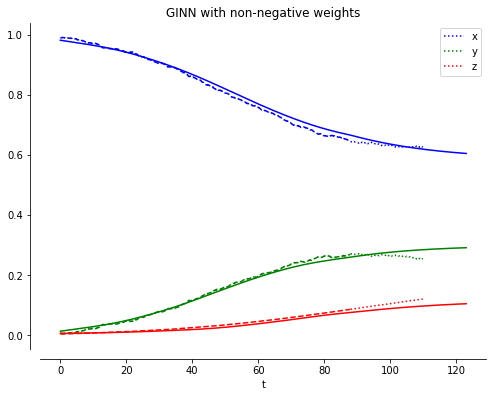

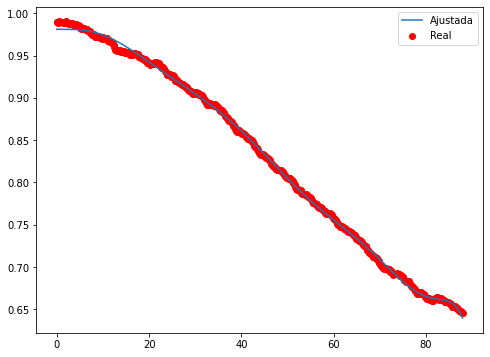

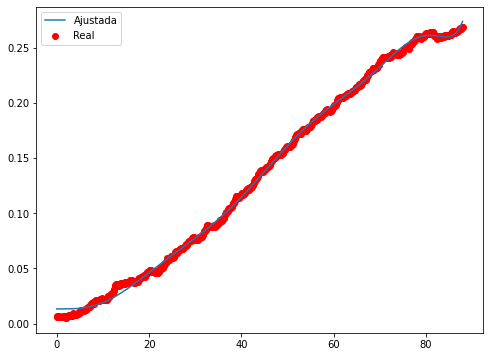

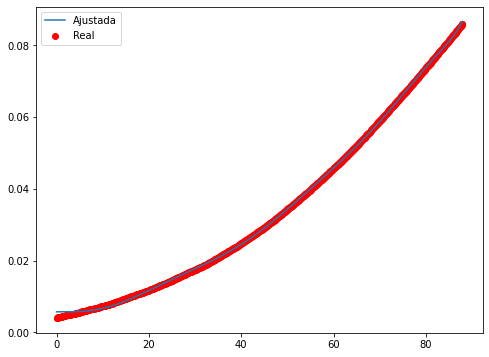

Epoch 1/500
32/32 - 2s - loss: 0.1908 - 2s/epoch - 53ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0218 - 99ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0051 - 103ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0020 - 98ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0012 - 96ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 8.0052e-04 - 96ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 6.1592e-04 - 95ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 5.1172e-04 - 100ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 4.3751e-04 - 87ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 3.7972e-04 - 117ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 3.3097e-04 - 93ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 2.8905e-04 - 92ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 2.5199e-04 - 108ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 2.2099e-04 - 103ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 1.9348e-04 - 95ms/epoch - 3ms/step
Epoch 16/500
32/32 -

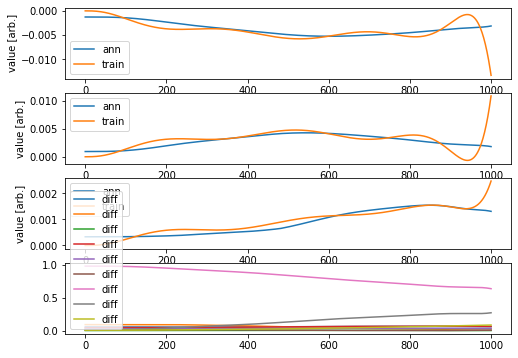

Validation loss: 0.017377386021156325
Testing loss: 0.16738837440242693


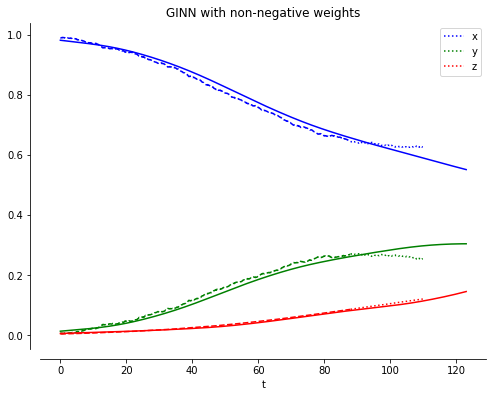

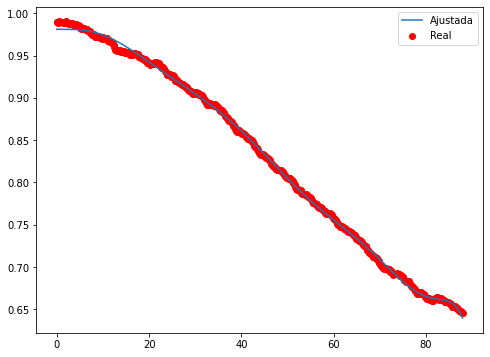

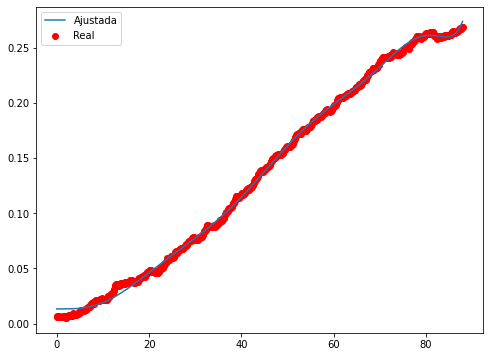

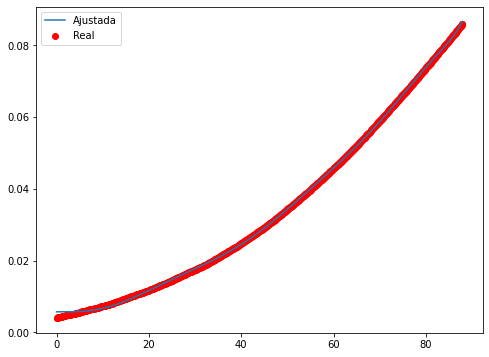

Epoch 1/500
32/32 - 2s - loss: 0.1663 - 2s/epoch - 54ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0194 - 102ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0047 - 93ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0022 - 100ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0014 - 101ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0011 - 102ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 8.6817e-04 - 87ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 7.2476e-04 - 98ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 6.1931e-04 - 101ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 5.3444e-04 - 116ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 4.6326e-04 - 87ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 4.0044e-04 - 90ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 3.4517e-04 - 85ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 2.9695e-04 - 96ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 2.5538e-04 - 90ms/epoch - 3ms/step
Epoch 16/500
32/32 - 0s

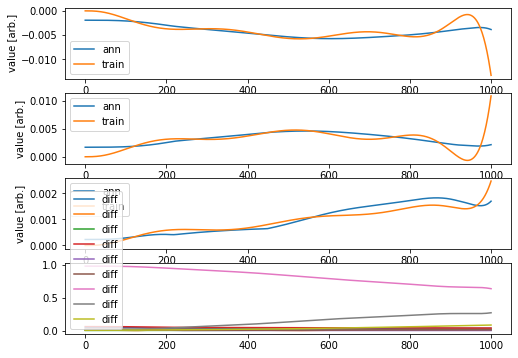

Validation loss: 0.5316215750587966
Testing loss: 1.6584381760295657


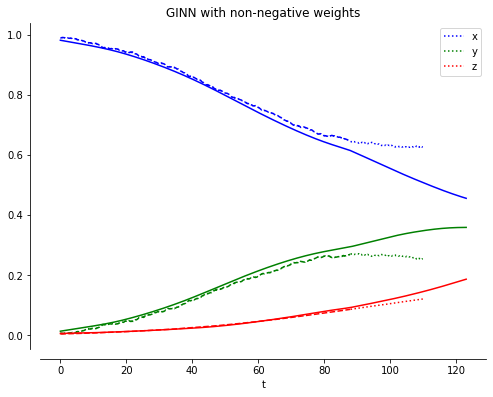

____________________________
Iteración =  11
Min =  0.06989518180235846
[[0, 1, 0, 0, 0, 1], [0, 1, 0, 0, 0, 1], [0, 1, 0, 0, 0, 1], [0, 1, 1, 0, 1, 0], [0, 1, 1, 0, 0, 1]]
[0.06989518180235846, 0.30253458934435157, 0.14073881611792677, 0.14698108422783035, 0.2948602621482329]


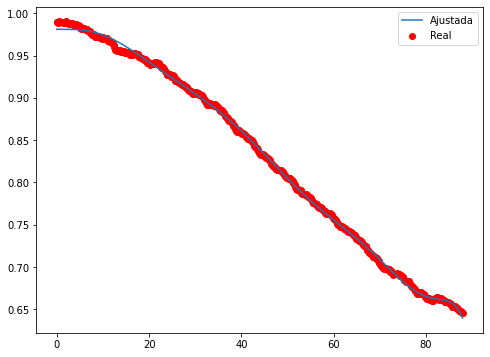

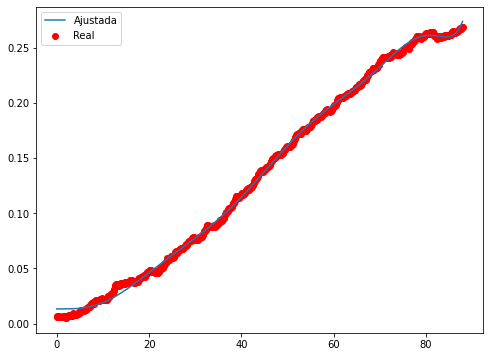

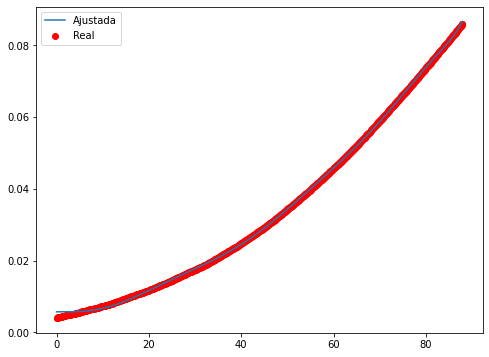

Epoch 1/500
32/32 - 2s - loss: 0.2025 - 2s/epoch - 77ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0246 - 92ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0061 - 104ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0026 - 96ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0016 - 82ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0012 - 85ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 9.7935e-04 - 103ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 8.1612e-04 - 97ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 6.8590e-04 - 90ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 5.8613e-04 - 87ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 5.0296e-04 - 92ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 4.3271e-04 - 82ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 3.7260e-04 - 88ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 3.2156e-04 - 84ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 2.7876e-04 - 104ms/epoch - 3ms/step
Epoch 16/500
32/32 - 0s - 

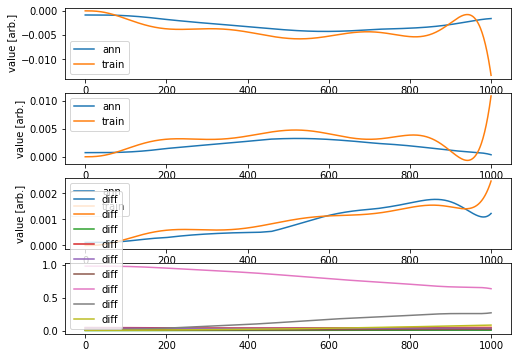

Validation loss: 1.6573781033491404
Testing loss: 1.5818180286874888


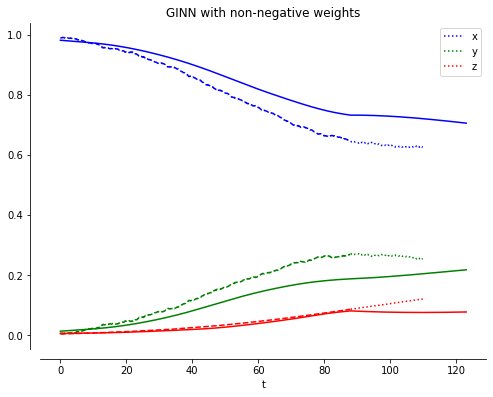

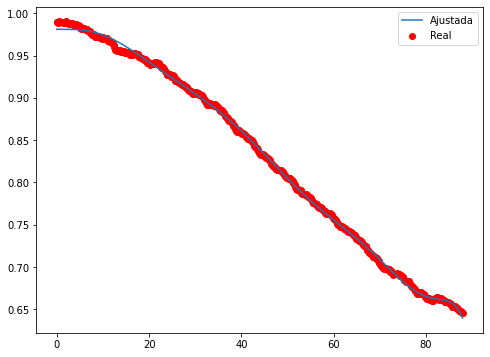

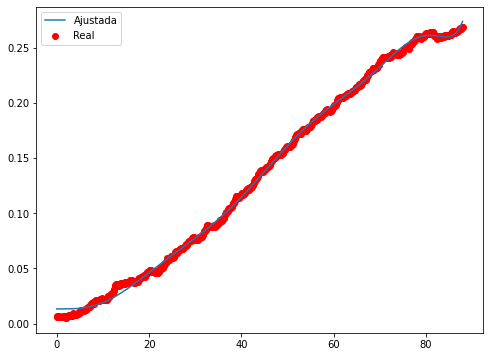

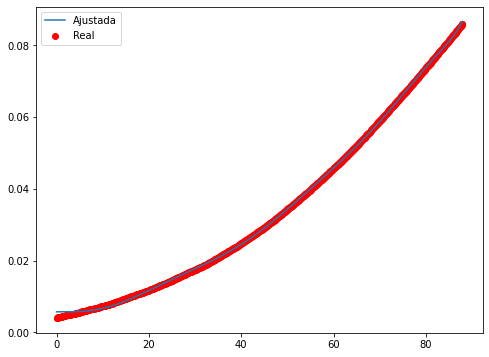

Epoch 1/500
32/32 - 2s - loss: 0.0870 - 2s/epoch - 52ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0067 - 87ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0017 - 95ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 9.5681e-04 - 84ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 6.8291e-04 - 85ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 5.1782e-04 - 86ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 3.9303e-04 - 99ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 2.9455e-04 - 101ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 2.1699e-04 - 84ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 1.5750e-04 - 91ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 1.1300e-04 - 97ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 8.0644e-05 - 100ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 5.6780e-05 - 91ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 3.9495e-05 - 94ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 2.7500e-05 - 91ms/epoch - 3ms/step
Epoch 16/500
32

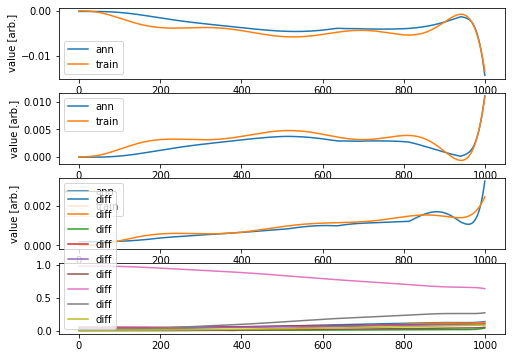

Validation loss: 1.4563233242500855
Testing loss: 1.9200140546926692


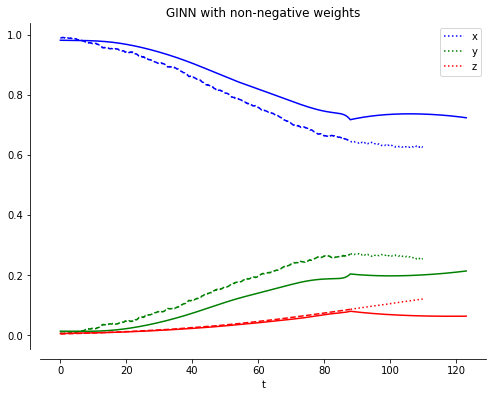

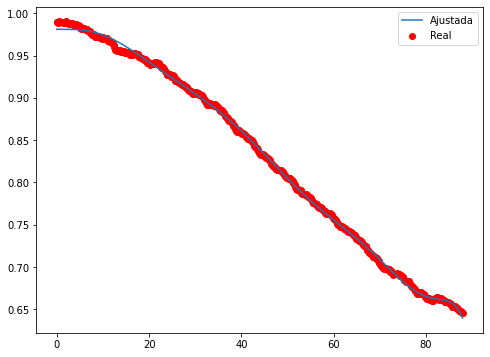

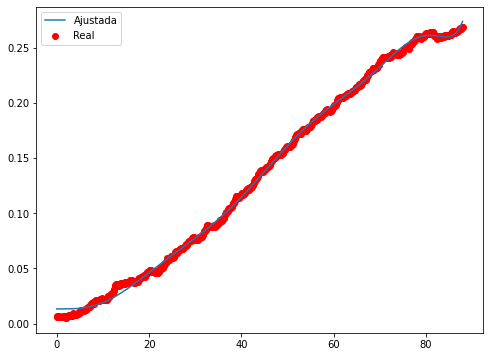

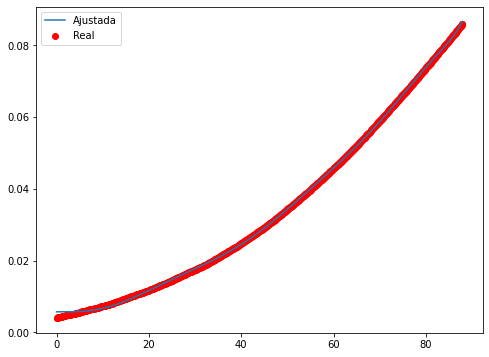

Epoch 1/500
32/32 - 2s - loss: 0.0288 - 2s/epoch - 51ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0029 - 92ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 8.5083e-04 - 93ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 5.0306e-04 - 86ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 3.4431e-04 - 95ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 2.4941e-04 - 88ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 1.8851e-04 - 91ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 1.4718e-04 - 90ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 1.1598e-04 - 111ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 9.1649e-05 - 95ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 7.2980e-05 - 96ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 5.9130e-05 - 94ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 4.8984e-05 - 76ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 4.1284e-05 - 89ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 3.5100e-05 - 99ms/epoch - 3ms/step
Epoch 16/500

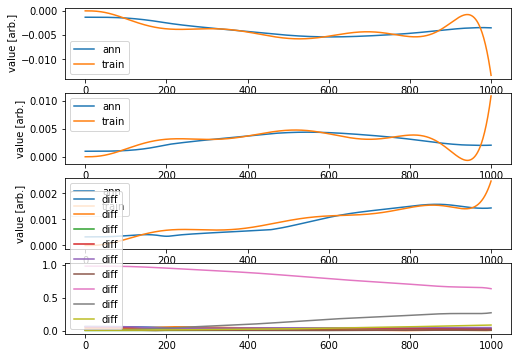

Validation loss: 0.054033381348746856
Testing loss: 0.38535821985444546


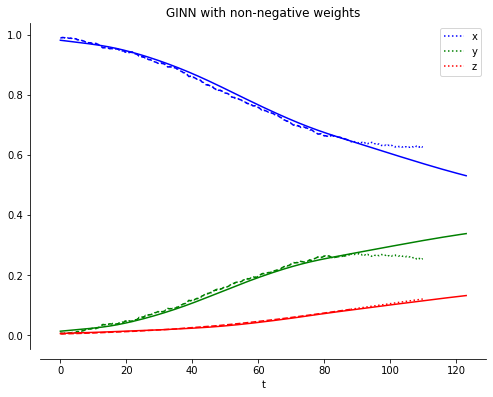

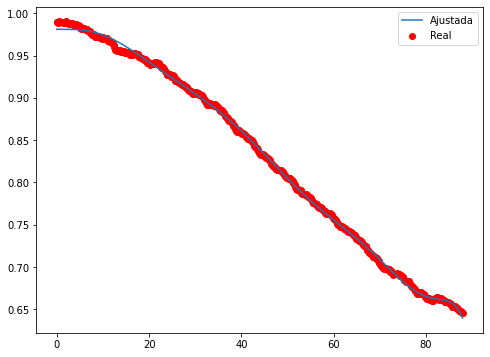

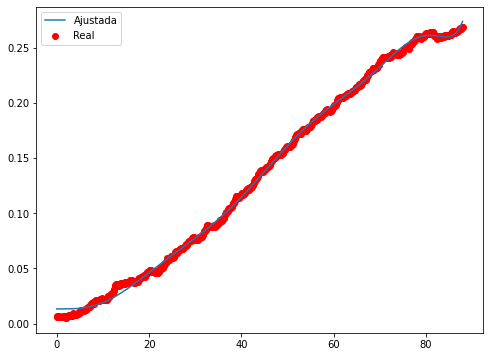

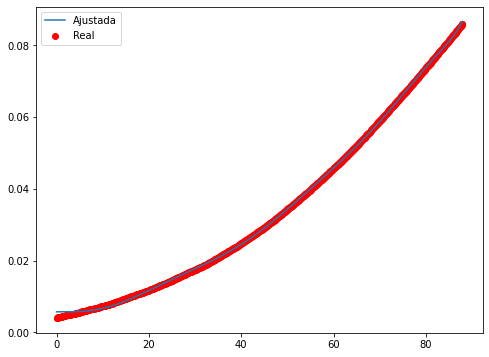

Epoch 1/500
32/32 - 2s - loss: 0.1291 - 2s/epoch - 54ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0111 - 91ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0023 - 107ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0011 - 110ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 6.7032e-04 - 93ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 4.7798e-04 - 98ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 3.7344e-04 - 98ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 3.1058e-04 - 120ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 2.7070e-04 - 95ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 2.3884e-04 - 88ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 2.1050e-04 - 90ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 1.8526e-04 - 91ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 1.6230e-04 - 91ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 1.4162e-04 - 92ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 1.2296e-04 - 86ms/epoch - 3ms/step
Epoch 16/500
32/32

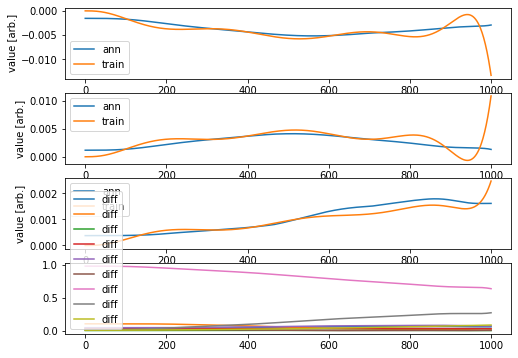

Validation loss: 0.06631686080128543
Testing loss: 1.3582200075671145


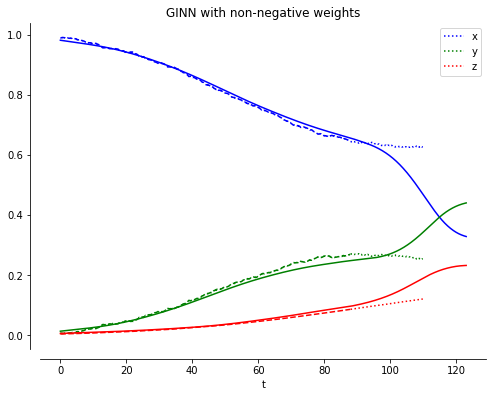

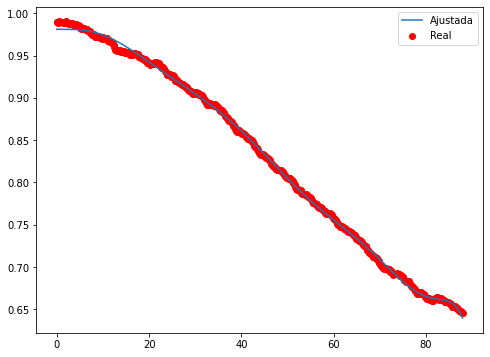

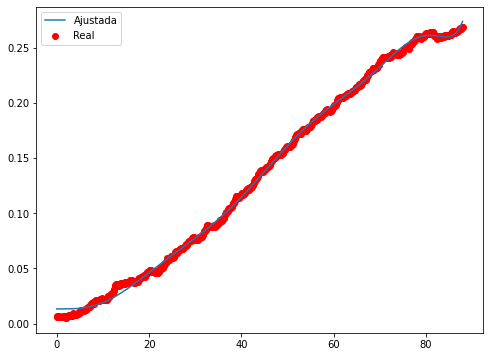

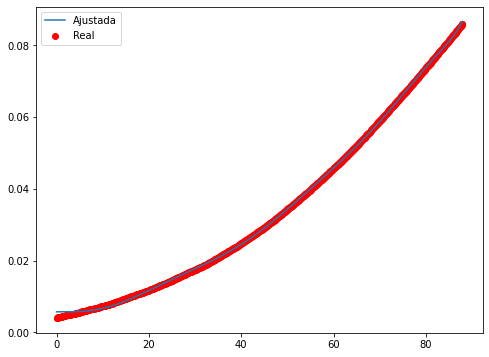

Epoch 1/500
32/32 - 2s - loss: 0.0799 - 2s/epoch - 55ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0078 - 84ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0018 - 95ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 8.3431e-04 - 103ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 5.6726e-04 - 94ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 4.2880e-04 - 107ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 3.3437e-04 - 101ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 2.6205e-04 - 100ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 2.0412e-04 - 119ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 1.6031e-04 - 104ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 1.2715e-04 - 98ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 1.0159e-04 - 98ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 8.2214e-05 - 97ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 6.6785e-05 - 95ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 5.3962e-05 - 92ms/epoch - 3ms/step
Epoch 16/50

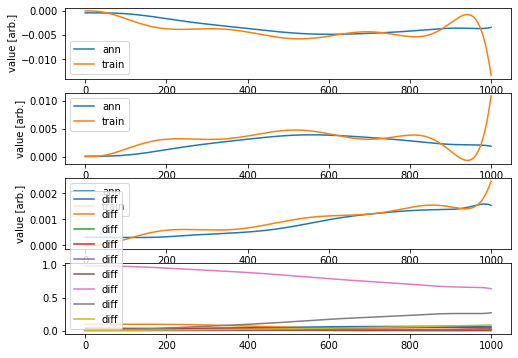

Validation loss: 0.26305012741891204
Testing loss: 0.05589528942369186


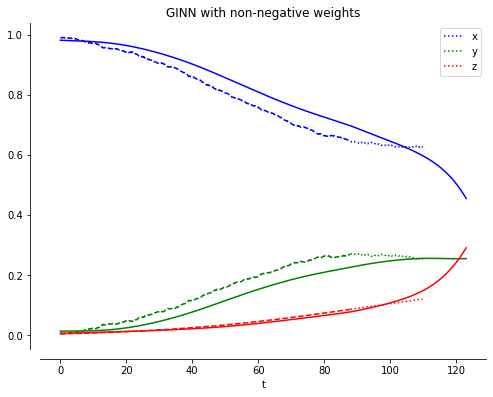

____________________________
Iteración =  12
Min =  0.06989518180235846
[[0, 1, 0, 0, 0, 1], [0, 1, 0, 0, 0, 1], [0, 1, 0, 0, 0, 1], [0, 1, 1, 0, 1, 0], [0, 1, 1, 0, 0, 1]]
[0.06989518180235846, 0.30253458934435157, 0.14073881611792677, 0.14698108422783035, 0.2948602621482329]


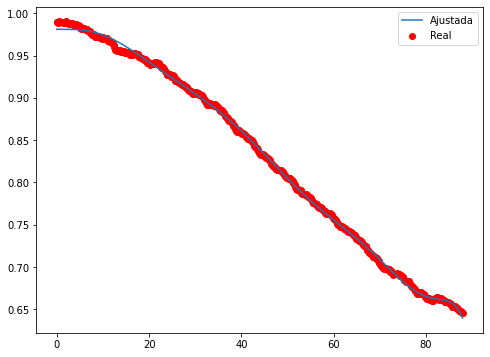

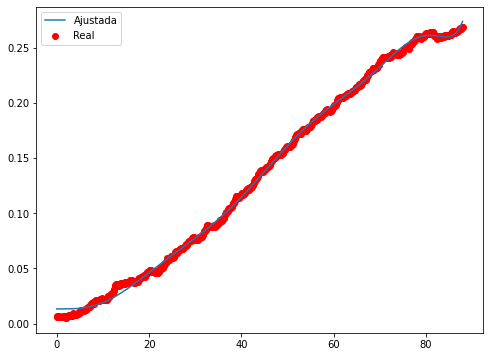

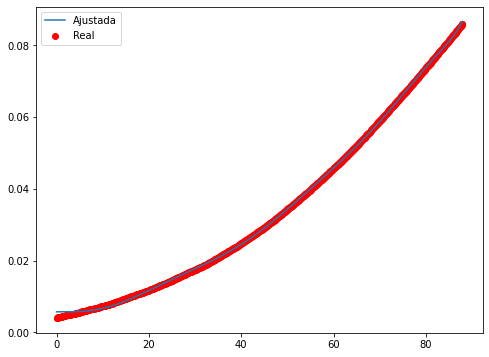

Epoch 1/500
32/32 - 2s - loss: 0.1816 - 2s/epoch - 55ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0233 - 93ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0044 - 89ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0015 - 93ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 8.8881e-04 - 91ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 6.8658e-04 - 115ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 6.0373e-04 - 87ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 5.4833e-04 - 89ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 5.0335e-04 - 92ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 4.5984e-04 - 86ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 4.1583e-04 - 83ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 3.7030e-04 - 84ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 3.2568e-04 - 87ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 2.8286e-04 - 85ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 2.4421e-04 - 99ms/epoch - 3ms/step
Epoch 16/500
32/32 -

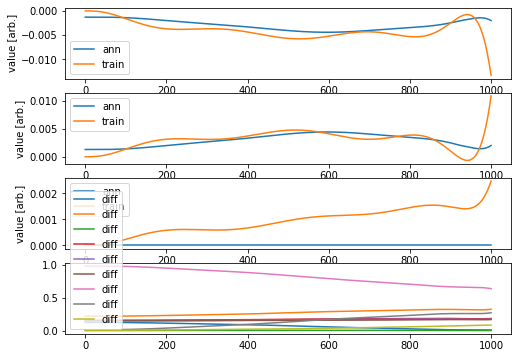

Validation loss: 2.823855111304842
Testing loss: 39.874089205699484


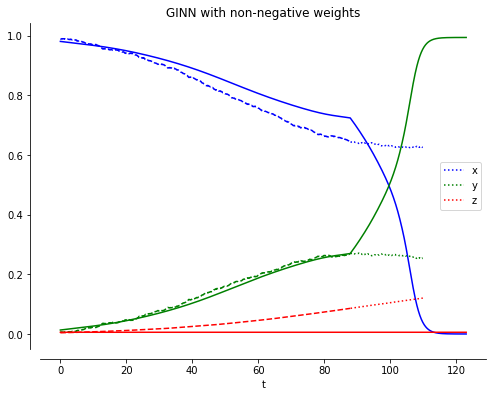

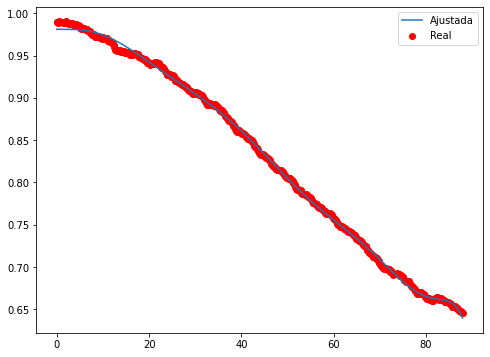

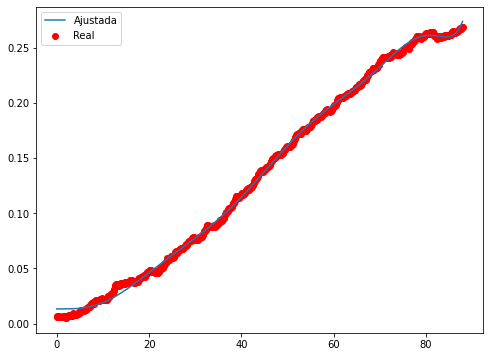

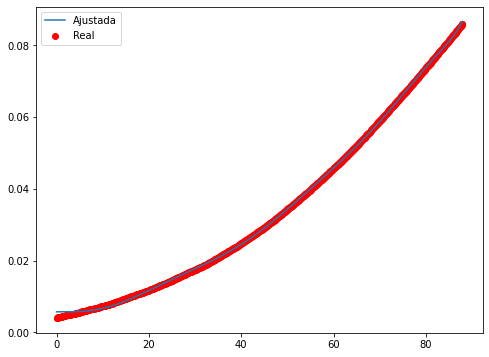

Epoch 1/500
32/32 - 2s - loss: 0.2754 - 2s/epoch - 61ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0357 - 93ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0069 - 101ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0021 - 93ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 9.5251e-04 - 98ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 6.1256e-04 - 97ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 4.9522e-04 - 127ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 4.3894e-04 - 113ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 4.0042e-04 - 106ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 3.6763e-04 - 105ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 3.3734e-04 - 100ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 3.0808e-04 - 100ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 2.7969e-04 - 106ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 2.5258e-04 - 110ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 2.2682e-04 - 102ms/epoch - 3ms/step
Epoch 16/50

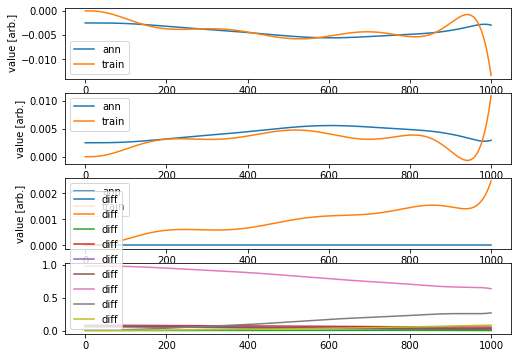

Validation loss: 30.918140311580967
Testing loss: 98.67489189106531


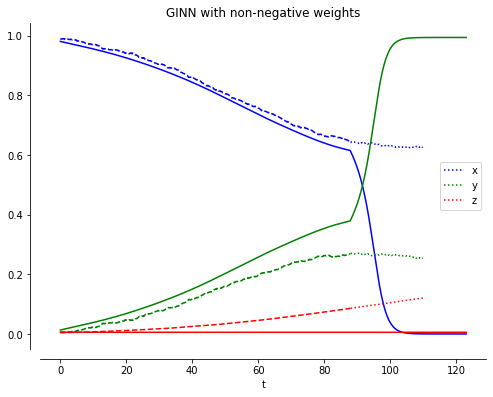

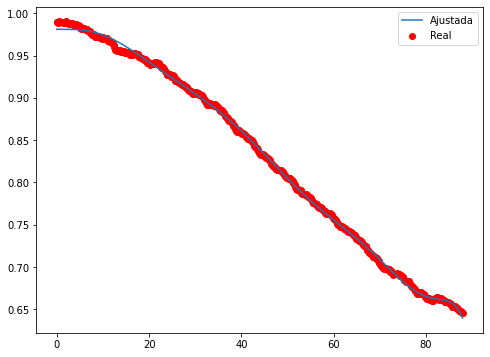

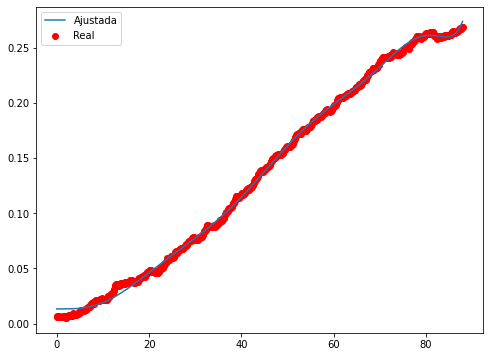

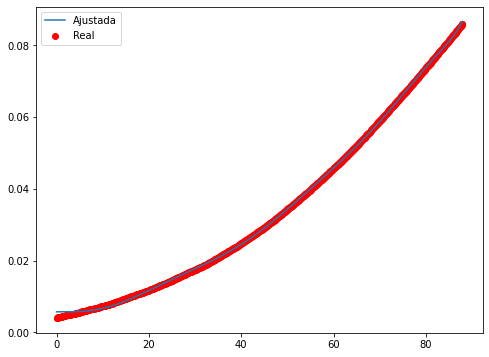

Epoch 1/500
32/32 - 2s - loss: 0.0193 - 2s/epoch - 55ms/step
Epoch 2/500
32/32 - 0s - loss: 6.4863e-04 - 88ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 1.2459e-04 - 94ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 1.0064e-04 - 88ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 8.0354e-05 - 89ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 6.3880e-05 - 101ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 5.3206e-05 - 83ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 4.4092e-05 - 104ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 3.5802e-05 - 93ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 2.8320e-05 - 101ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 2.2052e-05 - 99ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 1.6825e-05 - 114ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 1.2756e-05 - 111ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 9.7804e-06 - 97ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 7.6380e-06 - 111ms/epoch - 3ms/step
Epo

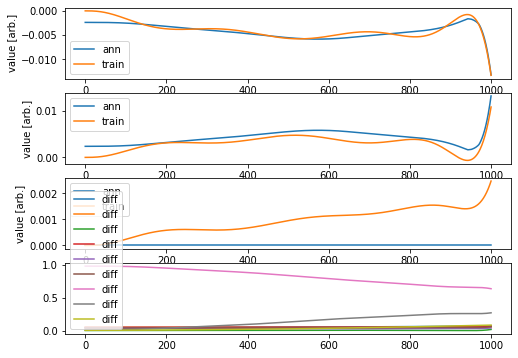

Validation loss: 58.627611075090726
Testing loss: 101.8476305691141


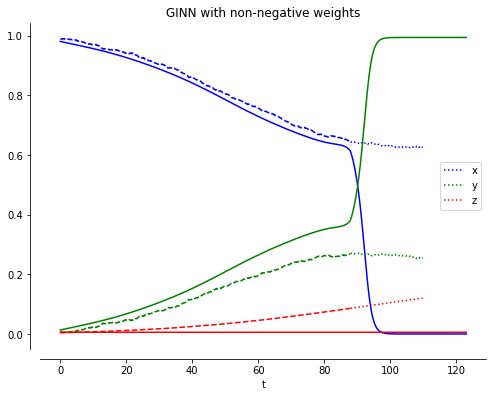

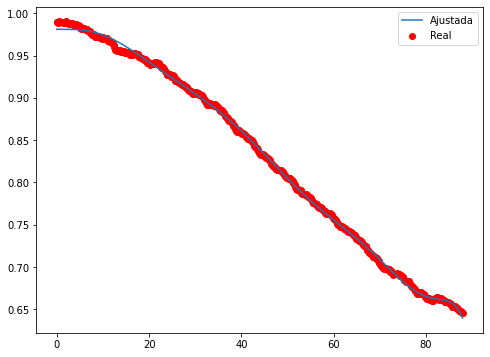

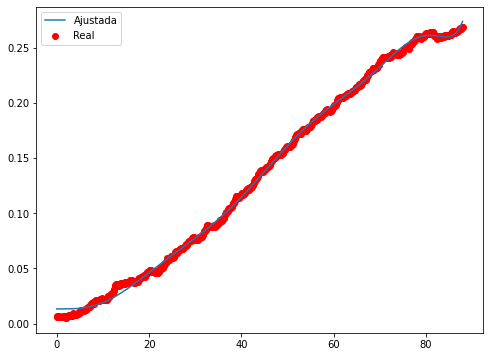

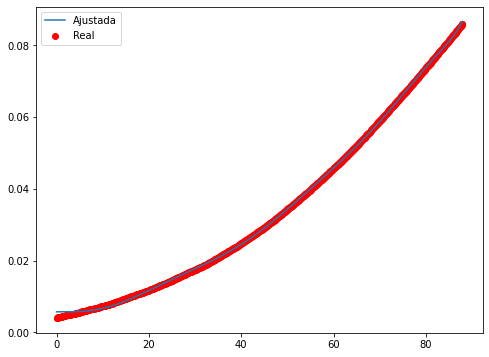

Epoch 1/500
32/32 - 2s - loss: 0.1632 - 2s/epoch - 56ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0173 - 125ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0031 - 120ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0012 - 103ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 7.5484e-04 - 92ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 6.2001e-04 - 111ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 5.4890e-04 - 130ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 4.8953e-04 - 119ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 4.3109e-04 - 144ms/epoch - 5ms/step
Epoch 10/500
32/32 - 0s - loss: 3.6973e-04 - 137ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 3.0715e-04 - 101ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 2.4859e-04 - 108ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 1.9772e-04 - 130ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 1.5543e-04 - 105ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 1.2083e-04 - 105ms/epoch - 3ms/step
Epoch 16

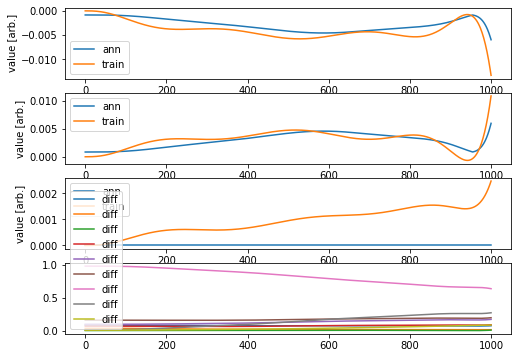

Validation loss: 7.220565650685504
Testing loss: 88.54853868681231


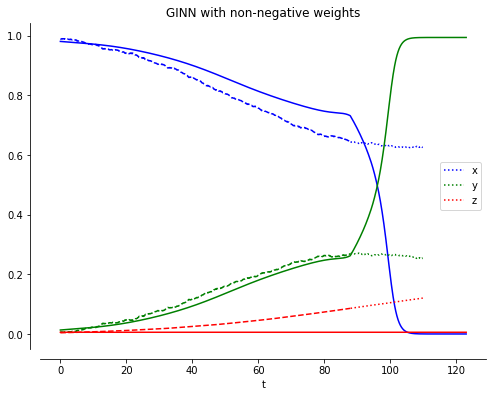

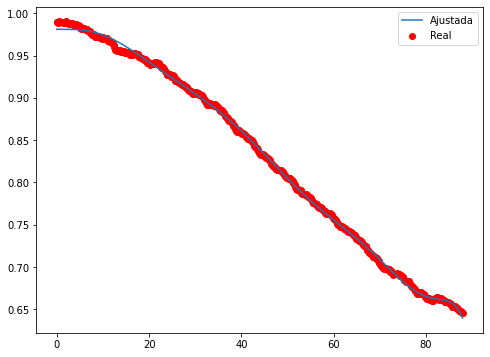

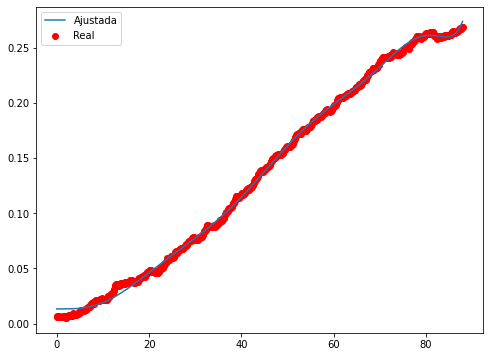

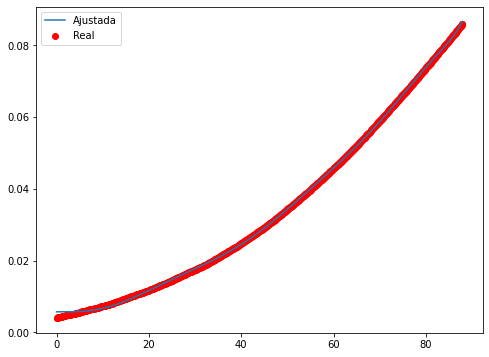

Epoch 1/500
32/32 - 2s - loss: 0.1354 - 2s/epoch - 51ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0148 - 109ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0025 - 103ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 7.8642e-04 - 102ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 4.6057e-04 - 103ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 3.6764e-04 - 106ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 3.2503e-04 - 101ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 2.9269e-04 - 120ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 2.6360e-04 - 100ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 2.3685e-04 - 106ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 2.1209e-04 - 111ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 1.8761e-04 - 97ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 1.6526e-04 - 118ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 1.4468e-04 - 92ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 1.2698e-04 - 98ms/epoch - 3ms/step
Epoch 

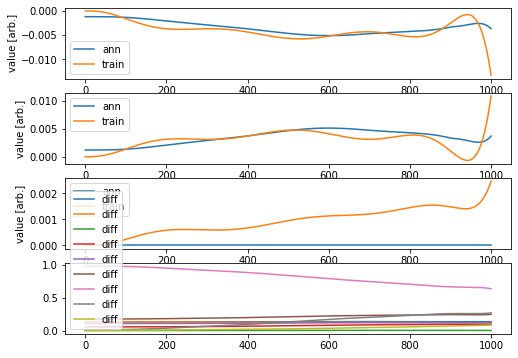

Validation loss: 10.031110279769562
Testing loss: 81.31896042572956


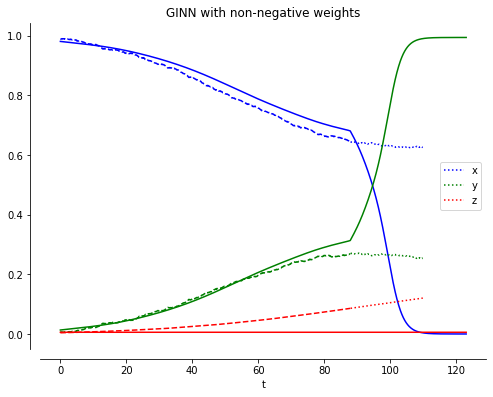

____________________________
Iteración =  13
Min =  0.06989518180235846
[[0, 1, 0, 0, 0, 1], [0, 1, 0, 0, 0, 1], [0, 1, 0, 0, 0, 1], [0, 1, 1, 0, 1, 0], [0, 1, 1, 0, 0, 1]]
[0.06989518180235846, 0.30253458934435157, 0.14073881611792677, 0.14698108422783035, 0.2948602621482329]


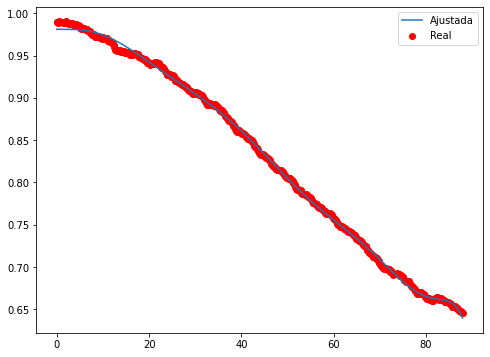

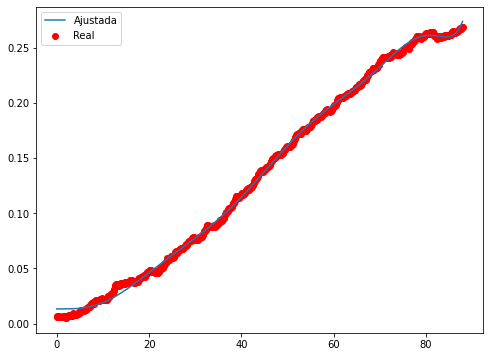

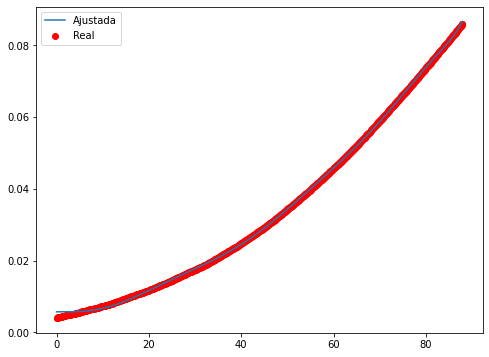

Epoch 1/500
32/32 - 2s - loss: 0.0049 - 2s/epoch - 52ms/step
Epoch 2/500
32/32 - 0s - loss: 4.5415e-04 - 88ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 1.2029e-04 - 90ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 5.7370e-05 - 102ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 3.3467e-05 - 88ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 2.1720e-05 - 95ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 1.5355e-05 - 109ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 1.1644e-05 - 137ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 9.4861e-06 - 117ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 8.0816e-06 - 117ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 7.1679e-06 - 101ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 6.5972e-06 - 117ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 6.2363e-06 - 119ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 5.9946e-06 - 105ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 5.8215e-06 - 101ms/epoch - 3ms/step

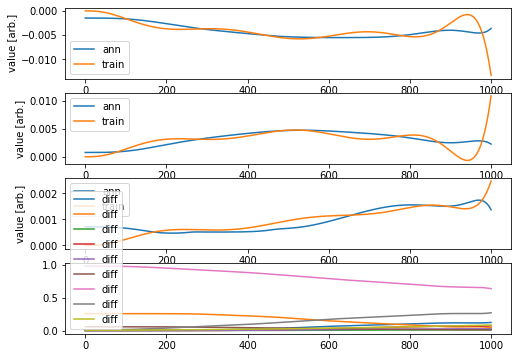

Validation loss: 0.1756016074204616
Testing loss: 0.28181158055263106


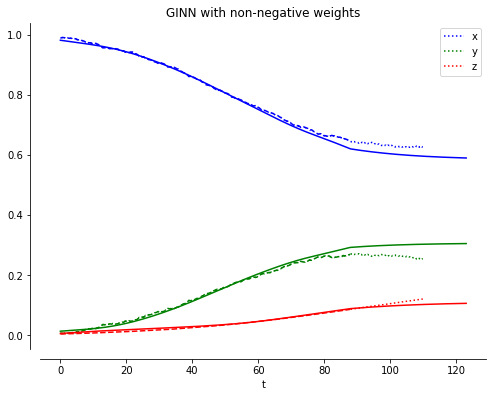

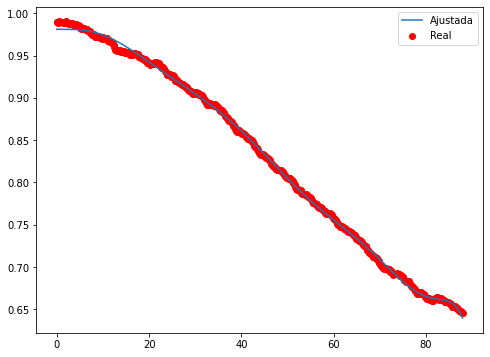

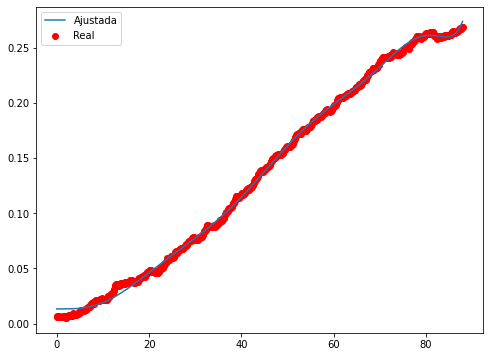

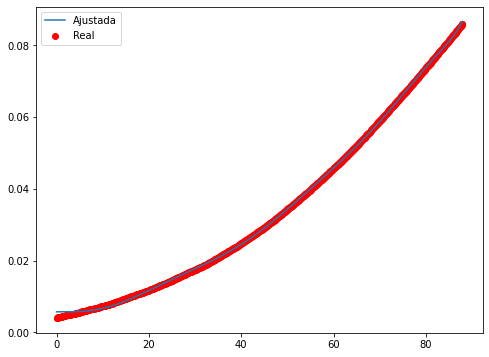

Epoch 1/500
32/32 - 2s - loss: 0.0018 - 2s/epoch - 52ms/step
Epoch 2/500
32/32 - 0s - loss: 1.6329e-04 - 90ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 3.2132e-05 - 100ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 1.8392e-05 - 96ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 1.4893e-05 - 102ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.3220e-05 - 91ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 1.2088e-05 - 91ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 1.1188e-05 - 87ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 1.0419e-05 - 90ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 9.7435e-06 - 91ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 9.1643e-06 - 93ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 8.6415e-06 - 97ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 8.1830e-06 - 93ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 7.7855e-06 - 92ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 7.4257e-06 - 96ms/epoch - 3ms/step
Epoch 1

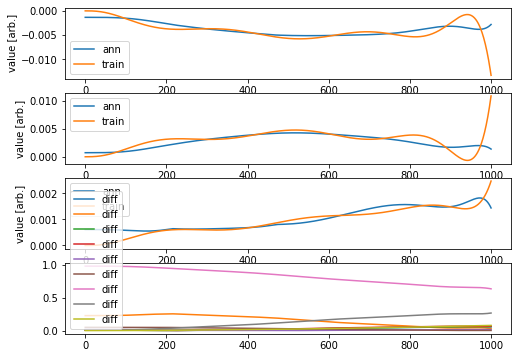

Validation loss: 0.070816199322358
Testing loss: 0.35338046763687775


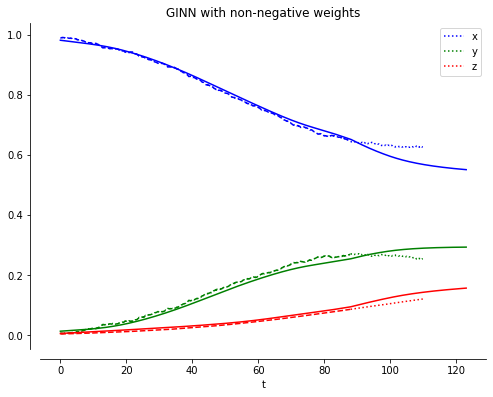

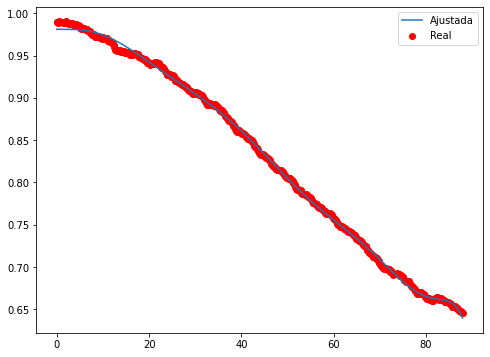

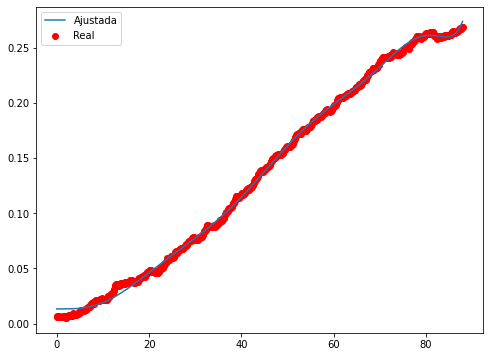

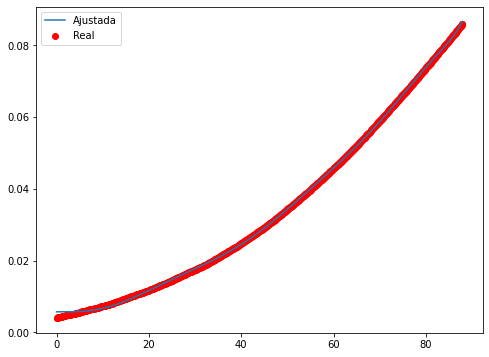

Epoch 1/500
32/32 - 2s - loss: 0.0015 - 2s/epoch - 56ms/step
Epoch 2/500
32/32 - 0s - loss: 1.0138e-04 - 104ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 2.6439e-05 - 100ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 1.6201e-05 - 91ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 1.2485e-05 - 107ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.0314e-05 - 87ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 8.9256e-06 - 84ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 7.9492e-06 - 93ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 7.2099e-06 - 95ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 6.6301e-06 - 91ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 6.1568e-06 - 70ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 5.7655e-06 - 101ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 5.4403e-06 - 82ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 5.1788e-06 - 87ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 4.9623e-06 - 81ms/epoch - 3ms/step
Epoch

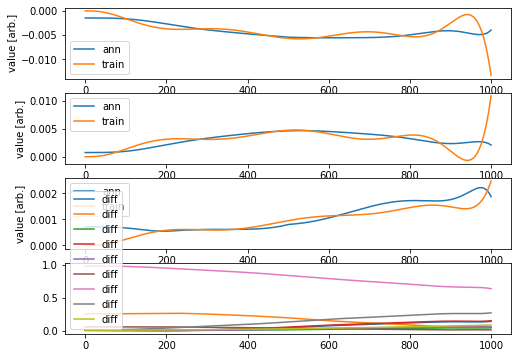

Validation loss: 0.3085874835641216
Testing loss: 0.6203542287423148


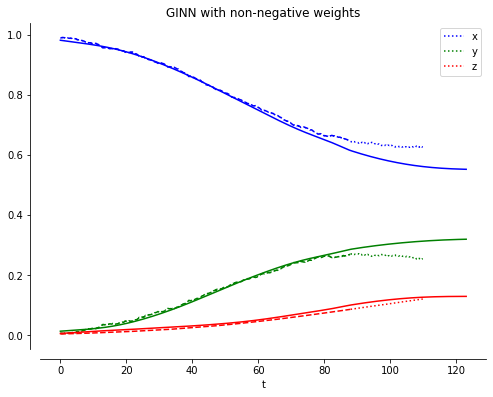

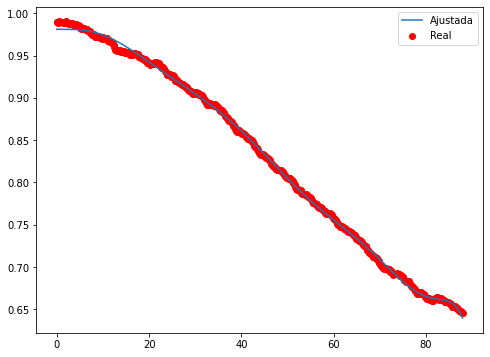

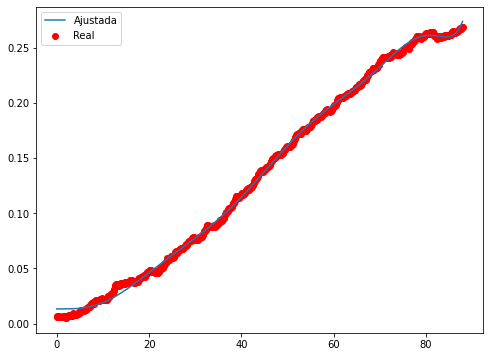

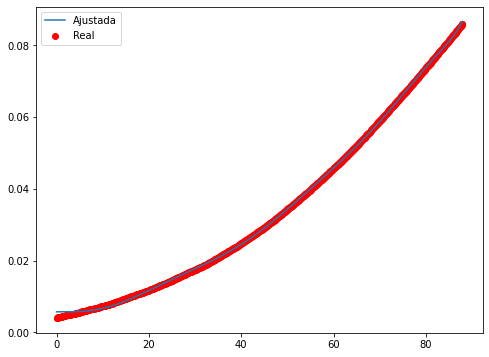

Epoch 1/500
32/32 - 2s - loss: 0.0018 - 2s/epoch - 66ms/step
Epoch 2/500
32/32 - 0s - loss: 1.8972e-04 - 88ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 3.6624e-05 - 93ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 1.7138e-05 - 90ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 1.2643e-05 - 89ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.0844e-05 - 96ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 9.8568e-06 - 87ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 9.1722e-06 - 103ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 8.6746e-06 - 88ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 8.2646e-06 - 105ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 7.9465e-06 - 85ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 7.6499e-06 - 85ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 7.3962e-06 - 85ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 7.1750e-06 - 92ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 6.9785e-06 - 87ms/epoch - 3ms/step
Epoch 1

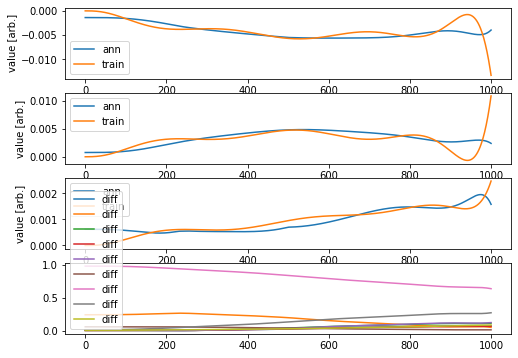

Validation loss: 0.2496722368315434
Testing loss: 0.3536010248006775


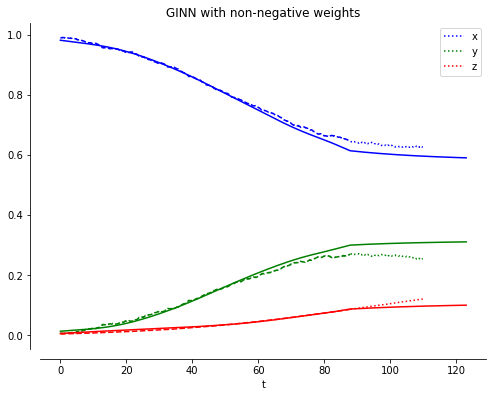

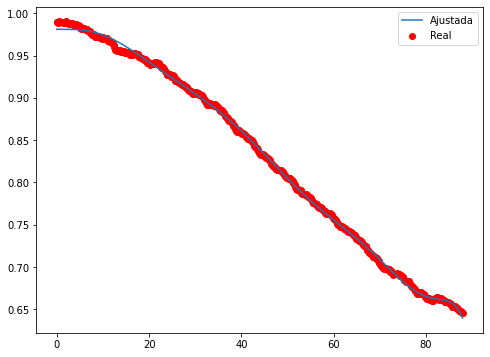

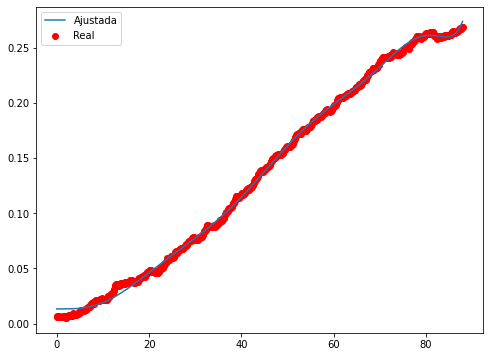

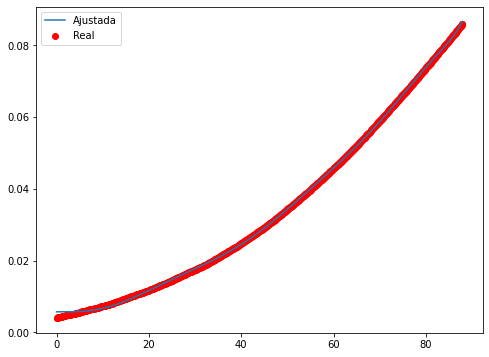

Epoch 1/500
32/32 - 2s - loss: 0.0051 - 2s/epoch - 55ms/step
Epoch 2/500
32/32 - 0s - loss: 5.5347e-04 - 96ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 1.6311e-04 - 139ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 7.5012e-05 - 89ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 4.5187e-05 - 91ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 3.1487e-05 - 90ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 2.4025e-05 - 105ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 1.9746e-05 - 106ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 1.7174e-05 - 97ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 1.5407e-05 - 96ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 1.4029e-05 - 108ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 1.2920e-05 - 94ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 1.2008e-05 - 90ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 1.1236e-05 - 91ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 1.0574e-05 - 92ms/epoch - 3ms/step
Epoch

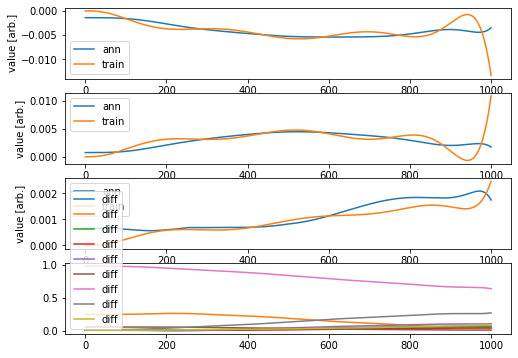

Validation loss: 0.2077378589100943
Testing loss: 0.4586417525156335


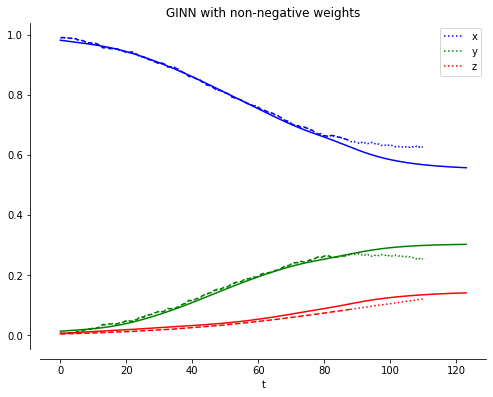

____________________________
Iteración =  14
Min =  0.06989518180235846
[[0, 1, 0, 0, 0, 1], [0, 1, 0, 0, 0, 1], [0, 1, 1, 0, 1, 0], [0, 1, 1, 0, 0, 1], [0, 1, 0, 0, 0, 1]]
[0.06989518180235846, 0.14073881611792677, 0.14698108422783035, 0.2948602621482329, 0.20248307720971576]


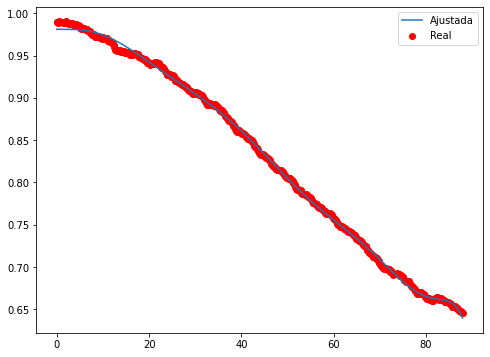

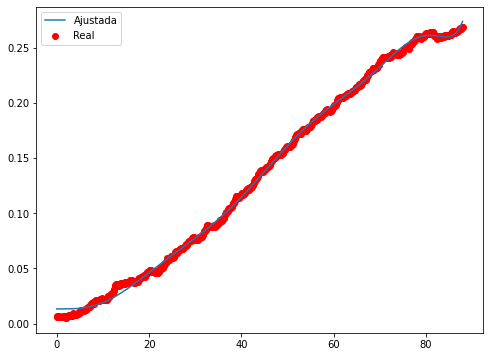

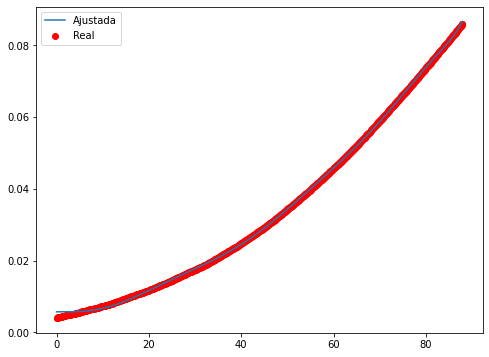

Epoch 1/500
32/32 - 2s - loss: 1.0563 - 2s/epoch - 55ms/step
Epoch 2/500
32/32 - 0s - loss: 0.1543 - 110ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0295 - 93ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0081 - 96ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0031 - 94ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0017 - 96ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 0.0012 - 92ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 0.0011 - 88ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 9.4884e-04 - 117ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 8.6550e-04 - 98ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 7.9026e-04 - 122ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 7.1862e-04 - 102ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 6.4943e-04 - 98ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 5.8471e-04 - 98ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 5.2511e-04 - 132ms/epoch - 4ms/step
Epoch 16/500
32/32 - 0s - loss: 

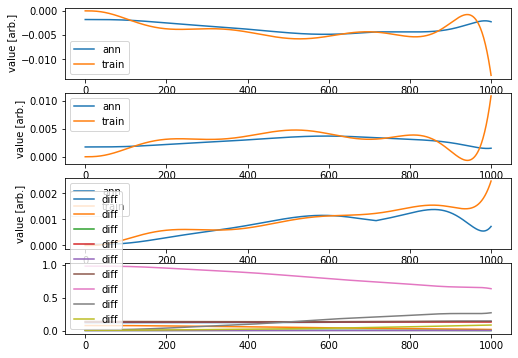

Validation loss: 0.0731929355115959
Testing loss: 0.14592899183370392


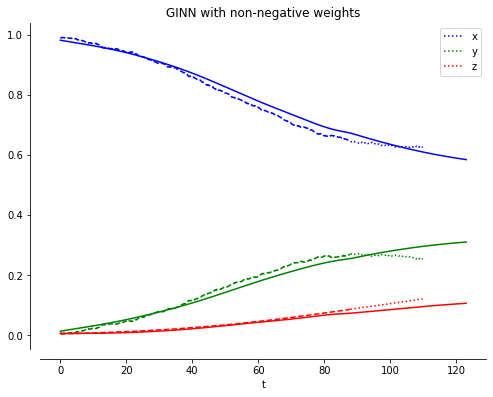

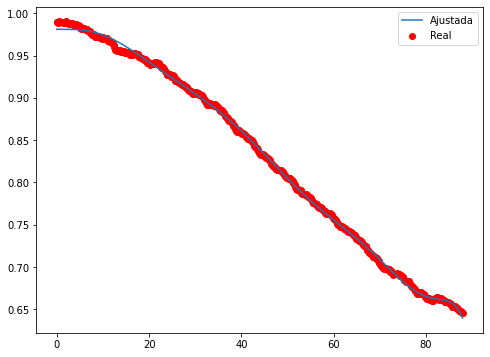

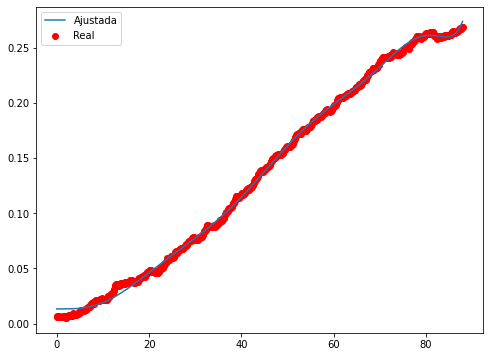

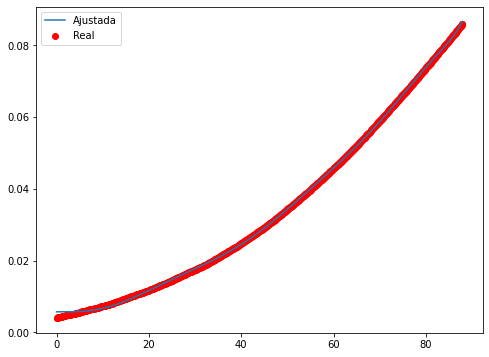

Epoch 1/500
32/32 - 2s - loss: 0.6416 - 2s/epoch - 53ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0666 - 94ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0100 - 107ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0033 - 94ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0018 - 85ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0013 - 85ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 0.0012 - 96ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 0.0010 - 96ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 9.5088e-04 - 87ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 8.6467e-04 - 97ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 7.8014e-04 - 125ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 6.9538e-04 - 85ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 6.1641e-04 - 93ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 5.4414e-04 - 90ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 4.8134e-04 - 90ms/epoch - 3ms/step
Epoch 16/500
32/32 - 0s - loss: 4.2

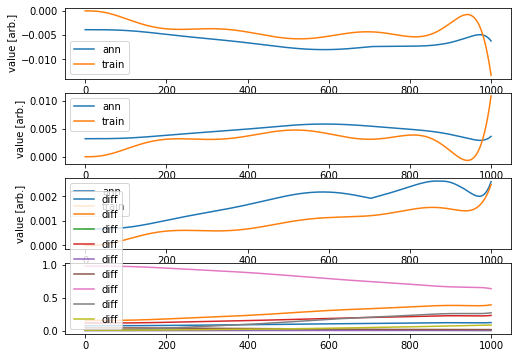

Validation loss: 45.64589684354149
Testing loss: 65.56345014646665


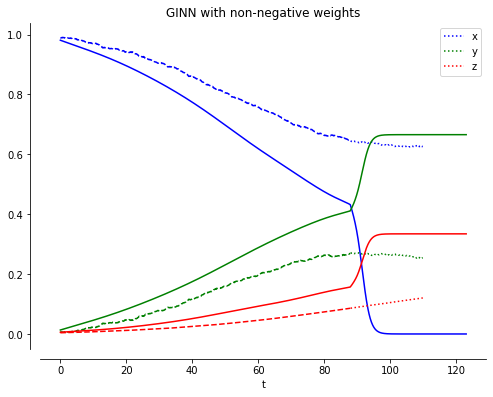

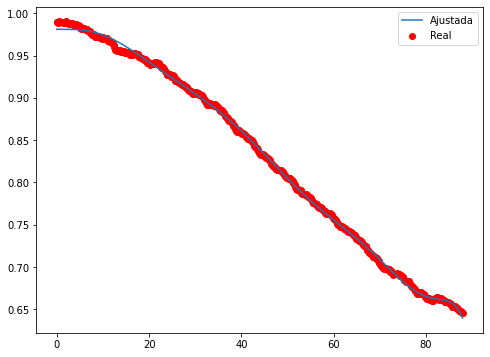

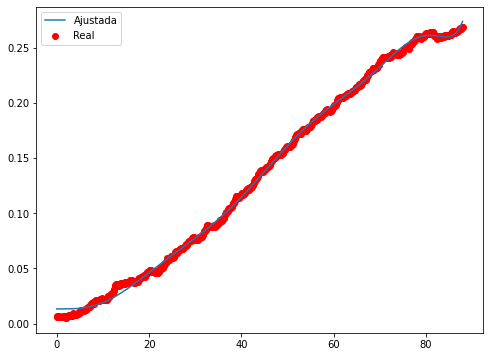

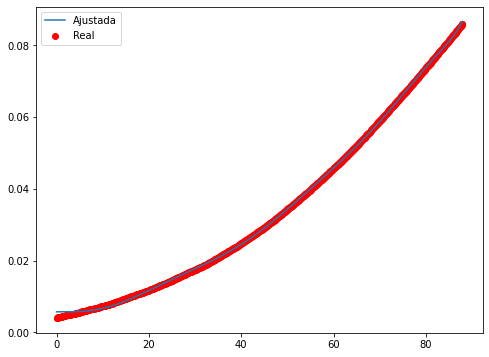

Epoch 1/500
32/32 - 2s - loss: 0.3733 - 2s/epoch - 52ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0343 - 87ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0053 - 89ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0023 - 86ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0016 - 85ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0014 - 89ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 0.0012 - 87ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 0.0011 - 88ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 0.0010 - 94ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 9.0911e-04 - 86ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 7.9922e-04 - 119ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 6.9524e-04 - 113ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 6.0269e-04 - 93ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 5.2292e-04 - 88ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 4.5455e-04 - 81ms/epoch - 3ms/step
Epoch 16/500
32/32 - 0s - loss: 3.9828e

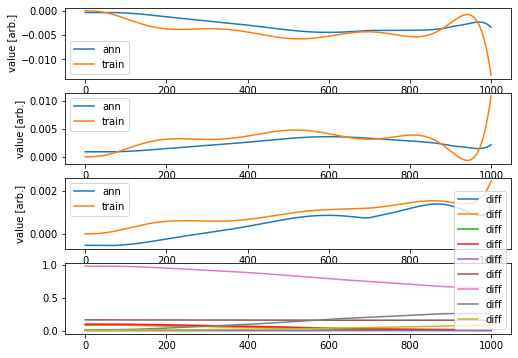

Validation loss: 0.8253247993214472
Testing loss: 0.279491175226429


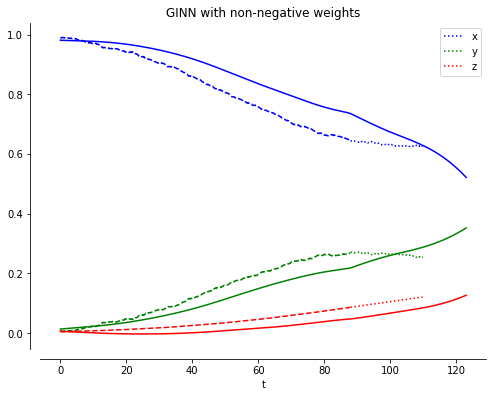

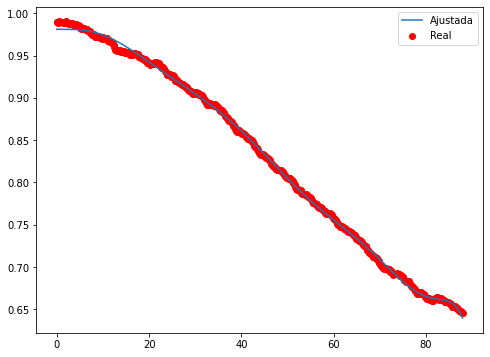

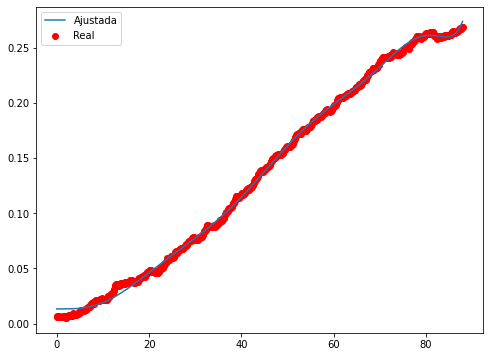

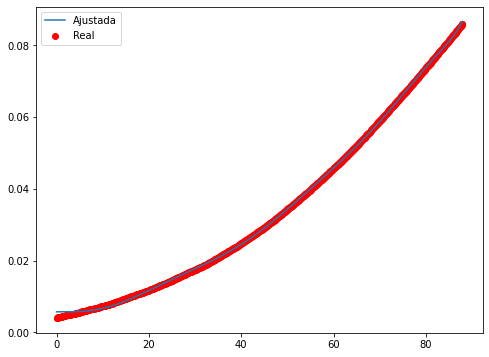

Epoch 1/500
32/32 - 2s - loss: 0.8143 - 2s/epoch - 55ms/step
Epoch 2/500
32/32 - 0s - loss: 0.1199 - 90ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0265 - 89ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0083 - 90ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0036 - 88ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0022 - 97ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 0.0016 - 95ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 0.0014 - 108ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 0.0013 - 125ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 0.0012 - 106ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 0.0011 - 95ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 0.0010 - 111ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 9.6871e-04 - 96ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 8.9645e-04 - 99ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 8.2443e-04 - 98ms/epoch - 3ms/step
Epoch 16/500
32/32 - 0s - loss: 7.5332e-04 - 99ms

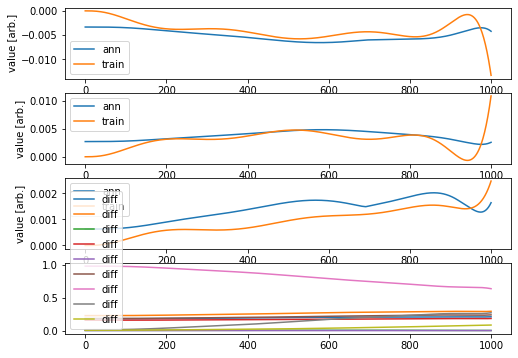

Validation loss: 4.052425077683853
Testing loss: 11.441412075558734


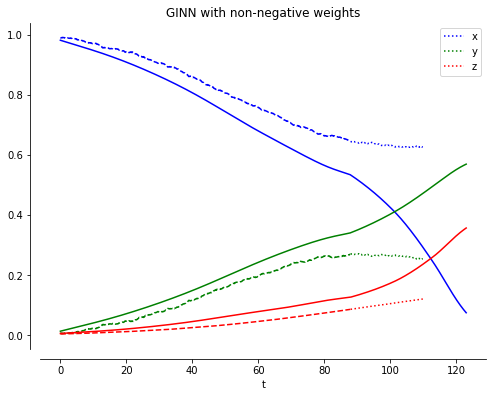

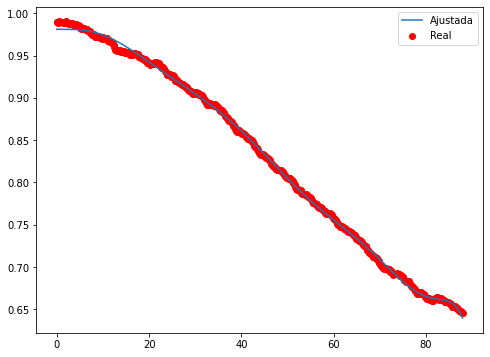

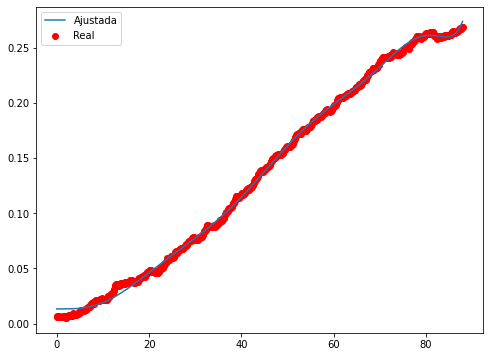

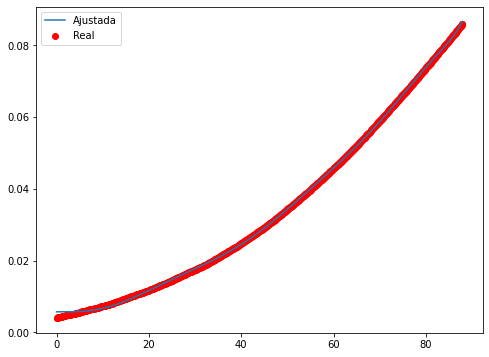

Epoch 1/500
32/32 - 2s - loss: 0.5500 - 2s/epoch - 51ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0629 - 91ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0110 - 102ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0037 - 89ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0021 - 82ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0016 - 112ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 0.0013 - 88ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 0.0012 - 84ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 0.0010 - 85ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 8.8845e-04 - 94ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 7.7618e-04 - 89ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 6.8751e-04 - 99ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 6.1358e-04 - 92ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 5.4752e-04 - 99ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 4.8626e-04 - 76ms/epoch - 2ms/step
Epoch 16/500
32/32 - 0s - loss: 4.3228e

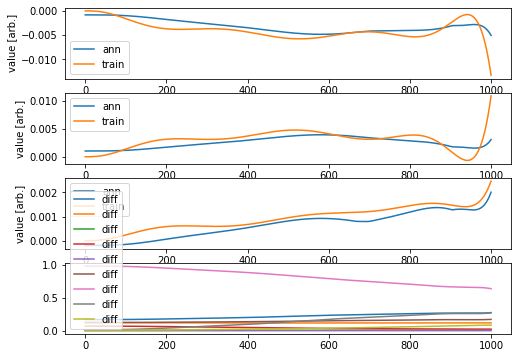

Validation loss: 0.3743208557704876
Testing loss: 0.1890146944848168


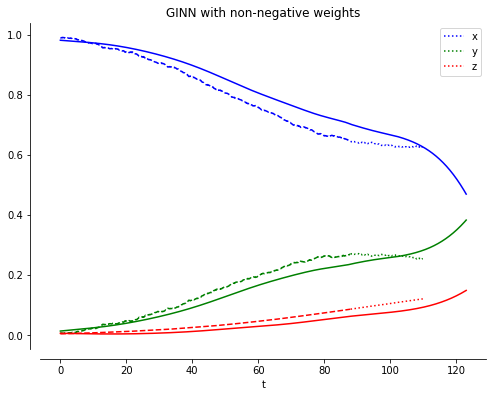

____________________________
Iteración =  15
Min =  0.06989518180235846
[[0, 1, 0, 0, 0, 1], [0, 1, 0, 0, 0, 1], [0, 1, 1, 0, 1, 0], [0, 1, 1, 0, 0, 1], [0, 1, 0, 0, 0, 1]]
[0.06989518180235846, 0.14073881611792677, 0.14698108422783035, 0.2948602621482329, 0.20248307720971576]


In [ ]:
Mins = [min(medias)]
#iters = 5

Kc = 5 # Carrying capacity

for it in range(15):
  print("____________________________")
  print("Iteración = ", it)
  print("Min = ", min(medias))
  Mins.append(min(medias))
  print(Pob)
  print(medias)  

  fl = selection(Pob,medias)[0]
  Pob.append(fl)

  i12,i13,i21,i23,i31,i32 = fl #[0, 1, 1, 1, 0, 0]
  totali = []
  for _ in range(iters):
    total = train(Td,Xd,Yd,Zd,T0,X0,Y0,Z0,mode=2)
    while math.isnan(total):
      total = train(Td,Xd,Yd,Zd,T0,X0,Y0,Z0,mode=2)
    totali.append(total)
  totales.append(totali)
  medias.append(sum(totali)/len(totali))

  lP = len(Pob)

  if lP > Kc:
    maxP = max(medias)
    for pi in range(lP):
      if medias[pi] == maxP:
        medias.remove(medias[pi])
        totales.remove(totales[pi])
        Pob.remove(Pob[pi])
        break
  
print("____________________________")
print("Iteración = ", it+1)
print("Min = ", min(medias))
print(Pob)
print(medias)

____________________________
Iteración =  15
Min =  0.06989518180235846
[[0, 1, 0, 0, 0, 1], [0, 1, 0, 0, 0, 1], [0, 1, 1, 0, 1, 0], [0, 1, 1, 0, 0, 1], [0, 1, 0, 0, 0, 1]]
[0.06989518180235846, 0.14073881611792677, 0.14698108422783035, 0.2948602621482329, 0.20248307720971576]
[0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846]


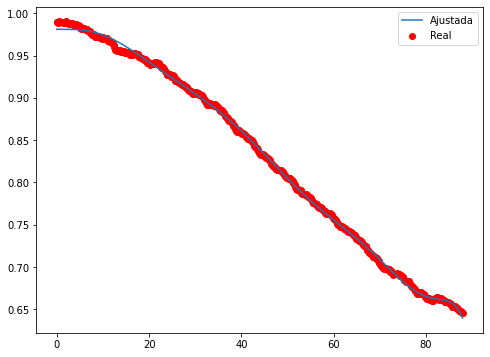

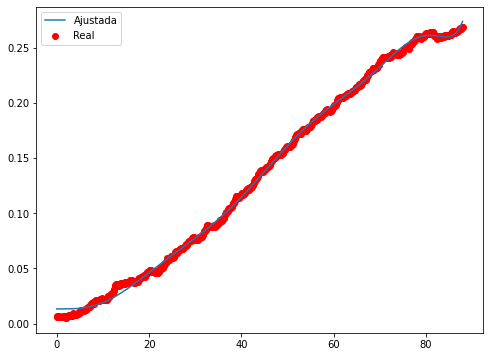

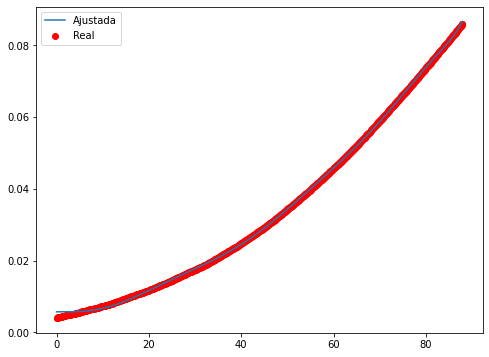

Epoch 1/500
32/32 - 1s - loss: 1.1873 - 1s/epoch - 36ms/step
Epoch 2/500
32/32 - 0s - loss: 0.1875 - 57ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0439 - 56ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0147 - 63ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0067 - 69ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0040 - 69ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 0.0030 - 62ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 0.0025 - 59ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 0.0023 - 59ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 0.0021 - 66ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 0.0019 - 59ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 0.0018 - 64ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 0.0016 - 62ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 0.0015 - 58ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 0.0014 - 63ms/epoch - 2ms/step
Epoch 16/500
32/32 - 0s - loss: 0.0013 - 64ms/epoch - 2ms/step
Ep

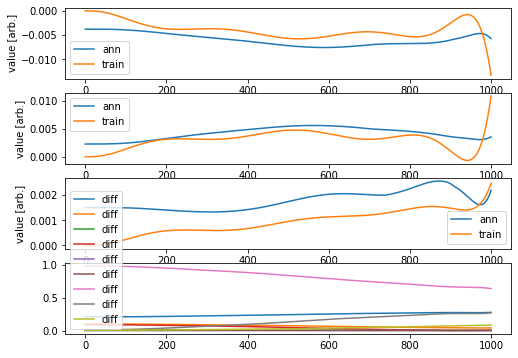

Validation loss: 12.644384687722667
Testing loss: 37.01434431534641


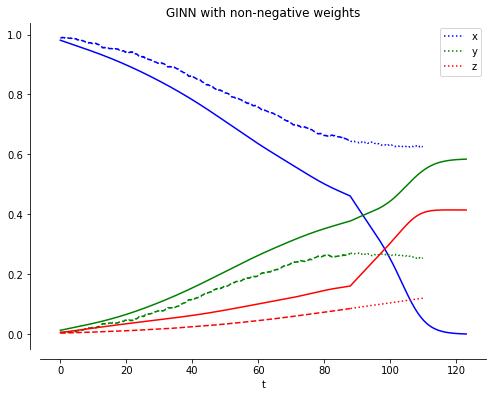

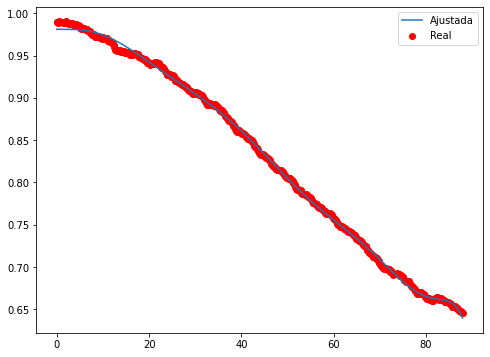

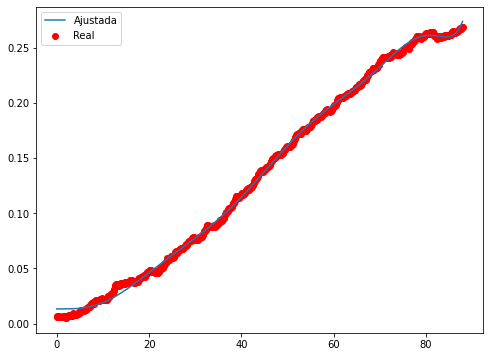

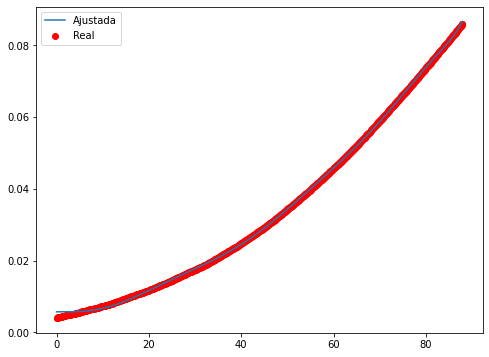

Epoch 1/500
32/32 - 1s - loss: 0.3916 - 1s/epoch - 38ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0325 - 65ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0053 - 61ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0019 - 70ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0011 - 65ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 8.6269e-04 - 75ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 7.5153e-04 - 59ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 6.7328e-04 - 63ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 6.0591e-04 - 65ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 5.4722e-04 - 73ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 4.9486e-04 - 72ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 4.4612e-04 - 69ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 4.0150e-04 - 64ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 3.6029e-04 - 64ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 3.2228e-04 - 64ms/epoch - 2ms/step
Epoch 16/500
32/32 - 0s -

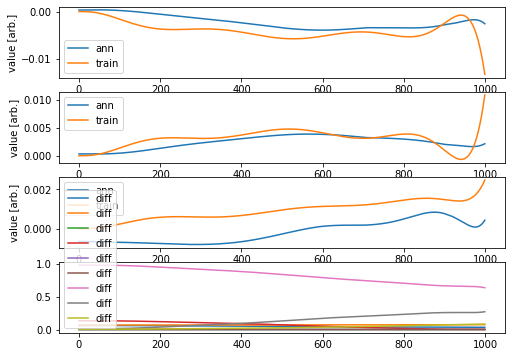

Validation loss: 1.493709523722086
Testing loss: 0.4764459294762231


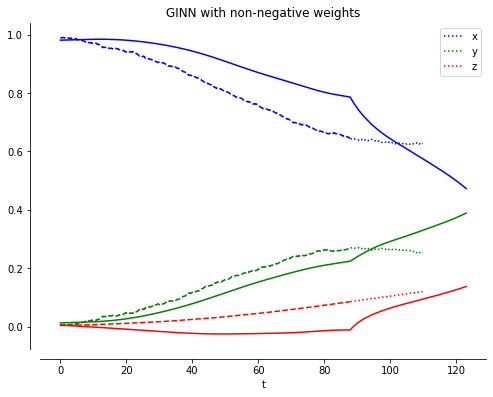

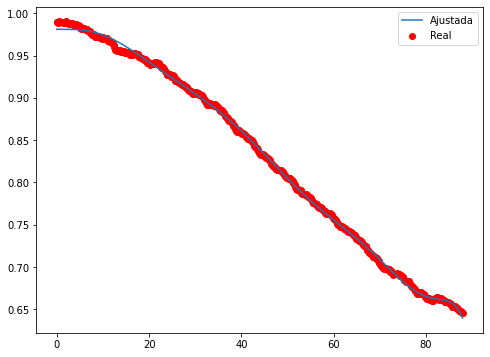

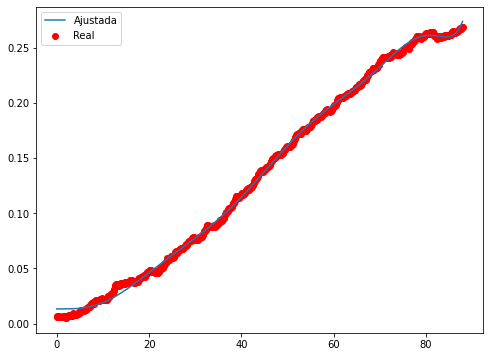

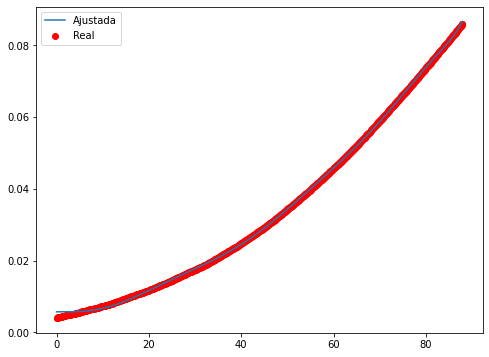

Epoch 1/500
32/32 - 1s - loss: 0.4189 - 1s/epoch - 36ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0396 - 63ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0051 - 59ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0014 - 67ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 8.6254e-04 - 66ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 7.1489e-04 - 68ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 6.3976e-04 - 67ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 5.7987e-04 - 62ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 5.2487e-04 - 66ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 4.7742e-04 - 76ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 4.3759e-04 - 68ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 4.0370e-04 - 68ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 3.7365e-04 - 64ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 3.4559e-04 - 66ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 3.1837e-04 - 62ms/epoch - 2ms/step
Epoch 16/500
32/32 - 

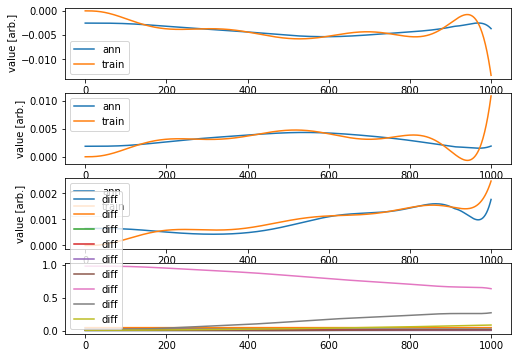

Validation loss: 0.31082653886405814
Testing loss: 4.663755588955611


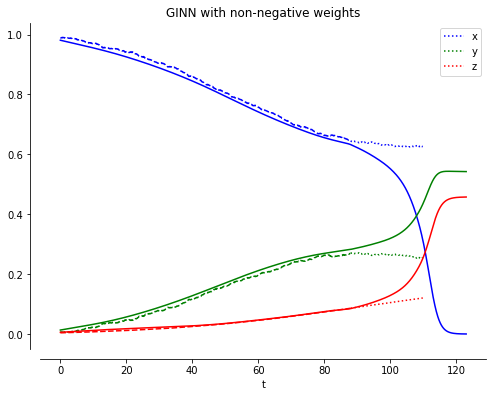

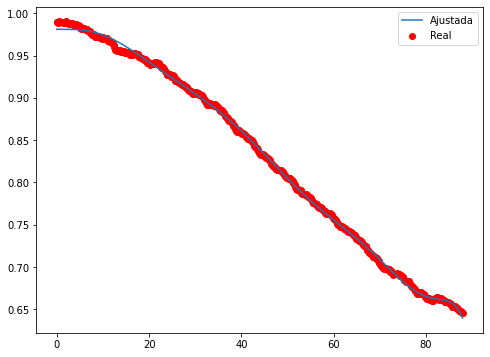

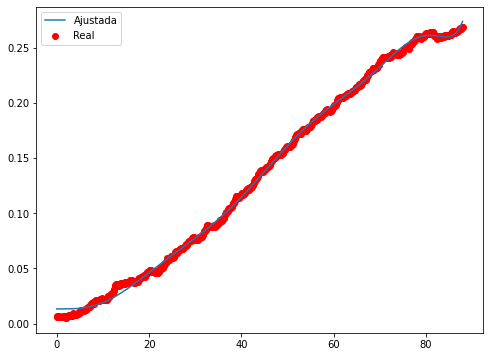

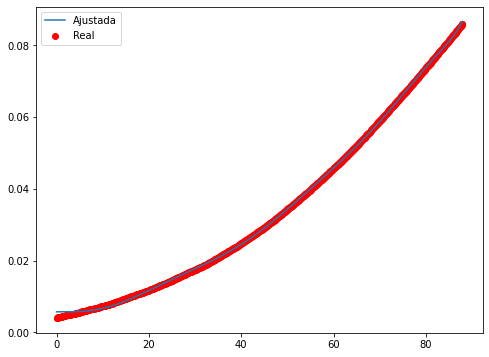

Epoch 1/500
32/32 - 2s - loss: 0.7811 - 2s/epoch - 48ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0976 - 76ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0163 - 65ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0043 - 79ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0018 - 69ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0012 - 64ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 9.5652e-04 - 63ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 8.5504e-04 - 67ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 7.8891e-04 - 67ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 7.3094e-04 - 69ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 6.7779e-04 - 67ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 6.2720e-04 - 71ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 5.7966e-04 - 70ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 5.3412e-04 - 71ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 4.9040e-04 - 74ms/epoch - 2ms/step
Epoch 16/500
32/32 - 0s - los

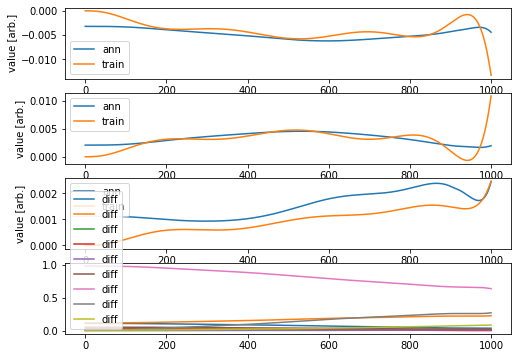

Validation loss: 2.918010848047304
Testing loss: 14.025926100651954


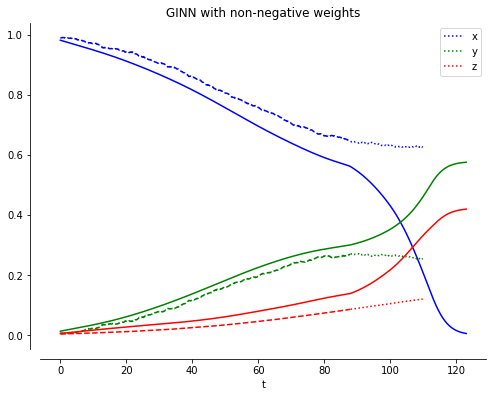

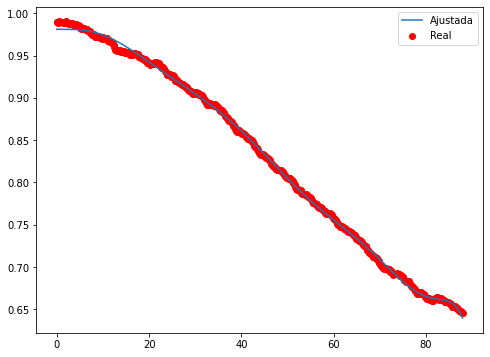

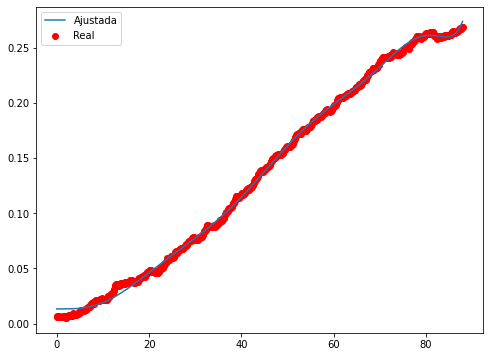

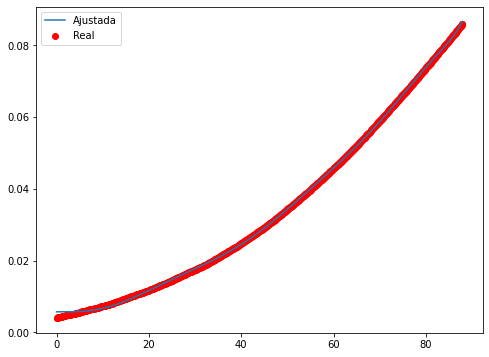

Epoch 1/500
32/32 - 1s - loss: 0.4183 - 1s/epoch - 46ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0439 - 68ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0071 - 74ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0025 - 92ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0016 - 64ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0013 - 71ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 0.0011 - 65ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 9.5669e-04 - 66ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 8.3545e-04 - 67ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 7.2426e-04 - 68ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 6.2221e-04 - 76ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 5.2969e-04 - 70ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 4.4908e-04 - 75ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 3.7866e-04 - 68ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 3.1737e-04 - 73ms/epoch - 2ms/step
Epoch 16/500
32/32 - 0s - loss: 2

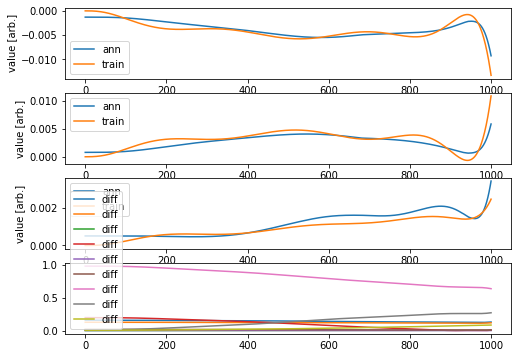

Validation loss: 0.5730269753434687
Testing loss: 1.4664462982323265


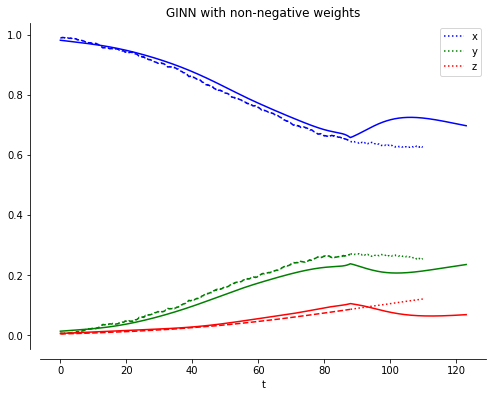

____________________________
Iteración =  16
Min =  0.06989518180235846
[[0, 1, 0, 0, 0, 1], [0, 1, 0, 0, 0, 1], [0, 1, 1, 0, 1, 0], [0, 1, 1, 0, 0, 1], [0, 1, 0, 0, 0, 1]]
[0.06989518180235846, 0.14073881611792677, 0.14698108422783035, 0.2948602621482329, 0.20248307720971576]
[0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846]


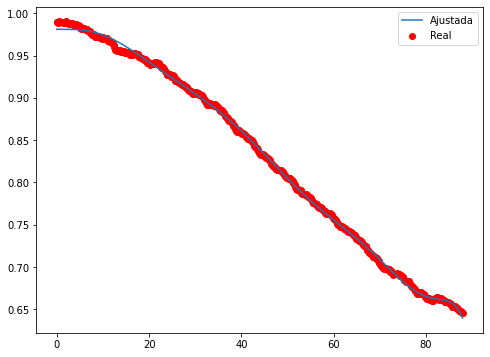

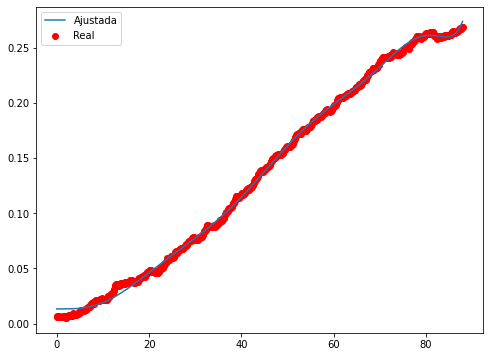

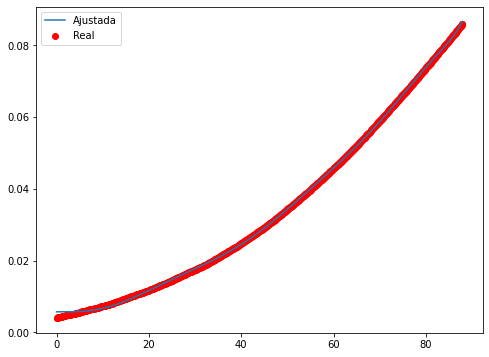

Epoch 1/500
32/32 - 1s - loss: 0.7306 - 1s/epoch - 36ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0841 - 67ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0124 - 79ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0033 - 77ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0015 - 73ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0010 - 71ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 8.3963e-04 - 75ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 7.5801e-04 - 69ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 7.0123e-04 - 84ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 6.5417e-04 - 69ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 6.1054e-04 - 78ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 5.6997e-04 - 77ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 5.3080e-04 - 72ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 4.9222e-04 - 73ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 4.5384e-04 - 77ms/epoch - 2ms/step
Epoch 16/500
32/32 - 0s - los

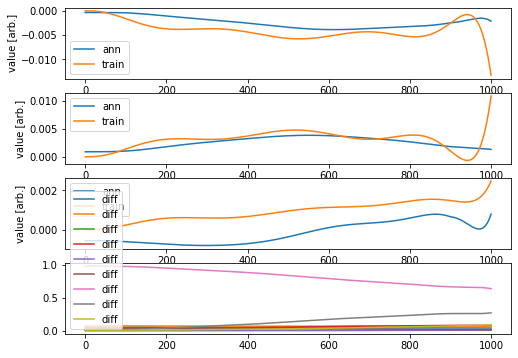

Validation loss: 1.4305045240106609
Testing loss: 0.26048165267664913


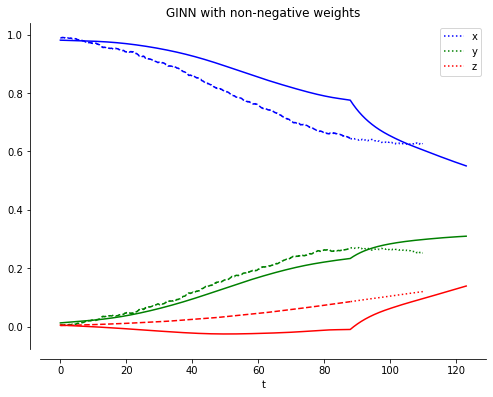

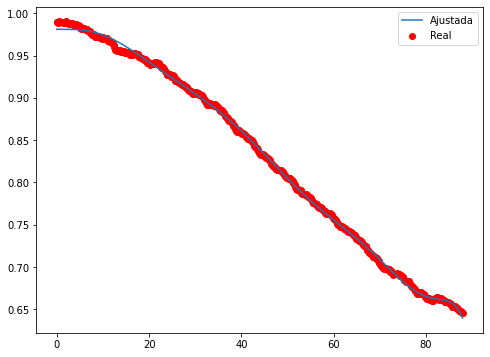

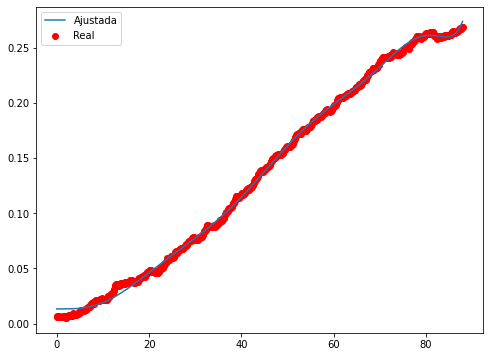

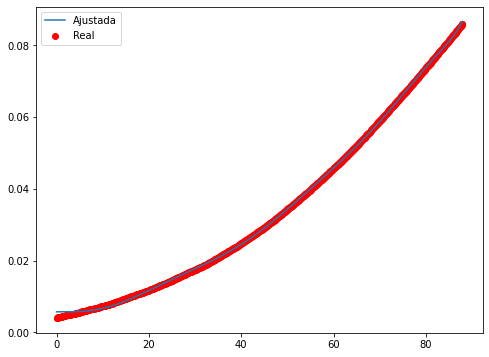

Epoch 1/500
32/32 - 1s - loss: 1.4748 - 1s/epoch - 35ms/step
Epoch 2/500
32/32 - 0s - loss: 0.2077 - 72ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0447 - 67ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0158 - 66ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0075 - 73ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0045 - 80ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 0.0033 - 76ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 0.0027 - 75ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 0.0024 - 72ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 0.0022 - 90ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 0.0021 - 69ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 0.0019 - 66ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 0.0018 - 84ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 0.0017 - 72ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 0.0016 - 86ms/epoch - 3ms/step
Epoch 16/500
32/32 - 0s - loss: 0.0015 - 79ms/epoch - 2ms/step
Ep

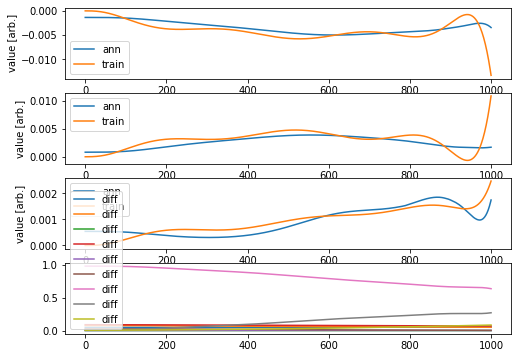

Validation loss: 0.22216648260336833
Testing loss: 0.15901344002461848


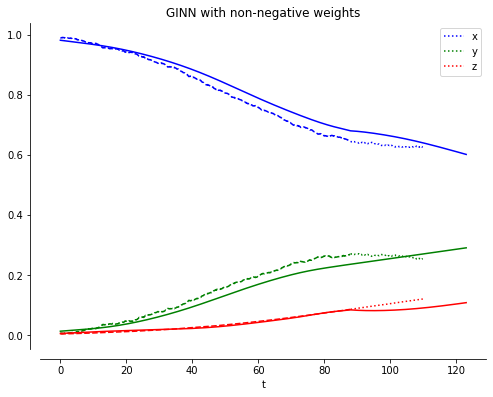

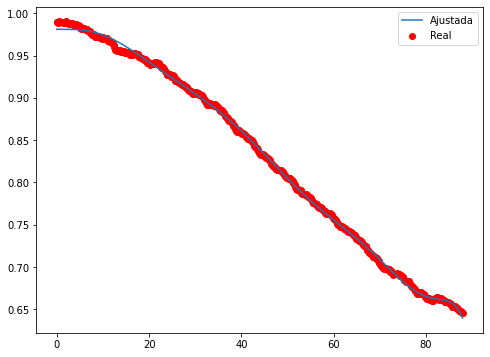

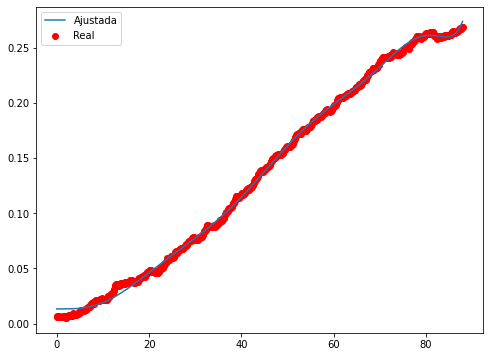

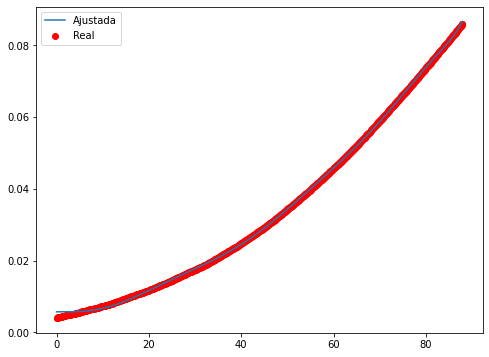

Epoch 1/500
32/32 - 1s - loss: 0.8434 - 1s/epoch - 36ms/step
Epoch 2/500
32/32 - 0s - loss: 0.1216 - 76ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0242 - 74ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0068 - 93ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0026 - 73ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0015 - 80ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 0.0011 - 78ms/epoch - 2ms/step
Epoch 8/500
32/32 - 0s - loss: 9.1081e-04 - 82ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 8.1148e-04 - 88ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 7.3188e-04 - 75ms/epoch - 2ms/step
Epoch 11/500
32/32 - 0s - loss: 6.5825e-04 - 77ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 5.8964e-04 - 83ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 5.2573e-04 - 70ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 4.6764e-04 - 84ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 4.1445e-04 - 71ms/epoch - 2ms/step
Epoch 16/500
32/32 - 0s - loss: 3

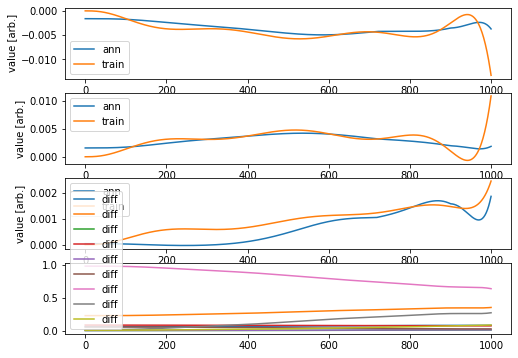

Validation loss: 0.10437063248086412
Testing loss: 0.6559580105595582


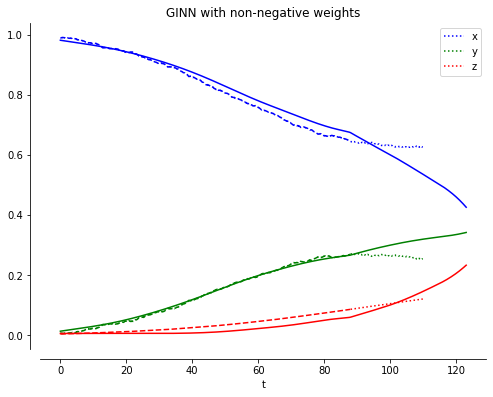

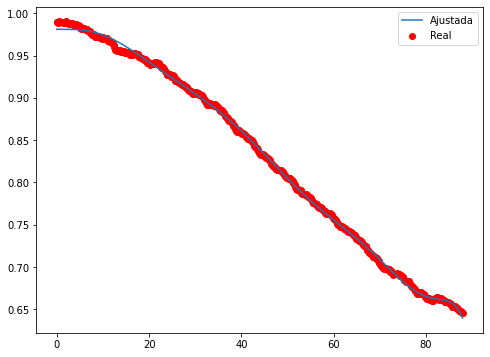

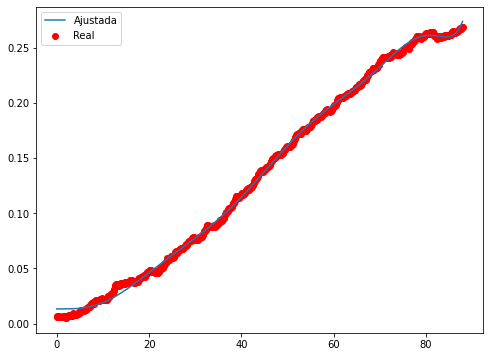

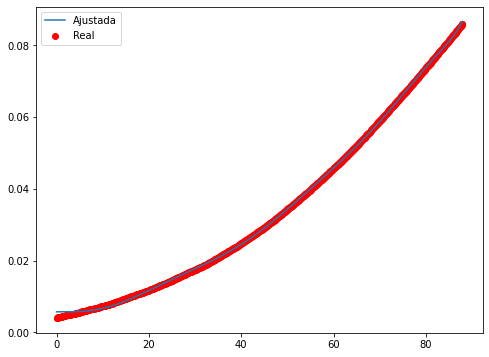

Epoch 1/500
32/32 - 1s - loss: 0.4255 - 1s/epoch - 35ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0331 - 87ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0047 - 77ms/epoch - 2ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0020 - 80ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0014 - 71ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0011 - 68ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 9.7107e-04 - 82ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 8.2306e-04 - 75ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 6.9238e-04 - 78ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 5.7980e-04 - 98ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 4.8382e-04 - 75ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 4.0439e-04 - 75ms/epoch - 2ms/step
Epoch 13/500
32/32 - 0s - loss: 3.3935e-04 - 76ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 2.8356e-04 - 77ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 2.3443e-04 - 86ms/epoch - 3ms/step
Epoch 16/500
32/32 - 0s - los

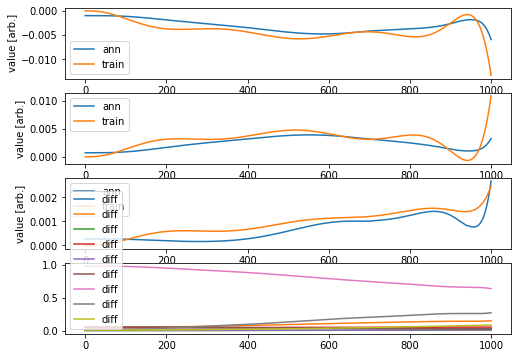

Validation loss: 0.6695078619944435
Testing loss: 0.49115163997219546


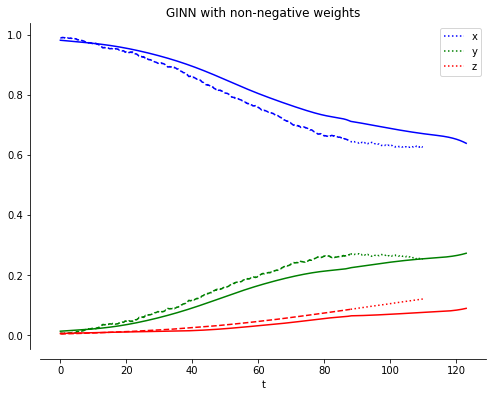

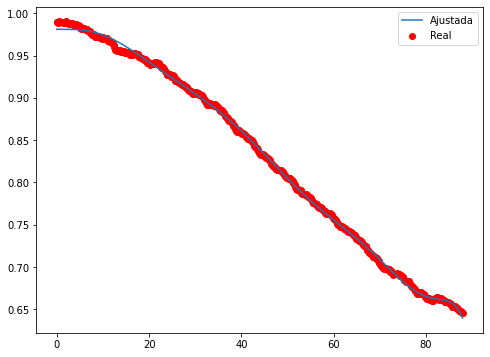

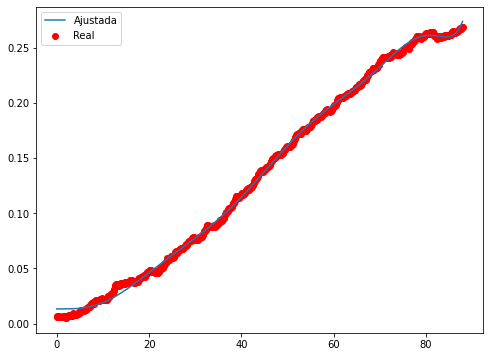

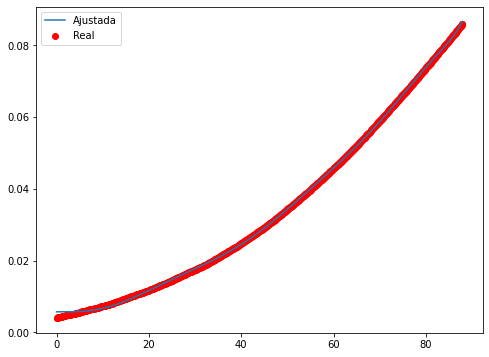

Epoch 1/500
32/32 - 1s - loss: 0.7391 - 1s/epoch - 36ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0876 - 78ms/epoch - 2ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0151 - 88ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0048 - 81ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0024 - 79ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0017 - 77ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 0.0014 - 95ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 0.0012 - 75ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 0.0011 - 83ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 9.7410e-04 - 82ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 8.7216e-04 - 81ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 7.7776e-04 - 86ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 6.8689e-04 - 73ms/epoch - 2ms/step
Epoch 14/500
32/32 - 0s - loss: 6.0368e-04 - 88ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 5.3053e-04 - 92ms/epoch - 3ms/step
Epoch 16/500
32/32 - 0s - loss: 4.6670e-0

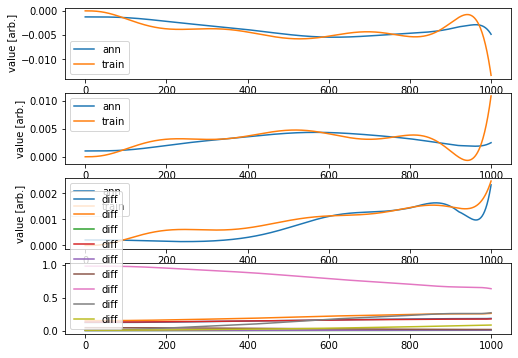

Validation loss: 0.08737029141283356
Testing loss: 2.5255758687504124


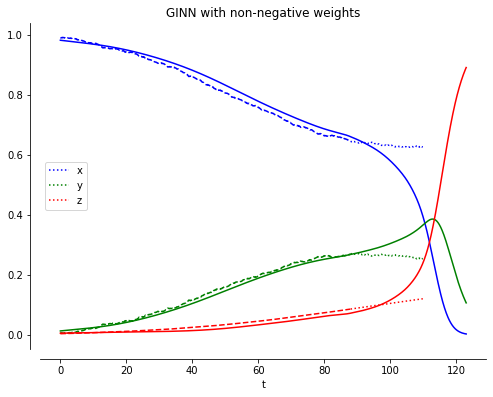

____________________________
Iteración =  17
Min =  0.06989518180235846
[[0, 1, 0, 0, 0, 1], [0, 1, 0, 0, 0, 1], [0, 1, 1, 0, 1, 0], [0, 1, 1, 0, 0, 1], [0, 1, 0, 0, 0, 1]]
[0.06989518180235846, 0.14073881611792677, 0.14698108422783035, 0.2948602621482329, 0.20248307720971576]
[0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846]


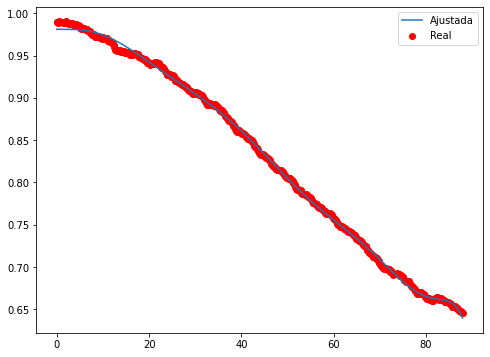

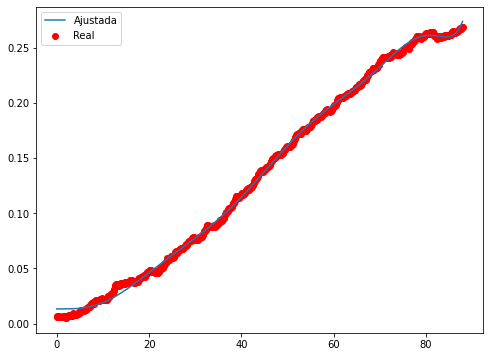

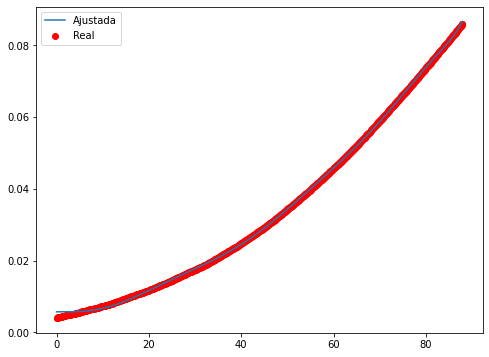

Epoch 1/500
32/32 - 2s - loss: 0.0618 - 2s/epoch - 70ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0041 - 115ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0011 - 106ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 7.4430e-04 - 120ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 5.2472e-04 - 100ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 3.7759e-04 - 96ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 2.9217e-04 - 105ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 2.3443e-04 - 106ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 1.9342e-04 - 129ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 1.6506e-04 - 102ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 1.4258e-04 - 99ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 1.2309e-04 - 118ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 1.0653e-04 - 120ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 9.2638e-05 - 116ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 8.1249e-05 - 101ms/epoch - 3ms/step
Epoch

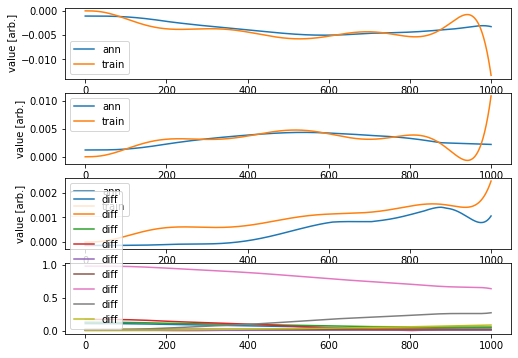

Validation loss: 0.21103846280212604
Testing loss: 0.5695187632331407


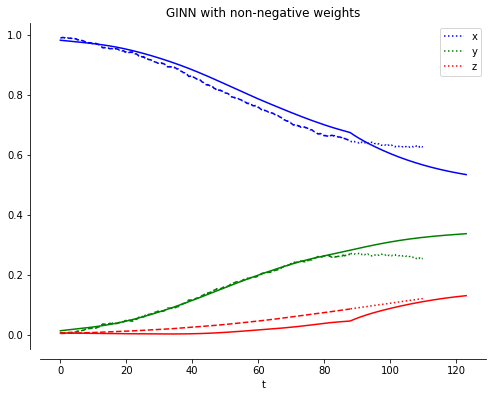

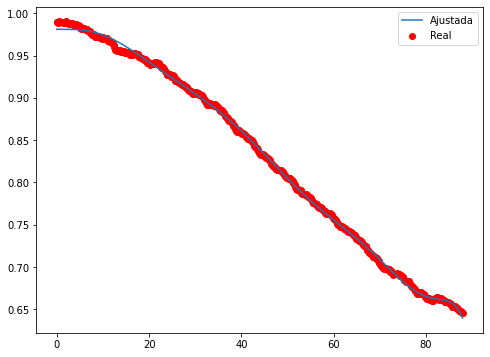

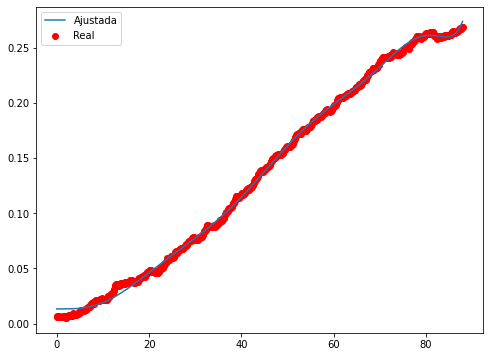

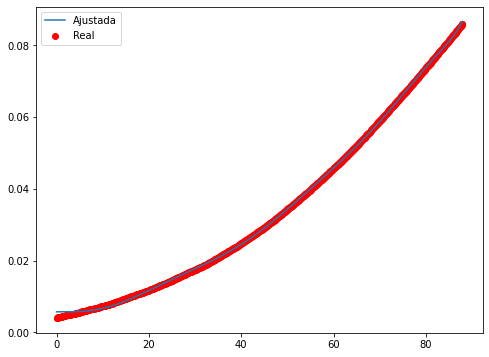

Epoch 1/500
32/32 - 1s - loss: 0.3282 - 1s/epoch - 35ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0473 - 98ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0112 - 82ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0048 - 83ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0030 - 86ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0022 - 81ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 0.0017 - 90ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 0.0014 - 88ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 0.0011 - 74ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 9.3902e-04 - 88ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 7.9902e-04 - 93ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 6.8917e-04 - 82ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 6.0257e-04 - 93ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 5.3201e-04 - 92ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 4.7255e-04 - 94ms/epoch - 3ms/step
Epoch 16/500
32/32 - 0s - loss: 4.2371e-0

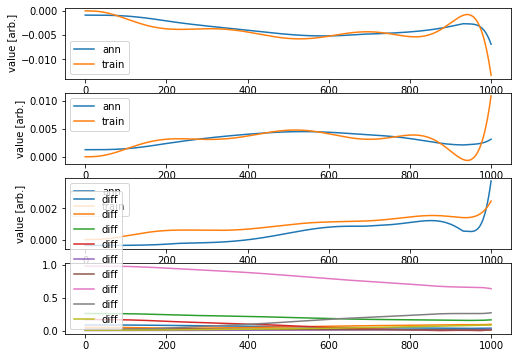

Validation loss: 0.43901736718234596
Testing loss: 11.407299310727476


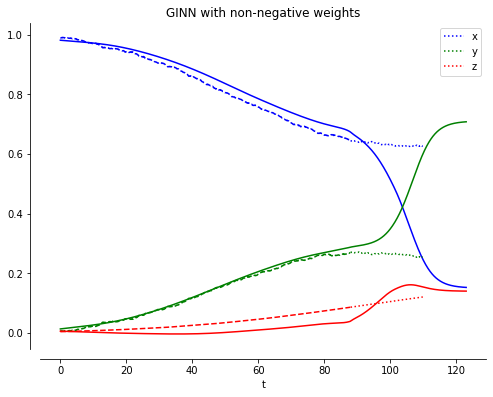

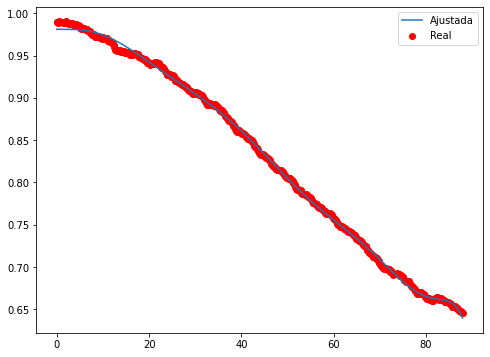

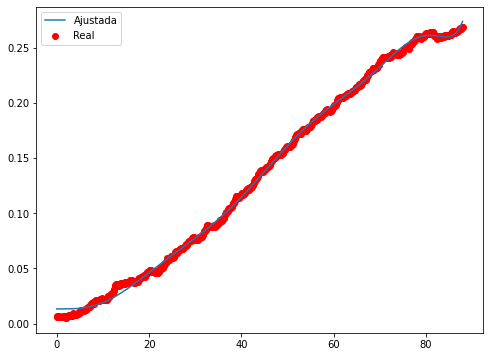

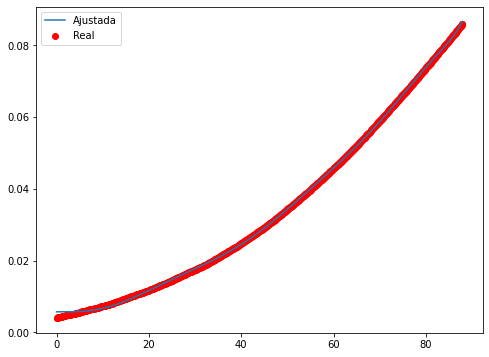

Epoch 1/500
32/32 - 1s - loss: 0.1077 - 1s/epoch - 36ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0073 - 96ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0013 - 86ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 7.6499e-04 - 83ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 5.7542e-04 - 95ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 4.5127e-04 - 78ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 3.6713e-04 - 86ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 3.0442e-04 - 87ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 2.5140e-04 - 100ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 2.0644e-04 - 92ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 1.6853e-04 - 83ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 1.3648e-04 - 92ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 1.0995e-04 - 84ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 8.7838e-05 - 86ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 7.0049e-05 - 83ms/epoch - 3ms/step
Epoch 16/500
32/

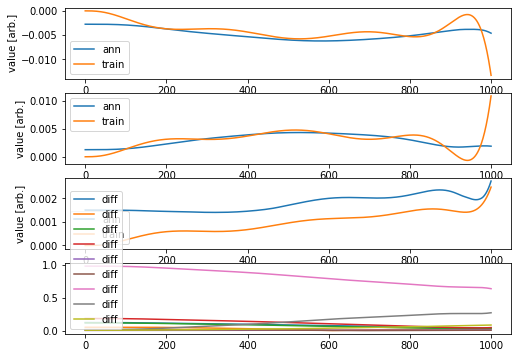

Validation loss: 2.094781182860492
Testing loss: 4.612675775235185


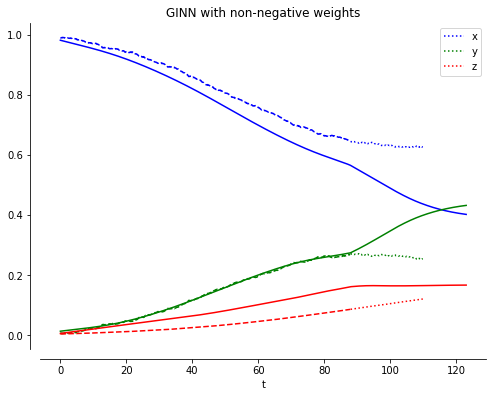

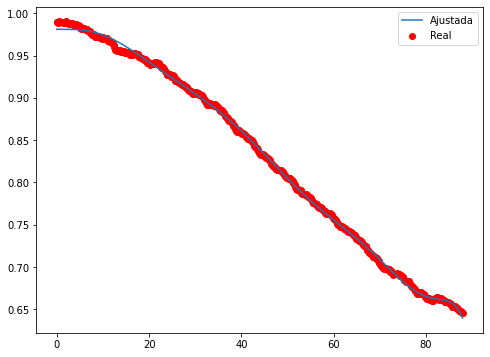

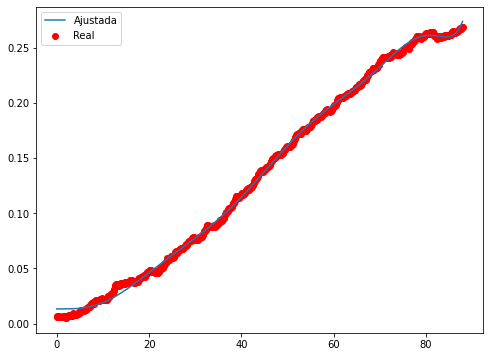

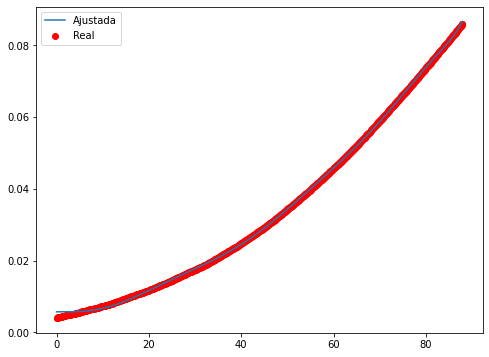

Epoch 1/500
32/32 - 2s - loss: 0.1994 - 2s/epoch - 55ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0191 - 94ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0033 - 93ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0015 - 99ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0011 - 119ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 8.3655e-04 - 102ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 6.7004e-04 - 107ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 5.4491e-04 - 97ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 4.4554e-04 - 92ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 3.6734e-04 - 99ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 3.0621e-04 - 101ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 2.5761e-04 - 102ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 2.2036e-04 - 97ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 1.9008e-04 - 93ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 1.6492e-04 - 96ms/epoch - 3ms/step
Epoch 16/500
32/32 -

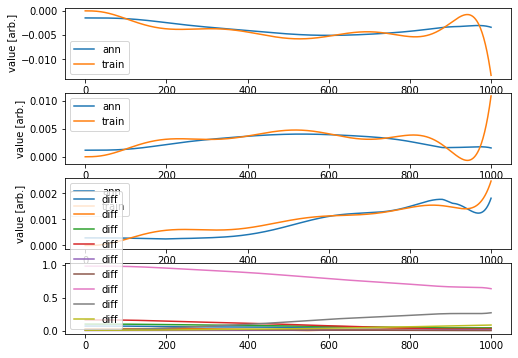

Validation loss: 0.03216894922065736
Testing loss: 0.10617422785254028


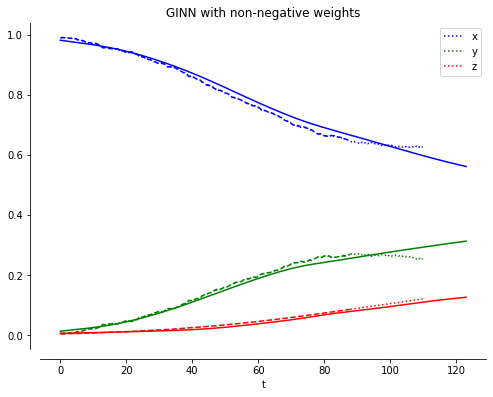

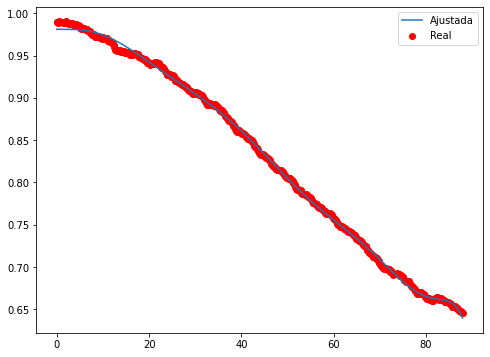

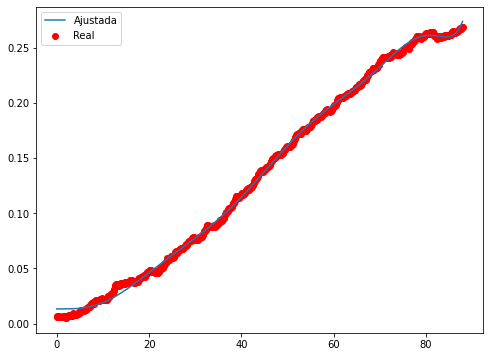

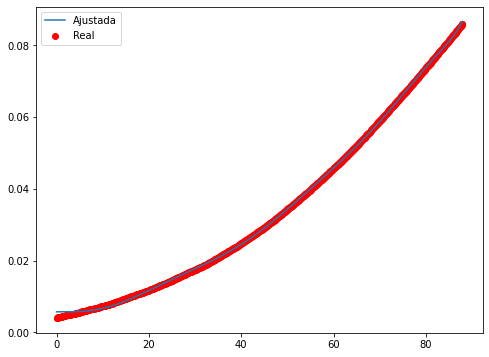

Epoch 1/500
32/32 - 1s - loss: 0.1500 - 1s/epoch - 35ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0164 - 99ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0040 - 81ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0022 - 88ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0015 - 86ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0010 - 94ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 7.8983e-04 - 86ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 6.1696e-04 - 101ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 4.9591e-04 - 96ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 4.0529e-04 - 88ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 3.3162e-04 - 89ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 2.7171e-04 - 85ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 2.2378e-04 - 86ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 1.8525e-04 - 88ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 1.5277e-04 - 90ms/epoch - 3ms/step
Epoch 16/500
32/32 - 0s - lo

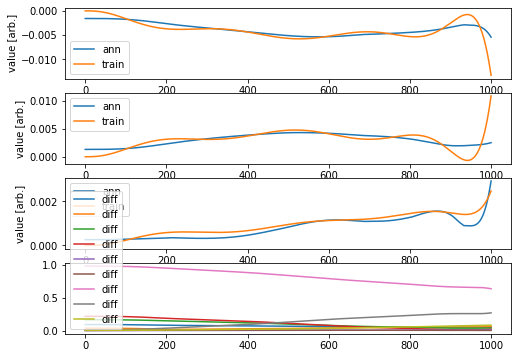

Validation loss: 0.2821042483314625
Testing loss: 4.602545185451474


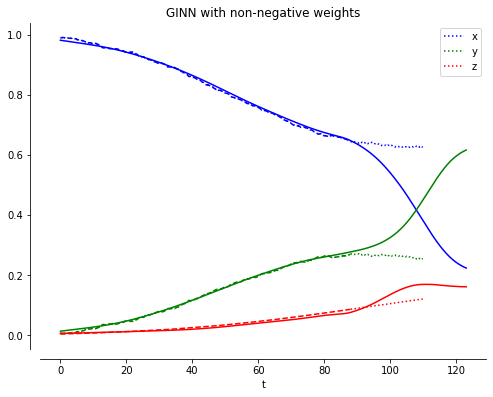

____________________________
Iteración =  18
Min =  0.06989518180235846
[[0, 1, 0, 0, 0, 1], [0, 1, 0, 0, 0, 1], [0, 1, 1, 0, 1, 0], [0, 1, 1, 0, 0, 1], [0, 1, 0, 0, 0, 1]]
[0.06989518180235846, 0.14073881611792677, 0.14698108422783035, 0.2948602621482329, 0.20248307720971576]
[0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846]


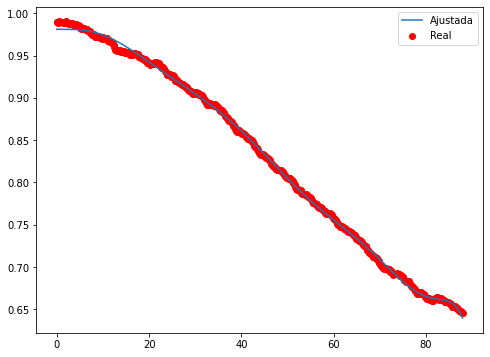

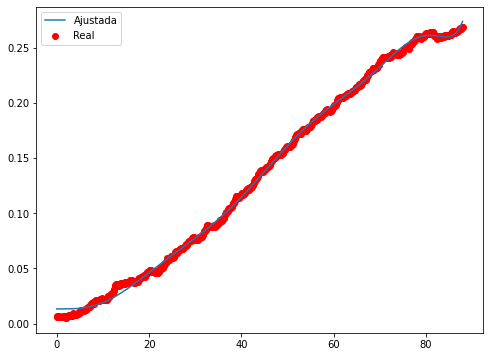

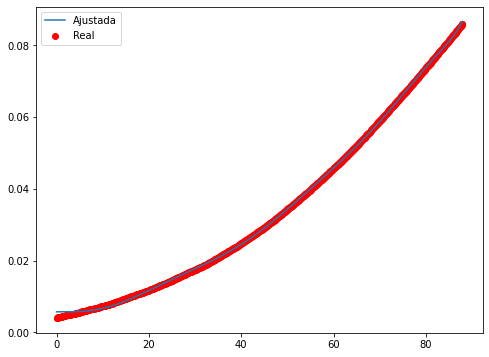

Epoch 1/500
32/32 - 1s - loss: 0.3630 - 1s/epoch - 35ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0578 - 100ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0134 - 84ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0045 - 100ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0021 - 101ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0012 - 85ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 8.5942e-04 - 90ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 6.7284e-04 - 93ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 5.5758e-04 - 103ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 4.7692e-04 - 92ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 4.1453e-04 - 97ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 3.6469e-04 - 92ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 3.2342e-04 - 90ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 2.8829e-04 - 80ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 2.5861e-04 - 88ms/epoch - 3ms/step
Epoch 16/500
32/32 - 0s -

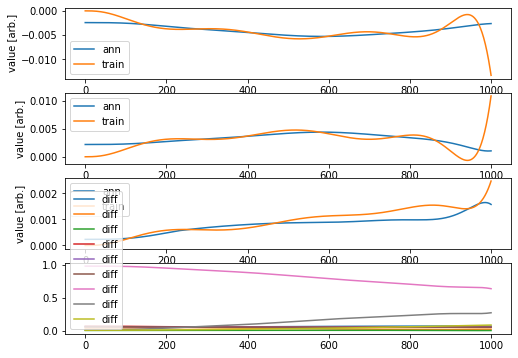

Validation loss: 0.4093311797324823
Testing loss: 2.3428965383292115


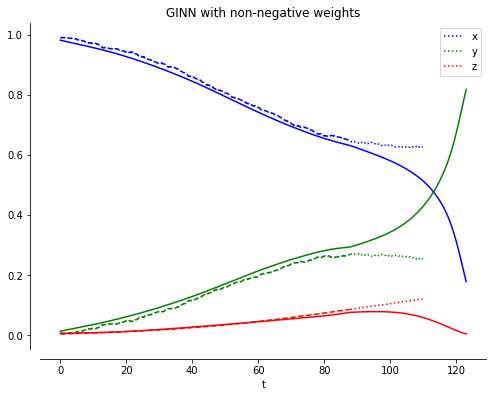

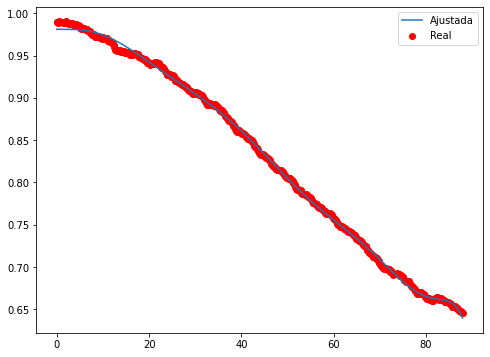

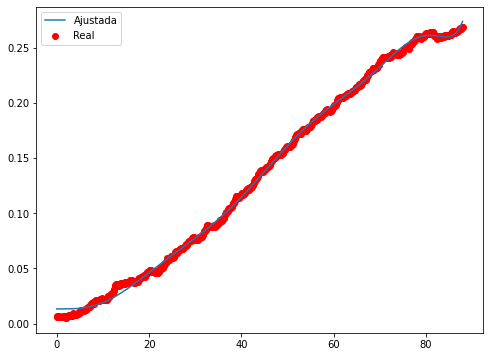

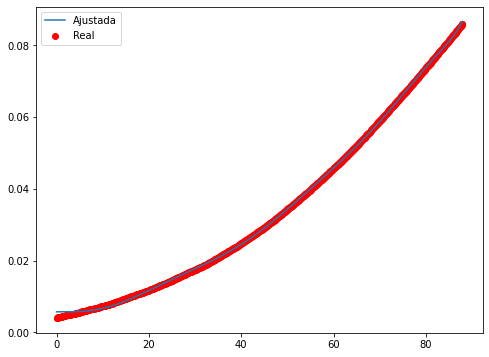

Epoch 1/500
32/32 - 1s - loss: 0.1673 - 1s/epoch - 46ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0166 - 107ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0029 - 98ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0012 - 80ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 8.2931e-04 - 90ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 6.5374e-04 - 91ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 5.3983e-04 - 90ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 4.5182e-04 - 87ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 3.8268e-04 - 94ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 3.2580e-04 - 96ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 2.7926e-04 - 98ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 2.4077e-04 - 88ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 2.0866e-04 - 88ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 1.8134e-04 - 97ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 1.5818e-04 - 89ms/epoch - 3ms/step
Epoch 16/500
32/32 -

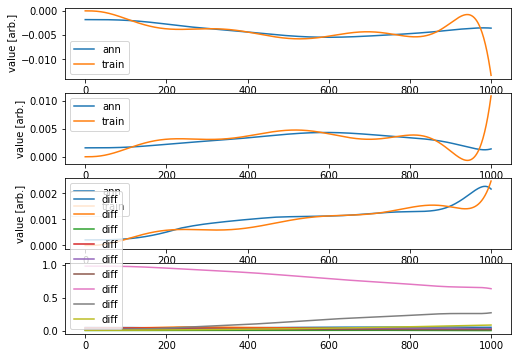

Validation loss: 0.16001784992516754
Testing loss: 3.1454801876179106


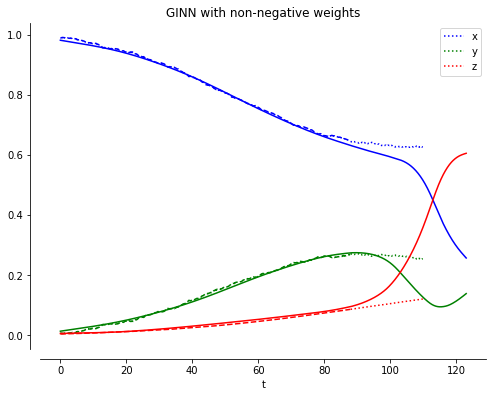

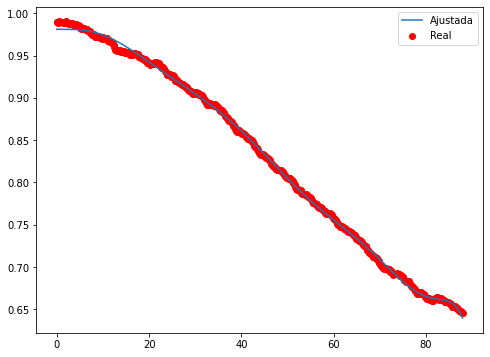

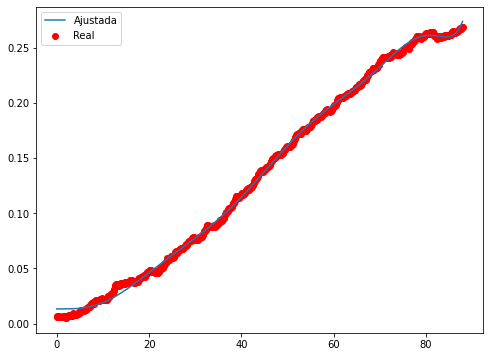

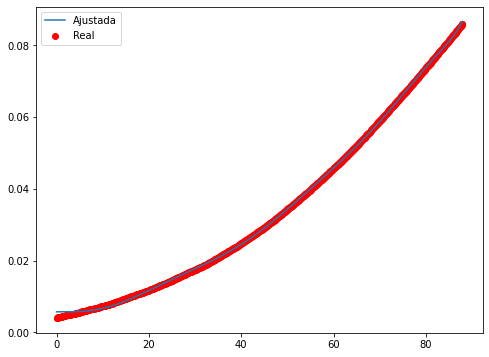

Epoch 1/500
32/32 - 1s - loss: 0.1565 - 1s/epoch - 35ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0189 - 99ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0044 - 86ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0019 - 91ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0012 - 92ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 8.9833e-04 - 83ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 7.1768e-04 - 91ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 5.9612e-04 - 89ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 5.0254e-04 - 89ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 4.2628e-04 - 98ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 3.6578e-04 - 92ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 3.1525e-04 - 84ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 2.7317e-04 - 92ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 2.3771e-04 - 85ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 2.0845e-04 - 87ms/epoch - 3ms/step
Epoch 16/500
32/32 - 0s -

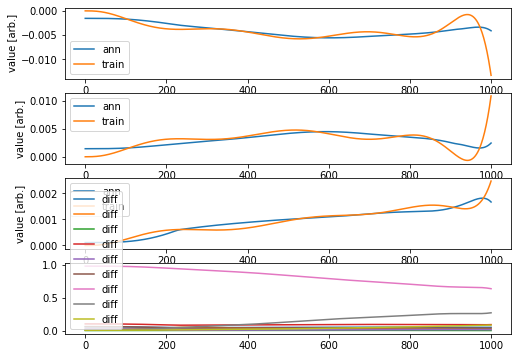

Validation loss: 0.2691055922123743
Testing loss: 2.8798502966496153


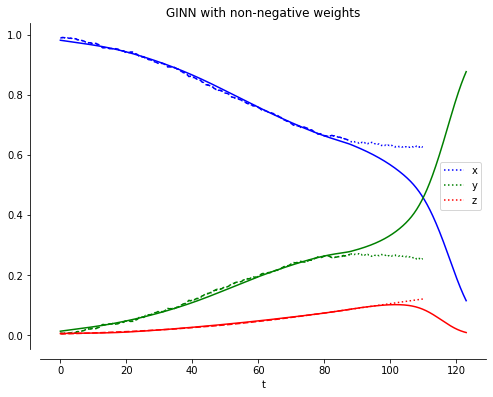

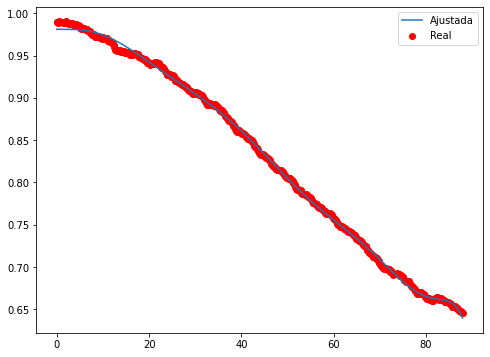

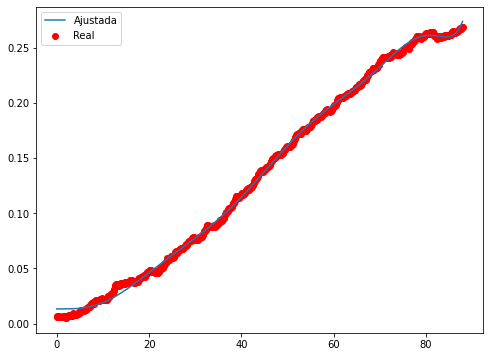

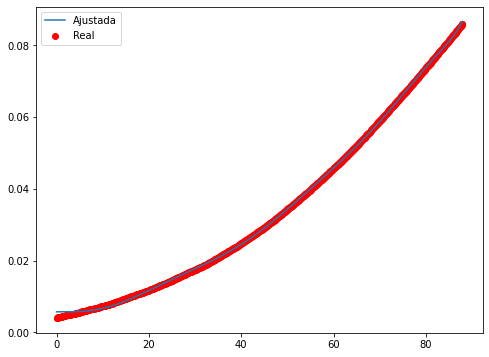

Epoch 1/500
32/32 - 1s - loss: 0.1519 - 1s/epoch - 36ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0129 - 103ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0017 - 89ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 6.5854e-04 - 97ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 4.3585e-04 - 104ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 3.2203e-04 - 84ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 2.4246e-04 - 91ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 1.8384e-04 - 89ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 1.4091e-04 - 82ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 1.0920e-04 - 91ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 8.5864e-05 - 84ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 6.9066e-05 - 90ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 5.6494e-05 - 99ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 4.6240e-05 - 70ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 3.7843e-05 - 78ms/epoch - 2ms/step
Epoch 16/500
32

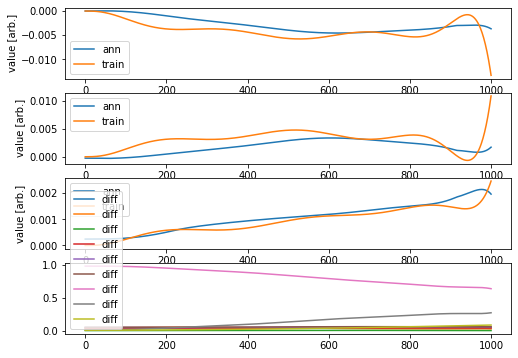

Validation loss: 5.130655540209321
Testing loss: 13.60989173508989


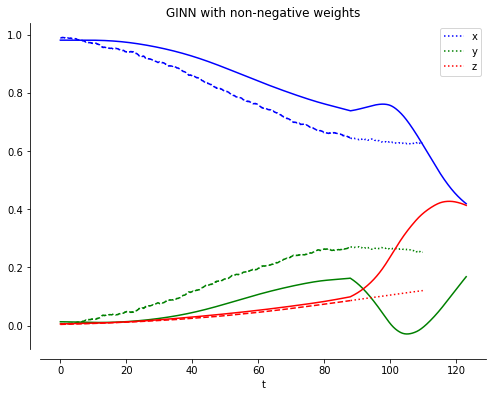

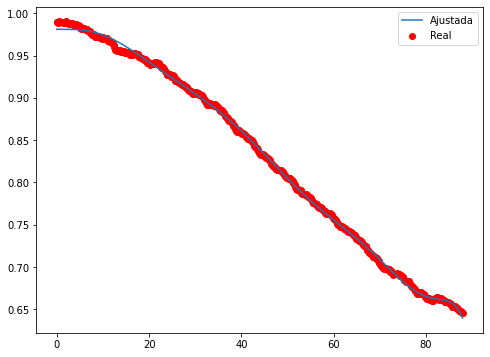

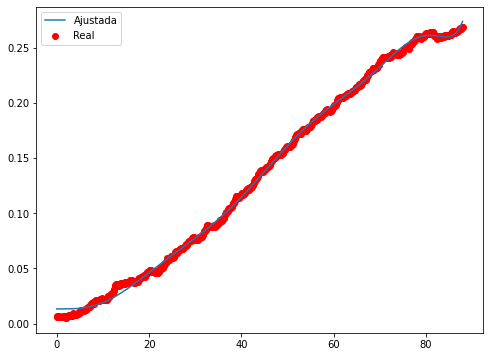

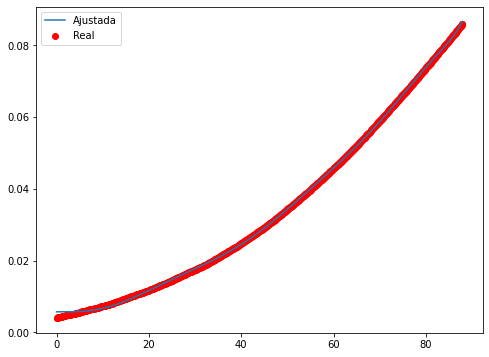

Epoch 1/500
32/32 - 1s - loss: 0.2488 - 1s/epoch - 35ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0307 - 98ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0062 - 101ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0025 - 87ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0015 - 88ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0011 - 87ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 9.2143e-04 - 89ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 7.8331e-04 - 101ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 6.7029e-04 - 89ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 5.7220e-04 - 93ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 4.8748e-04 - 96ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 4.1537e-04 - 87ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 3.5457e-04 - 89ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 3.0497e-04 - 90ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 2.6370e-04 - 89ms/epoch - 3ms/step
Epoch 16/500
32/32 - 0s - l

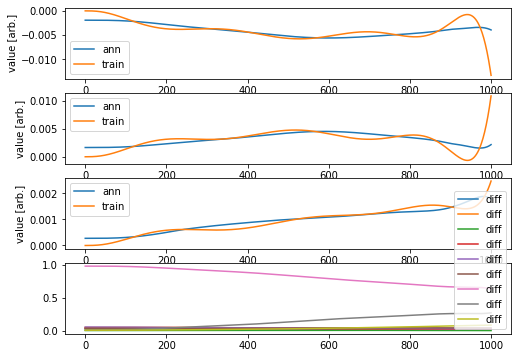

Validation loss: 0.31464669300002146
Testing loss: 1.7846534713295856


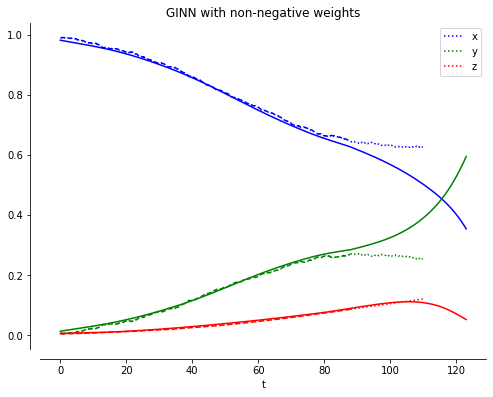

____________________________
Iteración =  19
Min =  0.06989518180235846
[[0, 1, 0, 0, 0, 1], [0, 1, 0, 0, 0, 1], [0, 1, 1, 0, 1, 0], [0, 1, 1, 0, 0, 1], [0, 1, 0, 0, 0, 1]]
[0.06989518180235846, 0.14073881611792677, 0.14698108422783035, 0.2948602621482329, 0.20248307720971576]
[0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846]


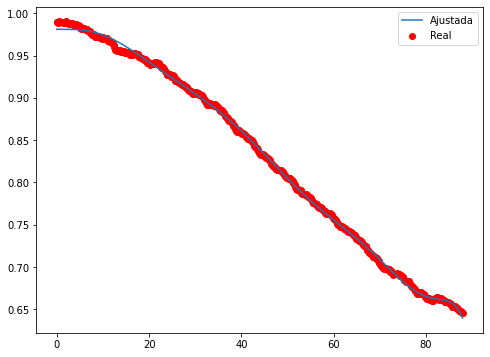

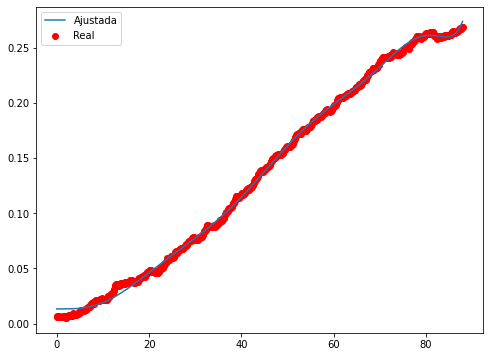

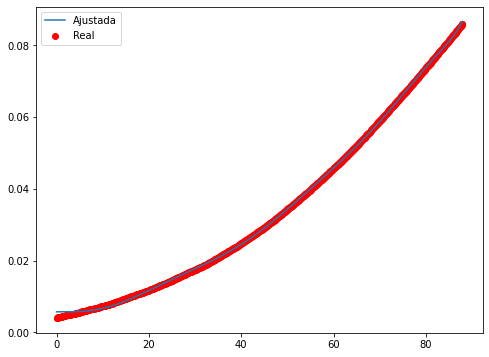

Epoch 1/500
32/32 - 1s - loss: 6.8342e-04 - 1s/epoch - 36ms/step
Epoch 2/500
32/32 - 0s - loss: 8.8244e-05 - 94ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 3.4681e-05 - 87ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 2.2450e-05 - 86ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 1.7028e-05 - 89ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.3639e-05 - 87ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 1.1116e-05 - 85ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 9.0293e-06 - 78ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 7.6730e-06 - 83ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 6.8277e-06 - 84ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 6.2270e-06 - 94ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 5.8004e-06 - 101ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 5.4736e-06 - 91ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 5.2162e-06 - 96ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 5.0015e-06 - 95ms/epoch - 3ms/step
Epoc

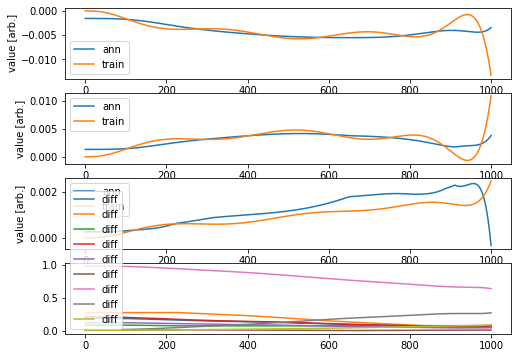

Validation loss: 0.4258091761687373
Testing loss: 1.2516402308928796


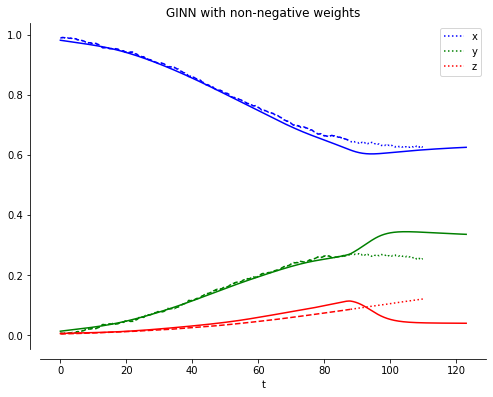

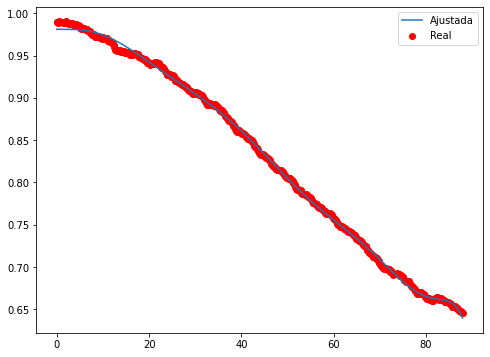

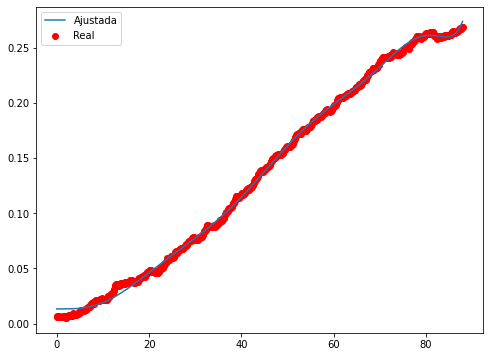

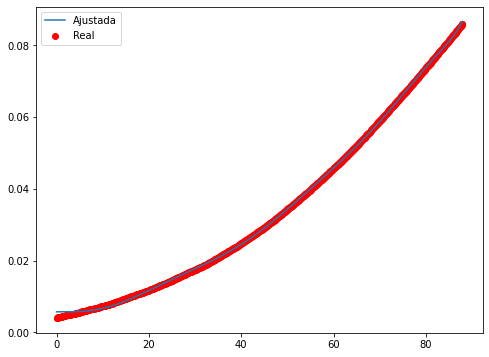

Epoch 1/500
32/32 - 2s - loss: 0.0018 - 2s/epoch - 54ms/step
Epoch 2/500
32/32 - 0s - loss: 1.6735e-04 - 100ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 7.0314e-05 - 102ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 4.4569e-05 - 97ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 3.3438e-05 - 113ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 2.7533e-05 - 101ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 2.3469e-05 - 95ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 2.0461e-05 - 91ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 1.8055e-05 - 98ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 1.6159e-05 - 93ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 1.4380e-05 - 118ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 1.2437e-05 - 91ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 1.0824e-05 - 97ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 9.5367e-06 - 105ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 8.5355e-06 - 101ms/epoch - 3ms/step
Ep

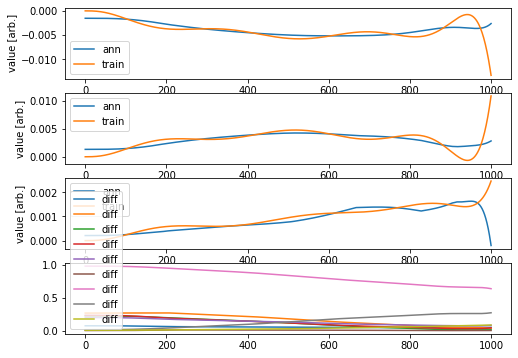

Validation loss: 0.10864660647946356
Testing loss: 0.5209402092336987


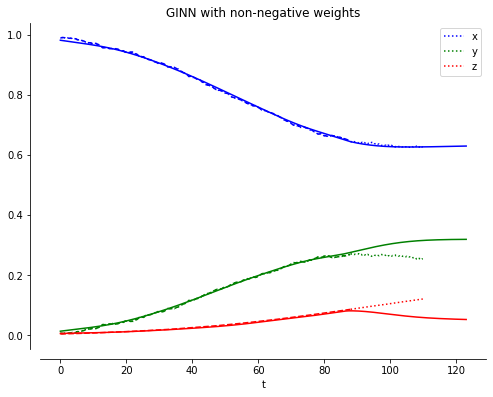

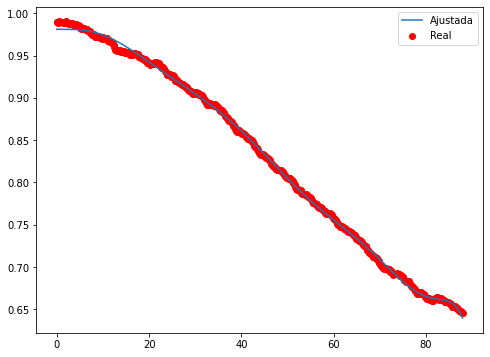

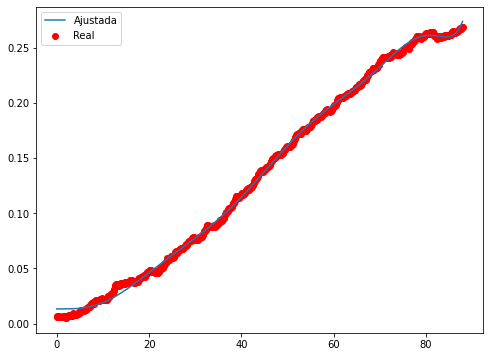

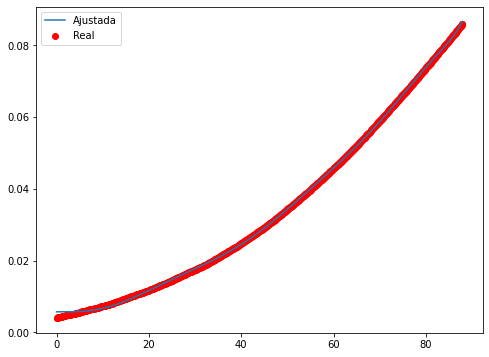

Epoch 1/500
32/32 - 1s - loss: 6.3522e-04 - 1s/epoch - 46ms/step
Epoch 2/500
32/32 - 0s - loss: 8.7663e-05 - 113ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 3.0308e-05 - 84ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 1.8296e-05 - 88ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 1.3342e-05 - 94ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.0457e-05 - 93ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 8.7638e-06 - 95ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 7.5657e-06 - 93ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 6.6329e-06 - 93ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 5.9897e-06 - 103ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 5.5016e-06 - 96ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 5.1191e-06 - 83ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 4.8203e-06 - 97ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 4.6021e-06 - 120ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 4.4153e-06 - 86ms/epoch - 3ms/step
Ep

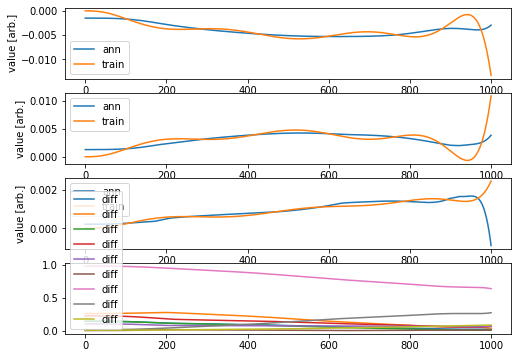

Validation loss: 0.2563543895757406
Testing loss: 1.007564031189788


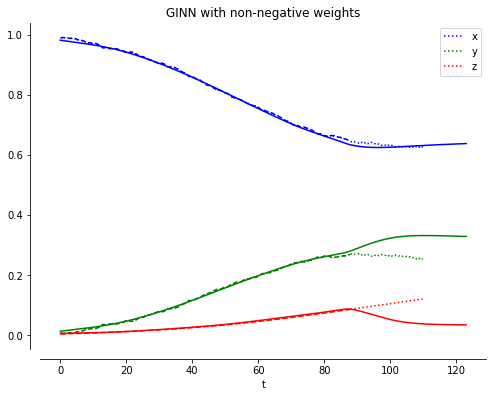

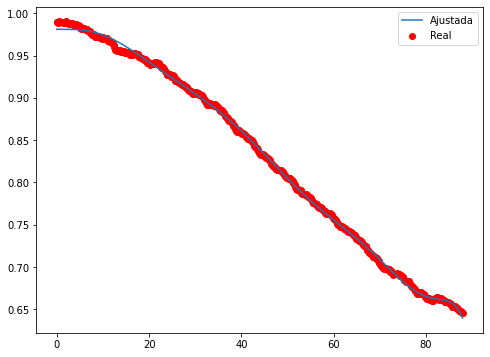

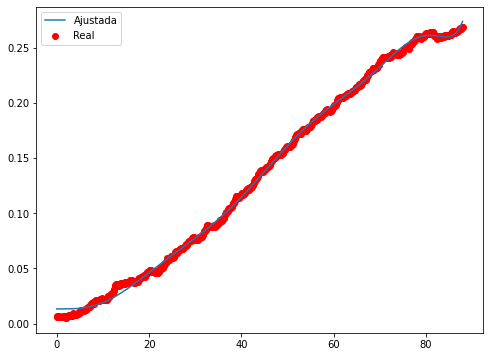

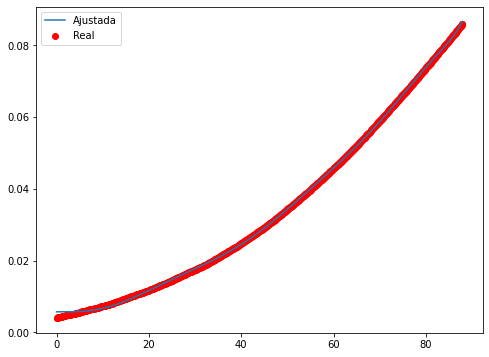

Epoch 1/500
32/32 - 1s - loss: 6.0791e-04 - 1s/epoch - 36ms/step
Epoch 2/500
32/32 - 0s - loss: 5.9434e-05 - 103ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 2.6784e-05 - 96ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 1.7107e-05 - 75ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 1.2421e-05 - 75ms/epoch - 2ms/step
Epoch 6/500
32/32 - 0s - loss: 1.0014e-05 - 89ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 8.6417e-06 - 89ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 7.7882e-06 - 87ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 7.1874e-06 - 86ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 6.7407e-06 - 89ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 6.3337e-06 - 86ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 5.9582e-06 - 87ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 5.6255e-06 - 87ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 5.3402e-06 - 87ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 5.0796e-06 - 99ms/epoch - 3ms/step
Epoc

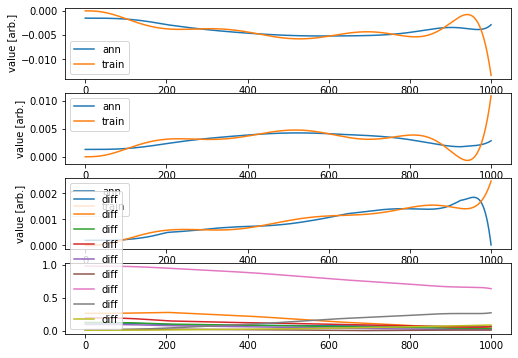

Validation loss: 0.11745529700205097
Testing loss: 0.5600658477260149


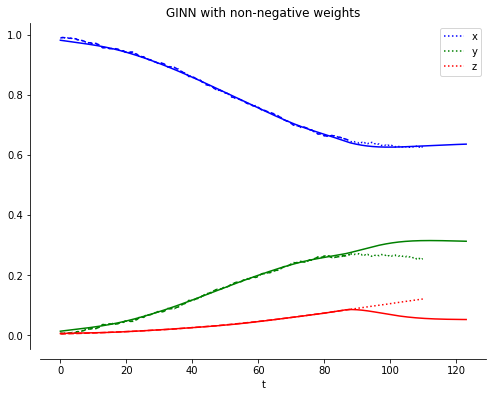

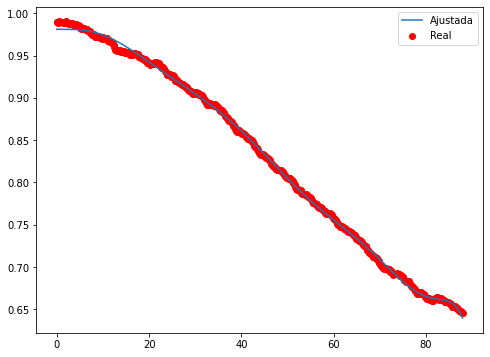

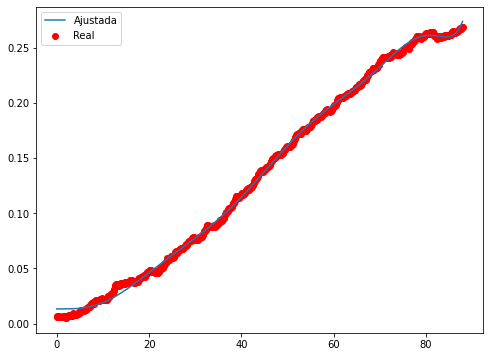

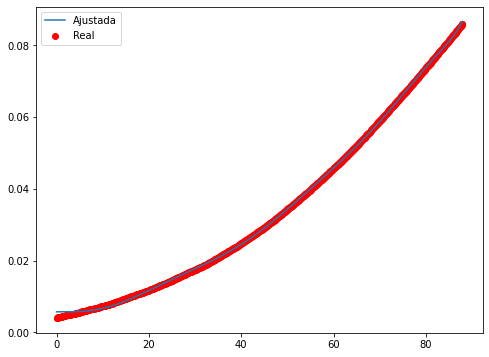

Epoch 1/500
32/32 - 1s - loss: 6.1234e-04 - 1s/epoch - 35ms/step
Epoch 2/500
32/32 - 0s - loss: 8.8767e-05 - 97ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 2.9949e-05 - 93ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 1.5939e-05 - 95ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 1.0923e-05 - 89ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 8.4912e-06 - 88ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 7.1531e-06 - 93ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 6.3639e-06 - 96ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 5.8218e-06 - 83ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 5.3910e-06 - 93ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 5.0116e-06 - 93ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 4.7046e-06 - 95ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 4.4693e-06 - 90ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 4.2803e-06 - 87ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 4.1199e-06 - 89ms/epoch - 3ms/step
Epoch

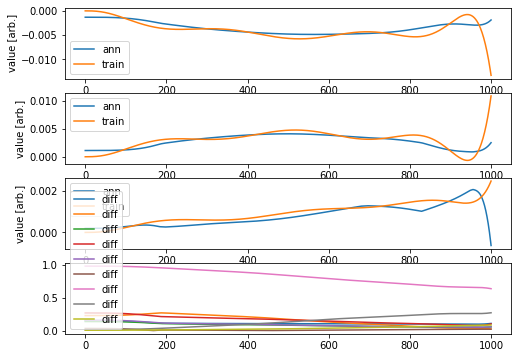

Validation loss: 0.050823640074202134
Testing loss: 0.21925291657244186


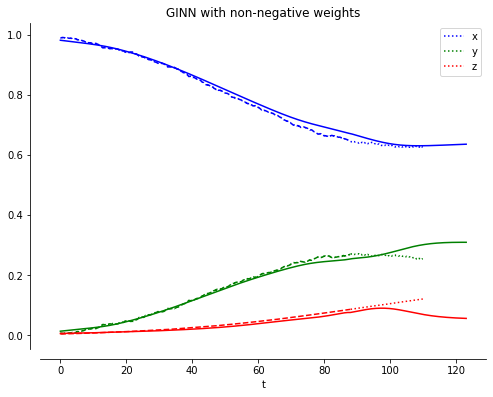

____________________________
Iteración =  20
Min =  0.06989518180235846
[[0, 1, 0, 0, 0, 1], [0, 1, 0, 0, 0, 1], [0, 1, 1, 0, 1, 0], [0, 1, 0, 0, 0, 1], [0, 1, 0, 1, 0, 1]]
[0.06989518180235846, 0.14073881611792677, 0.14698108422783035, 0.20248307720971576, 0.19181782186003887]
[0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846]


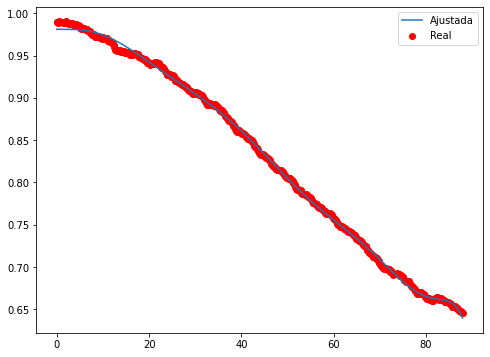

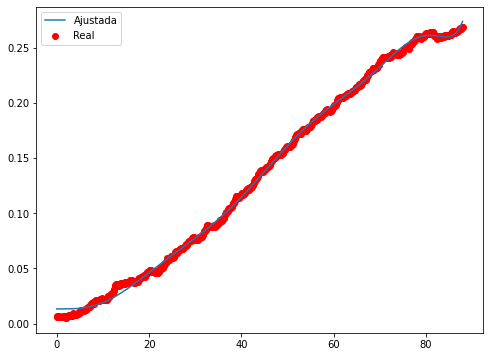

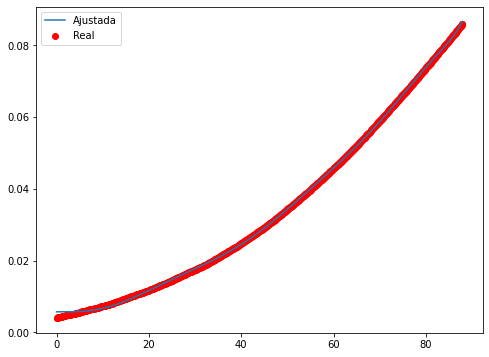

Epoch 1/500
32/32 - 1s - loss: 0.0010 - 1s/epoch - 36ms/step
Epoch 2/500
32/32 - 0s - loss: 1.1839e-04 - 90ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 3.7249e-05 - 89ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 2.2414e-05 - 89ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 1.6016e-05 - 88ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.2766e-05 - 85ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 1.0743e-05 - 84ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 9.4956e-06 - 89ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 8.5901e-06 - 83ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 7.9384e-06 - 86ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 7.4346e-06 - 90ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 7.0213e-06 - 84ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 6.6553e-06 - 103ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 6.3274e-06 - 90ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 6.0366e-06 - 94ms/epoch - 3ms/step
Epoch 16

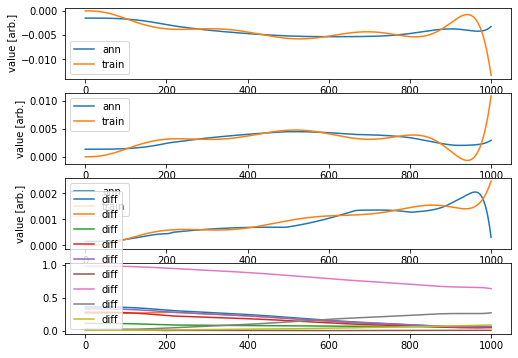

Validation loss: 0.25361461883142894
Testing loss: 0.7711897727159475


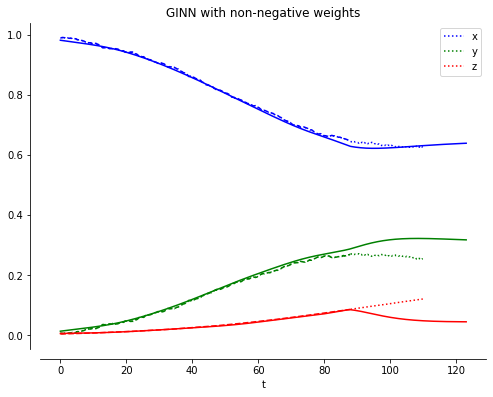

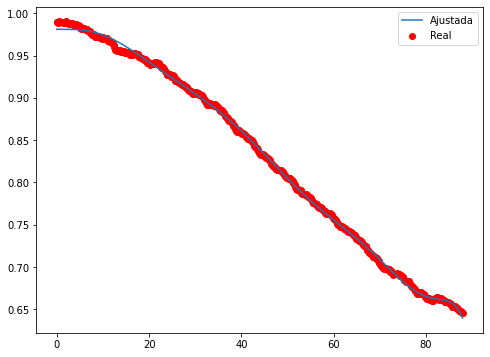

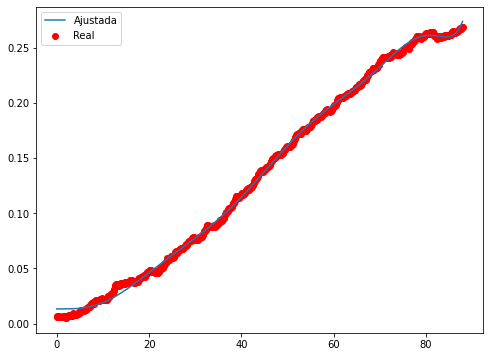

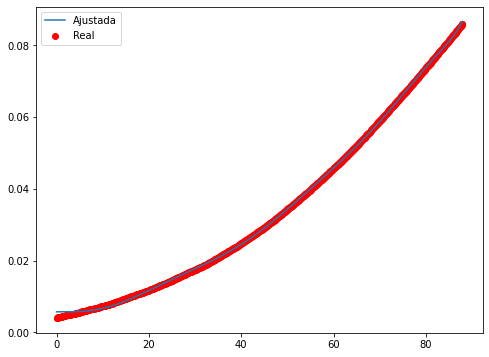

Epoch 1/500
32/32 - 1s - loss: 0.0011 - 1s/epoch - 37ms/step
Epoch 2/500
32/32 - 0s - loss: 1.2037e-04 - 100ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 4.3745e-05 - 102ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 2.8361e-05 - 108ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 2.0981e-05 - 102ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.6049e-05 - 103ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 1.2803e-05 - 90ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 1.0986e-05 - 88ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 9.6573e-06 - 96ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 8.5717e-06 - 96ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 7.7503e-06 - 88ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 7.1524e-06 - 83ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 6.7451e-06 - 89ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 6.3381e-06 - 94ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 6.0535e-06 - 89ms/epoch - 3ms/step
Epoc

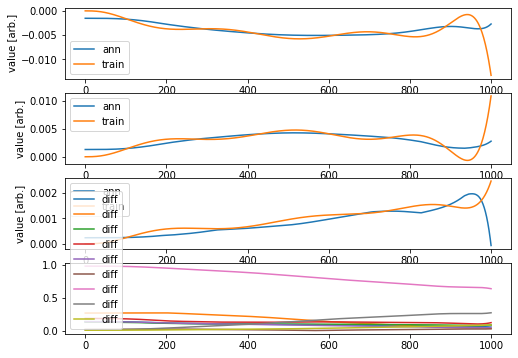

Validation loss: 0.0772706080504969
Testing loss: 0.3819456506407169


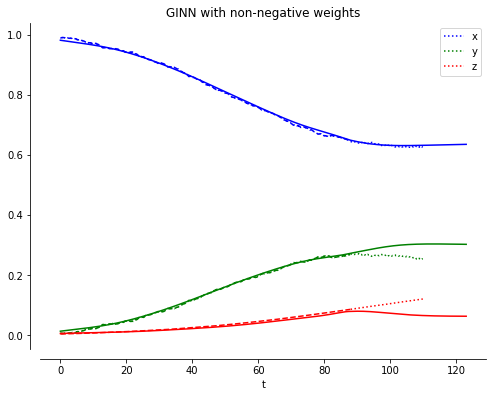

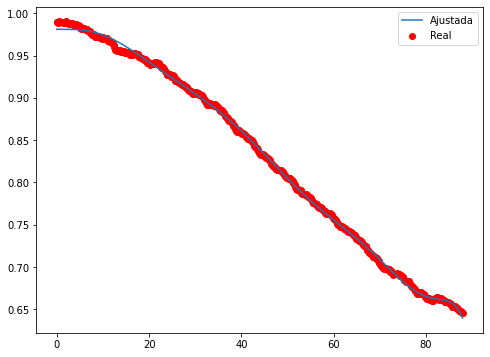

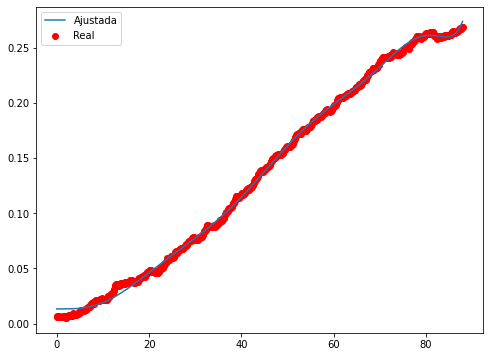

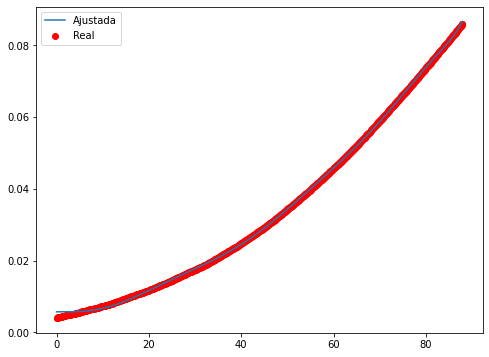

Epoch 1/500
32/32 - 1s - loss: 0.0022 - 1s/epoch - 36ms/step
Epoch 2/500
32/32 - 0s - loss: 2.9639e-04 - 92ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 1.2454e-04 - 89ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 7.3619e-05 - 94ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 5.0518e-05 - 92ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 3.7913e-05 - 78ms/epoch - 2ms/step
Epoch 7/500
32/32 - 0s - loss: 3.0441e-05 - 86ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 2.5516e-05 - 93ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 2.2044e-05 - 86ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 1.9474e-05 - 105ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 1.7369e-05 - 87ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 1.5467e-05 - 93ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 1.3796e-05 - 99ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 1.2478e-05 - 87ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 1.1362e-05 - 90ms/epoch - 3ms/step
Epoch 16

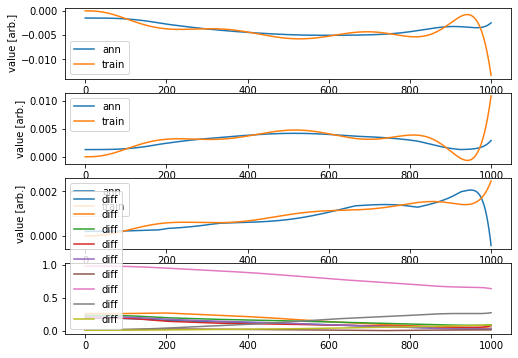

Validation loss: 0.05545694196449253
Testing loss: 0.47642397436427536


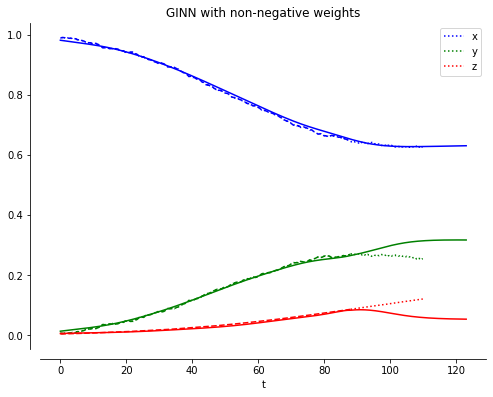

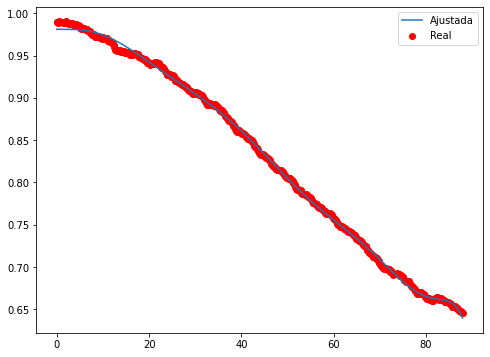

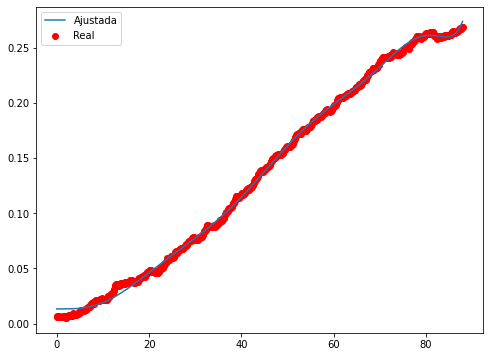

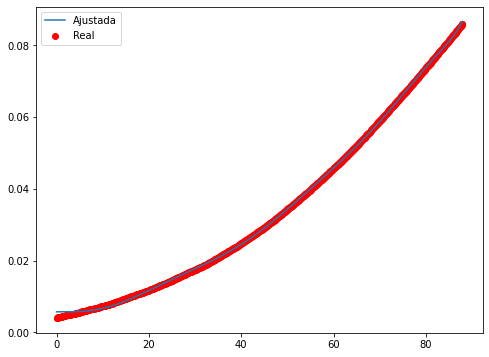

Epoch 1/500
32/32 - 2s - loss: 0.0029 - 2s/epoch - 50ms/step
Epoch 2/500
32/32 - 0s - loss: 3.1685e-04 - 88ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 1.1388e-04 - 92ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 6.3263e-05 - 106ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 4.4451e-05 - 97ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 3.3453e-05 - 88ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 2.6626e-05 - 107ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 2.2577e-05 - 87ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 1.9732e-05 - 89ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 1.7595e-05 - 94ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 1.6168e-05 - 93ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 1.5006e-05 - 91ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 1.4062e-05 - 91ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 1.3199e-05 - 92ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 1.2473e-05 - 101ms/epoch - 3ms/step
Epoch 

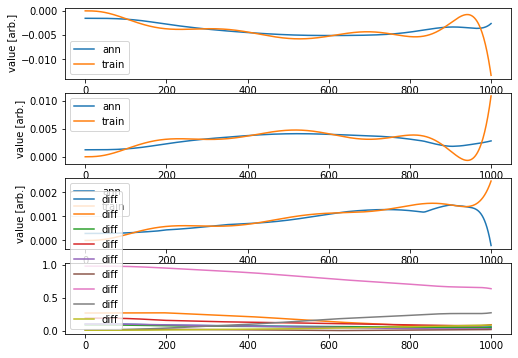

Validation loss: 0.07271060730697178
Testing loss: 0.35143359632160026


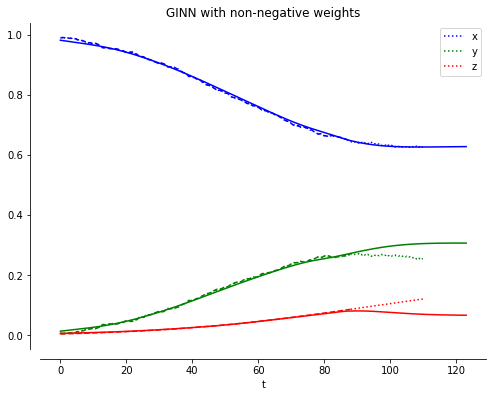

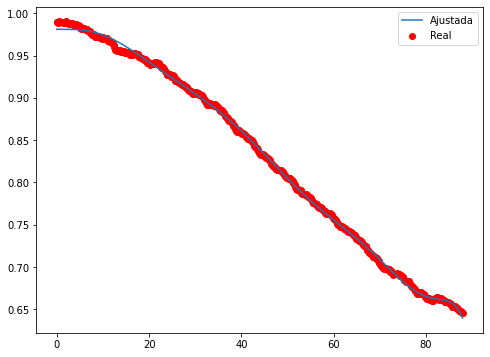

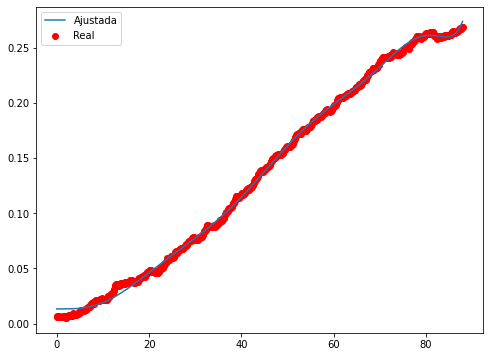

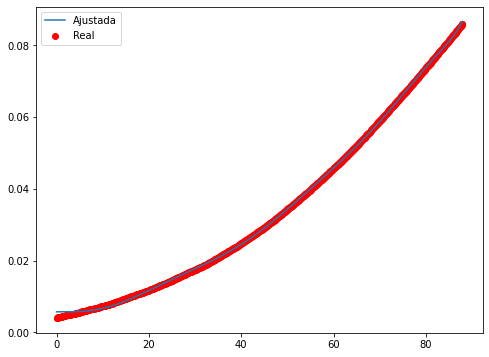

Epoch 1/500
32/32 - 1s - loss: 0.0019 - 1s/epoch - 35ms/step
Epoch 2/500
32/32 - 0s - loss: 2.2921e-04 - 105ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 8.5094e-05 - 91ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 5.1685e-05 - 91ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 3.7179e-05 - 90ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 2.9155e-05 - 92ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 2.4080e-05 - 84ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 2.0740e-05 - 94ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 1.8079e-05 - 87ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 1.5850e-05 - 90ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 1.4169e-05 - 78ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 1.2827e-05 - 89ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 1.1709e-05 - 91ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 1.0619e-05 - 80ms/epoch - 2ms/step
Epoch 15/500
32/32 - 0s - loss: 9.7761e-06 - 93ms/epoch - 3ms/step
Epoch 16

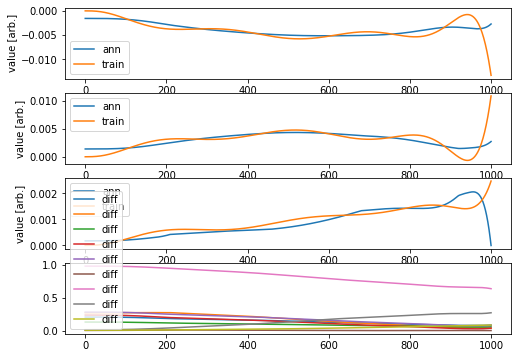

Validation loss: 0.11273207862529522
Testing loss: 0.5855840395353084


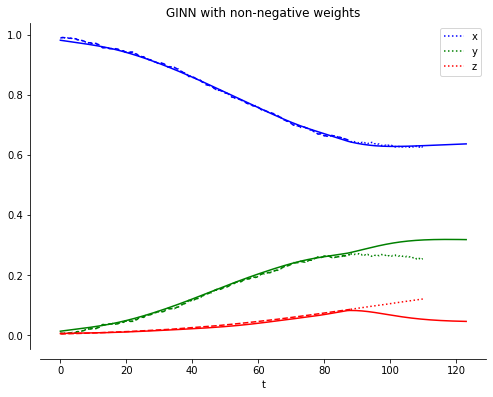

____________________________
Iteración =  21
Min =  0.06989518180235846
[[0, 1, 0, 0, 0, 1], [0, 1, 1, 0, 1, 0], [0, 1, 0, 0, 0, 1], [0, 1, 0, 1, 0, 1], [0, 1, 0, 1, 0, 1]]
[0.06989518180235846, 0.14073881611792677, 0.14698108422783035, 0.19181782186003887, 0.11435697095573708]
[0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846]


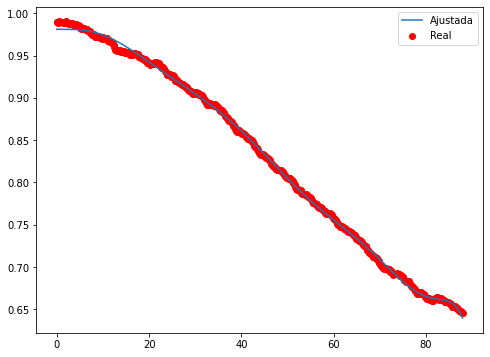

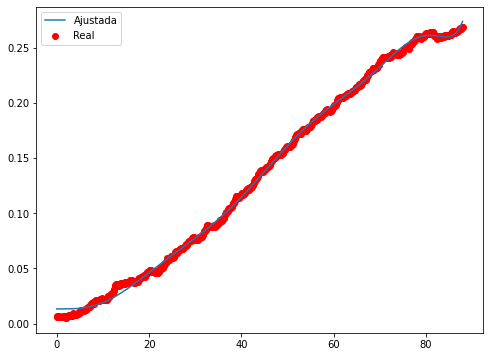

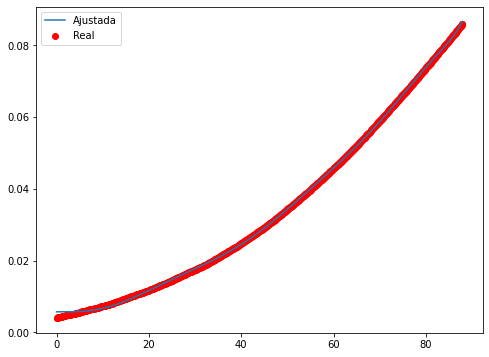

Epoch 1/500
32/32 - 1s - loss: 0.2175 - 1s/epoch - 41ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0289 - 92ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0059 - 95ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0020 - 109ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0011 - 112ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 7.3070e-04 - 97ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 6.0992e-04 - 92ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 5.3923e-04 - 92ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 4.8746e-04 - 97ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 4.3965e-04 - 101ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 3.9207e-04 - 88ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 3.4310e-04 - 100ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 2.9682e-04 - 117ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 2.5702e-04 - 118ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 2.2292e-04 - 129ms/epoch - 4ms/step
Epoch 16/500
32/32

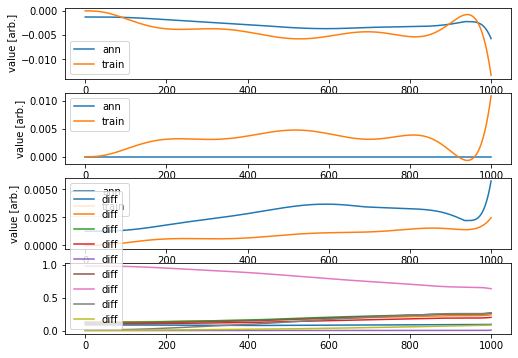

Validation loss: 11.250943819426741
Testing loss: 13.7302380124502


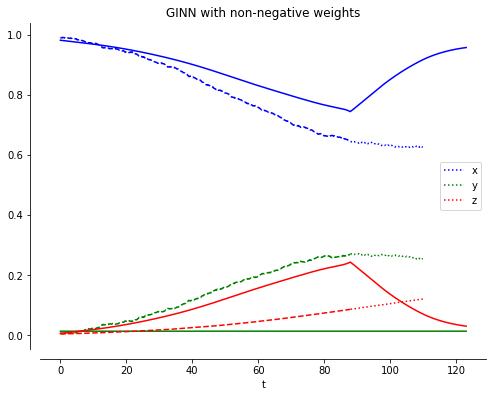

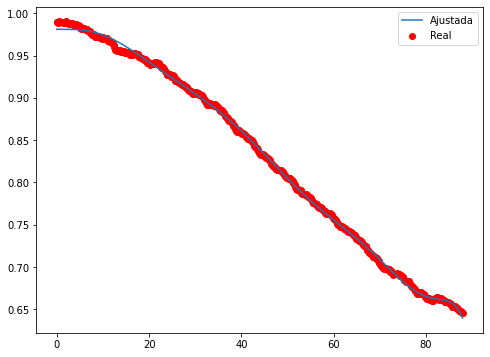

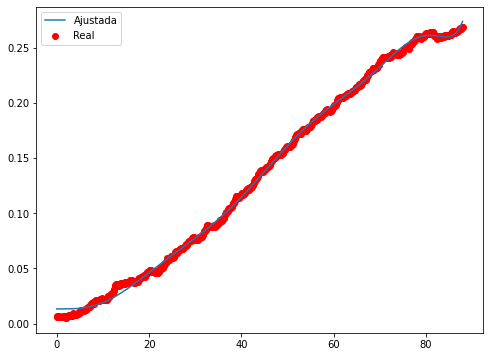

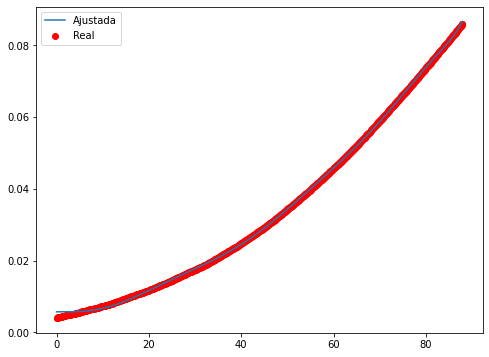

Epoch 1/500
32/32 - 1s - loss: 0.1173 - 1s/epoch - 36ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0131 - 102ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0023 - 92ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 7.5503e-04 - 90ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 4.6455e-04 - 98ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 3.7884e-04 - 112ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 3.3392e-04 - 80ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 2.9663e-04 - 88ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 2.6183e-04 - 90ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 2.3071e-04 - 97ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 2.0507e-04 - 82ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 1.8310e-04 - 92ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 1.6322e-04 - 90ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 1.4530e-04 - 90ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 1.2736e-04 - 105ms/epoch - 3ms/step
Epoch 16/500
3

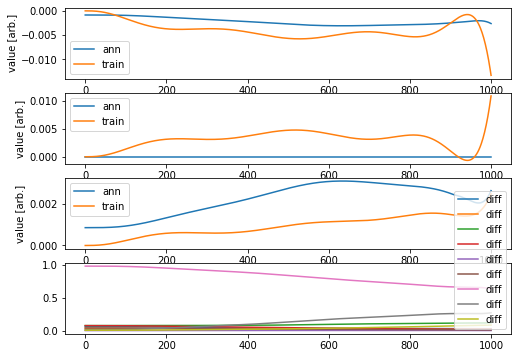

Validation loss: 12.323953539847528
Testing loss: 15.620109988954182


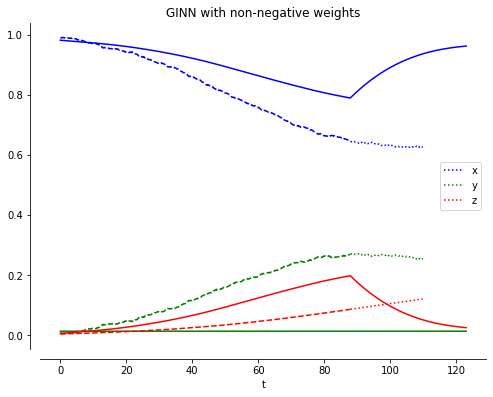

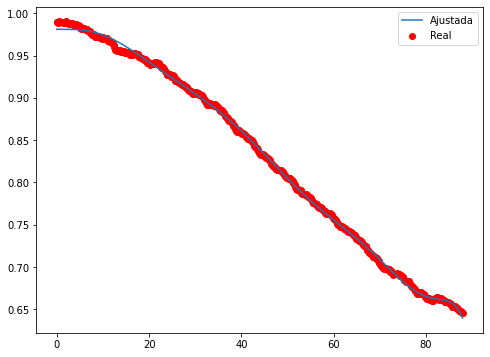

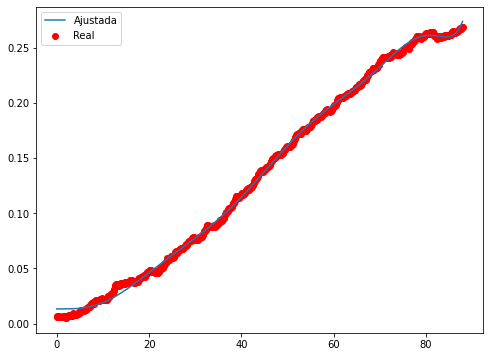

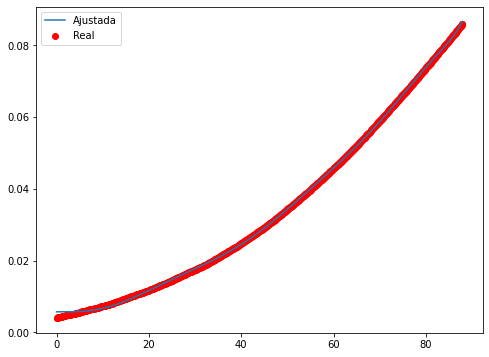

Epoch 1/500
32/32 - 1s - loss: 0.2008 - 1s/epoch - 36ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0261 - 92ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0049 - 88ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0016 - 91ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 7.7260e-04 - 92ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 5.4065e-04 - 92ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 4.5009e-04 - 88ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 3.9978e-04 - 100ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 3.6491e-04 - 96ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 3.3448e-04 - 96ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 3.0619e-04 - 88ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 2.7907e-04 - 98ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 2.5256e-04 - 90ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 2.2758e-04 - 92ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 2.0312e-04 - 98ms/epoch - 3ms/step
Epoch 16/500
32/32 -

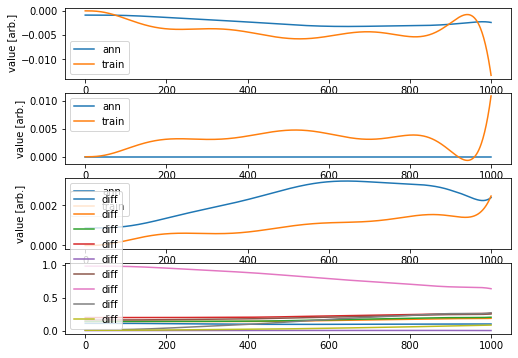

Validation loss: 11.967438526140702
Testing loss: 14.896792296037514


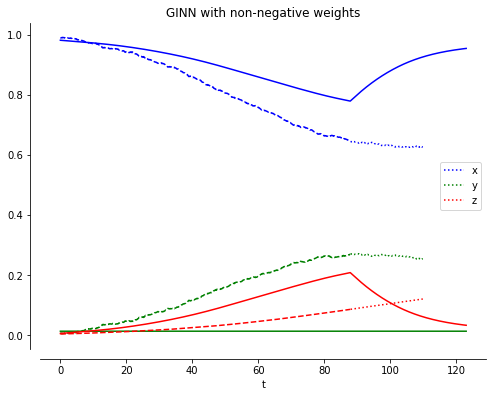

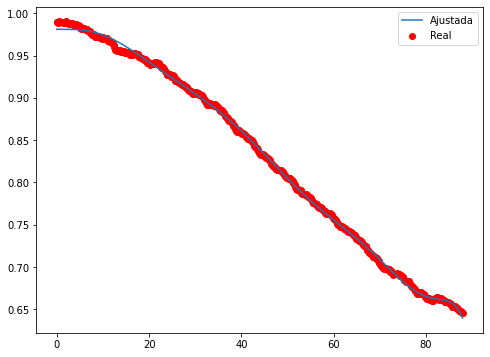

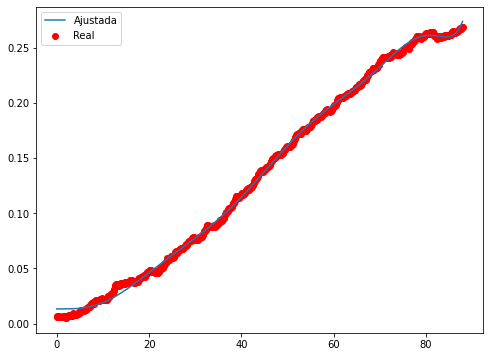

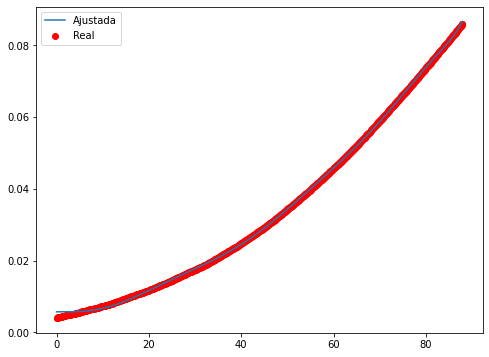

Epoch 1/500
32/32 - 1s - loss: 0.3927 - 1s/epoch - 37ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0658 - 81ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0139 - 87ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0037 - 92ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0013 - 88ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 6.8051e-04 - 93ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 4.9886e-04 - 87ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 4.3076e-04 - 93ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 3.9442e-04 - 102ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 3.6612e-04 - 85ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 3.4007e-04 - 99ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 3.1450e-04 - 90ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 2.8976e-04 - 97ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 2.6526e-04 - 88ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 2.4195e-04 - 80ms/epoch - 3ms/step
Epoch 16/500
32/32 - 0s 

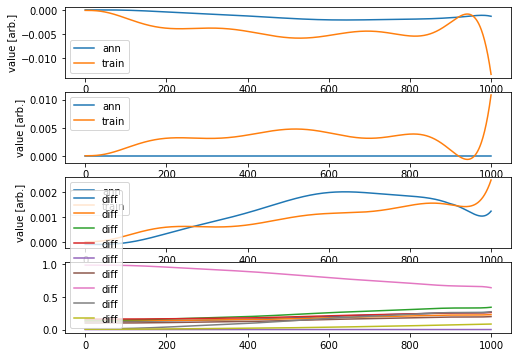

Validation loss: 15.955519564840685
Testing loss: 19.037753530072962


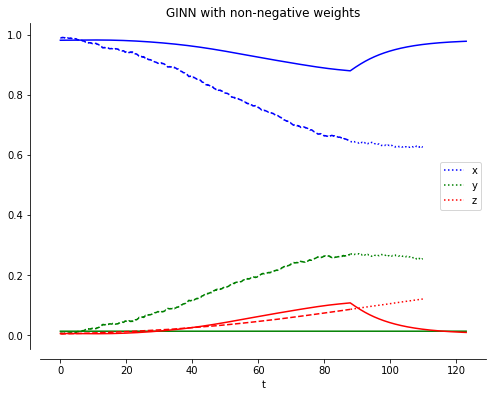

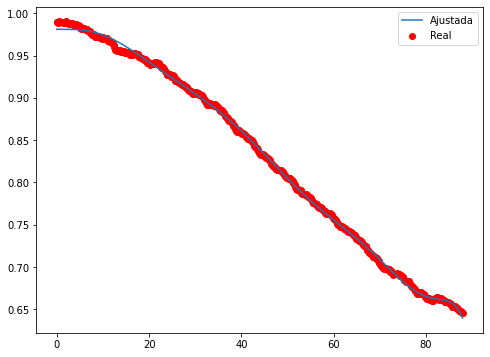

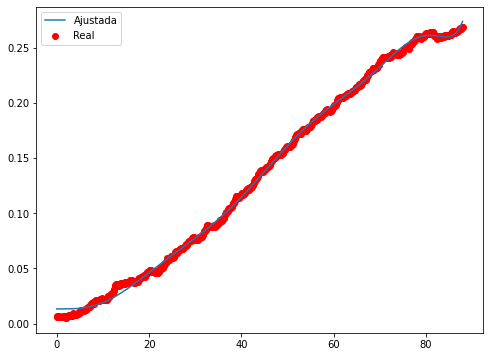

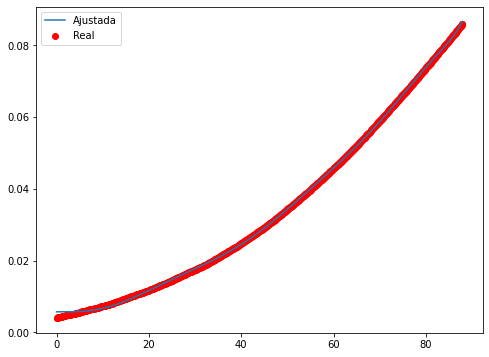

Epoch 1/500
32/32 - 2s - loss: 0.1679 - 2s/epoch - 51ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0182 - 89ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0026 - 89ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 7.6408e-04 - 112ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 4.0377e-04 - 91ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 3.0806e-04 - 89ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 2.7064e-04 - 103ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 2.4790e-04 - 73ms/epoch - 2ms/step
Epoch 9/500
32/32 - 0s - loss: 2.2763e-04 - 86ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 2.0764e-04 - 89ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 1.8850e-04 - 87ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 1.6989e-04 - 89ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 1.5339e-04 - 86ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 1.3923e-04 - 89ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 1.2722e-04 - 90ms/epoch - 3ms/step
Epoch 16/500
32

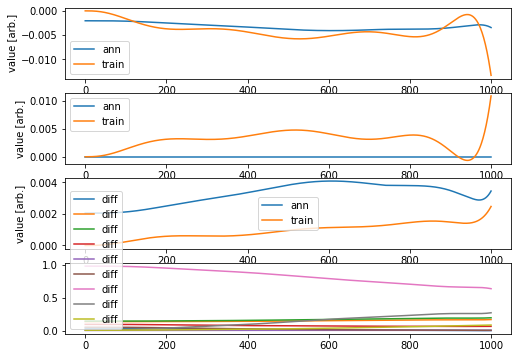

Validation loss: 11.154470350733877
Testing loss: 11.386221834681429


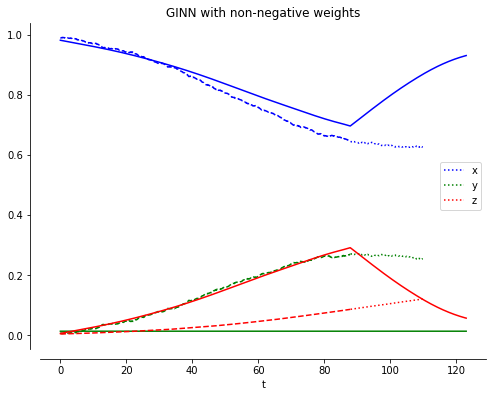

____________________________
Iteración =  22
Min =  0.06989518180235846
[[0, 1, 0, 0, 0, 1], [0, 1, 1, 0, 1, 0], [0, 1, 0, 0, 0, 1], [0, 1, 0, 1, 0, 1], [0, 1, 0, 1, 0, 1]]
[0.06989518180235846, 0.14073881611792677, 0.14698108422783035, 0.19181782186003887, 0.11435697095573708]
[0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846]


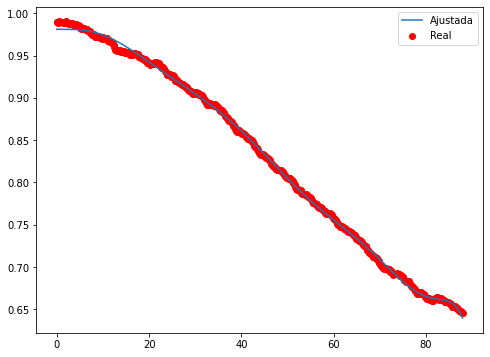

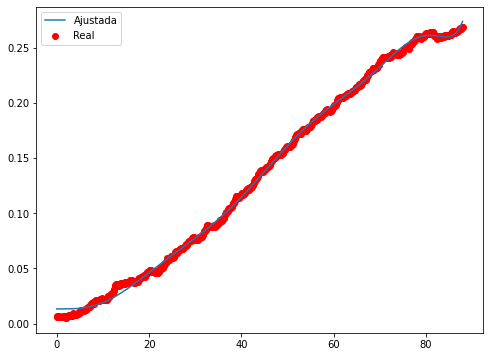

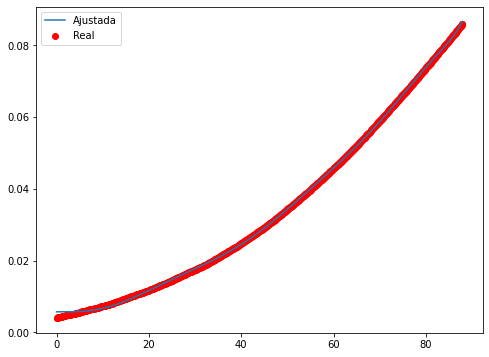

Epoch 1/500
32/32 - 1s - loss: 0.7432 - 1s/epoch - 36ms/step
Epoch 2/500
32/32 - 0s - loss: 0.1070 - 92ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0223 - 90ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0078 - 109ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0042 - 93ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0030 - 91ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 0.0025 - 93ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 0.0022 - 88ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 0.0020 - 89ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 0.0018 - 91ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 0.0016 - 77ms/epoch - 2ms/step
Epoch 12/500
32/32 - 0s - loss: 0.0014 - 86ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 0.0012 - 96ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 0.0011 - 97ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 9.8977e-04 - 106ms/epoch - 3ms/step
Epoch 16/500
32/32 - 0s - loss: 8.8860e-04 - 88ms/epoch - 3

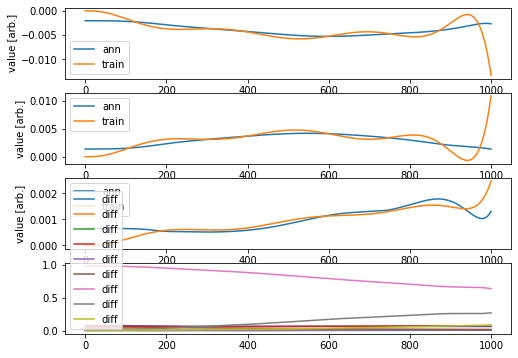

Validation loss: 0.015466755586889085
Testing loss: 0.08701173292406368


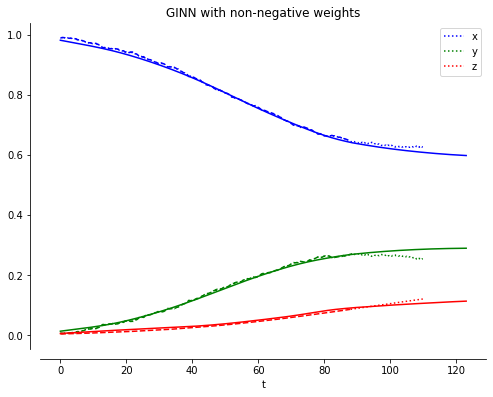

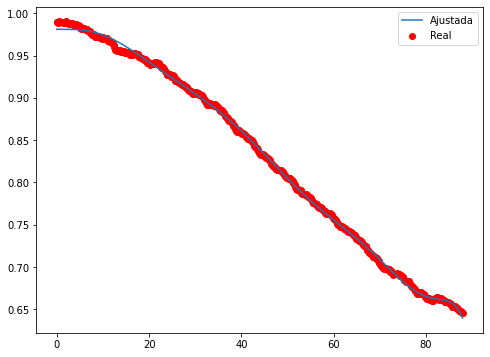

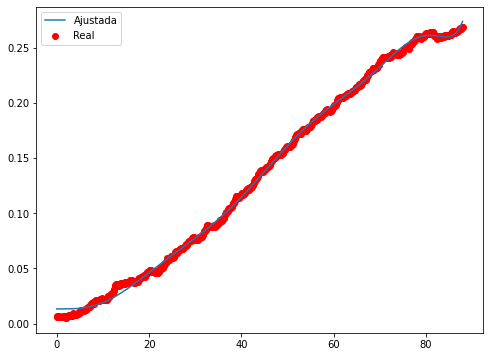

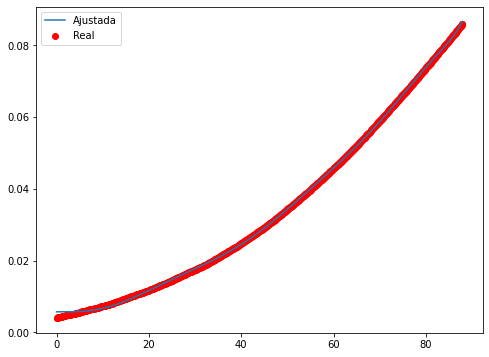

Epoch 1/500
32/32 - 1s - loss: 0.6418 - 1s/epoch - 36ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0804 - 101ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0149 - 90ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0050 - 89ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0027 - 105ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0020 - 90ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 0.0017 - 89ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 0.0015 - 99ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 0.0013 - 96ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 0.0011 - 86ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 0.0010 - 91ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 8.7816e-04 - 99ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 7.6620e-04 - 91ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 6.6620e-04 - 92ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 5.7829e-04 - 91ms/epoch - 3ms/step
Epoch 16/500
32/32 - 0s - loss: 5.0120e-04 - 11

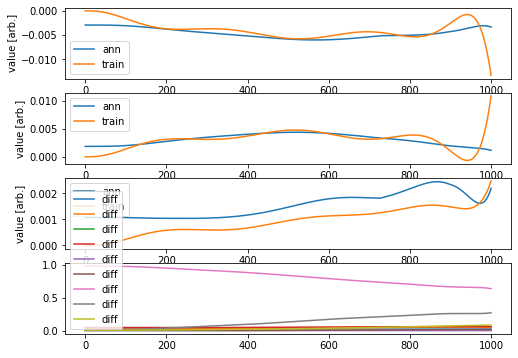

Validation loss: 0.834321778753898
Testing loss: 0.6521477101660443


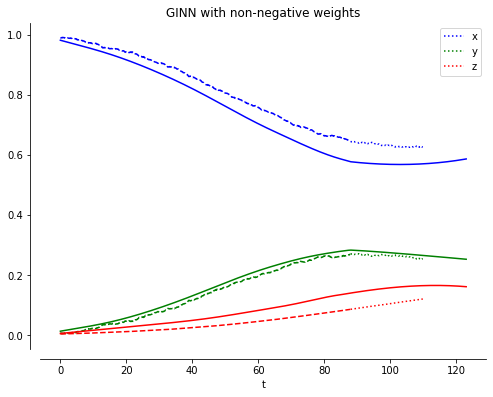

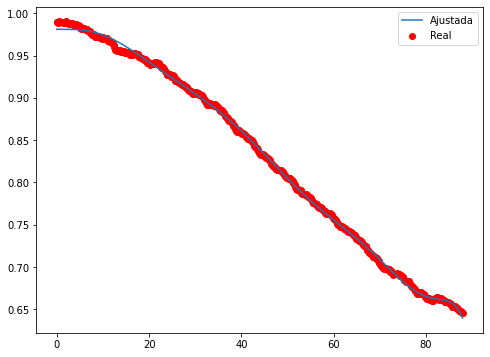

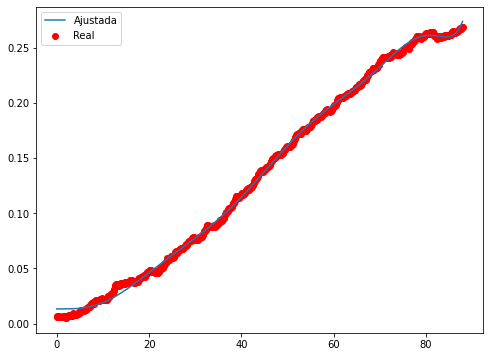

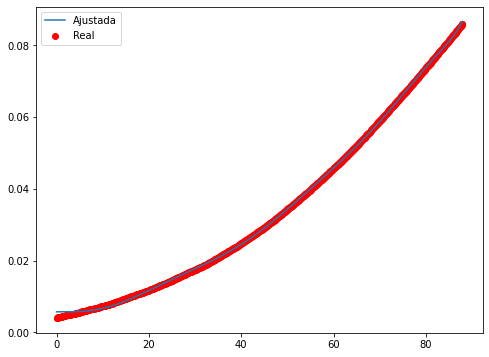

Epoch 1/500
32/32 - 2s - loss: 0.7919 - 2s/epoch - 61ms/step
Epoch 2/500
32/32 - 0s - loss: 0.1239 - 96ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0290 - 106ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0102 - 97ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0054 - 107ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0038 - 96ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 0.0031 - 118ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 0.0028 - 99ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 0.0025 - 115ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 0.0023 - 106ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 0.0021 - 112ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 0.0019 - 97ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 0.0017 - 115ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 0.0015 - 111ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 0.0013 - 101ms/epoch - 3ms/step
Epoch 16/500
32/32 - 0s - loss: 0.0011 - 94ms/epoch - 3m

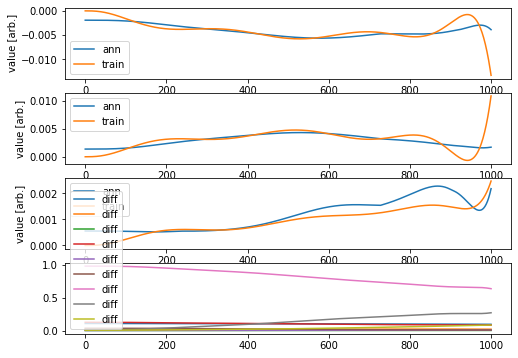

Validation loss: 0.08536857818084875
Testing loss: 0.1915999964667674


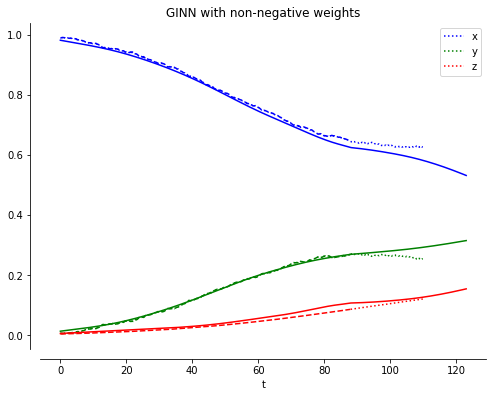

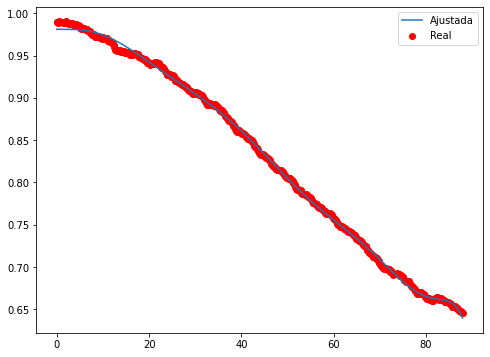

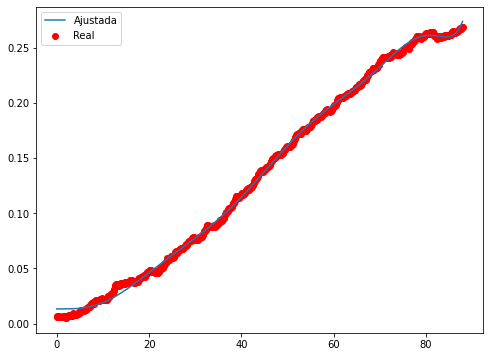

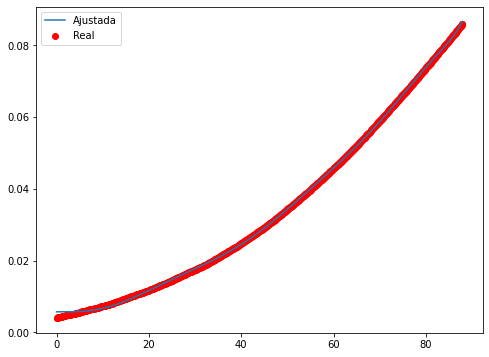

Epoch 1/500
32/32 - 1s - loss: 0.4201 - 1s/epoch - 39ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0422 - 104ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0060 - 93ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0020 - 103ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0013 - 102ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0011 - 101ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 9.8235e-04 - 99ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 8.6011e-04 - 91ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 7.5440e-04 - 109ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 6.6131e-04 - 95ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 5.7727e-04 - 109ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 5.0533e-04 - 98ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 4.4293e-04 - 101ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 3.8814e-04 - 105ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 3.4042e-04 - 82ms/epoch - 3ms/step
Epoch 16/500
32/32 - 

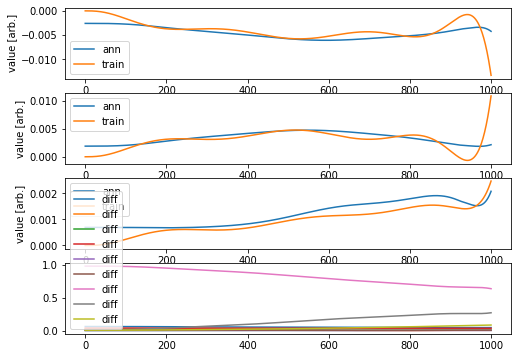

Validation loss: 11.491008475744453
Testing loss: 26.0961089858696


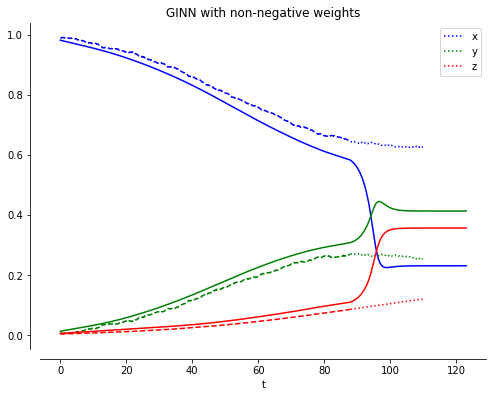

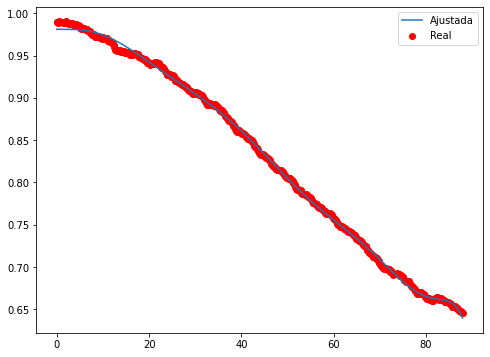

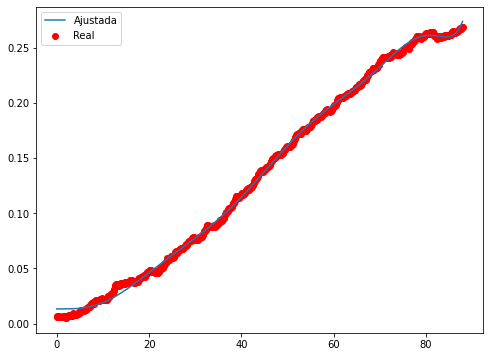

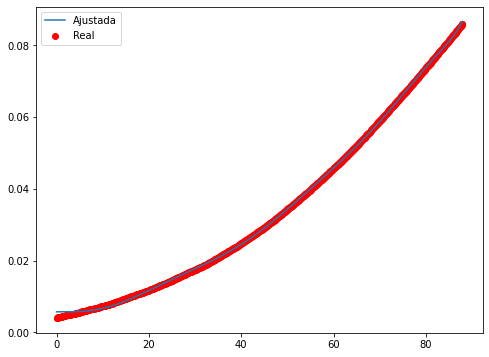

Epoch 1/500
32/32 - 1s - loss: 0.5966 - 1s/epoch - 36ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0577 - 94ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0098 - 90ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0038 - 96ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0024 - 86ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0019 - 89ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 0.0017 - 85ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 0.0015 - 87ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 0.0013 - 87ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 0.0012 - 91ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 0.0010 - 93ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 9.1632e-04 - 97ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 8.0523e-04 - 88ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 7.0411e-04 - 97ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 6.1282e-04 - 77ms/epoch - 2ms/step
Epoch 16/500
32/32 - 0s - loss: 5.3244e-04 - 86ms

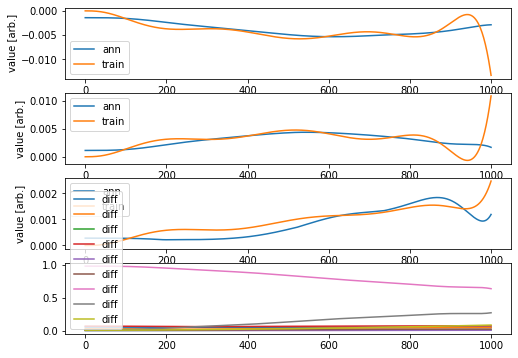

Validation loss: 0.05229167608131679
Testing loss: 0.21155734474249896


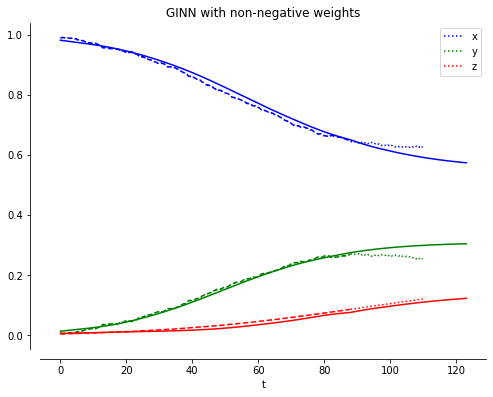

____________________________
Iteración =  23
Min =  0.06989518180235846
[[0, 1, 0, 0, 0, 1], [0, 1, 1, 0, 1, 0], [0, 1, 0, 0, 0, 1], [0, 1, 0, 1, 0, 1], [0, 1, 0, 1, 0, 1]]
[0.06989518180235846, 0.14073881611792677, 0.14698108422783035, 0.19181782186003887, 0.11435697095573708]
[0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846]


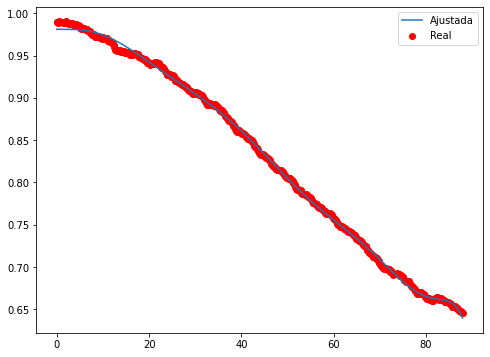

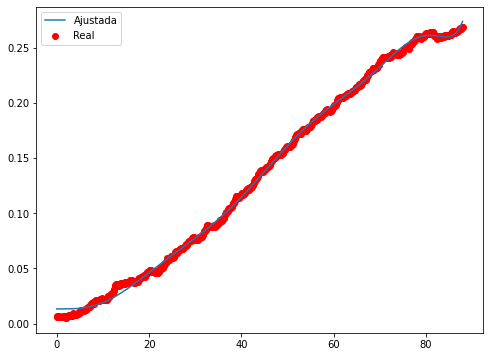

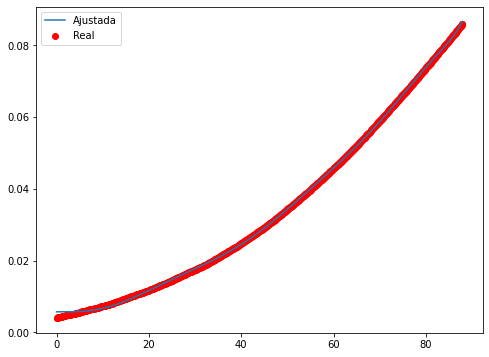

Epoch 1/500
32/32 - 1s - loss: 0.0642 - 1s/epoch - 37ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0048 - 84ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 7.0608e-04 - 98ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 3.4160e-04 - 106ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 2.7767e-04 - 101ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 2.4729e-04 - 87ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 2.2180e-04 - 87ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 1.9726e-04 - 95ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 1.7407e-04 - 94ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 1.5581e-04 - 98ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 1.3929e-04 - 89ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 1.2360e-04 - 93ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 1.0914e-04 - 88ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 9.6387e-05 - 87ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 8.5661e-05 - 81ms/epoch - 3ms/step
Epoch 16/50

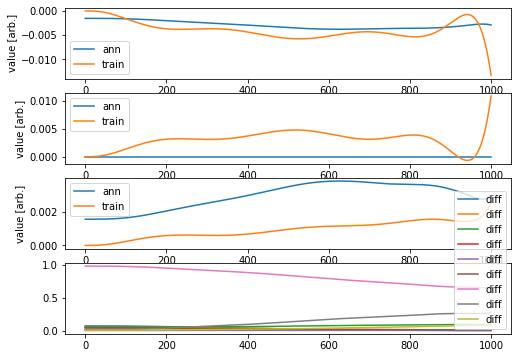

Validation loss: 11.008774422795161
Testing loss: 11.928607001746638


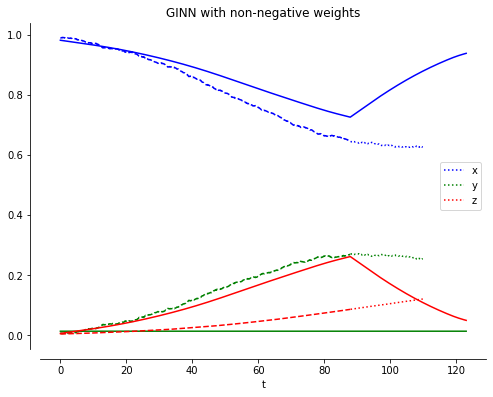

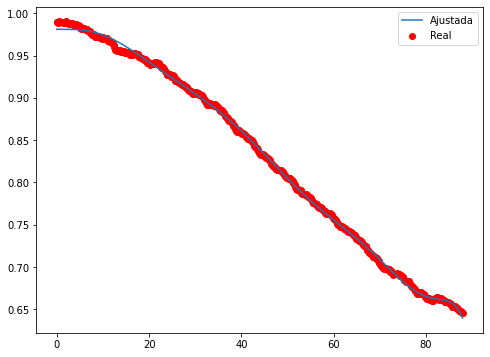

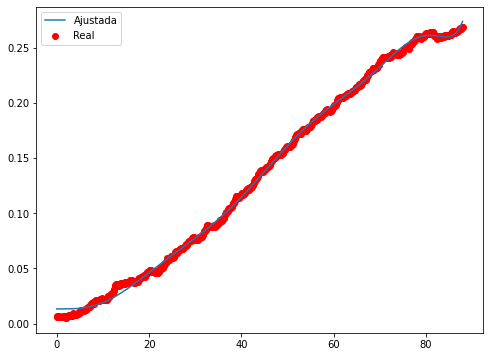

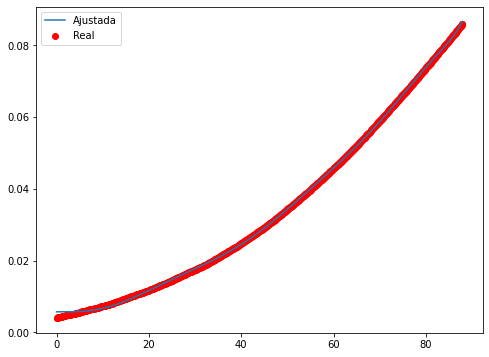

Epoch 1/500
32/32 - 1s - loss: 0.1537 - 1s/epoch - 46ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0196 - 93ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0036 - 97ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0011 - 93ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 6.2341e-04 - 90ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 4.7606e-04 - 91ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 4.1720e-04 - 91ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 3.7959e-04 - 92ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 3.5090e-04 - 94ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 3.2662e-04 - 110ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 3.0431e-04 - 96ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 2.8098e-04 - 97ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 2.5697e-04 - 86ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 2.3220e-04 - 92ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 2.0699e-04 - 90ms/epoch - 3ms/step
Epoch 16/500
32/32 -

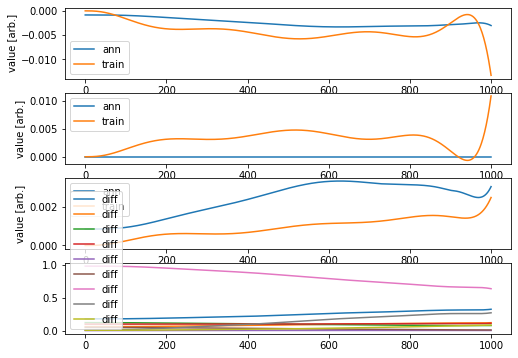

Validation loss: 11.890119350642637
Testing loss: 15.117574539030898


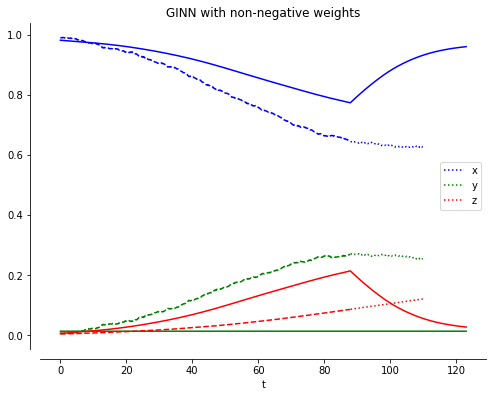

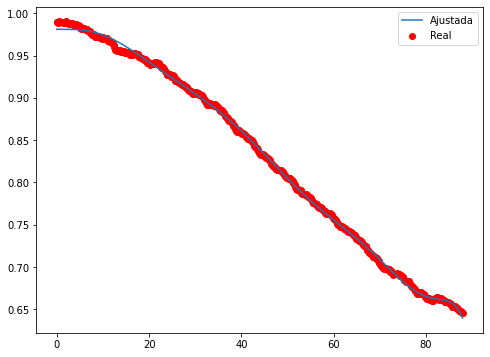

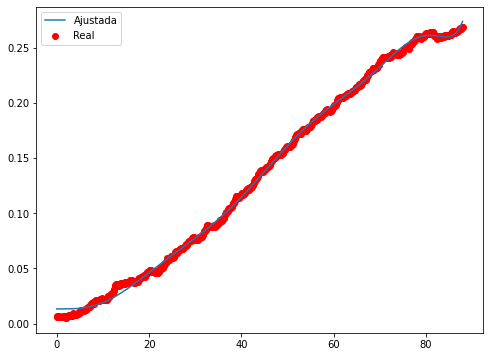

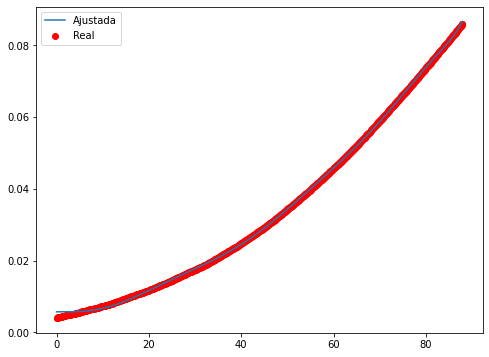

Epoch 1/500
32/32 - 1s - loss: 0.1420 - 1s/epoch - 39ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0162 - 133ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0028 - 134ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 8.8686e-04 - 110ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 5.1029e-04 - 120ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 3.9440e-04 - 130ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 3.4323e-04 - 95ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 3.0685e-04 - 93ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 2.7391e-04 - 90ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 2.4467e-04 - 88ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 2.1816e-04 - 97ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 1.9398e-04 - 106ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 1.7128e-04 - 94ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 1.4993e-04 - 91ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 1.3070e-04 - 90ms/epoch - 3ms/step
Epoch 16/50

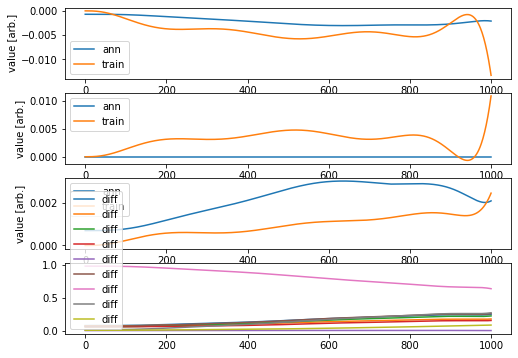

Validation loss: 11.997511817467768
Testing loss: 14.20173040895599


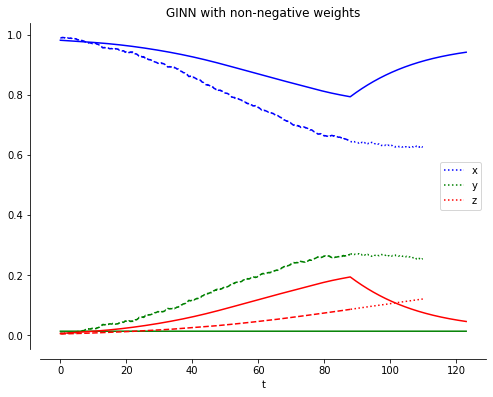

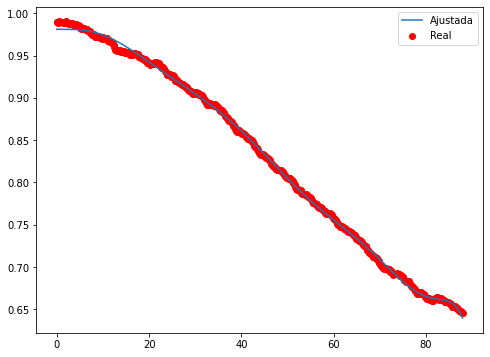

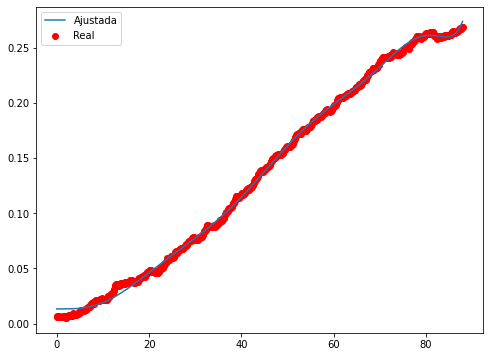

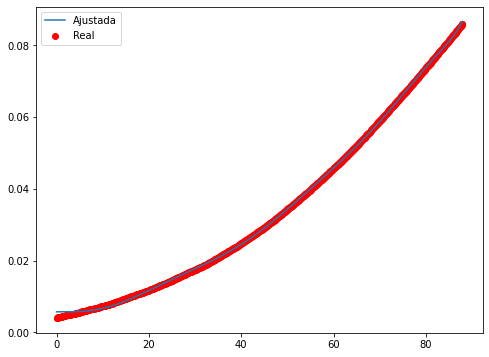

Epoch 1/500
32/32 - 1s - loss: 0.1894 - 1s/epoch - 39ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0171 - 89ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0025 - 97ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 9.0072e-04 - 92ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 5.9004e-04 - 92ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 4.9041e-04 - 99ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 4.3951e-04 - 89ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 4.0040e-04 - 90ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 3.6277e-04 - 88ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 3.2403e-04 - 101ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 2.8177e-04 - 91ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 2.3825e-04 - 89ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 1.9682e-04 - 96ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 1.5907e-04 - 91ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 1.2785e-04 - 97ms/epoch - 3ms/step
Epoch 16/500
32/

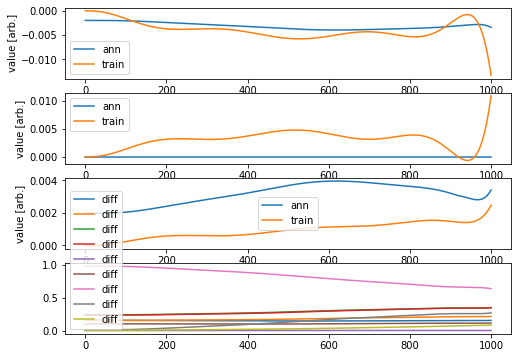

Validation loss: 11.070885108084813
Testing loss: 11.288955501639249


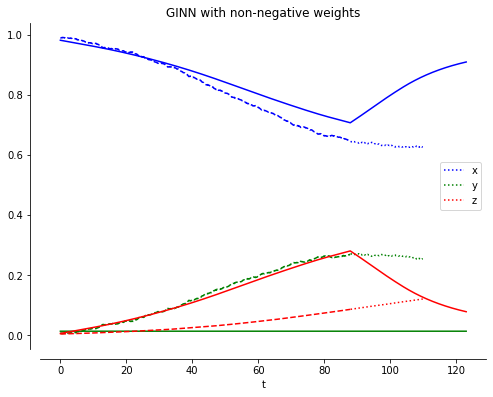

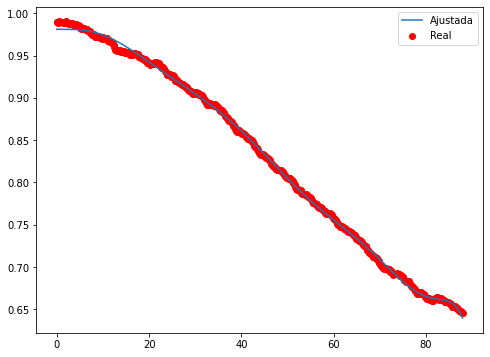

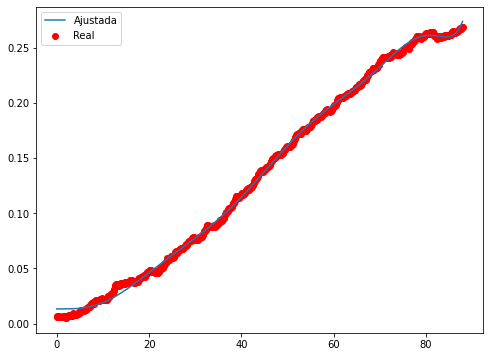

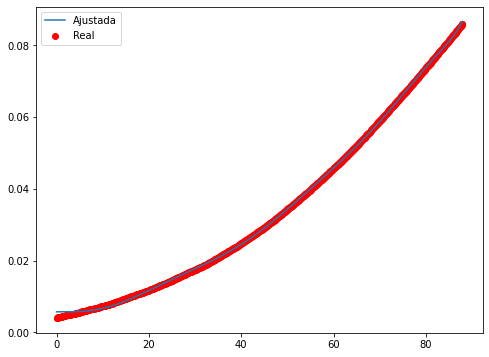

Epoch 1/500
32/32 - 1s - loss: 0.1882 - 1s/epoch - 36ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0254 - 89ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0050 - 85ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0015 - 86ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 7.4069e-04 - 95ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 5.1265e-04 - 90ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 4.3294e-04 - 91ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 3.8926e-04 - 82ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 3.5543e-04 - 96ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 3.2472e-04 - 87ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 2.9576e-04 - 102ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 2.6923e-04 - 89ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 2.4631e-04 - 89ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 2.2458e-04 - 90ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 2.0488e-04 - 90ms/epoch - 3ms/step
Epoch 16/500
32/32 -

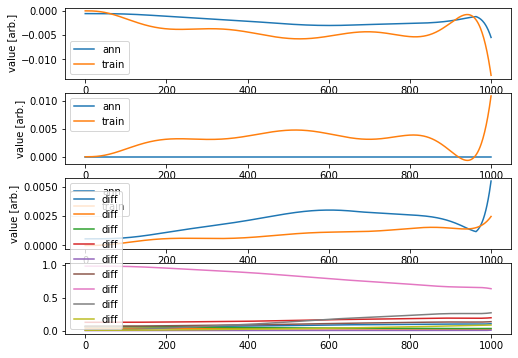

Validation loss: 12.179448404667204
Testing loss: 14.40543467784087


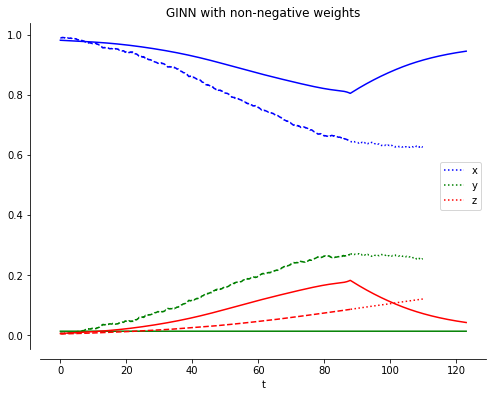

____________________________
Iteración =  24
Min =  0.06989518180235846
[[0, 1, 0, 0, 0, 1], [0, 1, 1, 0, 1, 0], [0, 1, 0, 0, 0, 1], [0, 1, 0, 1, 0, 1], [0, 1, 0, 1, 0, 1]]
[0.06989518180235846, 0.14073881611792677, 0.14698108422783035, 0.19181782186003887, 0.11435697095573708]
[0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846]


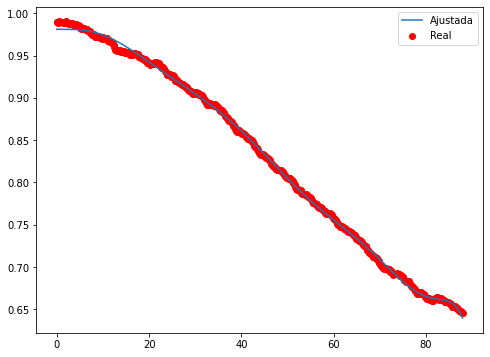

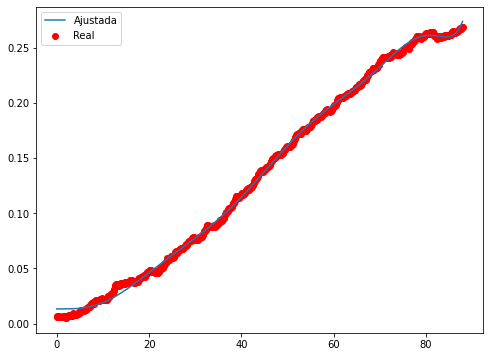

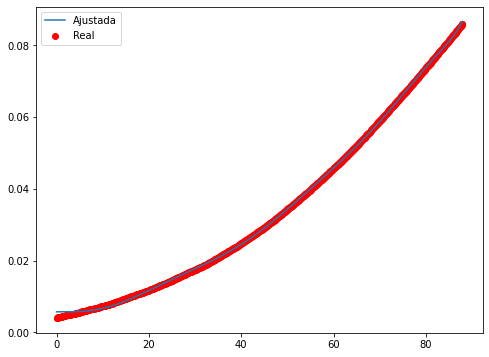

Epoch 1/500
32/32 - 1s - loss: 4.2188e-04 - 1s/epoch - 37ms/step
Epoch 2/500
32/32 - 0s - loss: 6.7405e-05 - 103ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 2.1240e-05 - 93ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 1.3350e-05 - 94ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 1.0852e-05 - 94ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 9.7266e-06 - 96ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 9.1189e-06 - 93ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 8.7461e-06 - 88ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 8.4660e-06 - 88ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 8.2381e-06 - 88ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 8.0568e-06 - 88ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 7.9114e-06 - 91ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 7.7905e-06 - 87ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 7.6937e-06 - 93ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 7.6126e-06 - 86ms/epoch - 3ms/step
Epoc

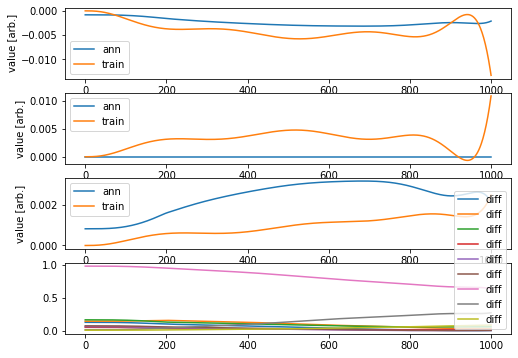

Validation loss: 16.005634589255276
Testing loss: 25.901665460079446


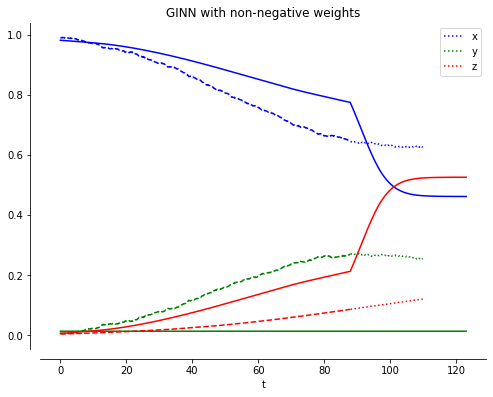

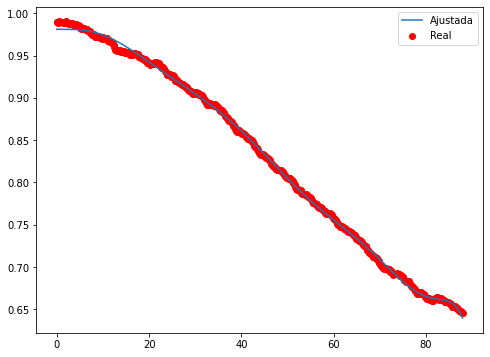

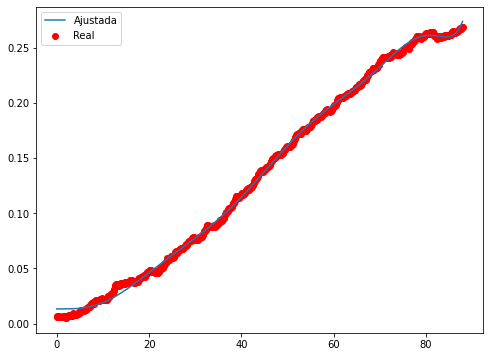

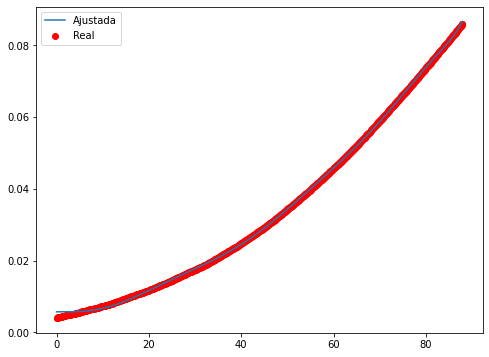

Epoch 1/500
32/32 - 1s - loss: 3.3159e-04 - 1s/epoch - 38ms/step
Epoch 2/500
32/32 - 0s - loss: 3.9712e-05 - 81ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 1.3983e-05 - 109ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 1.0237e-05 - 90ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 9.0013e-06 - 101ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 8.3519e-06 - 86ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 7.9685e-06 - 88ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 7.7185e-06 - 95ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 7.5497e-06 - 93ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 7.4216e-06 - 83ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 7.3171e-06 - 90ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 7.2333e-06 - 98ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 7.1641e-06 - 93ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 7.1055e-06 - 105ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 7.0573e-06 - 90ms/epoch - 3ms/step
Ep

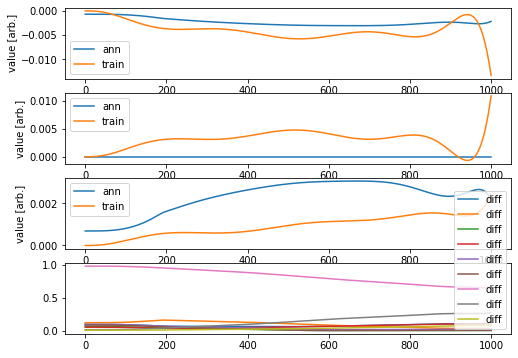

Validation loss: 28.35451406538811
Testing loss: 51.59281911327444


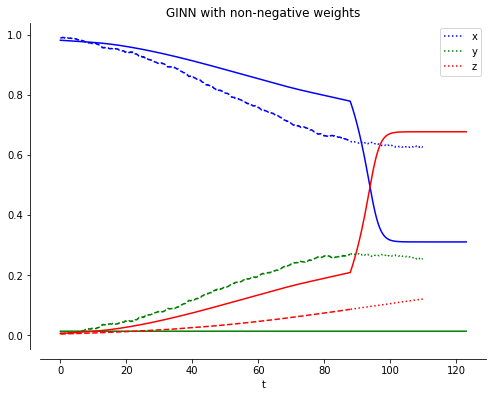

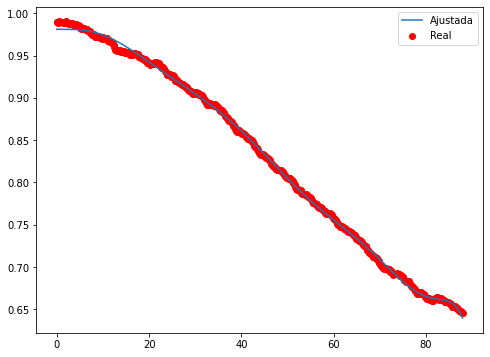

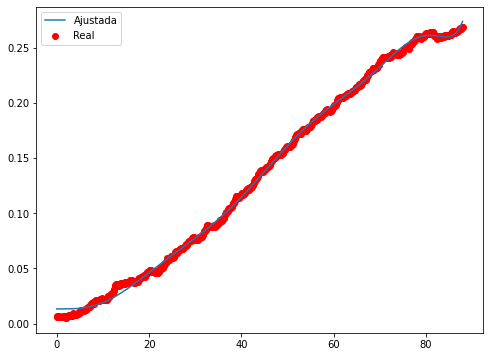

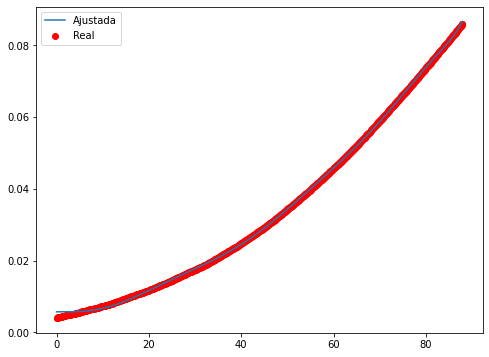

Epoch 1/500
32/32 - 1s - loss: 7.3415e-04 - 1s/epoch - 37ms/step
Epoch 2/500
32/32 - 0s - loss: 1.2807e-04 - 106ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 3.4744e-05 - 96ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 1.6103e-05 - 92ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 1.1405e-05 - 111ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 9.7975e-06 - 98ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 9.0844e-06 - 97ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 8.7199e-06 - 83ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 8.4807e-06 - 83ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 8.2852e-06 - 100ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 8.1184e-06 - 89ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 7.9819e-06 - 100ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 7.8644e-06 - 95ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 7.7614e-06 - 96ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 7.6728e-06 - 107ms/epoch - 3ms/step


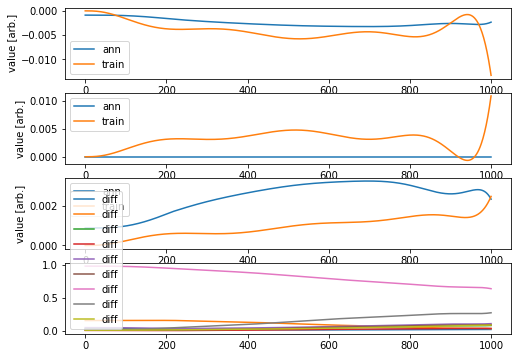

Validation loss: 17.662052170967154
Testing loss: 28.264601121585258


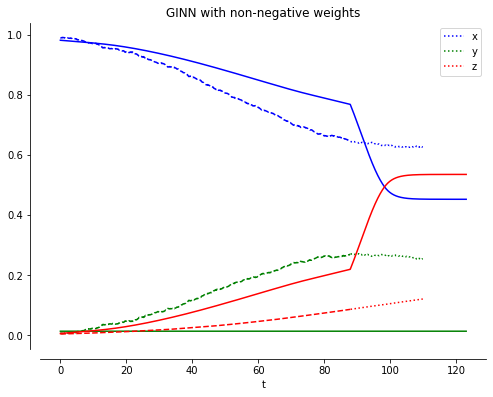

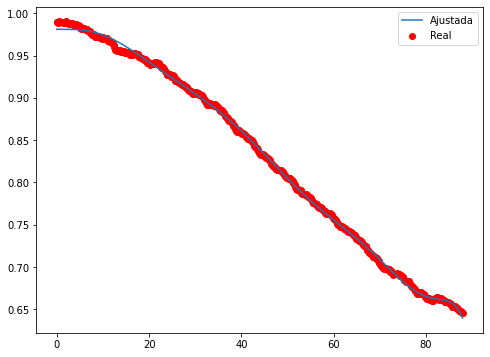

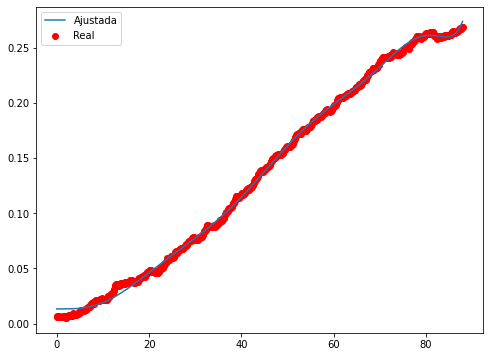

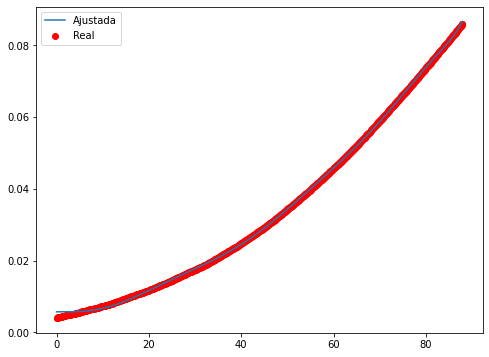

Epoch 1/500
32/32 - 1s - loss: 2.2000e-04 - 1s/epoch - 36ms/step
Epoch 2/500
32/32 - 0s - loss: 2.7877e-05 - 100ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 1.1081e-05 - 94ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 8.8510e-06 - 91ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 8.0985e-06 - 91ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 7.7203e-06 - 92ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 7.5108e-06 - 97ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 7.3668e-06 - 94ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 7.2519e-06 - 104ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 7.1647e-06 - 91ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 7.0994e-06 - 92ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 7.0512e-06 - 92ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 7.0160e-06 - 91ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 6.9895e-06 - 91ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 6.9691e-06 - 96ms/epoch - 3ms/step
Epo

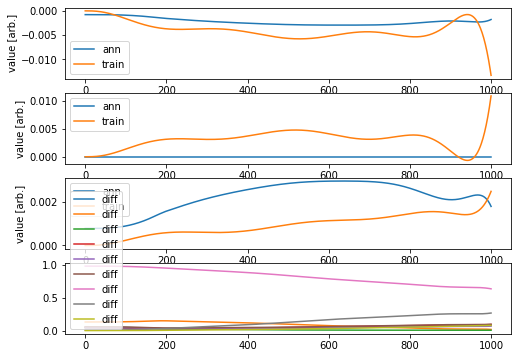

Validation loss: 20.018199207162667
Testing loss: 37.0521917062039


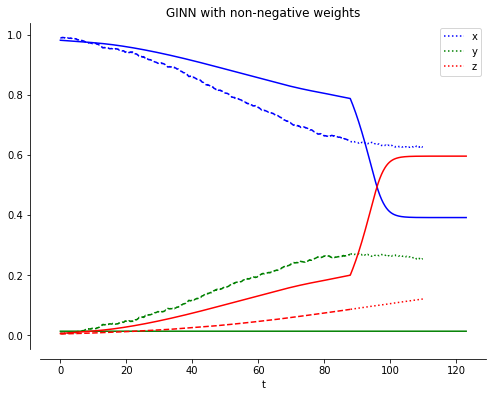

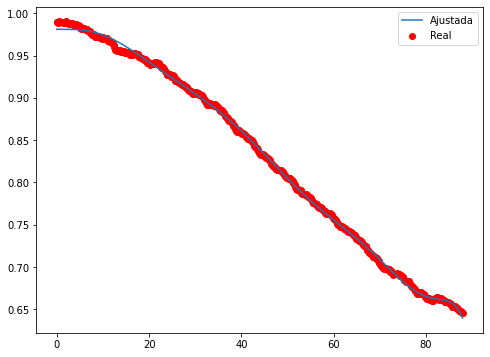

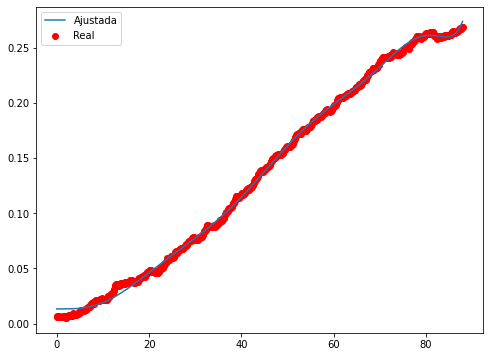

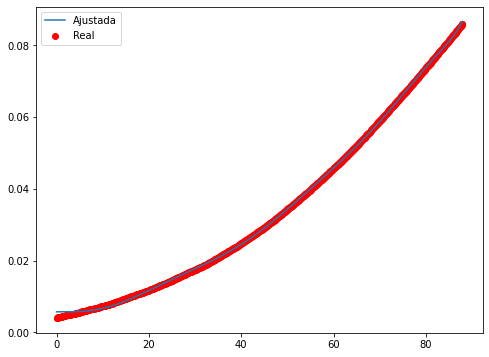

Epoch 1/500
32/32 - 1s - loss: 2.3447e-04 - 1s/epoch - 36ms/step
Epoch 2/500
32/32 - 0s - loss: 2.8081e-05 - 95ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 1.1268e-05 - 91ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 8.8525e-06 - 88ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 8.0670e-06 - 83ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 7.6719e-06 - 88ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 7.4482e-06 - 80ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 7.3067e-06 - 97ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 7.2120e-06 - 80ms/epoch - 2ms/step
Epoch 10/500
32/32 - 0s - loss: 7.1457e-06 - 85ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 7.0968e-06 - 89ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 7.0592e-06 - 87ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 7.0307e-06 - 90ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 7.0080e-06 - 93ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 6.9901e-06 - 90ms/epoch - 3ms/step
Epoch

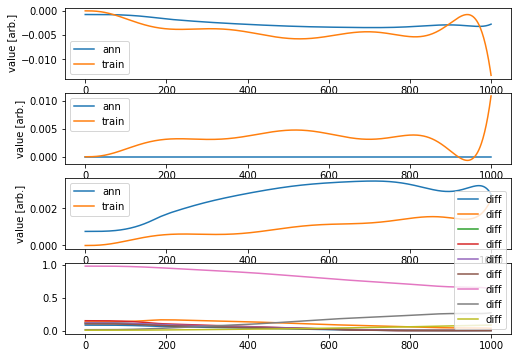

Validation loss: 25.19672776850083
Testing loss: 48.93718293974113


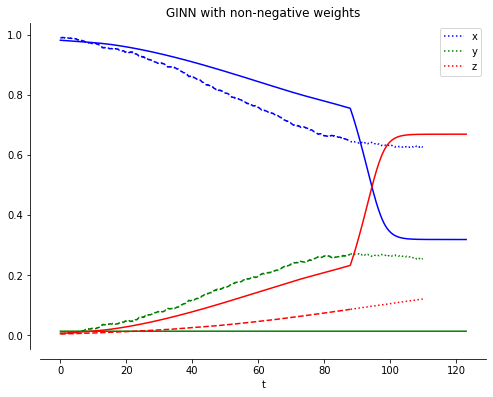

____________________________
Iteración =  25
Min =  0.06989518180235846
[[0, 1, 0, 0, 0, 1], [0, 1, 1, 0, 1, 0], [0, 1, 0, 0, 0, 1], [0, 1, 0, 1, 0, 1], [0, 1, 0, 1, 0, 1]]
[0.06989518180235846, 0.14073881611792677, 0.14698108422783035, 0.19181782186003887, 0.11435697095573708]
[0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846]


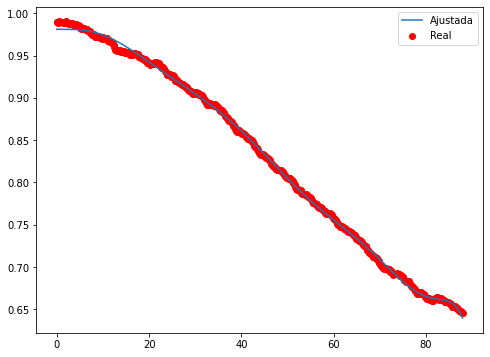

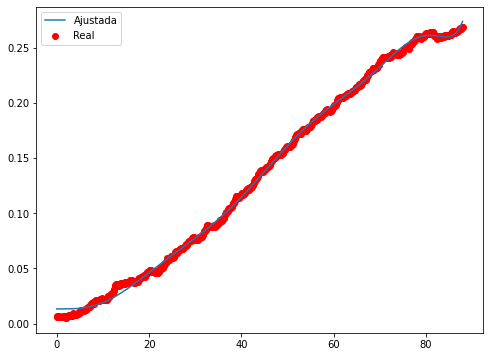

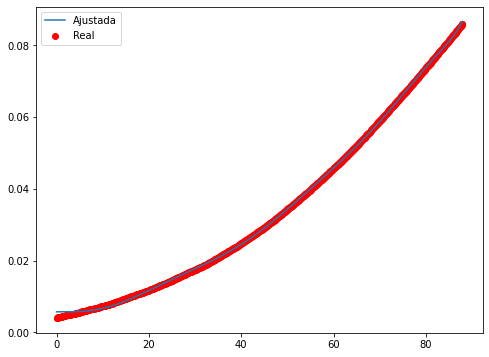

Epoch 1/500
32/32 - 1s - loss: 0.4332 - 1s/epoch - 47ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0415 - 125ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0062 - 108ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0024 - 97ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0016 - 102ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0014 - 97ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 0.0012 - 103ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 0.0010 - 93ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 8.6689e-04 - 89ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 7.4815e-04 - 94ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 6.4708e-04 - 104ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 5.6372e-04 - 101ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 4.9671e-04 - 113ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 4.3883e-04 - 100ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 3.8946e-04 - 99ms/epoch - 3ms/step
Epoch 16/500
32/32 - 0s - los

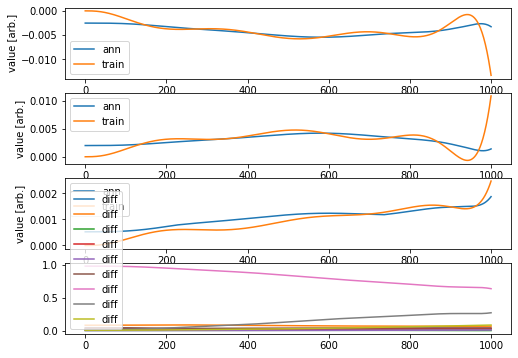

Validation loss: 0.1329484070240319
Testing loss: 0.5476510177383079


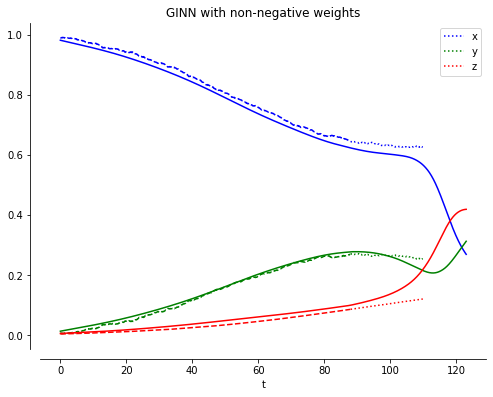

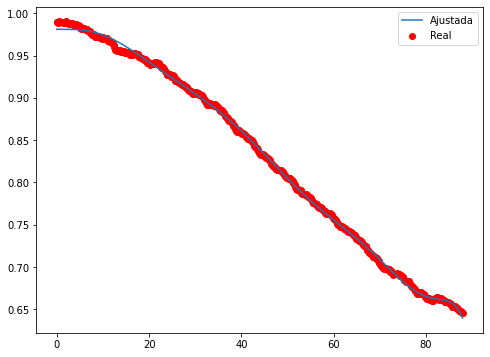

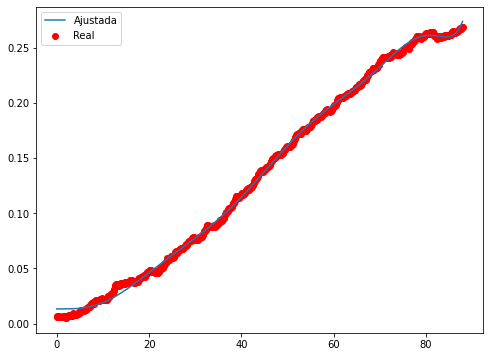

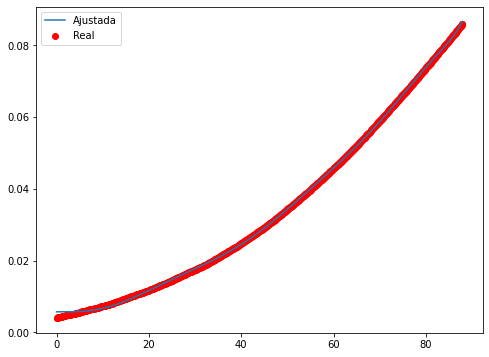

Epoch 1/500
32/32 - 2s - loss: 0.8038 - 2s/epoch - 51ms/step
Epoch 2/500
32/32 - 0s - loss: 0.1017 - 92ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0182 - 107ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0062 - 78ms/epoch - 2ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0036 - 83ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0027 - 93ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 0.0023 - 86ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 0.0020 - 87ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 0.0018 - 93ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 0.0016 - 90ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 0.0014 - 105ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 0.0012 - 94ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 0.0011 - 105ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 9.8594e-04 - 97ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 8.8442e-04 - 71ms/epoch - 2ms/step
Epoch 16/500
32/32 - 0s - loss: 7.9995e-04 - 88ms/epoc

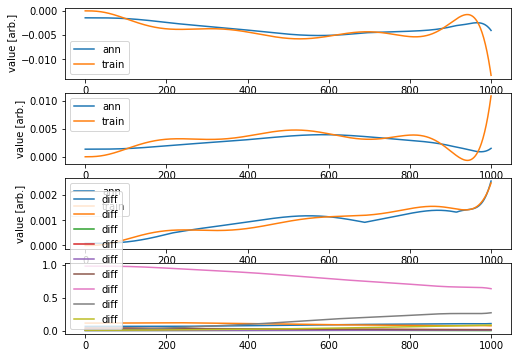

Validation loss: 0.2799989543840699
Testing loss: 0.9304831423787389


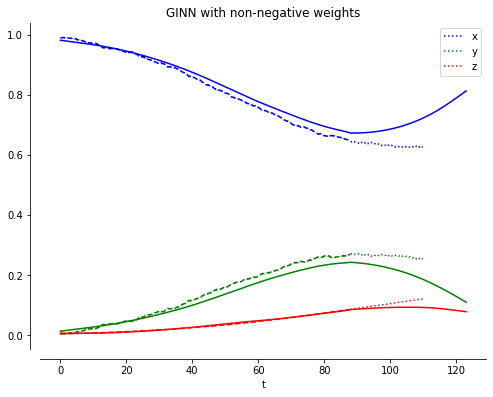

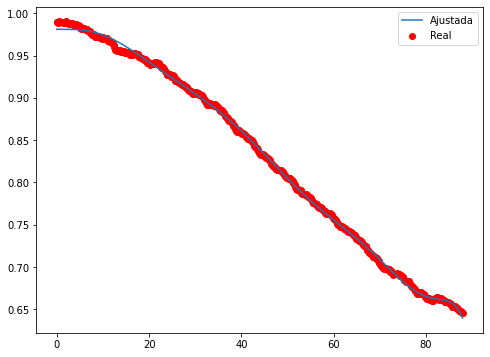

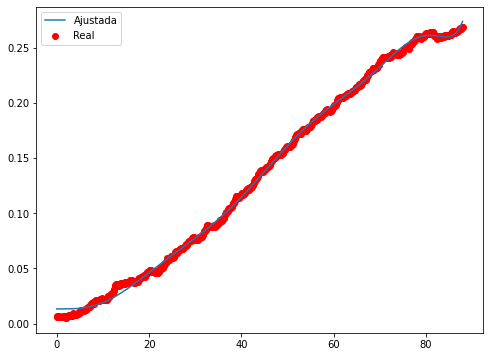

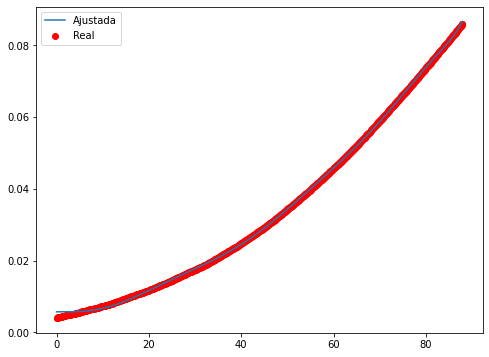

Epoch 1/500
32/32 - 2s - loss: 0.5881 - 2s/epoch - 53ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0801 - 89ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0151 - 96ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0051 - 95ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0027 - 92ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0020 - 97ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 0.0017 - 99ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 0.0015 - 84ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 0.0013 - 100ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 0.0012 - 86ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 0.0010 - 95ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 8.7626e-04 - 102ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 7.4304e-04 - 89ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 6.1777e-04 - 85ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 5.0409e-04 - 91ms/epoch - 3ms/step
Epoch 16/500
32/32 - 0s - loss: 4.0342e-04 - 98

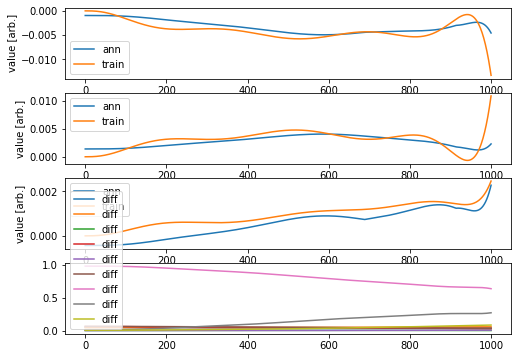

Validation loss: 0.20710364118846256
Testing loss: 2.8111684878073904


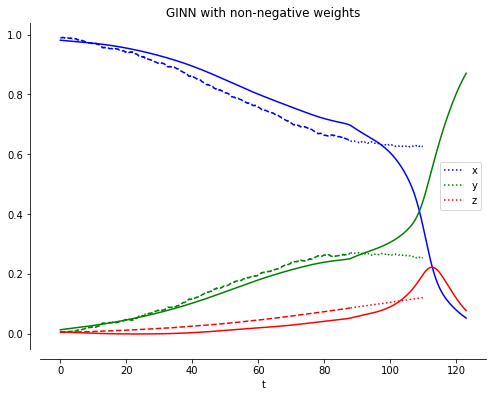

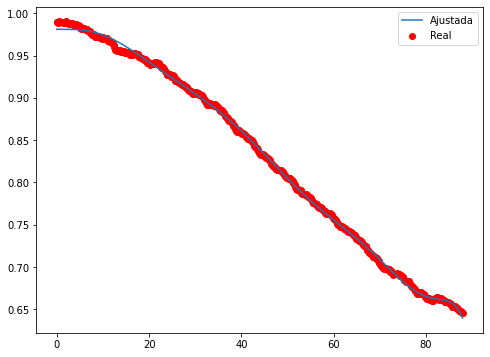

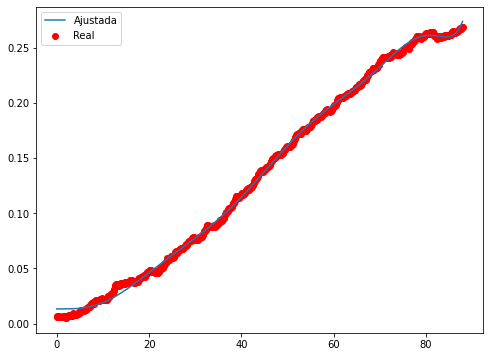

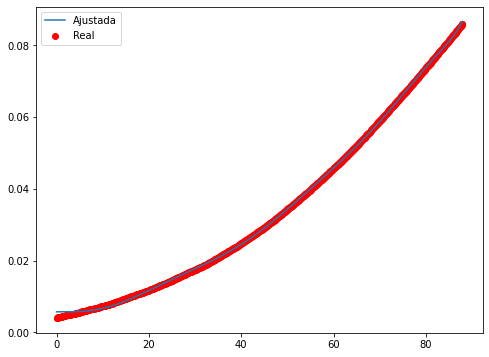

Epoch 1/500
32/32 - 2s - loss: 0.4458 - 2s/epoch - 53ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0479 - 98ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0079 - 92ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0029 - 91ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0018 - 87ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0015 - 92ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 0.0013 - 95ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 0.0011 - 89ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 9.4535e-04 - 97ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 8.1728e-04 - 92ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 7.0471e-04 - 91ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 6.0544e-04 - 86ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 5.1883e-04 - 89ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 4.4120e-04 - 85ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 3.7058e-04 - 87ms/epoch - 3ms/step
Epoch 16/500
32/32 - 0s - loss: 3.068

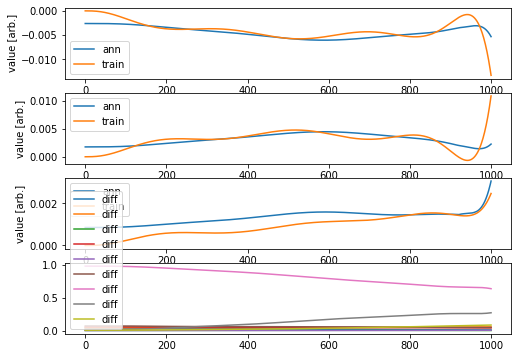

Validation loss: 2.0110828709055237
Testing loss: 15.443388305757896


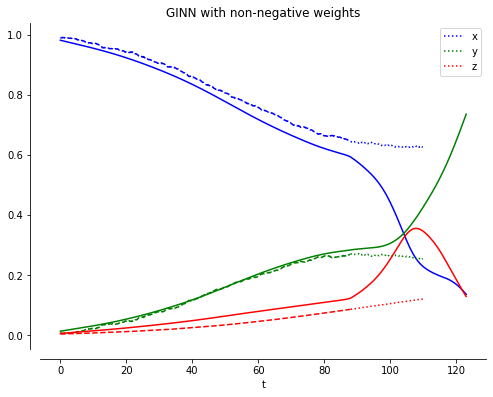

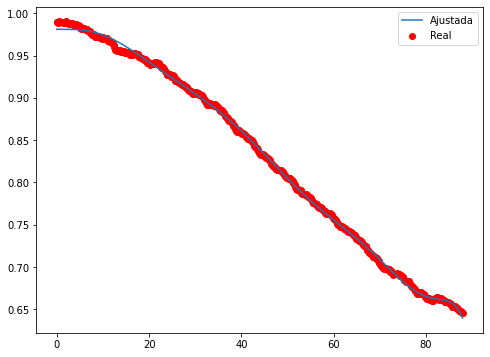

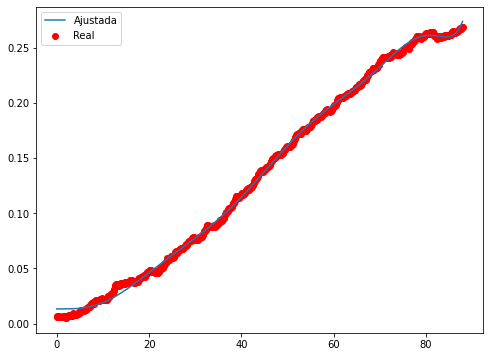

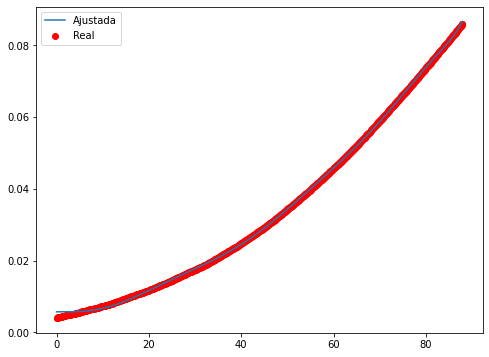

Epoch 1/500
32/32 - 2s - loss: 1.1010 - 2s/epoch - 63ms/step
Epoch 2/500
32/32 - 0s - loss: 0.1499 - 84ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0323 - 90ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0117 - 98ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0060 - 93ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0040 - 94ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 0.0031 - 81ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 0.0026 - 98ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 0.0022 - 89ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 0.0020 - 87ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 0.0018 - 88ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 0.0016 - 101ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 0.0014 - 87ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 0.0013 - 89ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 0.0012 - 87ms/epoch - 3ms/step
Epoch 16/500
32/32 - 0s - loss: 0.0011 - 96ms/epoch - 3ms/step
E

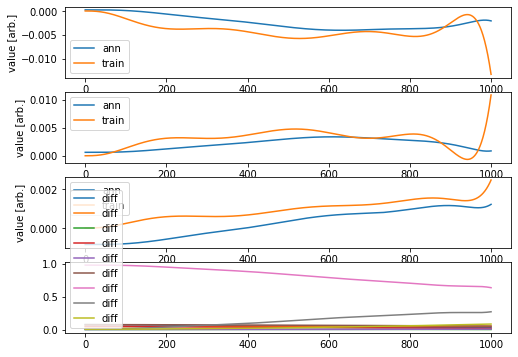

Validation loss: 1.6710276577317762
Testing loss: 0.6150394288211599


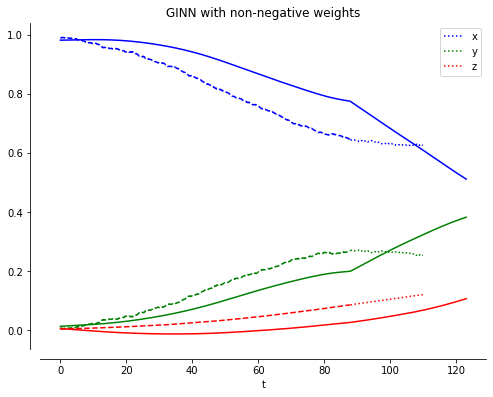

____________________________
Iteración =  26
Min =  0.06989518180235846
[[0, 1, 0, 0, 0, 1], [0, 1, 0, 0, 0, 1], [0, 1, 0, 1, 0, 1], [0, 1, 0, 1, 0, 1], [0, 1, 1, 0, 1, 0]]
[0.06989518180235846, 0.14073881611792677, 0.14698108422783035, 0.19181782186003887, 0.11435697095573708]
[0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846]


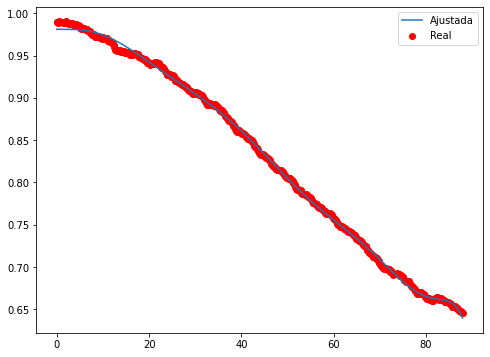

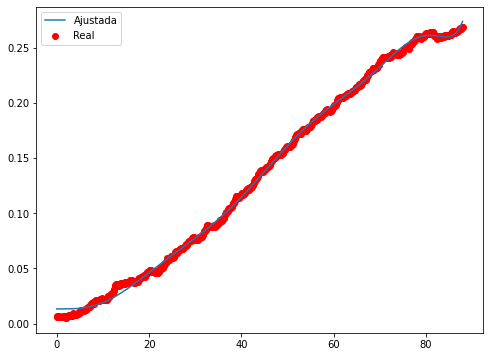

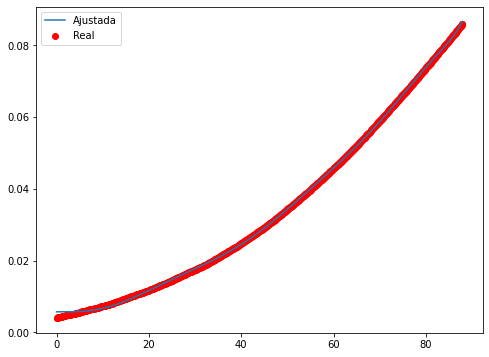

Epoch 1/500
32/32 - 2s - loss: 0.3000 - 2s/epoch - 51ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0273 - 97ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0037 - 85ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0012 - 90ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 7.1992e-04 - 101ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 5.9678e-04 - 80ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 5.3176e-04 - 86ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 4.8023e-04 - 87ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 4.3112e-04 - 91ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 3.8225e-04 - 104ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 3.3467e-04 - 91ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 2.8949e-04 - 90ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 2.4844e-04 - 99ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 2.1109e-04 - 89ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 1.7952e-04 - 87ms/epoch - 3ms/step
Epoch 16/500
32/32 

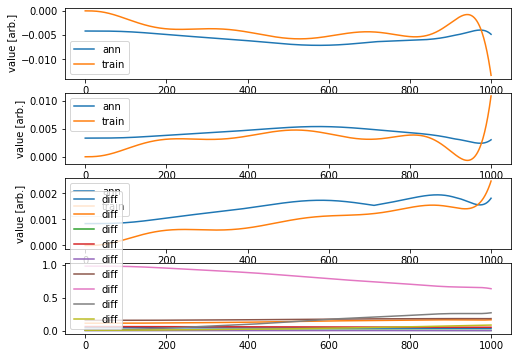

Validation loss: 20.503598818605994
Testing loss: 64.05781774509886


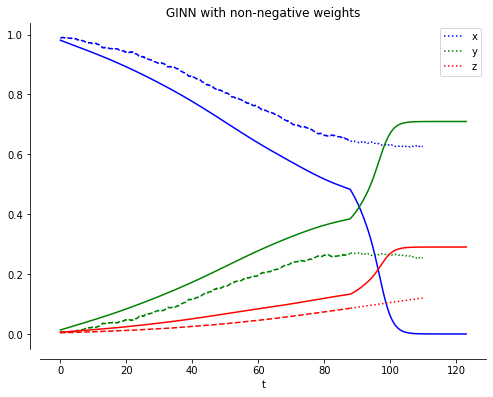

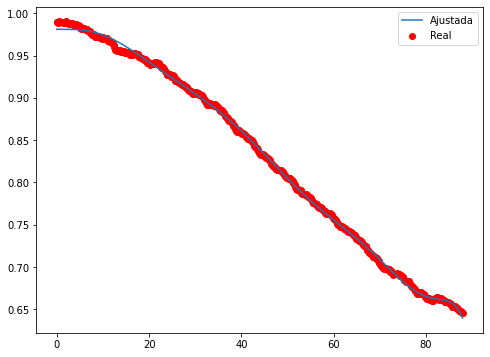

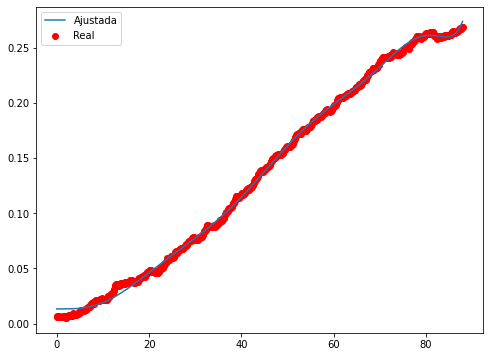

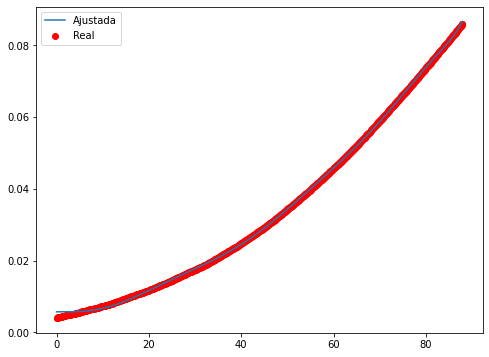

Epoch 1/500
32/32 - 2s - loss: 0.4732 - 2s/epoch - 53ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0500 - 106ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0071 - 110ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0023 - 117ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0014 - 96ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0011 - 95ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 9.7494e-04 - 94ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 8.7921e-04 - 100ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 7.9224e-04 - 94ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 7.1069e-04 - 103ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 6.4065e-04 - 124ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 5.8626e-04 - 112ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 5.3995e-04 - 121ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 4.9888e-04 - 96ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 4.6017e-04 - 99ms/epoch - 3ms/step
Epoch 16/500
32/32 - 

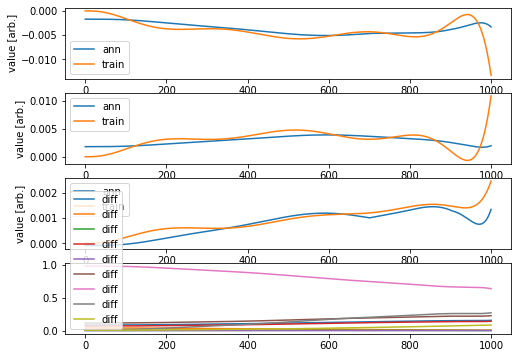

Validation loss: 0.06015837178884454
Testing loss: 0.44679472012831056


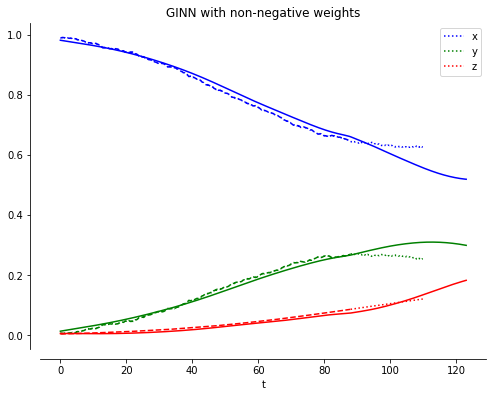

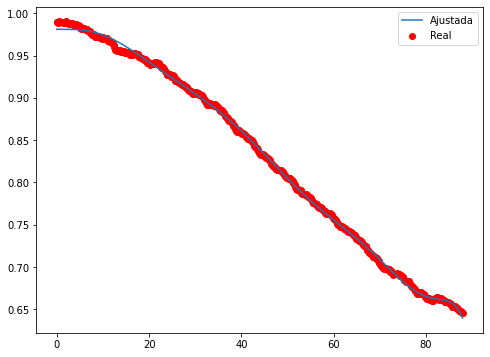

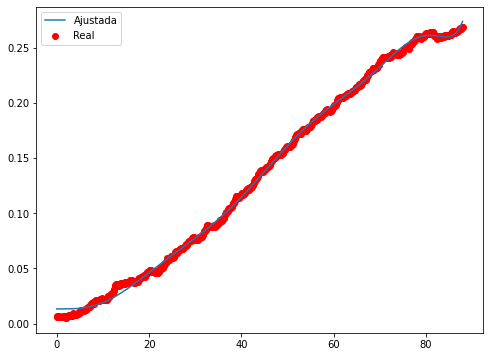

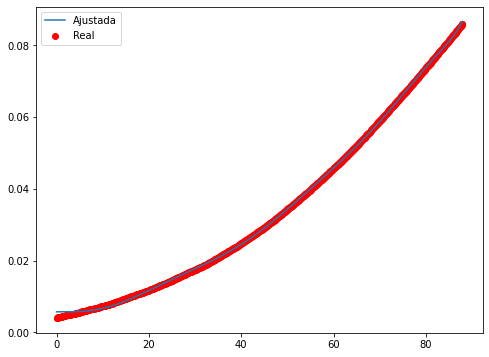

Epoch 1/500
32/32 - 2s - loss: 0.3610 - 2s/epoch - 54ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0389 - 106ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0065 - 112ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0022 - 111ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0013 - 119ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0011 - 131ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 9.4913e-04 - 114ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 8.6564e-04 - 118ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 7.9027e-04 - 117ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 7.2114e-04 - 113ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 6.5848e-04 - 114ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 6.0199e-04 - 149ms/epoch - 5ms/step
Epoch 13/500
32/32 - 0s - loss: 5.5356e-04 - 127ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 5.0556e-04 - 127ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 4.6010e-04 - 105ms/epoch - 3ms/step
Epoch 16/500
32

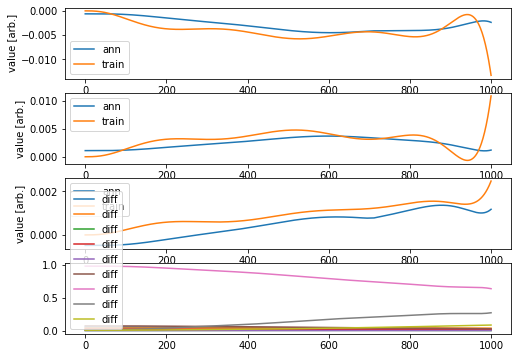

Validation loss: 0.5763114942069886
Testing loss: 0.27035582241503847


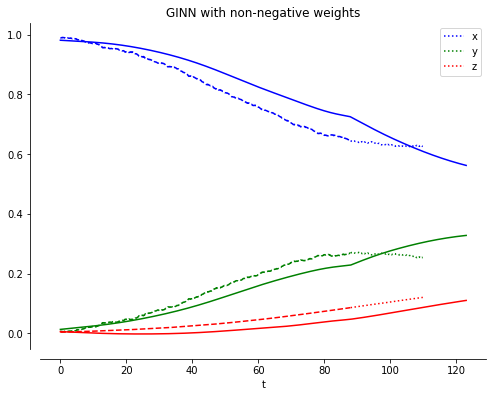

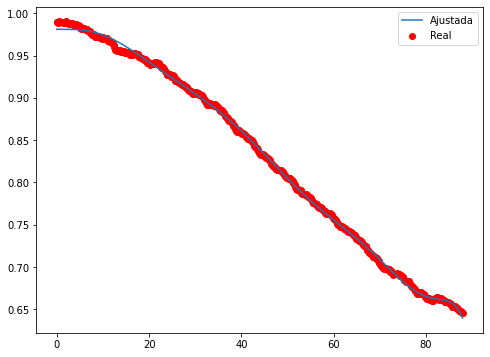

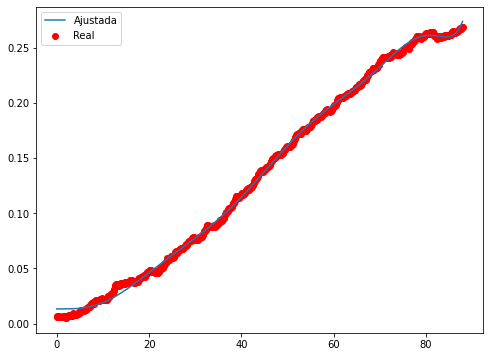

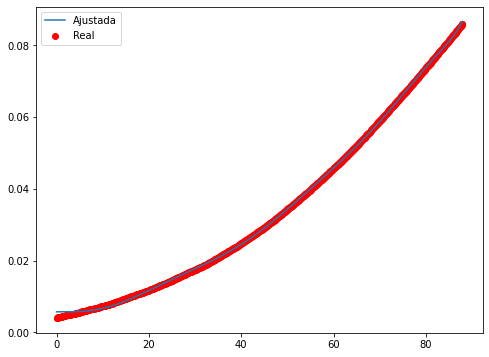

Epoch 1/500
32/32 - 2s - loss: 0.5227 - 2s/epoch - 57ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0599 - 93ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0117 - 118ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0042 - 97ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0023 - 115ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 0.0017 - 92ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 0.0015 - 103ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 0.0013 - 94ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 0.0012 - 87ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 0.0011 - 87ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 0.0010 - 87ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 9.3335e-04 - 112ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 8.3792e-04 - 102ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 7.4263e-04 - 84ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 6.4724e-04 - 94ms/epoch - 3ms/step
Epoch 16/500
32/32 - 0s - loss: 5.5691e-04 -

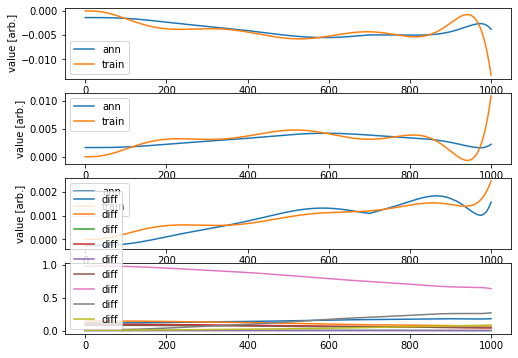

Validation loss: 0.13735053092524638
Testing loss: 1.3169123766079303


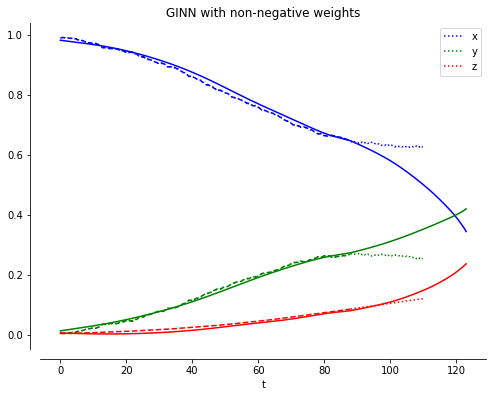

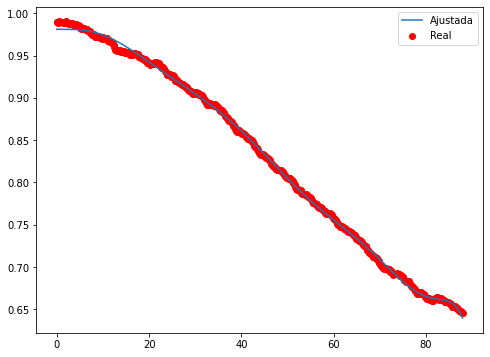

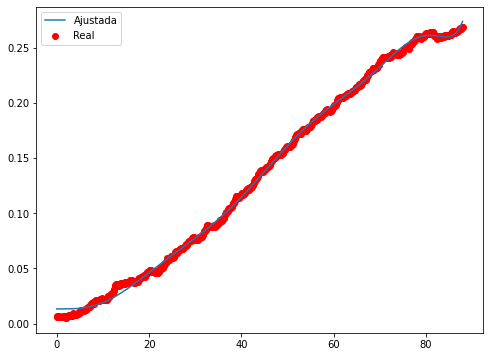

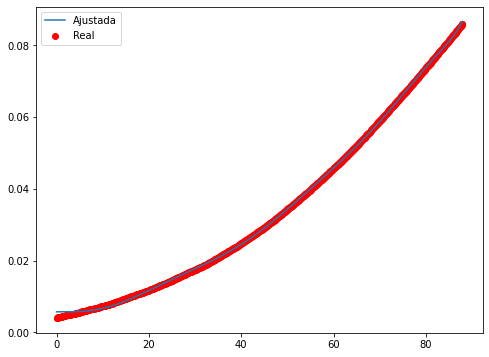

Epoch 1/500
32/32 - 2s - loss: 0.6259 - 2s/epoch - 56ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0635 - 108ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0093 - 120ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0025 - 88ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0011 - 97ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 7.4365e-04 - 110ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 6.2682e-04 - 96ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 5.6729e-04 - 105ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 5.2569e-04 - 94ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 4.8711e-04 - 106ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 4.4911e-04 - 105ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 4.1128e-04 - 110ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 3.7541e-04 - 115ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 3.4160e-04 - 120ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 3.1020e-04 - 102ms/epoch - 3ms/step
Epoch 16/500
32

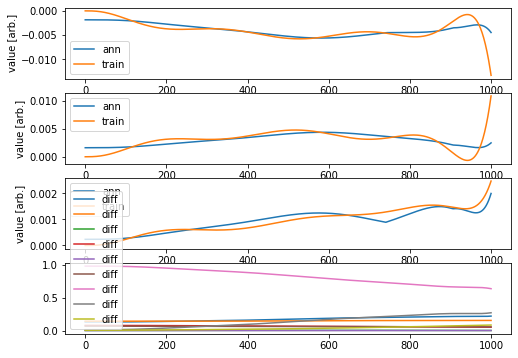

Validation loss: 0.3206139640418543
Testing loss: 24.87382643520561


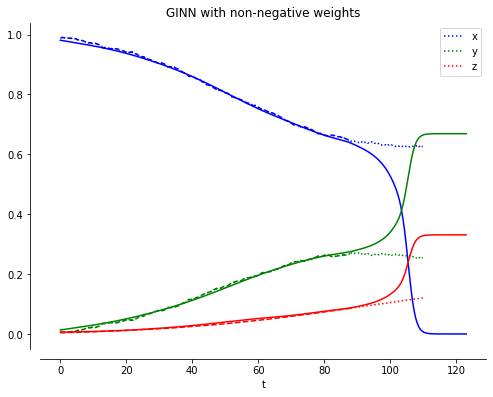

____________________________
Iteración =  27
Min =  0.06989518180235846
[[0, 1, 0, 0, 0, 1], [0, 1, 0, 0, 0, 1], [0, 1, 0, 1, 0, 1], [0, 1, 0, 1, 0, 1], [0, 1, 1, 0, 1, 0]]
[0.06989518180235846, 0.14073881611792677, 0.14698108422783035, 0.19181782186003887, 0.11435697095573708]
[0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846]


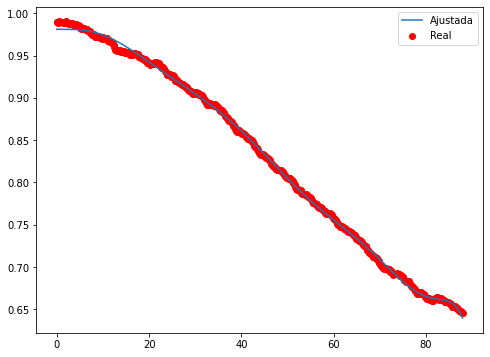

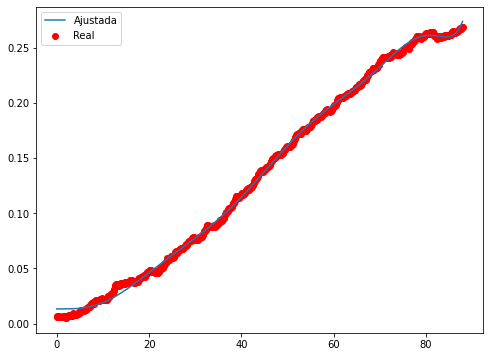

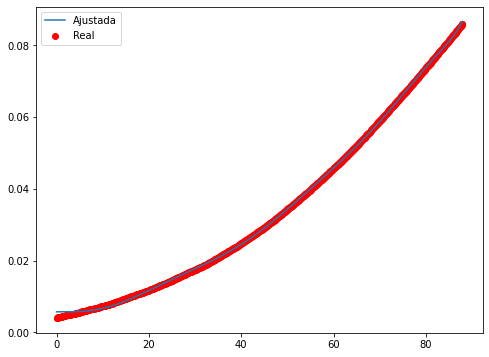

Epoch 1/500
32/32 - 2s - loss: 0.1856 - 2s/epoch - 73ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0253 - 98ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0056 - 97ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0023 - 103ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0014 - 130ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 9.8538e-04 - 99ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 7.6738e-04 - 100ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 6.2318e-04 - 125ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 5.0638e-04 - 100ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 4.1184e-04 - 99ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 3.3279e-04 - 88ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 2.6749e-04 - 99ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 2.1491e-04 - 94ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 1.7197e-04 - 98ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 1.3798e-04 - 122ms/epoch - 4ms/step
Epoch 16/500
32/32 

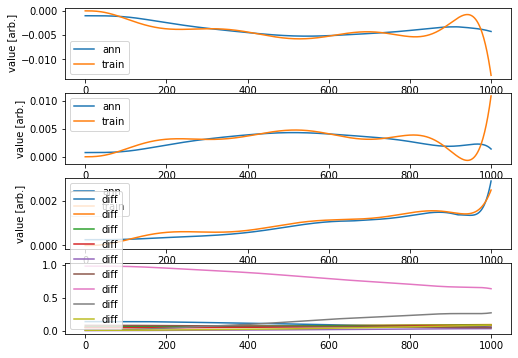

Validation loss: 0.025091249006310636
Testing loss: 0.8586724559132917


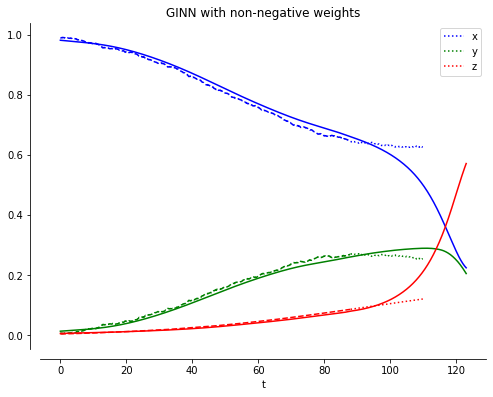

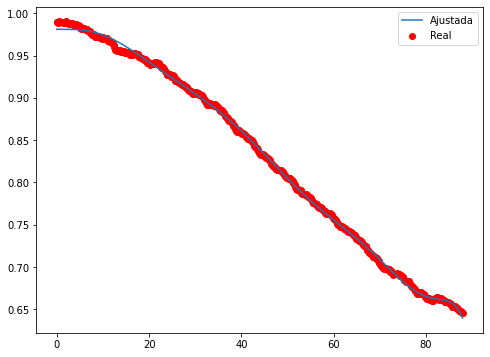

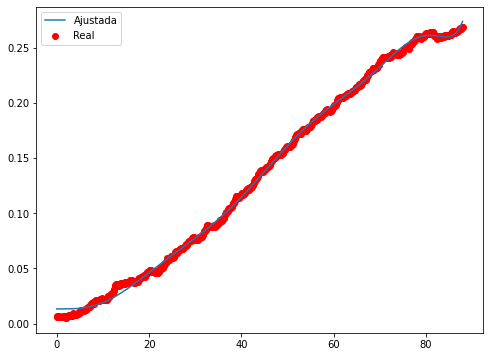

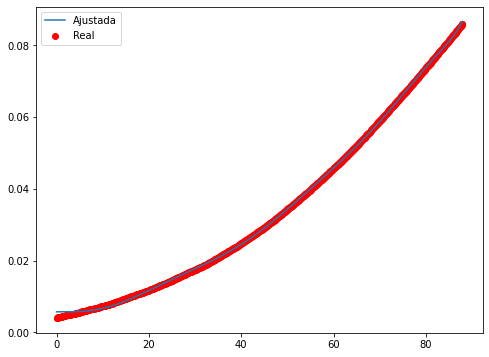

Epoch 1/500
32/32 - 2s - loss: 0.0686 - 2s/epoch - 67ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0045 - 133ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0010 - 142ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 5.8125e-04 - 118ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 4.1639e-04 - 142ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 3.2599e-04 - 105ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 2.5902e-04 - 121ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 2.0290e-04 - 145ms/epoch - 5ms/step
Epoch 9/500
32/32 - 0s - loss: 1.5704e-04 - 128ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 1.2041e-04 - 141ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 9.1882e-05 - 162ms/epoch - 5ms/step
Epoch 12/500
32/32 - 0s - loss: 7.0312e-05 - 143ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 5.4185e-05 - 143ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 4.3090e-05 - 138ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 3.5474e-05 - 122ms/epoch - 4ms/step
Epo

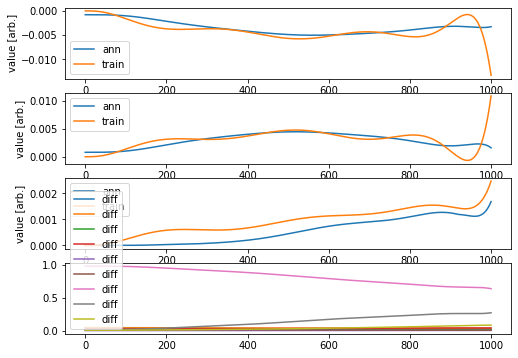

Validation loss: 0.18476146769467425
Testing loss: 0.14459459084696277


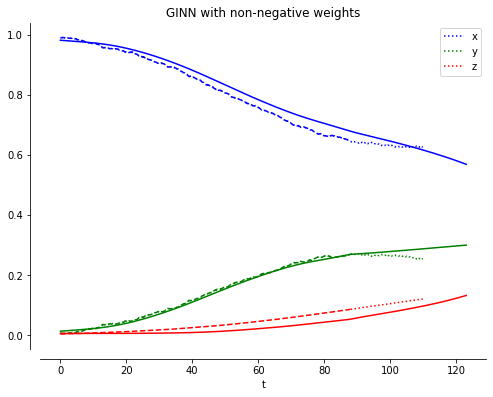

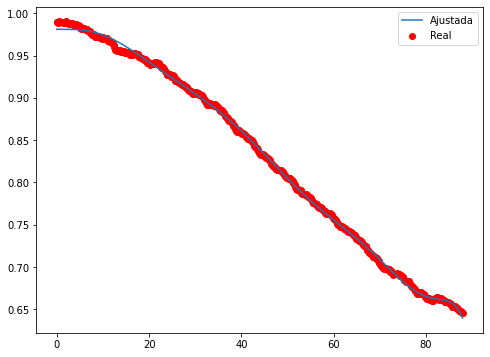

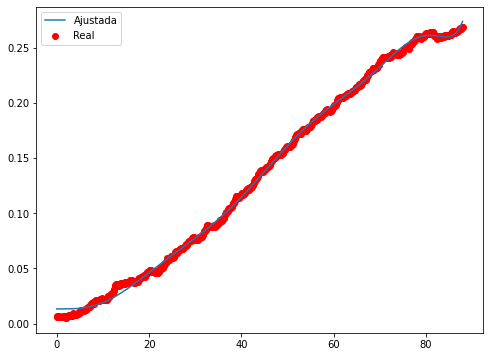

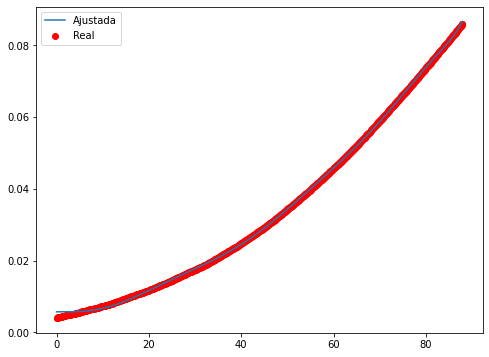

Epoch 1/500
32/32 - 2s - loss: 0.2313 - 2s/epoch - 62ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0282 - 108ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0058 - 123ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0023 - 101ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0013 - 121ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 8.9222e-04 - 110ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 6.7717e-04 - 120ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 5.3650e-04 - 113ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 4.3453e-04 - 98ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 3.5654e-04 - 107ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 2.9318e-04 - 109ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 2.4048e-04 - 123ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 1.9696e-04 - 119ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 1.6136e-04 - 148ms/epoch - 5ms/step
Epoch 15/500
32/32 - 0s - loss: 1.3213e-04 - 113ms/epoch - 4ms/step
Epoch 16/500

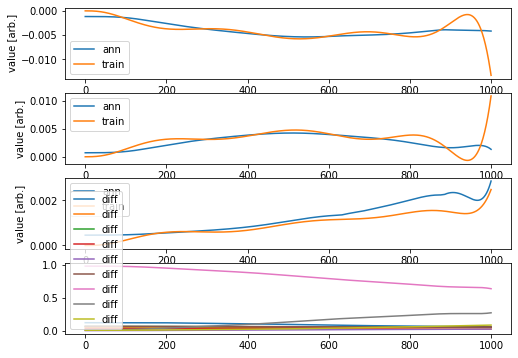

Validation loss: 0.1752367440535826
Testing loss: 0.9323770836100602


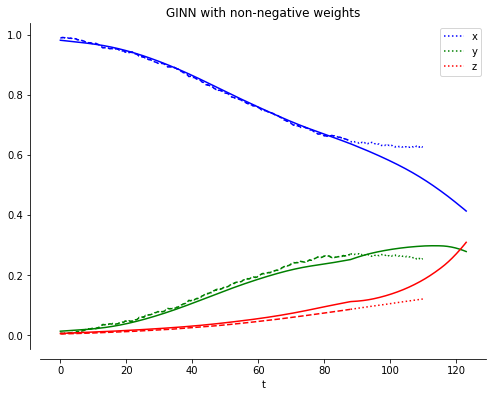

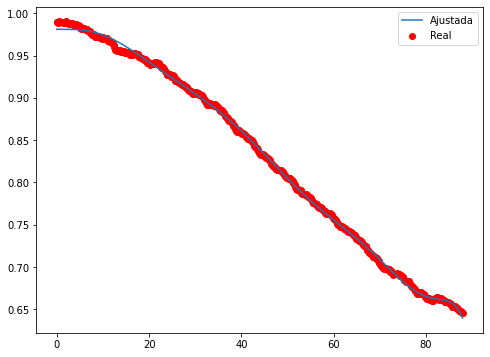

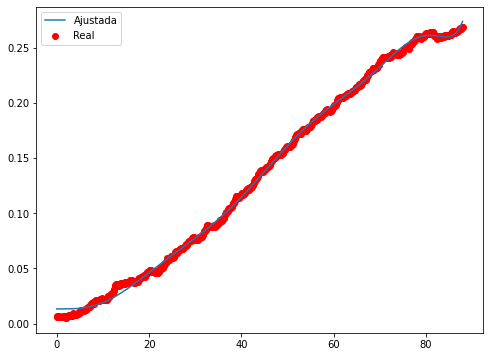

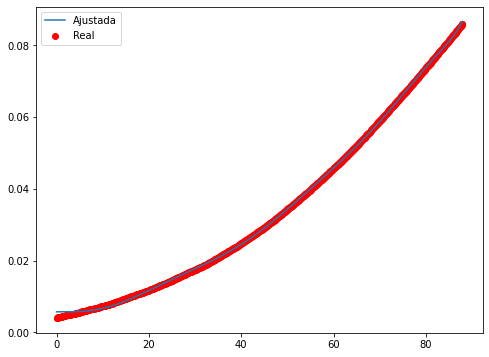

Epoch 1/500
32/32 - 2s - loss: 0.0882 - 2s/epoch - 67ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0068 - 120ms/epoch - 4ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0011 - 124ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 5.6610e-04 - 117ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 4.0536e-04 - 109ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 3.1534e-04 - 103ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 2.5422e-04 - 112ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 2.0705e-04 - 105ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 1.6885e-04 - 100ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 1.3731e-04 - 115ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 1.1176e-04 - 103ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 9.0908e-05 - 127ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 7.4362e-05 - 86ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 6.1300e-05 - 111ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 5.1137e-05 - 96ms/epoch - 3ms/step
Epoch

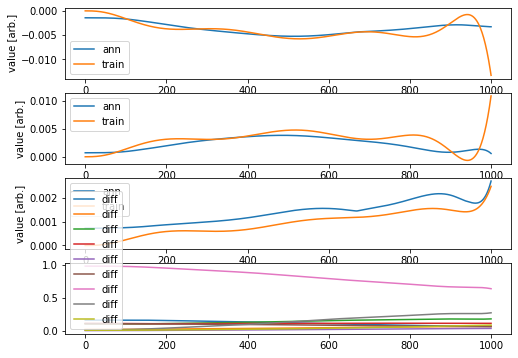

Validation loss: 0.23604253861424368
Testing loss: 0.7256393179146468


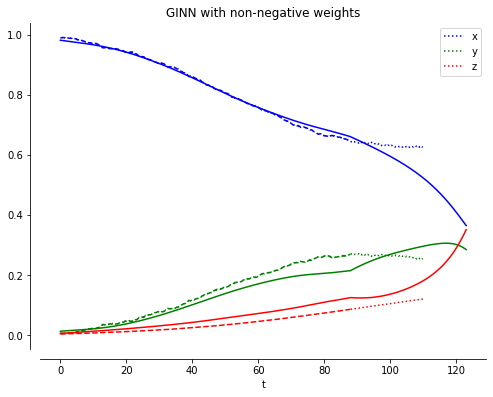

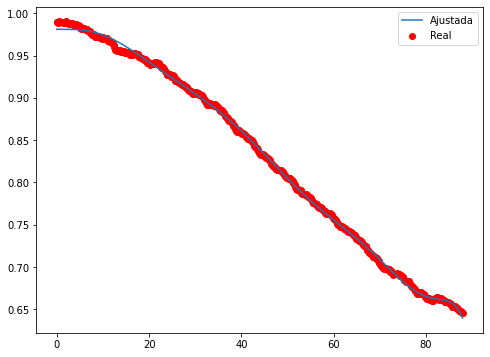

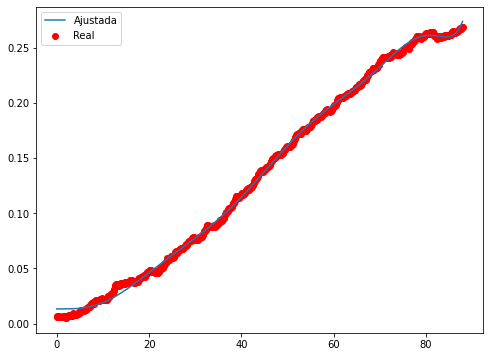

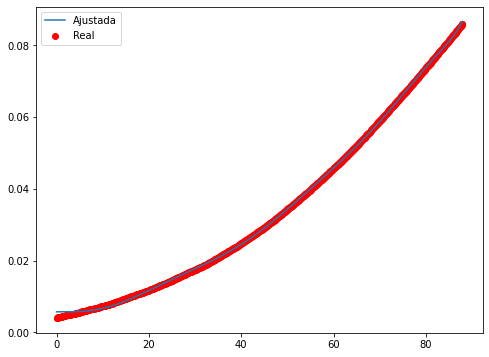

Epoch 1/500
32/32 - 2s - loss: 0.0441 - 2s/epoch - 57ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0032 - 93ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 6.5961e-04 - 98ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 3.8329e-04 - 93ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 2.6783e-04 - 108ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.9354e-04 - 97ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 1.4318e-04 - 118ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 1.0890e-04 - 84ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 8.3104e-05 - 86ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 6.3839e-05 - 92ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 4.9372e-05 - 109ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 3.8426e-05 - 86ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 3.0404e-05 - 88ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 2.4522e-05 - 92ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 2.0254e-05 - 99ms/epoch - 3ms/step
Epoch 16/5

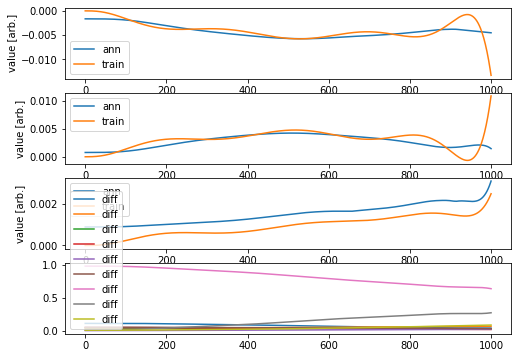

Validation loss: 1.7610550060301393
Testing loss: 15.312639475328591


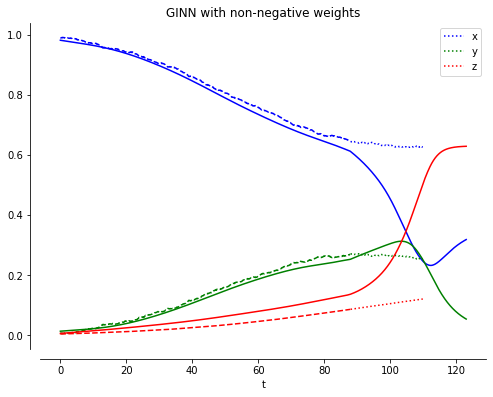

____________________________
Iteración =  28
Min =  0.06989518180235846
[[0, 1, 0, 0, 0, 1], [0, 1, 0, 0, 0, 1], [0, 1, 0, 1, 0, 1], [0, 1, 0, 1, 0, 1], [0, 1, 1, 0, 1, 0]]
[0.06989518180235846, 0.14073881611792677, 0.14698108422783035, 0.19181782186003887, 0.11435697095573708]
[0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846]


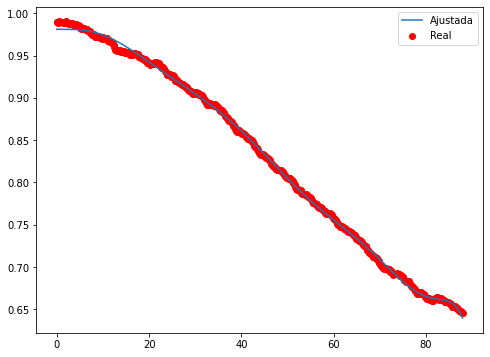

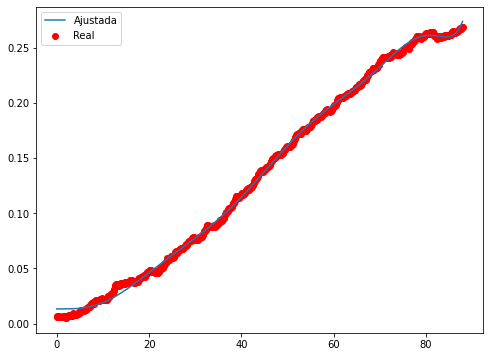

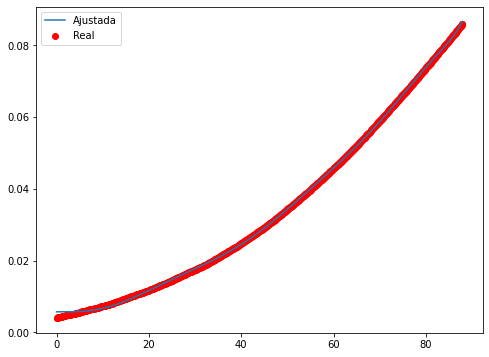

Epoch 1/500
32/32 - 2s - loss: 1.0147e-05 - 2s/epoch - 63ms/step
Epoch 2/500
32/32 - 0s - loss: 1.0147e-05 - 103ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 1.0147e-05 - 124ms/epoch - 4ms/step
Epoch 4/500
32/32 - 0s - loss: 1.0147e-05 - 116ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 1.0147e-05 - 105ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.0147e-05 - 117ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 1.0147e-05 - 118ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 1.0147e-05 - 158ms/epoch - 5ms/step
Epoch 9/500
32/32 - 0s - loss: 1.0147e-05 - 115ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 1.0147e-05 - 107ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 1.0147e-05 - 120ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 1.0147e-05 - 136ms/epoch - 4ms/step
Epoch 13/500
32/32 - 0s - loss: 1.0147e-05 - 98ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 1.0147e-05 - 118ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 1.0147e-05 - 114ms/epoch - 4

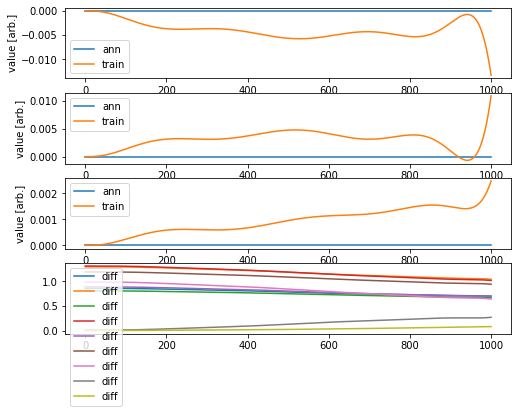

Validation loss: 21.273889291139056
Testing loss: 21.3316625032002


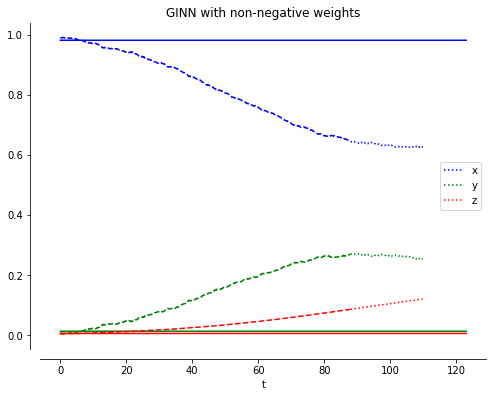

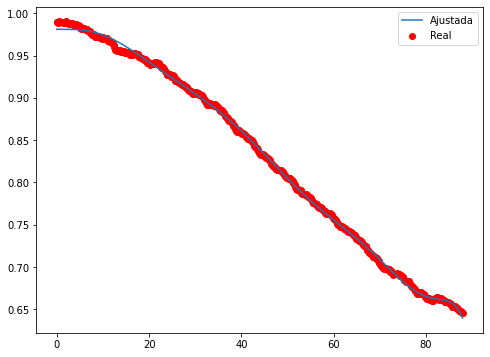

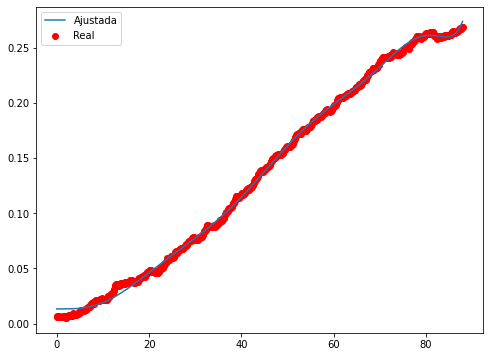

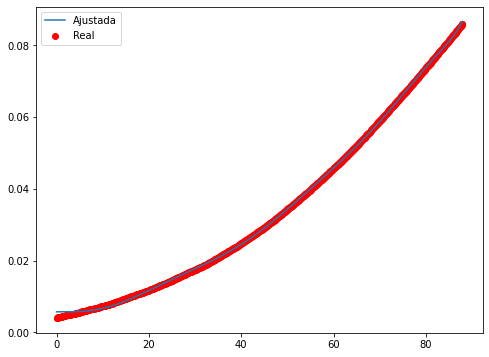

Epoch 1/500
32/32 - 2s - loss: 1.0147e-05 - 2s/epoch - 66ms/step
Epoch 2/500
32/32 - 0s - loss: 1.0147e-05 - 88ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 1.0147e-05 - 86ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 1.0147e-05 - 87ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 1.0147e-05 - 90ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.0147e-05 - 90ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 1.0147e-05 - 87ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 1.0147e-05 - 89ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 1.0147e-05 - 105ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 1.0147e-05 - 89ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 1.0147e-05 - 88ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 1.0147e-05 - 106ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 1.0147e-05 - 92ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 1.0147e-05 - 99ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 1.0147e-05 - 91ms/epoch - 3ms/step
Epo

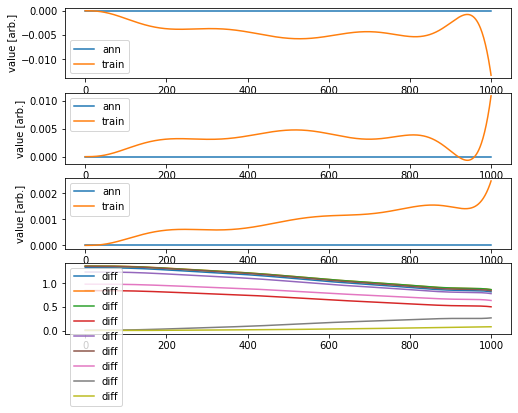

Validation loss: 21.273889291139056
Testing loss: 21.3316625032002


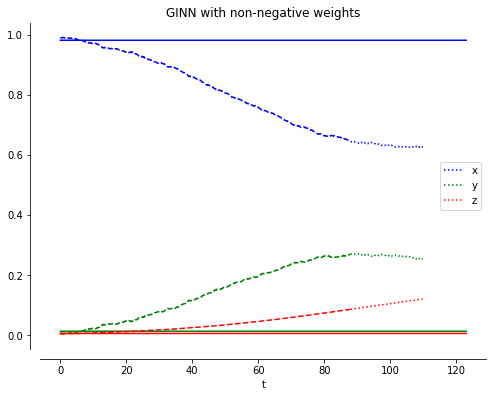

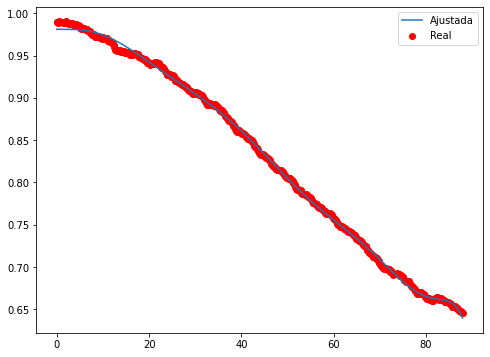

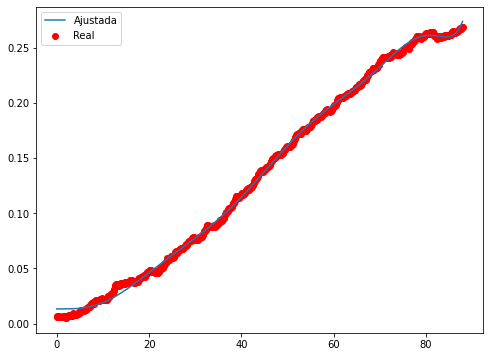

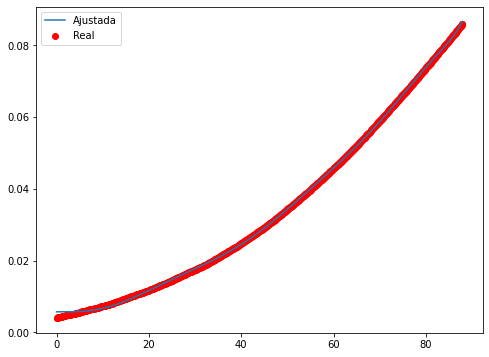

Epoch 1/500
32/32 - 2s - loss: 1.0147e-05 - 2s/epoch - 55ms/step
Epoch 2/500
32/32 - 0s - loss: 1.0147e-05 - 108ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 1.0147e-05 - 96ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 1.0147e-05 - 95ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 1.0147e-05 - 100ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.0147e-05 - 117ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 1.0147e-05 - 121ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 1.0147e-05 - 109ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 1.0147e-05 - 99ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 1.0147e-05 - 102ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 1.0147e-05 - 91ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 1.0147e-05 - 90ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 1.0147e-05 - 96ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 1.0147e-05 - 102ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 1.0147e-05 - 107ms/epoch - 3ms/st

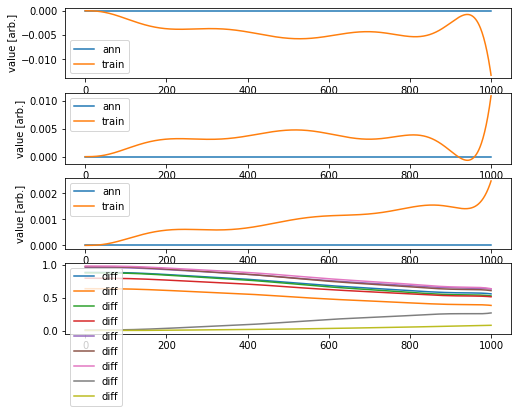

Validation loss: 21.273889291139056
Testing loss: 21.3316625032002


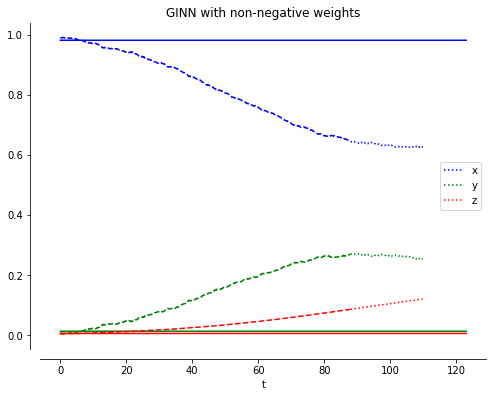

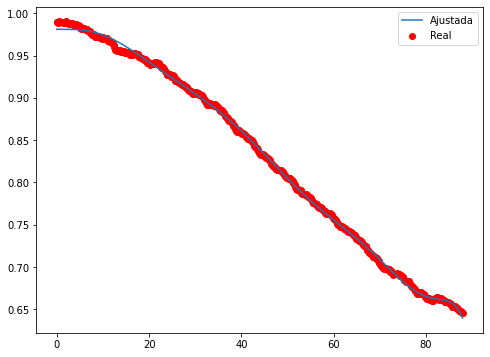

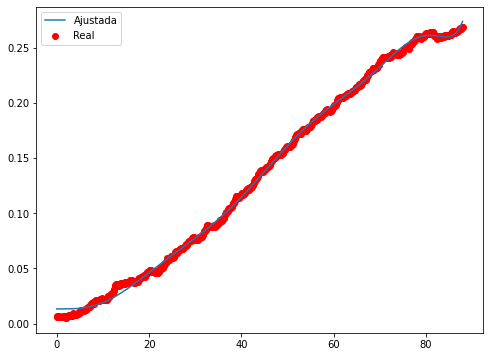

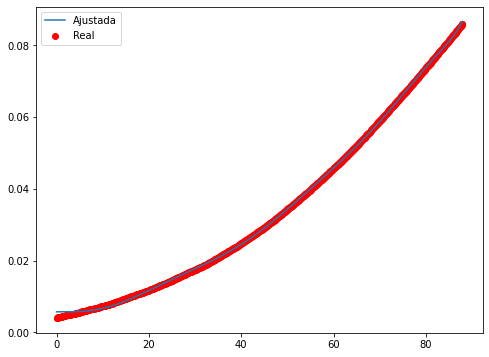

Epoch 1/500
32/32 - 2s - loss: 1.0147e-05 - 2s/epoch - 55ms/step
Epoch 2/500
32/32 - 0s - loss: 1.0147e-05 - 100ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 1.0147e-05 - 87ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 1.0147e-05 - 91ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 1.0147e-05 - 94ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.0147e-05 - 115ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 1.0147e-05 - 127ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 1.0147e-05 - 130ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 1.0147e-05 - 129ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 1.0147e-05 - 121ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 1.0147e-05 - 140ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 1.0147e-05 - 173ms/epoch - 5ms/step
Epoch 13/500
32/32 - 0s - loss: 1.0147e-05 - 114ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 1.0147e-05 - 120ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 1.0147e-05 - 126ms/epoch - 4ms

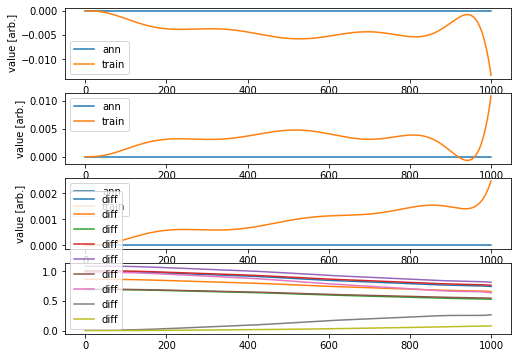

Validation loss: 21.273889291139056
Testing loss: 21.3316625032002


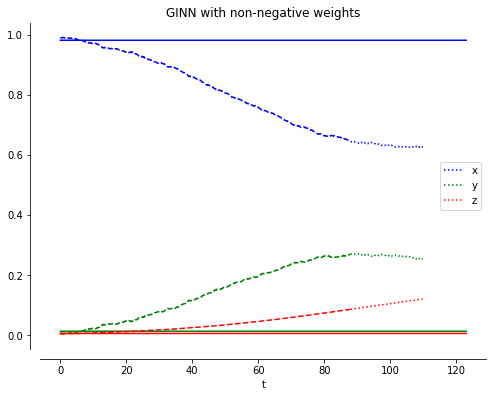

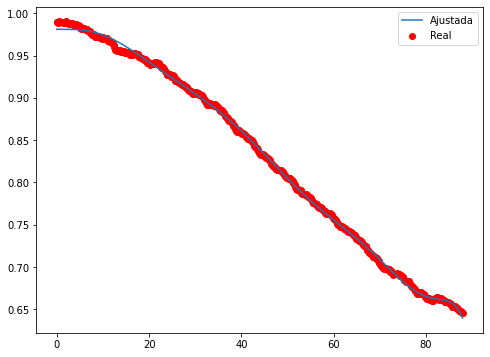

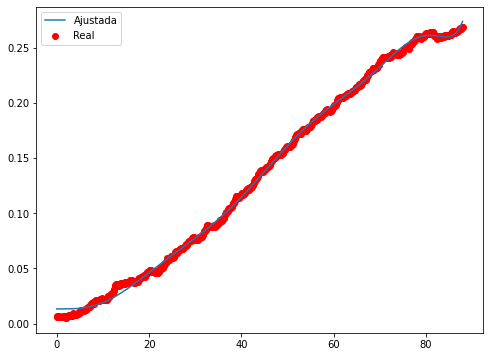

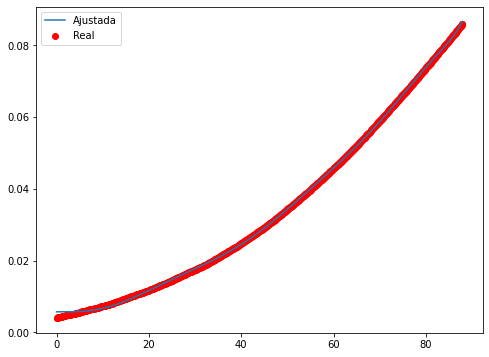

Epoch 1/500
32/32 - 2s - loss: 1.0147e-05 - 2s/epoch - 54ms/step
Epoch 2/500
32/32 - 0s - loss: 1.0147e-05 - 97ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 1.0147e-05 - 94ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 1.0147e-05 - 89ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 1.0147e-05 - 89ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 1.0147e-05 - 94ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 1.0147e-05 - 94ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 1.0147e-05 - 93ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 1.0147e-05 - 98ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 1.0147e-05 - 92ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 1.0147e-05 - 88ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 1.0147e-05 - 94ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 1.0147e-05 - 88ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 1.0147e-05 - 91ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 1.0147e-05 - 88ms/epoch - 3ms/step
Epoch

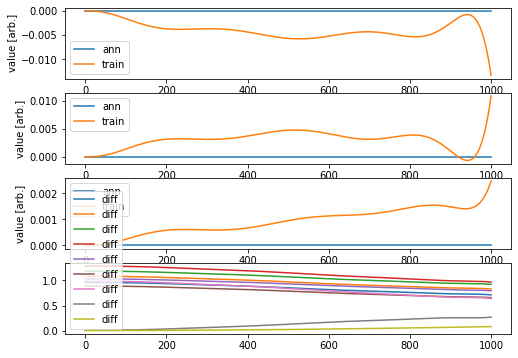

Validation loss: 21.273889291139056
Testing loss: 21.3316625032002


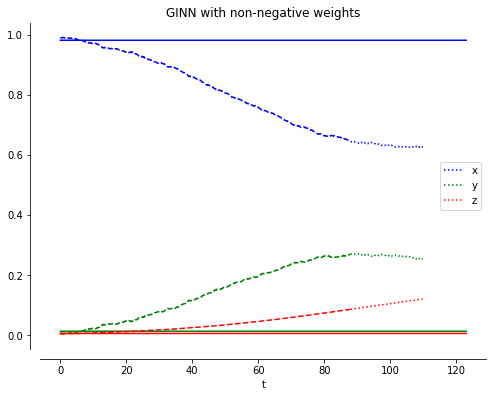

____________________________
Iteración =  29
Min =  0.06989518180235846
[[0, 1, 0, 0, 0, 1], [0, 1, 0, 0, 0, 1], [0, 1, 0, 1, 0, 1], [0, 1, 0, 1, 0, 1], [0, 1, 1, 0, 1, 0]]
[0.06989518180235846, 0.14073881611792677, 0.14698108422783035, 0.19181782186003887, 0.11435697095573708]
[0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846, 0.06989518180235846]


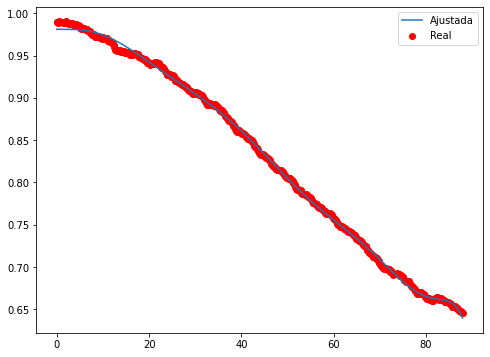

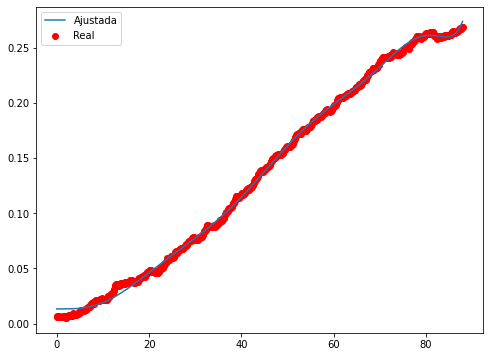

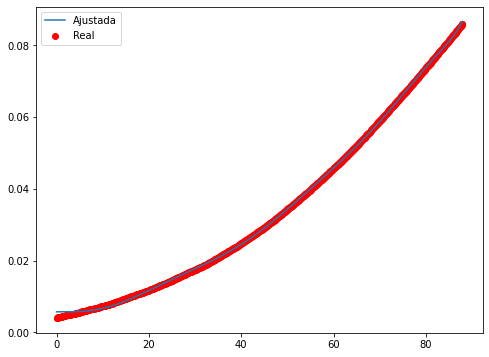

Epoch 1/500
32/32 - 2s - loss: 0.0676 - 2s/epoch - 52ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0065 - 89ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0014 - 98ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 7.1032e-04 - 100ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 5.1093e-04 - 95ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 4.1417e-04 - 91ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 3.4673e-04 - 95ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 2.9459e-04 - 91ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 2.5183e-04 - 94ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 2.1337e-04 - 97ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 1.7752e-04 - 96ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 1.4392e-04 - 90ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 1.1195e-04 - 118ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 8.3252e-05 - 96ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 6.0752e-05 - 97ms/epoch - 3ms/step
Epoch 16/500
32

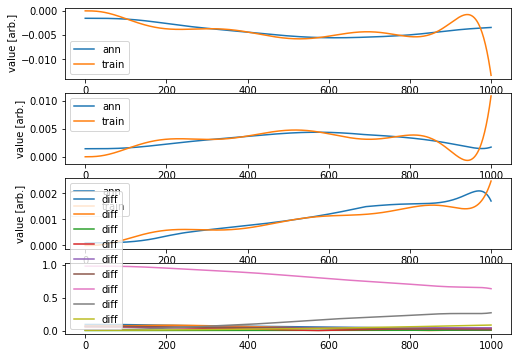

Validation loss: 0.13788813095386637
Testing loss: 1.0178582469466015


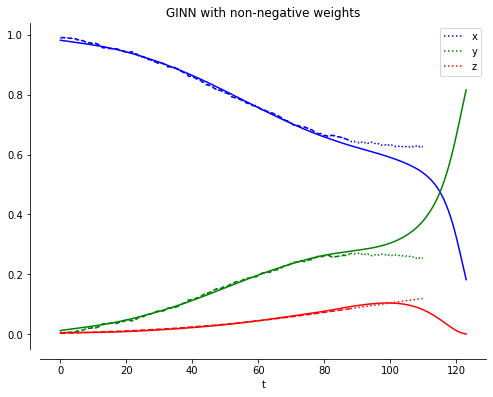

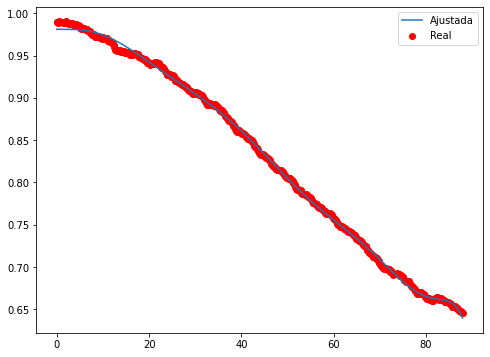

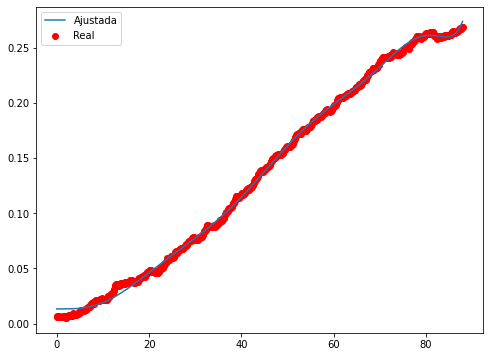

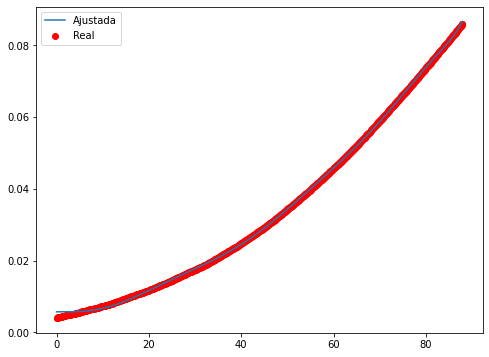

Epoch 1/500
32/32 - 2s - loss: 0.2384 - 2s/epoch - 58ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0285 - 93ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0055 - 145ms/epoch - 5ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0020 - 135ms/epoch - 4ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0011 - 137ms/epoch - 4ms/step
Epoch 6/500
32/32 - 0s - loss: 7.7683e-04 - 121ms/epoch - 4ms/step
Epoch 7/500
32/32 - 0s - loss: 6.0227e-04 - 143ms/epoch - 4ms/step
Epoch 8/500
32/32 - 0s - loss: 4.8613e-04 - 121ms/epoch - 4ms/step
Epoch 9/500
32/32 - 0s - loss: 4.0149e-04 - 112ms/epoch - 4ms/step
Epoch 10/500
32/32 - 0s - loss: 3.3555e-04 - 116ms/epoch - 4ms/step
Epoch 11/500
32/32 - 0s - loss: 2.8283e-04 - 122ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 2.4032e-04 - 103ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 2.0538e-04 - 108ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 1.7714e-04 - 102ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 1.5349e-04 - 94ms/epoch - 3ms/step
Epoch 16/500


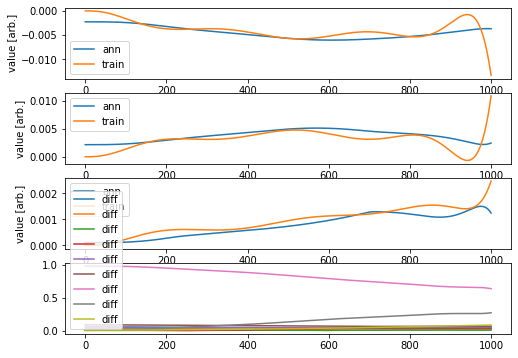

Validation loss: 6.379621263766548
Testing loss: 58.59678743512329


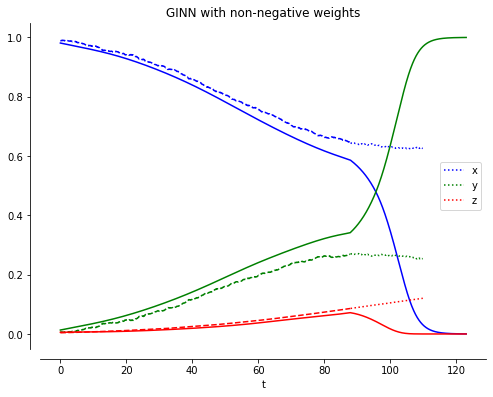

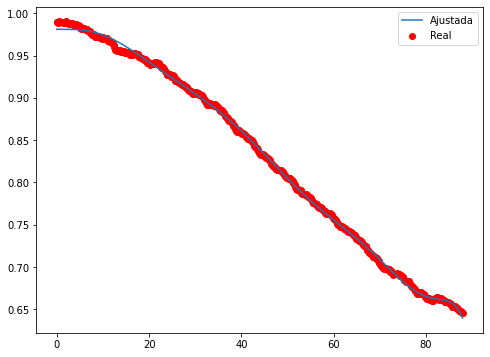

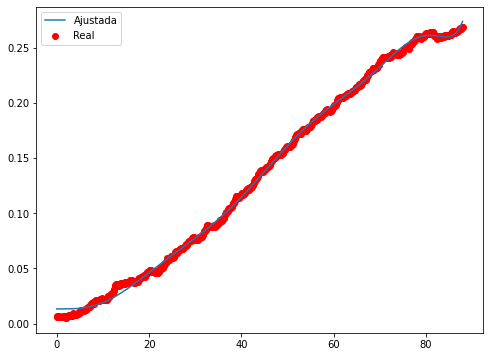

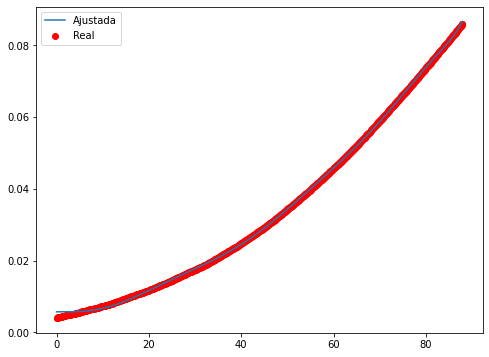

Epoch 1/500
32/32 - 2s - loss: 0.1894 - 2s/epoch - 67ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0217 - 92ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0040 - 97ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0016 - 99ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 0.0010 - 93ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 7.5195e-04 - 89ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 6.0692e-04 - 96ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 5.0887e-04 - 106ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 4.3888e-04 - 100ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 3.8391e-04 - 96ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 3.3700e-04 - 127ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 2.9859e-04 - 104ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 2.6679e-04 - 89ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 2.4007e-04 - 84ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 2.1666e-04 - 84ms/epoch - 3ms/step
Epoch 16/500
32/32 - 

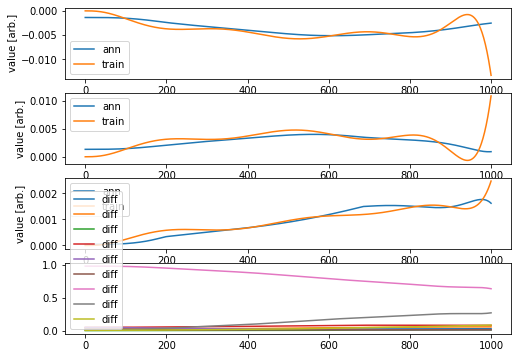

Validation loss: 0.0846488954072015
Testing loss: 2.363817224651467


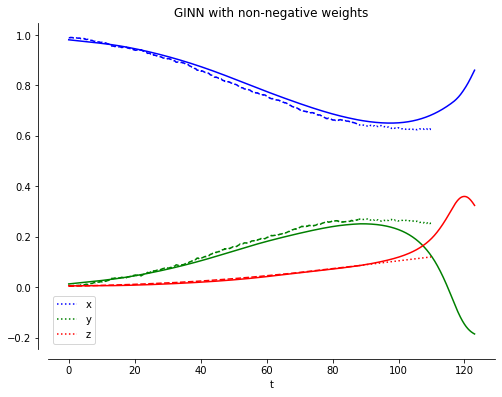

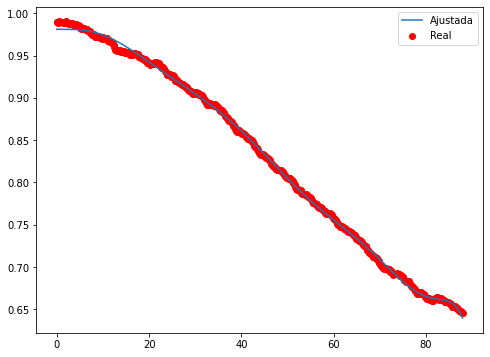

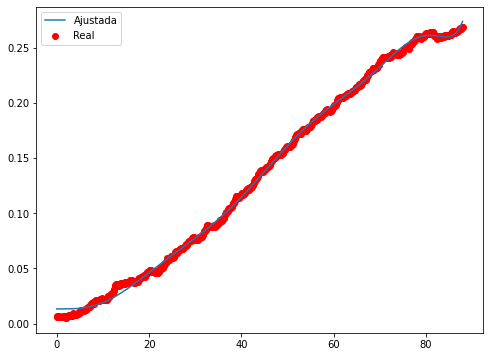

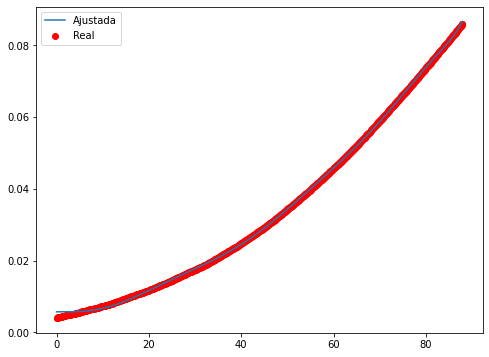

Epoch 1/500
32/32 - 2s - loss: 0.1410 - 2s/epoch - 61ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0165 - 98ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0030 - 109ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0011 - 95ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 7.1389e-04 - 103ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 5.6348e-04 - 105ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 4.7953e-04 - 97ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 4.1380e-04 - 94ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 3.5663e-04 - 99ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 3.0842e-04 - 98ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 2.6856e-04 - 116ms/epoch - 4ms/step
Epoch 12/500
32/32 - 0s - loss: 2.3626e-04 - 98ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 2.0862e-04 - 124ms/epoch - 4ms/step
Epoch 14/500
32/32 - 0s - loss: 1.8549e-04 - 129ms/epoch - 4ms/step
Epoch 15/500
32/32 - 0s - loss: 1.6550e-04 - 138ms/epoch - 4ms/step
Epoch 16/500
3

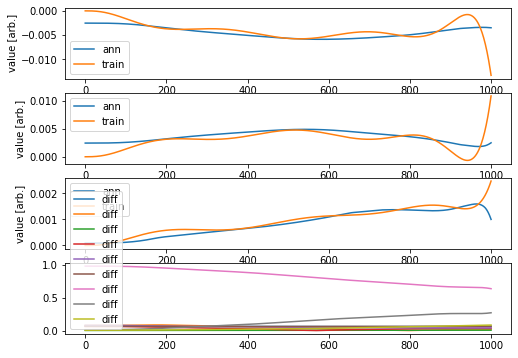

Validation loss: 3.6812104647225015
Testing loss: 44.820240285333675


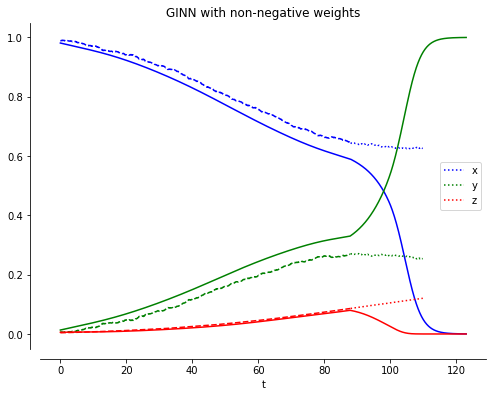

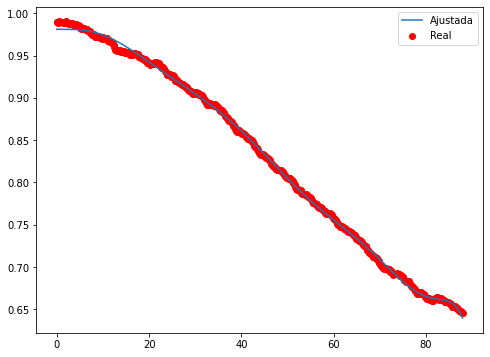

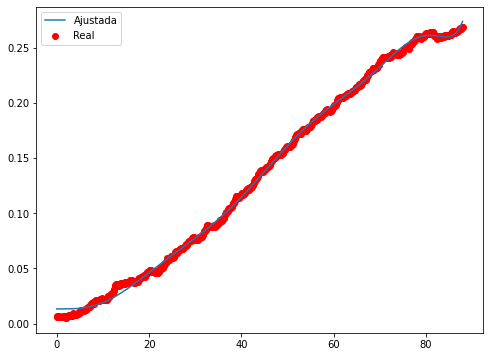

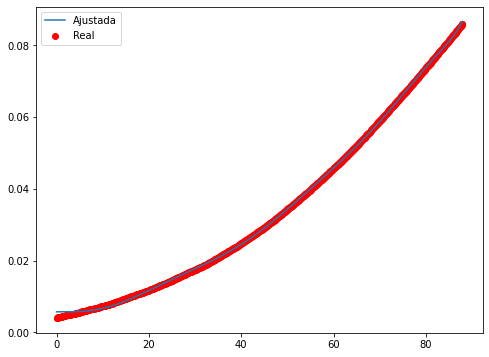

Epoch 1/500
32/32 - 2s - loss: 0.1612 - 2s/epoch - 53ms/step
Epoch 2/500
32/32 - 0s - loss: 0.0173 - 96ms/epoch - 3ms/step
Epoch 3/500
32/32 - 0s - loss: 0.0030 - 93ms/epoch - 3ms/step
Epoch 4/500
32/32 - 0s - loss: 0.0011 - 96ms/epoch - 3ms/step
Epoch 5/500
32/32 - 0s - loss: 6.1823e-04 - 95ms/epoch - 3ms/step
Epoch 6/500
32/32 - 0s - loss: 4.7048e-04 - 92ms/epoch - 3ms/step
Epoch 7/500
32/32 - 0s - loss: 3.9531e-04 - 102ms/epoch - 3ms/step
Epoch 8/500
32/32 - 0s - loss: 3.3989e-04 - 95ms/epoch - 3ms/step
Epoch 9/500
32/32 - 0s - loss: 2.9507e-04 - 87ms/epoch - 3ms/step
Epoch 10/500
32/32 - 0s - loss: 2.5862e-04 - 97ms/epoch - 3ms/step
Epoch 11/500
32/32 - 0s - loss: 2.2758e-04 - 98ms/epoch - 3ms/step
Epoch 12/500
32/32 - 0s - loss: 1.9940e-04 - 88ms/epoch - 3ms/step
Epoch 13/500
32/32 - 0s - loss: 1.7442e-04 - 89ms/epoch - 3ms/step
Epoch 14/500
32/32 - 0s - loss: 1.5225e-04 - 97ms/epoch - 3ms/step
Epoch 15/500
32/32 - 0s - loss: 1.3173e-04 - 115ms/epoch - 4ms/step
Epoch 16/500
32/32 

In [ ]:
for it in range(15,30):
  print("____________________________")
  print("Iteración = ", it)
  print("Min = ", min(medias))
  Mins.append(min(medias))
  print(Pob)
  print(medias)  
  print(Mins)

  fl = selection(Pob,medias)[0]
  Pob.append(fl)

  i12,i13,i21,i23,i31,i32 = fl #[0, 1, 1, 1, 0, 0]
  totali = []
  for _ in range(iters):
    total = train(Td,Xd,Yd,Zd,T0,X0,Y0,Z0,mode=2)
    while math.isnan(total):
      total = train(Td,Xd,Yd,Zd,T0,X0,Y0,Z0,mode=2)
    totali.append(total)
  #totales.append(totali)
  medias.append(sum(totali)/len(totali))

  lP = len(Pob)

  if lP > Kc:
    maxP = max(medias)
    for pi in range(lP):
      if medias[pi] == maxP:
        medias.remove(medias[pi])
        #totales.remove(totales[pi])
        Pob.remove(Pob[pi])
        break
  
print("____________________________")
print("Iteración = ", it+1)
print("Min = ", min(medias))
print(Pob)
print(Mins)
print(totales)
print(medias)